In [1]:
% matplotlib inline
from __future__ import (division, 
                        print_function)

import os
import sys
import copy
import fnmatch
import warnings
import collections

import numpy as np
import scipy
try:
    from scipy.stats import scoreatpercentile
except:
    scoreatpercentile = False
from scipy.interpolate import interp1d
import cPickle as pickle

# Astropy
from astropy.io import fits
from astropy    import units as u
from astropy.stats import sigma_clip
from astropy.table import Table, Column
from astropy.utils.console import ProgressBar
from astropy.convolution import convolve, Box1DKernel

# AstroML
from astroML.plotting import hist
from astroML.density_estimation import KNeighborsDensity
try:
    from sklearn.neighbors import KernelDensity
    use_sklearn_KDE = True
except:
    import warnings
    warnings.warn("KDE will be removed in astroML version 0.3.  Please "
                  "upgrade to scikit-learn 0.14+ and use "
                  "sklearn.neighbors.KernelDensity.", DeprecationWarning)
    from astroML.density_estimation import KDE
    use_sklearn_KDE = False
from sklearn.neighbors import KDTree
from sklearn.neighbors import BallTree

# Matplotlib related
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from matplotlib.patches import Ellipse
from matplotlib.ticker import NullFormatter, MaxNLocator, FormatStrFormatter
from matplotlib.collections import PatchCollection
tickFormat = FormatStrFormatter('$\mathbf{%g}$') 

# Personal
import hscUtils as hUtil
#import galSBP
import coaddCutoutGalfitSimple as gSimple 

# Cosmology
import cosmology
c=cosmology.Cosmo(H0=70.0, omega_m=0.3, omega_l=0.7, flat=1)

# Color map 
from palettable.colorbrewer.sequential import Greys_9, OrRd_9, Blues_9, Purples_9, YlGn_9
BLK = Greys_9.mpl_colormap
ORG = OrRd_9.mpl_colormap
BLU = Blues_9.mpl_colormap
GRN = YlGn_9.mpl_colormap
PUR = Purples_9.mpl_colormap

# Personal tools
from hscUtils import songPlotSetup, removeIsNullCol
from hscUtils import confidence_interval, ma_confidence_interval_1d, confidence_interval_1d

## Constants
# SDSS pivot wavelength 
sdss_u_pivot = 3551.0
sdss_g_pivot = 4686.0
sdss_r_pivot = 6165.0
sdss_i_pivot = 7481.0
sdss_z_pivot = 8931.0

# HSC pivot wavelength 
hsc_g_pivot = 4782.2
hsc_r_pivot = 6101.7 
hsc_i_pivot = 7648.0 
hsc_z_pivot = 8883.0
hsc_y_pivot = 9750.8

hscFiltWave = np.asarray([hsc_g_pivot, hsc_r_pivot, hsc_i_pivot, hsc_z_pivot, hsc_y_pivot])

"""
Absolute magnitude of the Sun in HSC filters
Right now, just use the DES filters
"""
SUN_G = 5.08
SUN_R = 4.62
SUN_I = 4.52
SUN_Z = 4.52
SUN_Y = 4.51

# Solar stellar metallicity 
Z_SUN = 0.02

# definitions for the axes
left, width    = 0.15, 0.64
right          = left + width 
bottom, height = 0.13, 0.86
bottom_h = left_h = left + width + 0.02
recScat = [left,   bottom, width, height]
recHist = [right,  bottom,  0.20, height]
SBP1 = [0.124, 0.085, 0.865, 0.33]
SBP2 = [0.124, 0.41, 0.865, 0.55]
EC1 = [0.135, 0.072, 0.862, 0.295]
EC2 = [0.135, 0.366, 0.862, 0.295]
EC3 = [0.135, 0.666, 0.862, 0.295]
REC = [0.12, 0.11, 0.87, 0.87]
COG1 = [0.143, 0.10, 0.850, 0.43]
COG2 = [0.143, 0.53, 0.850, 0.43]

# Universal RSMA array
RSMA_COMMON = np.arange(0.4, 4.2, 0.01)
RR50_COMMON = np.arange(0.0, 9.0, 0.01)
EMPTY = (RSMA_COMMON * np.nan)

# Color 
BLUE0 = "#92c5de"
BLUE1 = "#0571b0"
RED0 = "#f4a582"
RED1 = "#ca0020"
PURPLE0 = '#af8dc3'
PURPLE1 = '#762a83'
BROWN0 = '#bf812d'
BROWN1 = '#543005'
GREEN0 = '#7fbf7b'
GREEN1 = '#1b7837'

# 3-sigma
SIGMA1 = 0.3173
SIGMA2 = 0.0455
SIGMA3 = 0.0027

/usr/local/lib/python2.7/site-packages/matplotlib/__init__.py:1357: UserWarning:  This call to matplotlib.use() has no effect
because the backend has already been chosen;
matplotlib.use() must be called *before* pylab, matplotlib.pyplot,
or matplotlib.backends is imported for the first time.

  warnings.warn(_use_error_msg)


In [2]:
def normProf(sma, sbp, minSma, maxSma, integrate=True, 
             divide=False): 
    """
    Naive method to normalize the profile. 
    
    Parameters: 
        sbp    : Array for surface brightness profile 
        sma    : Radius range 
        minSma : Minimum SMA
        maxSma   Maximum SMA
    """
    if integrate: 
        indInt = np.where(sma <= minSma)
        isoArea = (np.pi * (sma[indInt] ** 2.0))
        isoRing = np.append(isoArea[1], [isoArea[1:] - isoArea[:-1]])
        intNorm = (np.log10(np.nansum((10.0 ** sbp[indInt]) * isoRing)))
    else:
        intNorm = np.nanmedian(sbp[(sma >= minSma) & 
                                   (sma <= maxSma)])
        
    if divide: 
        return (sbp / intNorm)
    else:
        return (sbp - intNorm)
    
    

def pixKpc(redshift, pix=0.168, show=True, npix=1.0):
    """
    Get the corresponding Kpc size of a pixel.  
    
    Parameters: 
    """
    pixKpc = pix * npix * hUtil.cosmoScale(redshift)

    if show:
        print("# %d pixel(s) = %6.3f Kpc" % (npix, pixKpc))
        
    return pixKpc

def logAdd(para1, para2):
    """ Useful for adding magnitudes. """
    return np.log10((10.0 ** np.asarray(para1)) + 
                    (10.0 ** np.asarray(para2)))

def errAdd(err1, err2):
    """Add error quadral..."""
    return np.sqrt((err1 ** 2.0) + 
                   (err2 ** 2.0))

def toColorArr(array, bottom=None, top=None):
    """ 
    Convert a data array to "color array" (between 0 and 1). 
    
    Parameters:
        bottom, top  : 
    """
    data = copy.deepcopy(array)
    
    colorArr = ((data - np.nanmin(data)) / 
                (np.nanmax(data) - np.nanmin(data))) 
    colorArr[colorArr <= 0] = 0.0
    
    if bottom is not None: 
        colorArr += bottom
    
    return colorArr

def toSizeArr(array, bottom=None, top=None, maxSize=40):
    """ 
    Convert a data array to "size array". 
    
    Parameters:
        bottom, top  : 
    """
    data = copy.deepcopy(array)
    if top is not None:
        data[data >= top] = top
    if bottom is not None:
        data[data <= bottom] = bottom
        
    return ((data - np.nanmin(data)) / 
            (np.nanmax(data) - np.nanmin(data))) * maxSize

def getLuminosity(mag, redshift, extinction=None, 
                  amag_sun=None):
    """Get the absolute magnitude or luminosity."""
    distmod = hUtil.cosmoDistMod(redshift)
    absMag = (mag - distmod)
    if extinction is not None: 
        absMag -= extinction 
    if amag_sun is not None: 
        absMag = ((amag_sun - absMag) / 2.5)
    
    return absMag

def getStackProfiles(sample, loc, name='GAMA', 
                     idCol='ID_USE', tabCol='sum_tab', save=True,
                     sedMod='fsps1'):
    """Get the stacks of the profiles."""
    print("## Sample %s : Will deal with %d galaxies" % (name, len(sample)))
    profiles = []
    with ProgressBar(len(sample), ipython_widget=True) as bar:
        for g in sample:
            try:
                gFile = os.path.join(loc, os.path.basename(g['sum_tab'].replace('./', '')).strip())
                gProf = Table.read(gFile, format='fits')
                """ Add extra information """
                #try: 
                gProf.meta['KCORRECT_I'] = g['KCORRECT_I']
                gProf.meta['KCORRECT_G'] = g['KCORRECT_G']
                gProf.meta['KCORRECT_R'] = g['KCORRECT_R']
                gProf.meta['KCORRECT_Z'] = g['KCORRECT_Z']
                gProf.meta['KCORRECT_Y'] = g['KCORRECT_Y']
                gProf.meta['LOGM2LI'] = g['LOGM2L_I_OBS']
                gProf.meta['LOGM2LG'] = g['LOGM2L_G_OBS']
                gProf.meta['LOGM2LR'] = g['LOGM2L_R_OBS']
                gProf.meta['LOGM2LZ'] = g['LOGM2L_Z_OBS']
                gProf.meta['LUM_10'] = g['lum_10']
                gProf.meta['LUM_15'] = g['lum_15']
                gProf.meta['LUM_25'] = g['lum_25']
                gProf.meta['LUM_30'] = g['lum_30']
                gProf.meta['LUM_40'] = g['lum_40']
                gProf.meta['LUM_50'] = g['lum_50']
                gProf.meta['LUM_60'] = g['lum_60']
                gProf.meta['LUM_75'] = g['lum_75']
                gProf.meta['LUM_100'] = g['lum_100']
                gProf.meta['LUM_120'] = g['lum_120']
                gProf.meta['LUM_150'] = g['lum_150']
                gProf.meta['LUM_MAX'] = g['lum_max']
                gProf.meta['R20_100'] = g['r20_100']
                gProf.meta['R50_100'] = g['r50_100']
                gProf.meta['R80_100'] = g['r80_100']
                gProf.meta['LOGM_10'] = g['logm_10']
                gProf.meta['LOGM_15'] = g['logm_15']
                gProf.meta['LOGM_25'] = g['logm_25']
                gProf.meta['LOGM_30'] = g['logm_30']
                gProf.meta['LOGM_40'] = g['logm_40']
                gProf.meta['LOGM_50'] = g['logm_50']
                gProf.meta['LOGM_60'] = g['logm_60']
                gProf.meta['LOGM_75'] = g['logm_75']
                gProf.meta['LOGM_100'] = g['logm_100']
                gProf.meta['LOGM_120'] = g['logm_120']
                gProf.meta['LOGM_150'] = g['logm_150']
                gProf.meta['LOGM_MAX'] = g['logm_max']
                #except Exception:
                #    print("## WARNING: Some metadata may not be available !")
                #    continue
            except Exception:
                print("## Missing: %s" % gFile)
                continue 
            profiles.append(gProf)
            bar.update()
    
    if save: 
        outPkl = os.path.join(loc, (name + '_profs.pkl'))
        hUtil.saveToPickle(profiles, outPkl)
        print("## Save %s to %s" % (name, outPkl))
        
    return profiles

def organizeSbp(profiles, col1='muI1', col2='KCORRECT_I', 
                kind='sbp', norm=False, r1=9.9, r2=10.1, divide=False,
                col3=None, col4=None, justStack=False, integrate=False,
                sun1=SUN_G, sun2=SUN_R, normArr=None,
                index=None, extCat=None, rCol=None, 
                rNorm=False, rNormCol='R50_100', 
                rCommon=RR50_COMMON):
    """ Get the stack of individual profiels, and their med/avg. """
    if rCol is None: 
        rCol = 'rKpc'
        
    if rNorm is True:
        print("!!!! Normalize the radius using R50")
        rarr = np.vstack((p[rCol] / p.meta[rNormCol]) for p in profiles)
    else:
        rarr = np.vstack(p[rCol] for p in profiles)
     
    # Surface brightness profile / luminosity profiles
    if kind.strip() == 'sbp':
        if col2 is not None: 
            if norm:
                stack = np.vstack(normProf(p[rCol], 
                                           np.asarray(p[col1] + (p.meta[col2] / 2.5)), 
                                           r1, r2, divide=divide, integrate=integrate) 
                                  for p in profiles)
            else:
                stack = np.vstack(np.asarray(p[col1] + (p.meta[col2] / 2.5)) 
                                  for p in profiles)
        else: 
            print("## NO KCORRECTION APPLIED !!")            
            if norm:
                stack = np.vstack(normProf(p[rCol], p[col1], 
                                           r1, r2, divide=divide, integrate=integrate) 
                                  for p in profiles)
            else:
                stack = np.vstack(np.asarray(p[col1]) for p in profiles)
    # Mass profiles
    elif kind.strip() == 'mass':
        if norm and (normArr is None):
            stack = np.vstack(normProf(p[rCol], 
                                       np.asarray(p[col1] + p.meta[col2]), 
                                       r1, r2, divide=divide, integrate=integrate) 
                              for p in profiles)
        elif norm and (normArr is not None):
            stack = np.vstack((np.asarray(p[col1] + p.meta[col2]) - normArr[i]) for (i, p) 
                              in enumerate(profiles))
        else: 
            stack = np.vstack(np.asarray(p[col1] + p.meta[col2]) for p in profiles)
    # Color profiles
    elif kind.strip() == 'color':
        cSun = (sun1 - sun2)
        if col3 is None or col4 is None:
            print("## NO KCORRECTION APPLIED !!")
            if norm:
                stack = np.vstack(normProf(p[rCol], 
                                           np.asarray(cSun - 2.5 * (p[col1] - p[col2])), 
                                           r1, r2, divide=divide, integrate=integrate) 
                                  for p in profiles)
            else: 
                stack = np.vstack(np.asarray(cSun - 2.5 *(p[col1] - p[col2])) for p in profiles)
        else:
            if norm:
                stack = np.vstack(normProf(p[rCol], 
                                           np.asarray(cSun - 2.5 * (p[col1] - p[col2]) -
                                                      (p.meta[col3] - p.meta[col4])), 
                                           r1, r2, divide=divide, integrate=integrate) 
                                  for p in profiles)
            else: 
                stack = np.vstack(np.asarray(cSun - 2.5 * (p[col1] - p[col2]) -
                                             (p.meta[col3] - p.meta[col4])) 
                                  for p in profiles)
    # Luminosity or stellar mass curve of growth
    elif kind.strip() == 'cog':
        if col2 is None:
            # Luminosity
            if not norm:
                stack = np.vstack(np.asarray(p[col1]) for p in profiles)
            else:
                if col3 is None: 
                    print("# No col3 found! Will not normalize!")
                stack = np.vstack(np.asarray(p[col1] - p.meta[col3]) for p in profiles)
        else: 
            # Stellar mass
            if not norm:
                stack = np.vstack(np.asarray(p[col1] + p.meta[col2]) for p in profiles)
            else:
                if col3 is None: 
                    print("# No col3 found! Will not normalize!")
                stack = np.vstack(np.asarray(p[col1] + p.meta[col2] 
                                             - p.meta[col3]) for p in profiles)
    else: 
        raise Exception("## WRONG KIND !!")
        
    if index is not None: 
        stack = np.vstack(p[index] for p in stack)
        rarr = np.vstack(r[index] for r in rarr)
    
    if rNorm is True: 
        print("!!!! Interpoate the profiles to new oommon radius")
        interps = map(lambda r, p: interp1d(r, p, kind='slinear', bounds_error=False), 
                      rarr, stack)
        stack = np.vstack(intrp(rCommon) for intrp in interps)
        
    if not justStack:
        """ Get the median and 1-sigma confidence range """
        try:
            stdProf = confidence_interval(stack, axis=0, alpha=np.asarray([SIGMA1, 1.0]), 
                                          metric=np.nanstd, numResamples=1500, 
                                          interpolate=True) 
        except Exception:
            print("!!! Boostramp resample fails for standard deviation !!!")
            std1 = np.nanstd(stack, axis=0)
            stdProf = [std1, std1, std1, std1]
            
        try:
            medProf = confidence_interval(stack, axis=0, alpha=np.asarray([SIGMA1, 1.0]), 
                                          metric=np.nanmedian, numResamples=1500, 
                                          interpolate=True) 
        except Exception: 
            print("!!! Boostramp resample fails for median !!!")
            medProf = np.nanmedian(stack, axis=0)
            medProf = [medProf - np.nanstd(stack, axis=0), medProf, medProf,
                       medProf + np.nanstd(stack)]
            
        try: 
            avgProf = confidence_interval(stack, axis=0, alpha=np.asarray([SIGMA1, 1.0]), 
                                          metric=np.nanmean, numResamples=1500, 
                                          interpolate=False) 
        except Exception: 
            print("!!! Boostramp resample fails for mean !!!")
            avgProf = np.nanmean(stack, axis=0)
            avgProf = [avgProf - np.nanstd(stack, axis=0), avgProf, avgProf,
                       avgProf + np.nanstd(stack)]
        
        return stack, medProf, avgProf, stdProf
    else: 
        return stack
    

def loadPkl(filename):
    try:
        import cPickle as pickle
    except:
        warnings.warn("## cPickle is not available!!")
        import pickle
    
    if os.path.isfile(filename):
        pklFile = open(filename, 'rb')
        data = pickle.load(pklFile)    
        pklFile.close()
    
        return data
    else: 
        warnings.warn("## Can not find %s, return None" % filename)
        return None
    
    
    

def updateKcorrect(cat, zCol='z_use', magType='mag_cmodel',
                   filters=['g', 'r', 'i', 'z', 'y']):
    """Update the K-correction for each band."""
    cat = copy.deepcopy(cat)
    for f in filters:
        magCol = f + magType
        extCol = 'a_' + f
        absCol = 'ABSMAG_' + f.upper()
        kcorCol = 'KCORRECT_' + f.upper()
        newKcor = getLuminosity(cat[magCol], cat[zCol], 
                                extinction=cat[extCol]) - cat[absCol]
        try: 
            cat[kcorCol] = newKcor
        except Exception:
            cat.add_column(Column(newKcor, name=kcorCol))
            
    return cat

def updateMass(cat, m2l='LOGM2L_I_OBS', 
               apertures = ['5', '10', '15', '25', '30', '40', 
                            '50', '60', '75', '100', '120', 
                            '150', 'max']):
    """Update the stellar masses at each aperture."""
    cat = copy.deepcopy(cat)
    for aper in apertures:
        try:
            cat.add_column(Column(cat['lum_' + aper] + cat[m2l], 
                                  name=('logm_' + aper)))
        except Exception:
            print("## Can not update mass for lum_%s" % aper)
            
    return cat

def kdtreeMatch(sample1, sample2, name='kdmatched',
                mlim1=11.50, mlim2=12.0, zlim1=0.20, zlim2=0.50, 
                massCol='logm_100', zCol='z_use', 
                k1=5, k2=5, k3=5, k4=5, leaf=7,
                lamLimit=None, lamCol='lambda_redm', 
                pcenLimit=None, pcenCol='p_cen_1_redm', 
                massCut=None, zCut=None, 
                massMargin1=0.005, massMargin2=0.010, 
                zMargin1=-0.01, zMargin2=-0.005, 
                plot=True, save=True, folder=None, 
                unique=True, ballTree=False, metric='l1', 
                figX=12, figY=18, 
                mmin=11.21, mmax=12.3, zmin=0.19, zmax=0.51, 
                sizeCol='logm_10', minSize=10.4,
                colorCol='lambda_redm', minColor=20, maxColor=65,
                xLabel='$\mathrm{Redshift}$', 
                yLabel='$\log\ (M_{\star}/M_{\odot})\ (100\ \mathrm{kpc})$', 
                legend1='$\lambda \leq 20\ \mathrm{Cen}$',
                legend2='$\lambda > %d\ \mathrm{Cen}$',
                legend3='$\lambda \leq 20\ \mathrm{Cen;\ Matched}$',
                massKernel=0.06, zKernel=0.025,
                prefix1='redBCG', prefix2='nonBCG',
                mErrCol='MSTAR_ERR', mass2=None, figDir=None,
                color1a=BLK(0.4), color1b=BLK(0.7), cmap1=BLK, 
                color2a=ORG(0.4), color2b=ORG(0.7), cmap2=ORG, 
                xtickFormat='$\mathbf{%g}$', ytickFormat='$\mathbf{%g}$',
                showRegion=True, onlyUnique=True):
    """Match two samples using K-Dtree."""
    # Sample1 used for matching (should be the smaller one, e.g. the redBCG)
    sampleUse1 = sample1[(sample1[massCol] >= mlim1) & 
                         (sample1[massCol] <= mlim2) & 
                         (sample1[zCol] >= zlim1) &
                         (sample1[zCol] <= zlim2)]
    # Additional parameter cut: By default is Lambda and P_CEN
    if lamLimit is not None:
        sampleUse1 = sampleUse1[(sampleUse1[lamCol] >= lamLimit)]
    if pcenLimit is not None:
        sampleUse1 = sampleUse1[(sampleUse1[pcenCol] >= pcenLimit)]
    
    print("# Sample 1 Size: ", len(sampleUse1))

    ## Sample2 used for matching (the larger sample)
    sampleUse2 = sample2[(sample2[massCol] >= (mlim1 + massMargin1)) & 
                         (sample2[massCol] <= (mlim2 + massMargin2)) & 
                         (sample2[zCol] >= (zlim1 + zMargin1)) &
                         (sample2[zCol] <= (zlim2 + zMargin2))]
    print("# Sample 2 Size: ", len(sampleUse2))
    

    ## Isolate the parameters used for matching 
    if mass2 is None:
        data2 = np.stack((np.asarray(sampleUse2[massCol]), 
                          np.asarray(sampleUse2[zCol])), axis=-1)
    else:
        data2 = np.stack((np.asarray(sampleUse2[massCol]), 
                          np.asarray(sampleUse2[mass2]),
                          np.asarray(sampleUse2[zCol])), axis=-1)
        
    if not BallTree: 
        dataTree = KDTree(data2, leaf_size=leaf, metric=metric)
    else: 
        dataTree = BallTree(data2, leaf_size=leaf, metric=metric)
        
    if massCut is None and zCut is None:
        if mass2 is None:
            data1 = np.stack((np.asarray(sampleUse1[massCol]), 
                              np.asarray(sampleUse1[zCol])), axis=-1)
        else:
            data1 = np.stack((np.asarray(sampleUse1[massCol]), 
                              np.asarray(sampleUse2[mass2]),
                              np.asarray(sampleUse1[zCol])), axis=-1)
        dist, indAll = dataTree.query(data1, k=k1)
        indAll = indAll.ravel()
    elif massCut is not None and zCut is None:   
        if mass2 is None:
            data1a = np.stack((np.asarray(sampleUse1[sampleUse1[massCol] <= massCut][massCol]), 
                               np.asarray(sampleUse1[sampleUse1[massCol] <= massCut][zCol])), axis=-1)
            data1b = np.stack((np.asarray(sampleUse1[sampleUse1[massCol] > massCut][massCol]), 
                               np.asarray(sampleUse1[sampleUse1[massCol] > massCut][zCol])), axis=-1)
        else:
            data1a = np.stack((np.asarray(sampleUse1[sampleUse1[massCol] <= massCut][massCol]), 
                               np.asarray(sampleUse1[sampleUse1[massCol] <= massCut][mass2]),
                               np.asarray(sampleUse1[sampleUse1[massCol] <= massCut][zCol])), axis=-1)
            data1b = np.stack((np.asarray(sampleUse1[sampleUse1[massCol] > massCut][massCol]), 
                               np.asarray(sampleUse1[sampleUse1[massCol] > massCut][mass2]),
                               np.asarray(sampleUse1[sampleUse1[massCol] > massCut][zCol])), axis=-1)
        dist1, ind1 = dataTree.query(data1a, k=k1)
        dist2, ind2 = dataTree.query(data1b, k=k2)
        indAll = np.hstack([ind1.ravel(), ind2.ravel()])
    elif massCut is None and zCut is not None:   
        if mass2 is None:
            data1a = np.stack((np.asarray(sampleUse1[sampleUse1[zCol] <= zCut][massCol]), 
                               np.asarray(sampleUse1[sampleUse1[zCol] <= zCut][zCol])), axis=-1)
            data1b = np.stack((np.asarray(sampleUse1[sampleUse1[zCol] > zCut][massCol]), 
                               np.asarray(sampleUse1[sampleUse1[zCol] > zCut][zCol])), axis=-1)
        else:
            data1a = np.stack((np.asarray(sampleUse1[sampleUse1[zCol] <= zCut][massCol]), 
                               np.asarray(sampleUse1[sampleUse1[zCol] <= zCut][mass2]),
                               np.asarray(sampleUse1[sampleUse1[zCol] <= zCut][zCol])), axis=-1)
            data1b = np.stack((np.asarray(sampleUse1[sampleUse1[zCol] > zCut][massCol]), 
                               np.asarray(sampleUse1[sampleUse1[zCol] > zCut][mass2]),
                               np.asarray(sampleUse1[sampleUse1[zCol] > zCut][zCol])), axis=-1)
        dist1, ind1 = dataTree.query(data1a, k=k1)
        dist2, ind2 = dataTree.query(data1b, k=k2)
        indAll = np.hstack([ind1.ravel(), ind2.ravel()])
    else:
        if mass2 is None:
            data1a = np.stack((np.asarray(sampleUse1[(sampleUse1[zCol] <= zCut) & 
                                                     (sampleUse1[massCol] <= massCut)][massCol]), 
                               np.asarray(sampleUse1[(sampleUse1[zCol] <= zCut) & 
                                                     (sampleUse1[massCol] <= massCut)][zCol])), axis=-1)
            data1b = np.stack((np.asarray(sampleUse1[(sampleUse1[zCol] <= zCut) & 
                                                     (sampleUse1[massCol] > massCut)][massCol]), 
                               np.asarray(sampleUse1[(sampleUse1[zCol] <= zCut) & 
                                                     (sampleUse1[massCol] > massCut)][zCol])), axis=-1)
            data1c = np.stack((np.asarray(sampleUse1[(sampleUse1[zCol] > zCut) & 
                                                     (sampleUse1[massCol] <= massCut)][massCol]), 
                               np.asarray(sampleUse1[(sampleUse1[zCol] > zCut) & 
                                                     (sampleUse1[massCol] <= massCut)][zCol])), axis=-1)
            data1d = np.stack((np.asarray(sampleUse1[(sampleUse1[zCol] > zCut) & 
                                                     (sampleUse1[massCol] > massCut)][massCol]), 
                               np.asarray(sampleUse1[(sampleUse1[zCol] > zCut) & 
                                                     (sampleUse1[massCol] > massCut)][zCol])), axis=-1)
        else:
            data1a = np.stack((np.asarray(sampleUse1[(sampleUse1[zCol] <= zCut) & 
                                                     (sampleUse1[massCol] <= massCut)][massCol]), 
                               np.asarray(sampleUse1[(sampleUse1[zCol] <= zCut) & 
                                                     (sampleUse1[massCol] <= massCut)][mass2]),
                               np.asarray(sampleUse1[(sampleUse1[zCol] <= zCut) & 
                                                     (sampleUse1[massCol] <= massCut)][zCol])), axis=-1)
            data1b = np.stack((np.asarray(sampleUse1[(sampleUse1[zCol] <= zCut) & 
                                                     (sampleUse1[massCol] > massCut)][massCol]), 
                               np.asarray(sampleUse1[(sampleUse1[zCol] <= zCut) & 
                                                     (sampleUse1[massCol] > massCut)][mass2]),
                               np.asarray(sampleUse1[(sampleUse1[zCol] <= zCut) & 
                                                     (sampleUse1[massCol] > massCut)][zCol])), axis=-1)
            data1c = np.stack((np.asarray(sampleUse1[(sampleUse1[zCol] > zCut) & 
                                                     (sampleUse1[massCol] <= massCut)][massCol]), 
                               np.asarray(sampleUse1[(sampleUse1[zCol] > zCut) & 
                                                     (sampleUse1[massCol] <= massCut)][mass2]),
                               np.asarray(sampleUse1[(sampleUse1[zCol] > zCut) & 
                                                     (sampleUse1[massCol] <= massCut)][zCol])), axis=-1)
            data1d = np.stack((np.asarray(sampleUse1[(sampleUse1[zCol] > zCut) & 
                                                     (sampleUse1[massCol] > massCut)][massCol]), 
                               np.asarray(sampleUse1[(sampleUse1[zCol] > zCut) & 
                                                     (sampleUse1[massCol] > massCut)][mass2]),
                               np.asarray(sampleUse1[(sampleUse1[zCol] > zCut) & 
                                                     (sampleUse1[massCol] > massCut)][zCol])), axis=-1)
        dist1, ind1 = dataTree.query(data1a, k=k1)
        dist2, ind2 = dataTree.query(data1b, k=k2)
        dist3, ind3 = dataTree.query(data1c, k=k3)
        dist4, ind4 = dataTree.query(data1d, k=k4)
        indAll = np.hstack([ind1.ravel(), ind2.ravel(), ind3.ravel(), ind4.ravel()])
    
    ## Unique elements: 
    indUnique = np.unique(indAll)
    print("# All and Unique Matched Sample", len(indAll), len(indUnique))

    ## Matched samples: 
    sampleMatchA = sampleUse2[indAll]
    sampleMatchU = sampleUse2[indUnique]
    
    ## Save results: 
    if folder is None:
            folder = './'
    if save:
        sampleUse1.write(os.path.join(folder, prefix1 + '_' + name + '.fits'), 
                         format='fits', overwrite=True)
        if unique:
            sampleMatchU.write(os.path.join(folder, prefix2 + '_' + name + '.fits'), 
                               format='fits', overwrite=True)
        else:
            sampleMatchA.write(os.path.join(folder, prefix2 + '_' + name + '.fits'), 
                               format='fits', overwrite=True)

    ## Plot, now the plots are by default used for redBCG-nonBCG match
    if plot:
        fig1 = plt.figure(figsize=(figX, figY))
        fig1.subplots_adjust(left=0.12, right=0.985, wspace=0.05,
                             bottom=0.05, top=0.995, hspace=0.24)

        mx = np.linspace(mmin, mmax, 100)
        zx = np.linspace(zmin, zmax, 100)

        # Redshift - Mass plot 
        ax1 = fig1.add_subplot(311)
        ax1 = songPlotSetup(ax1, xtickFormat='$\mathbf{%5.2f}$', ytickFormat=ytickFormat)

        ## Mass limits 
        if showRegion:
            ax1.fill_between([zlim1, zlim2], [mlim1, mlim1], [mlim2, mlim2],
                             facecolor=cmap1(0.4), edgecolor=cmap1(0.4), alpha=0.4, 
                             zorder=0)

        ## Sample2
        p1 = ax1.scatter(sample2[zCol], sample2[massCol], 
                         alpha=0.30, facecolor=color1a, edgecolor='none', 
                         label=legend1, zorder=1)
        ## Sample1 
        p2 = ax1.scatter(sample1[zCol], sample1[massCol], 
                         facecolor='none', s=((sample1[sizeCol] - minSize) * 100.0), 
                         cmap=cmap2, alpha=0.60, marker='s', linewidth=2.0,
                         edgecolor=color2a, label=None)
        if lamLimit is None: 
            lamLimUse = 20
        else:
            lamLimUse = lamLimit
        p3 = ax1.scatter(sampleUse1[zCol], sampleUse1[massCol], 
                         edgecolor=color2b, 
                         s=((sampleUse1[sizeCol] - minSize) * 250.0), 
                         cmap=cmap2, alpha=1.00, 
                         c=sampleUse1[colorCol], 
                         label=legend2 % lamLimUse, marker='s', vmin=0.1)
        ## Matched GAMA sample
        p4 = ax1.scatter(sampleMatchU[zCol], sampleMatchU[massCol], 
                         alpha=0.50, facecolor=color1b, edgecolor='none', s=90,
                         label=legend3)

        ## Legend
        ax1.legend(loc=(0.62, 0.035), shadow=True, fancybox=True, 
                   numpoints=1, fontsize=22, scatterpoints=1, 
                   markerscale=0.9, borderpad=0.25, handletextpad=0.1)
        legend = ax1.get_legend()
        legend.legendHandles[1].set_color(color2b)
        legend.legendHandles[0].set_sizes([60])
        legend.legendHandles[0].set_alpha(0.8)
        legend.legendHandles[1].set_sizes([200])
        legend.legendHandles[2].set_sizes([150])

        ## Label
        ax1.set_xlabel(xLabel, size=28)
        ax1.set_ylabel(yLabel, size=25)

        ## Axis limits
        ax1.set_xlim(zmin, zmax)
        ax1.set_ylim((mmin - 0.44), mmax)

        # ------------------------------------------------------------------------------------------------------#
        # Mass Plot 
        ax2 = fig1.add_subplot(312)
        ax2 = songPlotSetup(ax2, xtickFormat=xtickFormat, ytickFormat=ytickFormat)

        ## KDE for sample 1
        sampleMKde = KernelDensity(massKernel, kernel='gaussian')
        sampleMKde.fit(sampleUse1[massCol][:, None])
        mDens1 = np.exp(sampleMKde.score_samples(mx[:, None]))

        ## KDE for sample 2
        sampleMKde = KernelDensity(massKernel, kernel='gaussian')
        sampleMKde.fit(sampleMatchA[massCol][:, None])
        mDens2A = np.exp(sampleMKde.score_samples(mx[:, None]))
        
        sampleMKde = KernelDensity(massKernel, kernel='gaussian')
        sampleMKde.fit(sampleMatchU[massCol][:, None])
        mDens2U = np.exp(sampleMKde.score_samples(mx[:, None]))

        ## Histogram 
        aa, _, _ = hist(sampleUse1[massCol], bins='knuth', ax=ax2, 
                        normed=True, zorder=1,
                        histtype='stepfilled', edgecolor='none', facecolor=color2b, 
                        alpha=0.5, label=legend2 % lamLimUse)
        bb, _, _ = hist(sampleMatchU[massCol], bins='knuth', ax=ax2, 
                        normed=True, zorder=1,
                        histtype='stepfilled', edgecolor='none', facecolor=color1b, 
                        alpha=0.3, label=legend3)

        ## Density plot 
        ax2.plot(mx, mDens1, '-', color=cmap2(0.8), zorder=3, linewidth=6.0, alpha=0.7)
        ax2.plot(mx, mDens2U, '-', color=cmap1(0.8), zorder=3, linewidth=4.0, alpha=0.7)
        if not onlyUnique:
            ax2.plot(mx, mDens2A, '--', color=cmap1(0.8), zorder=3, linewidth=3.0, alpha=0.5)

        ## X, Y Limits
        ax2.set_xlim(mmin, mmax)
        ylim = np.nanmax(np.hstack([aa, bb])) + 0.72
        ax2.set_ylim(0.02, ylim)

        ## Legend
        ax2.legend(loc=(0.590, 0.732), shadow=True, fancybox=True, 
                   numpoints=1, fontsize=24, scatterpoints=1, 
                   markerscale=1.2, borderpad=0.3, handletextpad=0.2)

        ## X, Y Lables
        ax2.set_xlabel(yLabel, size=26)
        ax2.set_ylabel('$\mathrm{Normalized\ \#}$', size=40)

        ## Highlight the median 
        ### sample 1
        ax2.plot([np.nanmedian(sampleUse1[massCol]), 
                  np.nanmedian(sampleUse1[massCol])],
                 [ylim-0.35, ylim-0.02], linewidth=5.0, c=cmap2(0.8))
        ax2.plot([np.percentile(sampleUse1[massCol], 25), 
                  np.percentile(sampleUse1[massCol], 25)],
                 [ylim-0.35, ylim-0.02], linewidth=5.0, c=cmap2(0.8), linestyle=':')
        ax2.plot([np.percentile(sampleUse1[massCol], 75), 
                  np.percentile(sampleUse1[massCol], 75)],
                 [ylim-0.35, ylim-0.02], linewidth=5.0, c=cmap2(0.8), linestyle=':')
        ### sample 2
        ax2.plot([np.nanmedian(sampleMatchU[massCol]), 
                  np.nanmedian(sampleMatchU[massCol])],
                 [ylim-0.70, ylim-0.37], linewidth=5.0, c=cmap1(0.8))
        ax2.plot([np.percentile(sampleMatchU[massCol], 25), 
                  np.percentile(sampleMatchU[massCol], 25)],
                 [ylim-0.70, ylim-0.37], linewidth=5.0, c=cmap1(0.8), linestyle=':')
        ax2.plot([np.percentile(sampleMatchU[massCol], 75), 
                  np.percentile(sampleMatchU[massCol], 75)],
                 [ylim-0.70, ylim-0.37], linewidth=5.0, c=cmap1(0.8), linestyle=':')
        ax2.yaxis.set_major_formatter(NullFormatter())

        # ------------------------------------------------------------------------------------------------------#
        # Redshift Plot 
        ax3 = fig1.add_subplot(313)
        ax3 = songPlotSetup(ax3, xtickFormat='$\mathbf{%5.2f}$', ytickFormat=ytickFormat)

        ## KDE for Sample1
        sampleMKde = KernelDensity(zKernel, kernel='gaussian')
        sampleMKde.fit(sampleUse1[zCol][:, None])
        zDens1 = np.exp(sampleMKde.score_samples(zx[:, None]))

        ## KDE for Sample2
        sampleMKde = KernelDensity(zKernel, kernel='gaussian')
        sampleMKde.fit(sampleMatchA[zCol][:, None])
        zDens2A = np.exp(sampleMKde.score_samples(zx[:, None]))

        sampleMKde = KernelDensity(zKernel, kernel='gaussian')
        sampleMKde.fit(sampleMatchU[zCol][:, None])
        zDens2U = np.exp(sampleMKde.score_samples(zx[:, None]))

        ## Histogram 
        aa, _, _ = hist(sampleUse1[zCol], bins='knuth', ax=ax3, normed=True, zorder=1,
                        histtype='stepfilled', edgecolor='none', facecolor=color2b, 
                        alpha=0.5)
        bb, _, _ = hist(sampleMatchU[zCol], bins='knuth', ax=ax3, normed=True, zorder=1,
                        histtype='stepfilled', edgecolor='none', facecolor=color1b, 
                        alpha=0.3)

        ## Density plot 
        ax3.plot(zx, zDens1, '-', color=cmap2(0.8), zorder=3, linewidth=6.0, alpha=0.7)
        ax3.plot(zx, zDens2U, '-', color=cmap1(0.8), zorder=3, linewidth=4.0, alpha=0.7)
        if not onlyUnique:
            ax3.plot(zx, zDens2A, '--', color=cmap1(0.8), zorder=3, linewidth=3.0, alpha=0.5)

        ## X, Y Limits
        ax3.set_xlim(zmin, zmax)
        ylim = np.nanmax(np.hstack([aa, bb])) + 0.72
        ax3.set_ylim(0.02, ylim)

        ## X, Y Lables
        ax3.set_xlabel(xLabel, size=28)
        ax3.set_ylabel('$\mathrm{Normalized\ \#}$', size=40)

        ## Highlight the median 
        ### Sample 1
        ax3.plot([np.nanmedian(sampleUse1[zCol]), 
                  np.nanmedian(sampleUse1[zCol])],
                 [ylim-0.35, ylim-0.02], linewidth=5.0, c=cmap2(0.9))
        ax3.plot([np.percentile(sampleUse1[zCol], 25), 
                  np.percentile(sampleUse1[zCol], 25)],
                 [ylim-0.35, ylim-0.02], linewidth=5.0, c=cmap2(0.9), linestyle=':')
        ax3.plot([np.percentile(sampleUse1[zCol], 75), 
                  np.percentile(sampleUse1[zCol], 75)],
                 [ylim-0.35, ylim-0.02], linewidth=5.0, c=cmap2(0.9), linestyle=':')
        ### Sample 2
        ax3.plot([np.nanmedian(sampleMatchU[zCol]), 
                  np.nanmedian(sampleMatchU[zCol])],
                 [ylim-0.70, ylim-0.37], linewidth=5.0, c=cmap1(0.9))
        ax3.plot([np.percentile(sampleMatchU[zCol], 25), 
                  np.percentile(sampleMatchU[zCol], 25)],
                 [ylim-0.70, ylim-0.37], linewidth=5.0, c=cmap1(0.9), linestyle=':')
        ax3.plot([np.percentile(sampleMatchU[zCol], 75), 
                  np.percentile(sampleMatchU[zCol], 75)],
                 [ylim-0.70, ylim-0.37], linewidth=5.0, c=cmap1(0.9), linestyle=':')
        ax3.yaxis.set_major_formatter(NullFormatter())
        # ------------------------------------------------------------------------------------------------------#
        plt.show()
        
        if figDir is not None:
            name = os.path.join(figDir, name)
            
        fig1.savefig(name + '_a.pdf', dpi=160)
    
    ## Return results
    if unique: 
        return sampleUse1, sampleMatchU
    else:
        return sampleUse1, sampleMatchA
    

def plotMassGrowth(parent1, parent2,
                   sample1a, sample1b, sample1c, 
                   sample2a, sample2b, sample2c, 
                   col1='logm_100', col2='logm_100', col3='logm_10', 
                   nResample=500, xSep1=11.55, xSep2=11.75, xSep3=11.95, 
                   lamLimit=30, pcenLimit=0.7, sizeCol1=None, sizeNorm=0.1,
                   colorCol1='z_use', colorLow=0.2, colorUpp=0.55, 
                   showBin1=True, showBin2=True, 
                   showHist1=False, showHist2=True, yKernel=0.05,
                   xMin=11.35, xMax=12.39, yMin=0.01, yMax=0.79,
                   xLabel='$\log\ (M_{\star}/M_{\odot})\ (100\ \mathrm{kpc})$',
                   yLabel='$\Delta(\log M{\star})_{\mathrm{100\ kpc}-\mathrm{10\ kpc}}$',
                   outPng='mass_growth', save=True, outlineBin1=True,
                   color1a=BLK(0.2), color1b=BLK(0.6), cmap1=BLK, 
                   color2a=ORG(0.2), color2b=ORG(0.6), cmap2=ORG,
                   figDir=None, colorMin=None, colorMax=None,
                   xtickFormat='$\mathbf{%g}$', ytickFormat='$\mathbf{%g}$',
                   xLegend=0.68, yLegend=0.025, printMed=True):
    """Plot logM v.s. mass growth."""
    # Statistics of the two subsamples
    med_1ax = confidence_interval(sample1a[col1], axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)
    if col3 is not None:
        med_1ay = confidence_interval((sample1a[col2] - sample1a[col3]), 
                                      axis=0, alpha=[SIGMA1, 1.0], 
                                      metric=np.nanmedian, numResamples=nResample, 
                                      interpolate=True)
    else:
        med_1ay = confidence_interval(sample1a[col2], 
                                      axis=0, alpha=[SIGMA1, 1.0], 
                                      metric=np.nanmedian, numResamples=nResample, 
                                      interpolate=True)
    
    med_2ax = confidence_interval(sample2a[col1], axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)
    if col3 is not None:
        med_2ay = confidence_interval((sample2a[col2] - sample2a[col3]), 
                                      axis=0, alpha=[SIGMA1, 1.0], 
                                      metric=np.nanmedian, numResamples=nResample, 
                                      interpolate=True)
    else:
        med_2ay = confidence_interval(sample2a[col2], 
                                      axis=0, alpha=[SIGMA1, 1.0], 
                                      metric=np.nanmedian, numResamples=nResample, 
                                      interpolate=True)
    
    med_1bx = confidence_interval(sample1b[col1], axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)
    if col3 is not None:
        med_1by = confidence_interval((sample1b[col2] - sample1b[col3]), 
                                      axis=0, alpha=[SIGMA1, 1.0], 
                                      metric=np.nanmedian, numResamples=nResample, 
                                      interpolate=True)
    else:
        med_1by = confidence_interval(sample1b[col2], 
                                      axis=0, alpha=[SIGMA1, 1.0], 
                                      metric=np.nanmedian, numResamples=nResample, 
                                      interpolate=True)
    
    med_2bx = confidence_interval(sample2b[col1], axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)
    if col3 is not None:
        med_2by = confidence_interval((sample2b[col2] - sample2b[col3]), 
                                      axis=0, alpha=[SIGMA1, 1.0], 
                                      metric=np.nanmedian, numResamples=nResample, 
                                      interpolate=True)
    else:
        med_2by = confidence_interval(sample2b[col2], 
                                      axis=0, alpha=[SIGMA1, 1.0], 
                                      metric=np.nanmedian, numResamples=nResample, 
                                      interpolate=True)

    # ------------------------------------------------------------------------------------ #
    fig = plt.figure(figsize=(13, 10))
    ax1 = plt.axes(recScat)
    ax2 = plt.axes(recHist)
    ax1 = songPlotSetup(ax1, xtickFormat=xtickFormat, ytickFormat=ytickFormat)
    ax2 = songPlotSetup(ax2, xtickFormat=xtickFormat, ytickFormat=ytickFormat)

    # ---------------------------------------------------------------------------
    # Scatter plot
    ## Mass separation of two bins
    ax1.axvline(xSep1, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
    ax1.axvline(xSep2, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
    ax1.axvline(xSep3, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
    ## Horizontal line for 0.0
    ax1.axhline(0.0, linewidth=4.5, linestyle='-', c='k', alpha=0.2)
    
    # Parent samples 
    if col3 is not None:
        p1 = ax1.scatter(parent2[col1], 
                         parent2[col2] - parent2[col3], s=20.0, 
                         alpha=0.50, facecolor=color1a, edgecolor='none', 
                         label='$\lambda \leq 20\ \mathrm{Cen;\ All}$')
    else:
        p1 = ax1.scatter(parent2[col1], 
                         parent2[col2], s=20.0, 
                         alpha=0.50, facecolor=color1a, edgecolor='none', 
                         label='$\lambda \leq 20\ \mathrm{Cen;\ All}$')
    
    if sizeCol1 is None: 
        size1 = 200.0
    else:
        size1 = ((parent1[sizeCol1] - sizeNorm) * 600.0)
    if col3 is not None:
        p3 = ax1.scatter(parent1[col1], 
                         parent1[col2] - parent1[col3], edgecolor=color2a,
                         s=size1, alpha=0.7, facecolor='none', 
                         label='$\lambda > %d\ \mathrm{Cen;\ All}$' % lamLimit, 
                         marker='s', linewidth=1.5)
    else:
        p3 = ax1.scatter(parent1[col1], 
                         parent1[col2], edgecolor=color2a,
                         s=size1, alpha=0.7, facecolor='none', 
                         label='$\lambda > %d\ \mathrm{Cen;\ All}$' % lamLimit, 
                         marker='s', linewidth=1.5)

    # Matched ones
    if col3 is not None:
        p2 = ax1.scatter(sample2c[col1], 
                         sample2c[col2] - sample2c[col3], s=40.0, 
                         alpha=0.80, facecolor=color1b, edgecolor=color1b, 
                         label='$\lambda \leq 20\ \mathrm{Cen;\ Use}$')
    else:
        p2 = ax1.scatter(sample2c[col1], 
                         sample2c[col2], s=40.0, 
                         alpha=0.80, facecolor=color1b, edgecolor=color1b, 
                         label='$\lambda \leq 20\ \mathrm{Cen;\ Use}$')

    if sizeCol1 is None: 
        size2 = 200.0
    else:
        size2 = ((parent1[sizeCol1] - sizeNorm) * 600.0)
    if colorCol1 is None: 
        scatterColor = color2b
    else:
        scatterColor = sample1c[colorCol1] 
        
    if col3 is not None:
        p4 = ax1.scatter(sample1c[col1], 
                         sample1c[col2] - sample1c[col3], edgecolor=color2b,
                         s=size2, cmap=cmap2, alpha=0.80, 
                         c=scatterColor, vmin=colorLow, vmax=colorUpp,
                         label='$\lambda > %d\ \mathrm{Cen;\ Use}$' % lamLimit, 
                         marker='s')
    else: 
        p4 = ax1.scatter(sample1c[col1], 
                         sample1c[col2], edgecolor=color2b,
                         s=size2, cmap=cmap2, alpha=0.80, 
                         c=scatterColor, vmin=colorLow, vmax=colorUpp,
                         label='$\lambda > %d\ \mathrm{Cen;\ Use}$' % lamLimit, 
                         marker='s')

    # Median values
    if printMed:
        print("++++++++++++++++++++++++++++++++++")
        print(med_1ax)
        print(med_1ay)
        print(med_2ax)
        print(med_2ay)
        print("++++++++++++++++++++++++++++++++++")
        print(med_1bx)
        print(med_1by)
        print(med_2bx)
        print(med_2by)
        print("++++++++++++++++++++++++++++++++++")
        
    if showBin1:
        ax1.errorbar(med_2ax[2], med_2ay[2], marker='+', ms=1, mec='k',
                     yerr=0.01, mfc=cmap1(0.95), ecolor=cmap1(0.95), 
                     capthick=3.5, capsize=8, 
                     alpha=0.8, linewidth=4.0, fmt='h', elinewidth=2.0, label=None, 
                     zorder=100)
        ax1.errorbar(med_1ax[2], med_1ay[2], marker='+', ms=1, mec='k', linewidth=4.0,
                     yerr=0.02, mfc=cmap2(0.95), ecolor=cmap2(0.95), 
                     capthick=3.5, capsize=8, 
                     alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)
        if outlineBin1:
            ax1.scatter(med_2ax[2], med_2ay[2], marker='^', s=400, facecolor=cmap1(0.95),
                        edgecolor='k', linewidth=3.0, zorder=102, alpha=0.9,
                        label=None)
            ax1.scatter(med_1ax[2], med_1ay[2], marker='p', s=420, facecolor=cmap2(0.95),
                        edgecolor='k', linewidth=3.0, zorder=102,
                        label=None)
        else:
            ax1.scatter(med_2ax[2], med_2ay[2], marker='^', s=400, facecolor=cmap1(0.95),
                        edgecolor='none', linewidth=3.0, zorder=102, alpha=0.9,
                        label=None)
            ax1.scatter(med_1ax[2], med_1ay[2], marker='p', s=420, facecolor=cmap2(0.95),
                        edgecolor='none', linewidth=3.0, zorder=102,
                        label=None)
    if showBin2:
        ax1.errorbar(med_2bx[2], med_2by[2], marker='+', ms=1, mec='k',
                     yerr=0.01, mfc=cmap1(0.95), ecolor=cmap1(0.95), 
                     capthick=3.5, capsize=8, 
                     alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)
        ax1.errorbar(med_1bx[2], med_1by[2], marker='+', ms=1, mec='k',
                     yerr=0.03, mfc=cmap2(0.95), ecolor=cmap2(0.95), 
                     capthick=3.5, capsize=8, 
                     alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)
        ax1.scatter(med_2bx[2], med_2by[2], marker='^', s=420, 
                    facecolor=cmap1(0.95), edgecolor='k', linewidth=3.0, 
                    zorder=102, alpha=0.9, label='$[\lambda \leq 20]$')
        ax1.scatter(med_1bx[2], med_1by[2], marker='p', s=420, 
                    facecolor=cmap2(0.95), edgecolor='k', linewidth=3.0, 
                    zorder=102, alpha=0.9, label='$[\lambda > %d]$' % lamLimit)

    # Legend
    ax1.legend(loc=(xLegend, yLegend), shadow=True, fancybox=True, 
               numpoints=1, fontsize=18, scatterpoints=1, 
               markerscale=0.9, borderpad=0.25, handletextpad=0.1)
    legend = ax1.get_legend()
    legend.legendHandles[0].set_color(BLK(0.2))
    legend.legendHandles[0].set_alpha(0.5)
    legend.legendHandles[2].set_color(BLK(0.5))
    legend.legendHandles[2].set_alpha(0.9)
    legend.legendHandles[3].set_color(ORG(0.8))
    legend.legendHandles[0].set_sizes([25])
    legend.legendHandles[2].set_sizes([80])
    legend.legendHandles[3].set_sizes([200])

    # Label
    ax1.set_xlabel(xLabel, size=41)
    ax1.set_ylabel(yLabel, size=41)

    # Axis limits
    ax1.set_xlim(xMin, xMax)
    ax1.set_ylim(yMin, yMax)

    # ---------------------------------------------------------------------------
    # Histogram 
    ax2.set_ylim(ax1.get_ylim())
    ## Horizonatal line for 0
    ax2.axhline(0.0, linewidth=4.5, linestyle='-', c='k', alpha=0.2)
    
    # Parameters used for histograms
    if col3 is not None:
        Y1a = sample1a[col2] - sample1a[col3]
        Y2a = sample2a[col2] - sample2a[col3]
        Y1b = sample1b[col2] - sample1b[col3]
        Y2b = sample2b[col2] - sample2b[col3]
        Y1c = sample2c[col2] - sample2c[col3]
        Y2c = sample1c[col2] - sample1c[col3]
    else:
        Y1a = sample1a[col2]
        Y2a = sample2a[col2]
        Y1b = sample1b[col2]
        Y2b = sample2b[col2]
        Y1c = sample2c[col2]
        Y2c = sample1c[col2]
        
    yy = np.linspace(yMin, yMax, 200)
    MKde = KernelDensity(yKernel, kernel='gaussian')
    
    # Show underlying historgrams of combined sample
    n, bins, patches = hist(Y1c, bins='knuth', ax=ax2, edgecolor='none',
                            orientation='horizontal', histtype='stepfilled', 
                            facecolor=color1b, alpha=0.70, normed=1)
    n, bins, patches = hist(Y2c, bins='knuth', ax=ax2, edgecolor='none',
                            orientation='horizontal', histtype='stepfilled', 
                            facecolor=color2b, alpha=0.40, normed=1, linewidth=4.0)

    # KDE densities for bin1 
    if showHist1:
        MKde.fit(Y1a[:, None])
        MDens1 = np.exp(MKde.score_samples(yy[:, None]))
        MKde.fit(Y2a[:, None])
        MDens2 = np.exp(MKde.score_samples(yy[:, None]))
        ax2.plot(MDens1, yy, '--', color=cmap2(0.9), zorder=3, linewidth=5.0, alpha=0.7)
        ax2.plot(MDens2, yy, '--', color=cmap1(0.9), zorder=3, linewidth=5.0, alpha=0.7)
        
    # KDE densities for bin2 
    if showHist2:
        MKde.fit(Y1b[:, None])
        MDens3 = np.exp(MKde.score_samples(yy[:, None]))
        MKde.fit(Y2b[:, None])
        MDens4 = np.exp(MKde.score_samples(yy[:, None]))
        ax2.plot(MDens3, yy, '-', color=cmap2(0.7), zorder=3, linewidth=5.0, alpha=0.7)
        ax2.plot(MDens4, yy, '-', color=cmap1(0.7), zorder=3, linewidth=5.0, alpha=0.7)

    # Setup axis
    ax2.tick_params(axis='x', which='minor', bottom='off', top='off')
    ax2.yaxis.set_major_formatter(NullFormatter())
    ax2.xaxis.set_major_formatter(NullFormatter())

    plt.show()

    if figDir is not None:
        outPng = os.path.join(figDir, outPng)
    if save:
        fig.savefig(outPng + '.pdf', dpi=160)
        
    return fig

def plotMassProfile(profSample1, profSample2, 
                    col1='muI1', col2='LOGM2LI', matchR=100.0,
                    norm=False, integrate=False, divide=True, 
                    normR1=10.0, normR2=12.0, kind='mass',
                    diffColor1=RED0, diffColor2=RED1, showLMask=False, 
                    xmin=1.02, xmax=4.25, ymin=4.01, ymax=9.79,
                    dmin=-0.199, dmax=0.399,
                    vline1=10.0, vline2=100.0, alpha1=0.20, alpha2=0.50,
                    lw1=2.5, lw2=2.5, smooth=True, boxSize=3,
                    highlight1=False, highlight2=True, lamLimit=30, 
                    mass1=11.55, mass2=11.95, z1=0.2, z2=0.5,
                    label1="$\lambda \leq 20;\ \mathrm{Cen}$", 
                    label2="$\lambda > 30;\ \mathrm{Cen}$",
                    showInfo1=True, showInfo2=True, showLegend=True, 
                    rPsfKpc=5.5, kpcArr=[2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 200.0], 
                    save=True, outPng='mass_prof', figDir=None,
                    color1a=BLK(0.5), color1b=BLK(0.7), cmap1=BLK, 
                    color2a=ORG(0.5), color2b=ORG(0.7), cmap2=ORG,
                    xtickFormat='$\mathbf{%g}$', ytickFormat='$\mathbf{%g}$',
                    ytickFormat2='$\mathbf{%g}$', showMean=True,
                    xLegend=0.675, yLegend=0.675, matchStr=None):
    """Plot the median mass profiles."""
    # Median profiles
    bm_sm, bm_mm, bm_amg, bm_stdm = organizeSbp(profSample1, col1=col1, 
                                                col2=col2, kind=kind, 
                                                norm=norm, r1=normR1, r2=normR2, 
                                                divide=divide, integrate=integrate)
    gu_sm, gu_mm, gu_amg, gu_stdm = organizeSbp(profSample2, col1=col1, 
                                                col2=col2, kind=kind, 
                                                norm=norm, r1=normR1, r2=normR2, 
                                                divide=divide, integrate=integrate)
    if showLMask:
        # Larger mask
        bm_sm_b, bm_mm_b, bm_amg_b, bm_stdm_b = organizeSbp(profSample1, col1=col1, 
                                                            col2=col2, kind=kind, 
                                                            norm=norm, r1=normR1, r2=normR2, 
                                                            divide=divide, integrate=integrate)
        gu_sm_b, gu_mm_b, gu_amg_b, gu_stdm_b = organizeSbp(profSample2, col1=col1, 
                                                            col2=col2, kind=kind, 
                                                            norm=norm, r1=normR1, r2=normR2, 
                                                            divide=divide, integrate=integrate)
        
    # Random mix sample 
    mixM_sm = np.vstack([gu_sm, bm_sm])
    randM_sm = []
    ii = 0
    while ii < 2000:
        mprof = np.nanmedian(mixM_sm[np.random.choice(len(mixM_sm), len(bm_sm), 
                                                      replace=True)], axis=0)
        randM_sm.append(mprof)
        ii += 1 
    
    # Integration check
    try: 
        rUse = int(matchR)
    except Exception:
        if matchR is "max":
            rUse = 200 
        else: 
            rUse = 100
    indInt = np.where((RSMA_COMMON ** 4.0) <= rUse)
    isoAreaB = (np.pi * ((RSMA_COMMON[indInt] ** 4.0) ** 2.0))
    isoRingB = np.append(isoAreaB[1], [isoAreaB[1:] - isoAreaB[:-1]])
    isoAreaG = (np.pi * ((RSMA_COMMON[indInt] ** 4.0) ** 2.0))
    isoRingG = np.append(isoAreaG[1], [isoAreaG[1:] - isoAreaG[:-1]])
    print("# Sample1: ", np.log10(np.nansum((10.0 ** bm_amg[2][indInt]) * isoRingB)))
    print("# Sample2: ", np.log10(np.nansum((10.0 ** gu_amg[2][indInt]) * isoRingG)))

    # --------------------------------------------------------------------------------------- #
    ## Setup up figure
    fig = plt.figure(figsize=(16, 18))
    ax1 = plt.axes(SBP2)
    ax1 = songPlotSetup(ax1, ylabel=45, xlabel=45, xtickFormat=xtickFormat, ytickFormat=ytickFormat)
    ax3 = plt.axes(SBP1)
    ax3 = songPlotSetup(ax3, ylabel=45, xlabel=45, xtickFormat=xtickFormat, ytickFormat=ytickFormat2)
    # --------------------------------------------------------------------------------------- #
    ## Mark the two interesting radius
    if highlight1:
        ax1.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                    zorder=0, alpha=0.5, dashes=(30, 6))
    else:
        ax1.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                    zorder=0, alpha=0.2)
    if highlight2:
        ax1.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                    zorder=0, alpha=0.5, dashes=(30, 6))
    else:
        ax1.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                    zorder=0, alpha=0.2)
    # --------------------------------------------------------------------------------------- #
    ## Individual profiles
    for gg in gu_sm:
        ax1.plot(RSMA_COMMON, gg, c=color1a, alpha=alpha1, linewidth=lw1)
    for bb in bm_sm:
        ax1.plot(RSMA_COMMON, bb, c=color2a, alpha=alpha2, linewidth=lw2)
    # --------------------------------------------------------------------------------------- #
    ## Median profiles
    if showMean:
        ax1.fill_between(RSMA_COMMON, gu_amg[0], gu_amg[1], 
                         facecolor=cmap1(0.80), edgecolor='none', alpha=0.6, 
                         zorder=5, label=label1)
        ax1.fill_between(RSMA_COMMON, bm_amg[0], bm_amg[1], 
                         facecolor=cmap2(0.80), edgecolor='none', alpha=0.6, 
                         zorder=6, label=label2)
        ax1.plot(RSMA_COMMON, gu_amg[2], linestyle='-', linewidth=8.0, 
                 c=cmap1(0.9), alpha=0.9, zorder=7)
        ax1.plot(RSMA_COMMON, bm_amg[2], linestyle='-', linewidth=8.0, 
                 c=cmap2(0.9), alpha=0.9, zorder=8)
    else:
        if smooth:
            ## Smoothed median profiles 
            gm_low = convolve(gu_mm[0], Box1DKernel(boxSize))    
            gm_upp = convolve(gu_mm[1], Box1DKernel(boxSize)) 
            gm_med = convolve(gu_mm[2], Box1DKernel(boxSize))

            bm_low = convolve(bm_mm[0], Box1DKernel(boxSize))    
            bm_upp = convolve(bm_mm[1], Box1DKernel(boxSize)) 
            bm_med = convolve(bm_mm[2], Box1DKernel(boxSize))
        else:
            gm_low, gm_upp, gm_med = gu_mm[0], gu_mm[1], gu_mm[2]
            bm_low, bm_upp, bm_med = bu_mm[0], bu_mm[1], bu_mm[2]
        
        ax1.fill_between(RSMA_COMMON, gm_low, gm_upp, 
                         facecolor=cmap1(0.80), edgecolor='none', alpha=0.7, 
                         zorder=5, label=label1)
        ax1.fill_between(RSMA_COMMON, bm_low, bm_upp, 
                         facecolor=cmap2(0.80), edgecolor='none', alpha=0.7, 
                         zorder=6, label=label2)
        ax1.plot(RSMA_COMMON, gm_med, linestyle='-', linewidth=8.0, 
                 c=cmap1(0.9), alpha=0.9, zorder=7)
        ax1.plot(RSMA_COMMON, bm_med, linestyle='-', linewidth=7.0, 
                 c=cmap2(0.9), alpha=0.9, zorder=8)
        
    if showLMask:
        if showMean:
            ax1.plot(RSMA_COMMON, gu_amg_b[2], linestyle='--', linewidth=7.0, 
                     c=cmap1(0.9), alpha=0.9, zorder=9)
            ax1.plot(RSMA_COMMON, bm_amg_b[2], linestyle='--', linewidth=6.0, 
                     c=cmap2(0.9), alpha=0.9, zorder=10)
        else:
            ax1.plot(RSMA_COMMON, gu_mm_b[2], linestyle='--', linewidth=7.0, 
                     c=cmap1(0.9), alpha=0.9, zorder=9)
            ax1.plot(RSMA_COMMON, bm_mm_b[2], linestyle='--', linewidth=6.0, 
                     c=cmap2(0.9), alpha=0.9, zorder=10)
    # --------------------------------------------------------------------------------------- #
    ## Y Lables
    if norm:
        ax1.set_ylabel('$\mathrm{Normalized}\ \ \log ({\mu}_{\star}/[M_{\odot}\ \mathrm{kpc}^{-2}])$', 
                       size=48)
    else:
        ax1.set_ylabel('$\log ({\mu}_{\star}/[M_{\odot}\ \mathrm{kpc}^{-2}])$', size=55)
    ## Remove the X-axis label
    ax1.xaxis.set_major_formatter(NullFormatter())
    # --------------------------------------------------------------------------------------- #
    ## X, Y limits
    ax1.set_xlim(xmin, xmax)
    ax1.set_ylim(ymin, ymax)
    # --------------------------------------------------------------------------------------- #
    ## Region affected by PSF
    # z = 0.4 : 1"=5.4 Kpc
    # z = 0.5 : 1"=6.1 Kpc
    ySep = (ymax - ymin) / 5.0
    ax1.fill_between([0.0, rPsfKpc ** 0.25], 
                     [ymin - ySep, ymin - ySep], 
                     [ymax + ySep, ymax + ySep], 
                     facecolor='k', edgecolor='k', alpha=0.15, zorder=0)
    ## Label the PSF region 
    ax1.text(0.05, 0.20, '$\mathrm{PSF}$', rotation='vertical',
             verticalalignment='bottom', horizontalalignment='left',
             fontsize=50.0, transform=ax1.transAxes, weight='bold', 
             color='k', alpha=0.4)
    # --------------------------------------------------------------------------------------- #
    ## Legend
    if showLegend:
        ax1.legend(loc=(xLegend, yLegend), shadow=True, fancybox=True, 
                   numpoints=1, fontsize=45, scatterpoints=1, 
                   markerscale=1.2, borderpad=0.3, handletextpad=0.2)
    # --------------------------------------------------------------------------------------- #
    ## Information of the sample 
    if showInfo1:
        ax1.text(0.97, 0.83, '$%5.2f < z < %5.2f$' % (z1, z2), 
                 verticalalignment='bottom', horizontalalignment='right',
                 fontsize=45.0, transform=ax1.transAxes, weight='bold', 
                 color='k', backgroundcolor='w')
    if showInfo2:
        if matchStr is None:
            try: 
                matchR = int(matchR)
                matchStr = str(matchR).strip()
                ax1.text(0.97, 0.90, 
                         '$%5.2f < \log\ (M_{\star, %s}/M_{\odot}) < %5.2f$' % (mass1, matchStr, mass2), 
                         verticalalignment='bottom', horizontalalignment='right',
                         fontsize=45.0, transform=ax1.transAxes, weight='bold', 
                         color='k', backgroundcolor='w')
            except Exception: 
                matchStr = str(matchR).strip()
                ax1.text(0.97, 0.90, 
                         '$%5.2f < \log\ (M_{\star, \mathrm{%s}}/M_{\odot}) < %5.2f$' % (mass1, matchStr, mass2), 
                         verticalalignment='bottom', horizontalalignment='right',
                         fontsize=40.0, transform=ax1.transAxes, weight='bold', 
                         color='k', backgroundcolor='w')
    # --------------------------------------------------------------------------------------- #
    ## Secondary Axis 
    ax2 = ax1.twiny()
    kpcs = np.asarray(kpcArr)
    kpcTicks= (kpcs ** 0.25)
    ax2.set_xlim(xmin, xmax)
    ax2.set_xticks(kpcTicks)
    ax2.set_xticklabels(['$\mathbf{%g}$' % kpc for kpc in kpcs], fontsize=42)
    for tick in ax2.xaxis.get_major_ticks():
        tick.label.set_fontsize(30) 
    for tick in ax2.yaxis.get_major_ticks():
        tick.label.set_fontsize(30) 
    ax2.text(0.92, 1.0035, '$\mathrm{kpc}$', 
             verticalalignment='bottom', horizontalalignment='left',
             fontsize=42.0, transform=ax2.transAxes)
    # --------------------------------------------------------------------------------------- #
    ## Highlight zero 
    ax3.axhline(0.0, linewidth=4.0, c='k', linestyle='-', zorder=0, alpha=0.3)
    ## Mark the two interesting radius
    if highlight1:
        ax3.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                    zorder=0, alpha=0.5, dashes=(30, 6))
    else:
        ax3.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                    zorder=0, alpha=0.2)
    if highlight2:
        ax3.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                    zorder=0, alpha=0.5, dashes=(30, 6))
    else:
        ax3.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                    zorder=0, alpha=0.2)
    # --------------------------------------------------------------------------------------- #
    ## Random Mixed Sample
    ax3.fill_between(RSMA_COMMON, 
                     np.percentile(randM_sm - gu_mm[2], 3, axis=0), 
                     np.percentile(randM_sm - gu_mm[2], 97, axis=0), 
                     facecolor='k', edgecolor='k', alpha=0.15, zorder=0)
    ax3.fill_between(RSMA_COMMON, 
                     np.percentile(randM_sm - gu_mm[2], 31, axis=0), 
                     np.percentile(randM_sm - gu_mm[2], 69, axis=0), 
                     facecolor='k', edgecolor='k', alpha=0.25, zorder=0)
    ax3.plot(RSMA_COMMON, np.percentile(randM_sm - gu_mm[2], 50, axis=0), 
             c='k', linewidth=3.0, linestyle='-', alpha=0.9)
    # --------------------------------------------------------------------------------------- #
    ## Difference between sample1 and sample2
    diffLabel = '$[$' + label2 + '$]-[$' + label1 + '$]$'
    if showMean:
        ax3.fill_between(RSMA_COMMON, 
                         (bm_amg[0] - gu_amg[1]), (bm_amg[1] - gu_amg[0]),
                         facecolor=diffColor1, edgecolor='k', alpha=0.50, zorder=1)
        ax3.plot(RSMA_COMMON, bm_amg[2] - gu_amg[2], c=diffColor2, linewidth=5.5, 
                 linestyle='-', label=diffLabel)
    else:
        if smooth:
            ## Smoothed median profiles 
            diff_low = convolve((bm_mm[0] - gu_mm[1]), Box1DKernel(boxSize))    
            diff_upp = convolve((bm_mm[1] - gu_mm[0]), Box1DKernel(boxSize)) 
            diff_med = convolve((bm_mm[2] - gu_mm[2]), Box1DKernel(boxSize))
        else:
            diff_low = (bm_mm[0] - gu_mm[1])
            diff_upp = (bm_mm[1] - gu_mm[0])
            diff_med = (bm_mm[2] - gu_mm[2])
            
        ax3.fill_between(RSMA_COMMON, diff_low, diff_upp,
                         facecolor=diffColor1, edgecolor='k', alpha=0.50, zorder=1)
        ax3.plot(RSMA_COMMON, diff_med, c=diffColor2, linewidth=5.5, 
                 linestyle='-', label=diffLabel)
    if showLMask:
        if showMean:
            ax3.plot(RSMA_COMMON, bm_amg_b[2] - gu_amg_b[2], c=diffColor2, linewidth=4.5, 
                     linestyle='--')
        else:
            ax3.plot(RSMA_COMMON, bm_mm_b[2] - gu_mm_b[2], c=diffColor2, linewidth=4.5, 
                     linestyle='--')
    # --------------------------------------------------------------------------------------- #
    ## X, Y- Label
    ax3.set_xlabel('$R^{1/4}\ (\mathrm{kpc})$', size=50)
    ax3.set_ylabel('$\Delta$', size=42)
    # --------------------------------------------------------------------------------------- #
    ## X, Y Limits
    ax3.set_xlim(xmin, xmax)
    ax3.set_ylim(dmin, dmax)
    # --------------------------------------------------------------------------------------- #
    ## Region affected by PSF
    # z = 0.4 : 1"=5.4 Kpc
    # z = 0.5 : 1"=6.1 Kpc
    dSep = (dmax - dmin) / 8.0
    ax3.fill_between([0.0, rPsfKpc ** 0.25], 
                     [dmin - dSep, dmin - dSep], [dmax + dSep, dmax + dSep], 
                     facecolor='k', edgecolor='k', alpha=0.15, zorder=0)
    # --------------------------------------------------------------------------------------- #
    ## Legend
    if showLegend:
        ax3.legend(loc=(0.255, 0.86), shadow=True, fancybox=True, 
                   numpoints=1, fontsize=20, scatterpoints=1, 
                   markerscale=1.2, borderpad=0.3, handletextpad=0.2)
    # --------------------------------------------------------------------------------------- #
    ## Axes setup
    ax3.minorticks_on()
    ax3.tick_params(axis='y', which='minor', left='off', right='off')
    # --------------------------------------------------------------------------------------- #
    plt.show()

    if figDir is not None:
        outPng = os.path.join(figDir, outPng)
    if save:
        fig.savefig(outPng + '_b.pdf', dpi=160)
        
    return fig

def plotKcorrection(cat, alphaUse=0.6, sizeUse=60, 
                    ylim0=-0.5, ylim1=3.0, save=True, 
                    outDir='./', catStr='hsc_massive', 
                    xlabel=40.0, ylabel=40.0, 
                    xtickFormat='$\mathbf{%g}$', 
                    ytickFormat='$\mathbf{%g}$'):
    """Make a summary: redshift-kcorrection figure."""
    fig = plt.figure(figsize=(12, 12))
    fig.subplots_adjust(left=0.14, right=0.99, 
                        bottom=0.095, top=0.99,
                        wspace=0.00, hspace=0.00)
    ax1 = plt.subplot(111)
    ax1 = songPlotSetup(ax1, xlabel=xlabel, ylabel=ylabel, 
                        xtickFormat=xtickFormat, ytickFormat=ytickFormat)
    # ---------------------------------------------------------------------------
    # Mark a few redshift
    ax1.axvline(0.2, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
    ax1.axvline(0.3, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
    ax1.axvline(0.5, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
    
    # Scatter plots
    ax1.scatter(cat['Z'], cat['KCORRECT_G'] + 0.1, c='b', 
                marker='o', facecolor='none', edgecolor='none', 
                s=toSizeArr(np.log10(cat['CHI2_SED']), bottom=0.0, top=1.5, maxSize=sizeUse), 
                alpha=alphaUse, label='$\mathrm{HSC-}g$')

    ax1.scatter(cat['Z'], cat['KCORRECT_R'] + 0.1, c='c', 
                marker='o', facecolor='none', edgecolor='none', 
                s=toSizeArr(np.log10(cat['CHI2_SED']), bottom=0.0, top=1.5, maxSize=sizeUse), 
                alpha=alphaUse, label='$\mathrm{HSC-}r$')

    ax1.scatter(cat['Z'], cat['KCORRECT_I'] + 0.1, c='g', 
                marker='o', facecolor='none', edgecolor='none', 
                s=toSizeArr(np.log10(cat['CHI2_SED']), bottom=0.0, top=1.5, maxSize=sizeUse), 
                alpha=alphaUse, label='$\mathrm{HSC-}i$')

    ax1.scatter(cat['Z'], cat['KCORRECT_Z'] + 0.1, c='orange', 
                marker='o', facecolor='none', edgecolor='none', 
                s=toSizeArr(np.log10(cat['CHI2_SED']), bottom=0.0, top=1.5, maxSize=sizeUse), 
                alpha=alphaUse, label='$\mathrm{HSC-}z$')

    ax1.scatter(cat['Z'], cat['KCORRECT_Y'] + 0.1, c='r', 
                marker='o', facecolor='none', edgecolor='none', 
                s=toSizeArr(np.log10(cat['CHI2_SED']), bottom=0.0, top=1.5, maxSize=sizeUse), 
                alpha=alphaUse, label='$\mathrm{HSC-Y}$')
    # Label
    ax1.set_xlabel('$\mathrm{Redshift}$',  size=40)
    ax1.set_ylabel('$\mathrm{K-correction}\ (\mathrm{mag})$', size=40)
    # Axis limits
    xmin, xmax = np.nanmin(cat['Z']), np.nanmax(cat['Z'])
    xsep = (xmax - xmin) / 8.0
    kcorAll = np.asarray([cat['KCORRECT_G'], cat['KCORRECT_R'], cat['KCORRECT_I'], 
               cat['KCORRECT_Z'], cat['KCORRECT_Y']])
    ymin, ymax = np.nanmin(kcorAll), np.nanmax(kcorAll)
    ymin = ymin if ymin > ylim0 else ylim0
    ymax = ymax if ymax < ylim1 else ylim1
    ysep = (ymax - ymin) / 8.0
    ax1.set_xlim(xmin - xsep, xmax + xsep)
    ax1.set_ylim(ymin - ysep / 2.0, ymax + ysep)

    # Legend
    ax1.legend(loc=(0.023, 0.75), shadow=True, fancybox=True, 
               numpoints=1, fontsize=22, scatterpoints=1, 
               markerscale=1.3, borderpad=0.3, handletextpad=0.2)
    legend = ax1.get_legend()
    legend.legendHandles[0].set_alpha(1.0)
    legend.legendHandles[1].set_alpha(1.0)
    legend.legendHandles[2].set_alpha(1.0)
    legend.legendHandles[3].set_alpha(1.0)
    legend.legendHandles[4].set_alpha(1.0)

    ## Running median 
    XX = cat['z_use']
    medBins = np.linspace(XX.min(), XX.max(), 20)
    dltBins = (medBins[1] - medBins[0])
    indBins = np.digitize(XX, medBins)

    YY1 = (cat['KCORRECT_G'] + 0.1)
    medRunG = [np.nanmedian(YY1[indBins == kk]) for kk in range(20)]

    YY2 = (cat['KCORRECT_R'] + 0.1)
    medRunR = [np.nanmedian(YY2[indBins == kk]) for kk in range(20)]

    YY3 = (cat['KCORRECT_I'] + 0.1)
    medRunI = [np.nanmedian(YY3[indBins == kk]) for kk in range(20)]

    YY4 = (cat['KCORRECT_Z'] + 0.1)
    medRunZ = [np.nanmedian(YY4[indBins == kk]) for kk in range(20)]

    YY5 = (cat['KCORRECT_Y'] + 0.1)
    medRunY = [np.nanmedian(YY5[indBins == kk]) for kk in range(20)]

    ax1.plot((medBins - 0.5 * dltBins), medRunG, c='k', linestyle='--', linewidth=6.5)
    ax1.plot((medBins - 0.5 * dltBins), medRunG, c='b', linestyle='--', linewidth=3.0)

    ax1.plot((medBins - 0.5 * dltBins), medRunR, c='k', linestyle='--', linewidth=6.5)
    ax1.plot((medBins - 0.5 * dltBins), medRunR, c='c', linestyle='--', linewidth=3.0)
    
    ax1.plot((medBins - 0.5 * dltBins), medRunI, c='k', linestyle='--', linewidth=6.5)
    ax1.plot((medBins - 0.5 * dltBins), medRunI, c='g', linestyle='--', linewidth=3.0)
    
    ax1.plot((medBins - 0.5 * dltBins), medRunZ, c='k', linestyle='--', linewidth=6.5)
    ax1.plot((medBins - 0.5 * dltBins), medRunZ, c='orange', linestyle='--', linewidth=3.0)
    
    ax1.plot((medBins - 0.5 * dltBins), medRunY, c='k', linestyle='--', linewidth=6.5)
    ax1.plot((medBins - 0.5 * dltBins), medRunY, c='r', linestyle='--', linewidth=3.0)

    plt.show()

    if save:
        fig.savefig(os.path.join(outDir, catStr + '_z_kcorrect.pdf'), dpi=200)
        
        
    
    

def doubleSchechter(logm, logm0=10.91, 
                    logphi1=-2.97, logphi2=-2.79, 
                    alpha1=-0.46, alpha2=-1.58):
    
    phi1 = (10.0 ** logphi1)
    phi2 = (10.0 ** logphi2)
    dlogm = (logm - logm0)
    
    term1 = np.log(10.0) * np.exp(-1.0 * (10.0 ** dlogm))
    term2 = phi1 * (10.0 ** ((alpha1 + 1.0) * dlogm))
    term3 = phi2 * (10.0 ** ((alpha2 + 1.0) * dlogm))
    
    return term1 * (term2 + term3)

def bernardiLF(logL, model):
    L = (10.0 ** logL)
    if model is 'cmodel':
        phi1 = 0.928E-2 
        L1 = 0.3077E9 
        alpha = 1.918
        beta = 0.433
        phi2 = 0.964E-2
        L2 = 1.8763E9 
        gamma = 0.479
    elif model is 'sersic':
        phi1 = 1.343E-2 
        L1 = 0.0187E9 
        alpha = 1.678
        beta = 0.300
        phi2 = 0.843E-2
        L2 = 0.8722E9 
        gamma = 1.058
    elif model is 'serexp':
        phi1 = 1.348E-2
        L1 = 0.3223E9 
        alpha = 1.297
        beta = 0.398 
        phi2 = 0.820E-2
        L2 = 0.9081E9 
        gamma = 1.131
    elif model is 'serg2d':
        phi1 = 1.902E-2 
        L1 = 6.2456E9 
        alpha = 0.497
        beta = 0.589 
        phi2 = 0.530E-2
        L2 = 0.8263E9 
        gamma = 1.260
    else: 
        raise Exception("# Wrong model!")
        
    term1 = phi1 * beta * ((L / L1) ** alpha)
    term2 = (np.exp(-1.0 * ((L / L1) ** beta))) / (scipy.special.gamma(alpha / beta))
    term3 = phi2 * ((L / L2) ** gamma) * (np.exp(-1.0 * L / L2))
    
    return term1 * term2 + term3

def singleMassFunction(massArr, dV, bins=20, binSize=0.1,
                       massLow=10.4, binCenter=False,
                       minVal=1.0E-8):
    """Return a single mass function."""
    massUpp = (massLow + bins * binSize)
    massHist, massEdge = np.histogram(massArr, bins=bins, 
                                      range=[massLow, massUpp])
    dnMass = (massHist / (dV * binSize))
    dnMass[~np.isfinite(dnMass)] = minVal
    dnMass[(dnMass <= minVal)] = minVal
    
    logDnMass = np.log10(dnMass)
    
    if binCenter:
        binMass = ((massEdge[1:] + massEdge[0:-1]) / 2.0)
        return binMass, logDnMass
    else:
        return logDnMass

    

def getMassFunction(sample, zCol='z_use', zLow=0.20, zUpp=0.50, 
                    area=120.0, verbose=False, massCol='MSTAR', 
                    massErrCol='MSTAR_ERR', nResample=5000, bins=20, 
                    massLow=10.4, binSize=0.1, errValue=None,
                    returnAll=False, minVal=1.0E-8):
    """Estimate the mass function."""
    massUpp = massLow + bins * binSize
    binMass = np.linspace(massLow, massUpp, bins+1) + (binSize / 2.0)
    binMass = binMass[:-1]
    
    if errValue is not None:
        if verbose:
            print("# Use fixed error value: %5.2f" % errValue)
        errArr = np.full(len(sample[massCol]), errValue)
        sampleUse = sample[(sample[zCol] >= zLow) & 
                           (sample[zCol] <= zUpp) & 
                           (sample[massCol] >= massLow-0.05) &
                           (sample[massCol] <= massUpp+0.05) &
                           np.isfinite(sample[massCol])]
    else:
        sampleUse = sample[(sample[zCol] >= zLow) & 
                           (sample[zCol] <= zUpp) & 
                           (sample[massCol] >= massLow-0.05) &
                           (sample[massCol] <= massUpp+0.05) &
                           np.isfinite(sample[massCol]) & 
                           np.isfinite(sample[massErrCol]) & 
                           (sample[massErrCol] > 0.0)]
        errArr = sampleUse[massErrCol].data
    massArr = sampleUse[massCol]
    
    dV = (c.V(np.nanmin(sampleUse[zCol]), 
              np.nanmax(sampleUse[zCol])) / ((360.0 ** 2.0) / np.pi)) * area
    
    if verbose: 
        print("# Sample include %d / %d galaxies" % (len(sampleUse), len(sample)))
        print("# The deltaVolume is %14.3f Mpc^3" % dV)
        
    massTemp = np.asarray(map(lambda mass, err: np.random.normal(mass, err, nResample), 
                              massArr, errArr))
    
    dnMassResample = np.vstack(singleMassFunction(massTemp[:, ii], dV, bins=bins,
                                                  binSize=binSize, 
                                                  massLow=massLow,
                                                  minVal=minVal) for ii in range(nResample))
    
    if returnAll:
        return binMass, dnMassResample
    else:
        dnMassMed = np.nanmedian(dnMassResample, axis=0)
        dnMassLow = np.nanpercentile(dnMassResample, 3, axis=0, 
                                     interpolation='midpoint')
        dnMassUpp = np.nanpercentile(dnMassResample, 97, axis=0,
                                     interpolation='midpoint')
        
        return binMass, dnMassMed, dnMassLow, dnMassUpp
    
import emcee
import corner

# Likelihood function
def lnlike(theta, x, y, yerr):
    a, b, lnf = theta
    # Straightline model 
    model = a * x + b
    inv_sigma2 = (1.0 / (yerr**2 + model**2*np.exp(2*lnf)))
    return -0.5*(np.sum((y-model)**2*inv_sigma2 - 
                         np.log(inv_sigma2)))

# Priors
def lnprior(theta):
    a, b, lnf = theta
    if 0.05 < a < 1.5 and 0.0 < b < 10.0 and -10.0 < lnf < 1.0:
        return 0.0
    return -np.inf

def lnprob(theta, x, y, yerr):
    lp = lnprior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + lnlike(theta, x, y, yerr)

#Llinear least squares solution 
def llsLine(x, y, yerr):
    """ Simple straingt line fitting """
    A = np.vstack((np.ones_like(x), x)).T
    C = np.diag(yerr * yerr)
    cov = np.linalg.inv(np.dot(A.T, np.linalg.solve(C, A)))
    b_ls, a_ls = np.dot(cov, np.dot(A.T, 
                                    np.linalg.solve(C, y)))
    print("LLS: a =%8.5f ; b =%8.5f" % (a_ls, b_ls))
    return a_ls, b_ls

    
# Use Emcee to fit a straight line 
def emceeLine(x, y, yerr, nwalkers=100, ndim=3, nburn=100, 
              nstep=600, show=True, iniA=None, iniB=None, 
              returnSamples=True): 
    """ Initial guesses from simple LLS fitting """
    if iniA is None or iniB is None:
        a_ls, b_ls = llsLine(x, y, yerr)
    else:
        a_ls, b_ls = iniA, iniB
    initial = [a_ls, b_ls, 0.00]
    
    """ Start the sampler """
    sampler = emcee.EnsembleSampler(nwalkers, ndim, 
                                    lnprob, args=(x, y, yerr))
    """ Initializing the walkers. """
    np.random.seed(0)
    guesses = [initial + (1e-2*np.random.randn(ndim)) 
               for i in range(nwalkers)]
    """ Run MCMC """
    print("Start the MCMC runs")
    %time sampler.run_mcmc(guesses, nstep)
    print("Done")
    """ Flatten the chain so that we have a flat list of samples """
    samples = sampler.chain[:, nburn:, :].reshape(-1, ndim)
    if show:   
        fig = corner.corner(samples, 
                            labels=["$a$", "$b$", "$\ln\,f$"])
    """ Compute the quantiles. """
    samples[:, 2] = np.exp(samples[:, 2])
    a_mcmc, b_mcmc, f_mcmc = map(lambda v: (v[1], v[2]-v[1], v[1]-v[0]),
                                 zip(*np.percentile(samples, [16, 50, 84],
                                                    axis=0)))
    print("""MCMC result:
             a = {0[0]} +{0[1]} -{0[2]}
             b = {1[0]} +{1[1]} -{1[2]} 
             f = {2[0]} +{2[1]} -{2[2]}
            """.format(a_mcmc, b_mcmc, f_mcmc))
    if returnSamples:
        return a_mcmc, b_mcmc, f_mcmc, samples
    else:
        return a_mcmc, b_mcmc, f_mcmc

# Prepare the data

## External data for comparison 

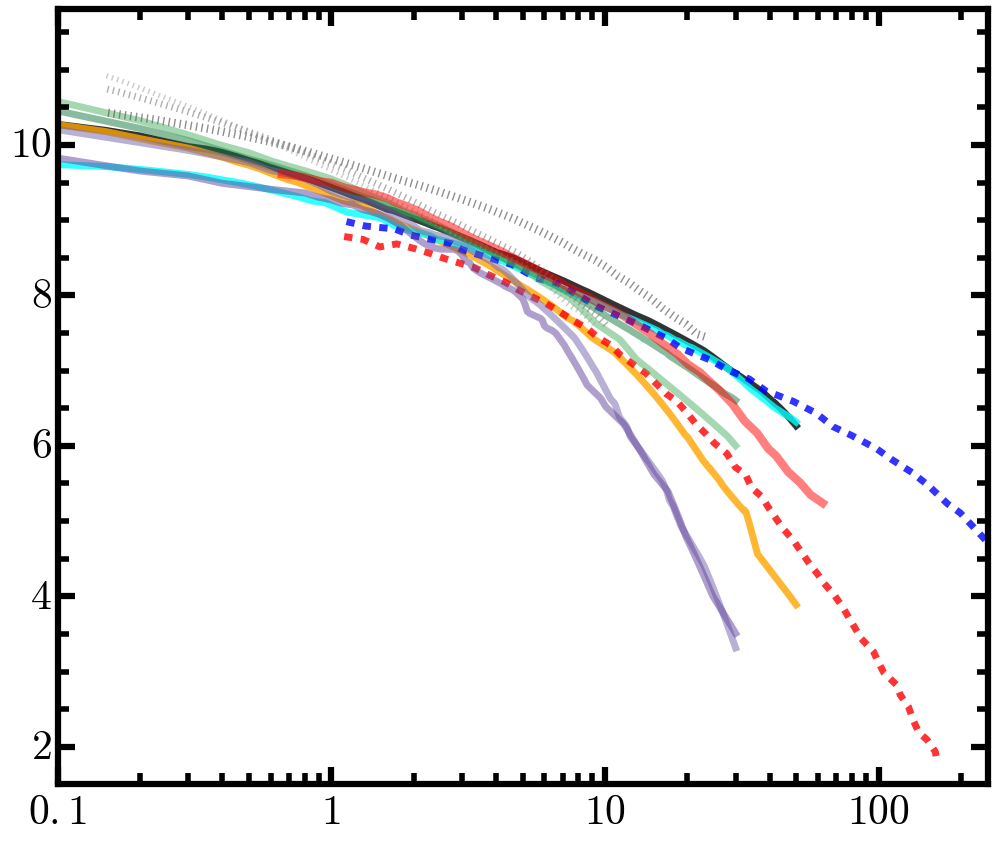

In [3]:
ancilDir = 'ancil'
if not os.path.isdir(ancilDir):
    raise Exception("# Can not find the ancil/ folder !")
    
"""
### Mass size relation from Huertas-Company et al. (2013)

* http://adsabs.harvard.edu/abs/2013ApJ...779...29H

* Single Sersic fits to SDSS images
* BC03+Kroupa IMF (+0.05 to convert into Chabrier IMF)
"""

logmC_hc13 = np.asarray([10.8, 11.2, 11.4, 11.6, 11.8])
logrC_hc13 = np.asarray([0.49, 0.774, 0.877, 1.101, 1.264])

logmS_hc13 = np.asarray([10.6, 10.8, 11.0, 11.2, 11.4, 11.6])
logrS_hc13 = np.asarray([0.389, 0.485, 0.616, 0.759, 0.891, 1.112])

"""
### Mass-size relation from van der Wel et al. (2014)

* http://adsabs.harvard.edu/abs/2014ApJ...788...28V

$\log(R/\mathrm{kpc}) = \log(A) + \alpha \times \log(M_{\star}/{5\times 10^{10} M_{\odot}})$

* GALFIT single Sersic fits; Corrected to rest-frame 5000 Angstrom
* Stellar mass was estimated using FAST BC03 template
"""

# z = 0.25 
logA_etg_z1_vdW14, a_etg_z1_vdW14 = 0.60, 0.75
logAerr_etg_z1_vdW14, aerr_etg_z1_vdW14 = 0.02, 0.06
logA_ltg_z1_vdW14, a_ltg_z1_vdW14 = 0.86, 0.25
logAerr_ltg_z1_vdW14, aerr_ltg_z1_vdW14 = 0.02, 0.02

# z = 1.75 
logA_etg_z2_vdW14, a_etg_z2_vdW14 = 0.09, 0.76
logAerr_etg_z2_vdW14, aerr_etg_z2_vdW14 = 0.01, 0.04
logA_ltg_z2_vdW14, a_ltg_z2_vdW14 = 0.65, 0.23
logAerr_ltg_z2_vdW14, aerr_ltg_z2_vdW14 = 0.01, 0.01

logM_etg_arr = np.asarray([10.0, 10.75, 11.25, 12.2]) 
logM_ltg_arr = np.asarray([10.0, 10.75, 11.25, 11.4]) 

logR_etg_z1_vdW14 = logA_etg_z1_vdW14 + a_etg_z1_vdW14 * np.log10((10.0 ** logM_etg_arr) / (5.0e10))
logR_ltg_z1_vdW14 = logA_ltg_z1_vdW14 + a_ltg_z1_vdW14 * np.log10((10.0 ** logM_ltg_arr) / (5.0e10))

logR_etg_z2_vdW14 = logA_etg_z2_vdW14 + a_etg_z2_vdW14 * np.log10((10.0 ** logM_etg_arr) / (5.0e10))
logR_ltg_z2_vdW14 = logA_ltg_z2_vdW14 + a_ltg_z2_vdW14 * np.log10((10.0 ** logM_ltg_arr) / (5.0e10))

"""
### i-band Luminosity function from Baldry et al. (2012)
"""

i_lf_B12 = Table.read(os.path.join(ancilDir, 'iband-lf-B12.txt'), 
                      format='ascii')

"""
### Stellar mass functions from previous works:
"""

mf_M13 = Table.read(os.path.join(ancilDir, 'smf_Moustakas_13.txt'), 
                    format='ascii')

mf_B13 = Table.read(os.path.join(ancilDir, 'smf_Bernardi_13_serExp.txt'), 
                    format='ascii')

mf_D15 = Table.read(os.path.join(ancilDir, 'smf_dSouza_15.txt'), 
                    format='ascii')

massCommon = np.arange(7.0, 13.0, 0.1)

"""
### Ellipticity and Color profiles from previous works of stacking SDSS galaxies
"""

# Stacked color profiles
## d'Souza 2015 g-r color profile 
dsouza15_gr = Table.read(os.path.join(ancilDir, 'dsouza15_gr_c26_11.0_11.4.txt'), 
                         format='ascii')

## La Babera 2014 g-r; Using Re as unit 
lababera14_gi = Table.read(os.path.join(ancilDir, 'lababera14_gi_avg.txt'), 
                           format='ascii')
lababera14_gr = Table.read(os.path.join(ancilDir, 'lababera14_gr_avg.txt'), 
                           format='ascii')
lababera14_gz = Table.read(os.path.join(ancilDir, 'lababera14_gz_avg.txt'), 
                           format='ascii')

## Tal & van Dokkum 2011; g-z; 
tal11_gz = Table.read(os.path.join(ancilDir, 'tal11_stack_gz.txt'), 
                      format='ascii')
## Tal & van Dokkum 2011; r-i
tal11_ri = Table.read(os.path.join(ancilDir, 'tal11_stack_ri.txt'), 
                      format='ascii')

# Stacked ellipticity profiles
## d'Souza 2015 
dsouza15_ell = Table.read(os.path.join(ancilDir, 'dsouza15_massive_ell.txt'), 
                          format='ascii')

## Tal & van Dokkum 2011l ell 
tal11_ell_1 = Table.read(os.path.join(ancilDir, 'tal11_stack_ell_nopsf.txt'), 
                         format='ascii')
tal11_ell_2 = Table.read(os.path.join(ancilDir, 'tal11_stack_ell_psf.txt'), 
                         format='ascii')


"""
### Stellar mass density profiles 
"""

# From CGS survey
cgs_mprof_full = Table.read(os.path.join(ancilDir, 'cgs_mprof_full.dat'), 
                            format='ascii')
cgs_mprof_inner = Table.read(os.path.join(ancilDir, 'cgs_mprof_inner.dat'), 
                             format='ascii')
cgs_mprof_outer = Table.read(os.path.join(ancilDir, 'cgs_mprof_outer.dat'), 
                             format='ascii')

# From Cooper+13 particle tagging methods
cooper13_mprof_all = Table.read(os.path.join(ancilDir, 'cooper13_13.5-14.0_all.dat'), 
                                format='ascii')
cooper13_mprof_ins = Table.read(os.path.join(ancilDir, 'cooper13_13.5-14.0_insitu.dat'), 
                                format='ascii')
cooper13_mprof_acc = Table.read(os.path.join(ancilDir, 'cooper13_13.5-14.0_accreted.dat'), 
                                format='ascii')

# From Patel+13 observations
patel10_mprof = Table.read(os.path.join(ancilDir, 'patel10_mprof.csv'),
                           format='csv')
# z0: z=0.06
# z1: 0.25 < z < 0.50
# z2: 0.50 < z < 1.00
# Z3: 1.00 < z < 1.50
# z4: 1.50 < z < 2.00
# z5: 2.00 < z < 2.50
# z6: 2.50 < z < 3.00

# From Szomoru+2012 
sz12_1 = Table.read(os.path.join(ancilDir, 'sz12_6187.dat'), 
                    format='ascii')
sz12_2 = Table.read(os.path.join(ancilDir, 'sz12_1831.dat'), 
                    format='ascii')
sz12_3 = Table.read(os.path.join(ancilDir, 'sz12_6097.dat'), 
                    format='ascii')

# Surface brightness profile of 10^11.71 Msun (Salpeter) BCG at z=1.1
liu13_prof = Table.read(os.path.join(ancilDir, 'liu13_hudf_bcg.txt'), 
                        format='ascii')

SUN_F125W = 4.562 
 
liu13_lum = (((SUN_F125W + 21.572) - liu13_prof['mu_r']) / 2.5) + 6.0

ax = plt.subplot(111)
ax.set_xscale("log", nonposy='clip')
ax = songPlotSetup(ax)

ax.plot(cgs_mprof_full['col1'], cgs_mprof_full['col2'], linestyle='-', c='k', 
        linewidth=5.0, alpha=0.8)
ax.plot(cgs_mprof_inner['col1'], cgs_mprof_inner['col2'], linestyle='-', c='orange',
        linewidth=5.0, alpha=0.8)
ax.plot(cgs_mprof_outer['col1'], cgs_mprof_outer['col2'], linestyle='-', c='cyan', 
        linewidth=5.0, alpha=0.8)

#ax.plot(10.0 ** cooper13_mprof_all['col1'], cooper13_mprof_all['col2'], 
#        linestyle='--', c='k')
ax.plot(10.0 ** cooper13_mprof_ins['col1'], cooper13_mprof_ins['col2'], 
        linestyle='--', c='r', linewidth=5.0, alpha=0.8)
ax.plot(10.0 ** cooper13_mprof_acc['col1'], cooper13_mprof_acc['col2'], 
        linestyle='--', c='b', linewidth=5.0, alpha=0.8)

#ax.plot(patel10_mprof['rkpc'], patel10_mprof['z0'], linestyle='-', c=GRN(0.9))
ax.plot(patel10_mprof['rkpc'], patel10_mprof['z1'], linestyle='-', c=GRN(0.8),
        linewidth=5.0, alpha=0.5)
#ax.plot(patel10_mprof['rkpc'], patel10_mprof['z2'], linestyle='-', c=GRN(0.7))
ax.plot(patel10_mprof['rkpc'], patel10_mprof['z3'], linestyle='-', c=GRN(0.6),
        linewidth=5.0, alpha=0.5)
#ax.plot(patel10_mprof['rkpc'], patel10_mprof['z4'], linestyle='-', c=PUR(0.6))
ax.plot(patel10_mprof['rkpc'], patel10_mprof['z5'], linestyle='-', c=PUR(0.7),
        linewidth=5.0, alpha=0.5)
ax.plot(patel10_mprof['rkpc'], patel10_mprof['z6'], linestyle='-', c=PUR(0.8),
        linewidth=5.0, alpha=0.5)

# Szomoru+12
ax.plot(sz12_1['col3'], sz12_1['col6'] - 0.05, linestyle=':', c=BLK(0.7), 
        linewidth=6.0, alpha=0.7)
ax.plot(sz12_2['col3'], sz12_2['col6'] - 0.05, linestyle=':', c=BLK(0.6), 
        linewidth=5.0, alpha=0.6)
ax.plot(sz12_3['col3'], sz12_3['col6'] - 0.05, linestyle=':', c=BLK(0.5), 
        linewidth=4.0, alpha=0.5)

# Liu+13
ax.plot((liu13_prof['rrkpc'] ** 4.0), (liu13_lum + 0.8), linestyle='-', c='r', 
        linewidth=6.0, alpha=0.5)

ax.set_xlim(0.1, 250.0)
ax.set_ylim(1.5, 11.8)

plt.show()

## Read in the parent sample catalogs

In [4]:
# Location of the data
homeDir = os.getenv('HOME')
sbpDir = os.path.join(homeDir, 'work/massive/dr15b/sbp/')

# Location for figures
figDir = os.path.join(sbpDir, 'figure')
# Location for subsamples
sampleDir = os.path.join(sbpDir, 'catalog')

masterDir = os.path.join(homeDir, 'work/massive/dr15b/master')

# The SED models 
# 'fsps1', 'fsps2', 'fsps3', 'fsps4', 'bc03a'
sedMod = 'fsps1'
# 'imgsub', 'img'
sbpType = 'imgsub'

# Catalog files for BCG and NonBCG
redbcgStr = 'dr1_redbcg_isedfit_mass_' + sedMod + '_sbpsum_' + sbpType + '_use'
nonbcgStr = 'dr1_nonbcg_isedfit_mass_' + sedMod + '_sbpsum_' + sbpType + '_use'
redmemStr = 'dr1_redmem_isedfit_mass_' + sedMod + '_sbpsum_' + sbpType + '_use'

redbcgFile = redbcgStr + '.fits' 
nonbcgFile = nonbcgStr + '.fits' 
redmemFile = redmemStr + '.fits'

# Output
redbcgPrep = redbcgFile.replace('.fits', '_prep.fits')
nonbcgPrep = nonbcgFile.replace('.fits', '_prep.fits')
redmemPrep = redmemFile.replace('.fits', '_prep.fits')

redbcgLab1 = '$\mathrm{cenLowMh}$'
redbcgLab2 = '$\mathrm{cenHighMh}$'
nonbcgLab = '$\mathrm{cenLowMh}$'

try:
    redbcgTab
except NameError:
    pass
else:
    del redbcgTab     
try:
    nonbcgTab
except NameError:
    pass
else:
    del nonbcgTab
    
# Location for the SBP summary file
redbcgDir = os.path.join(sbpDir, 'redbcg')
nonbcgDir = os.path.join(sbpDir, 'nonbcg')
redmemDir = os.path.join(sbpDir, 'redmem')

# Two summary catalogs
redbcgCat = os.path.join(sampleDir, redbcgFile)
nonbcgCat = os.path.join(sampleDir, nonbcgFile)
redmemCat = os.path.join(sampleDir, redmemFile)

prefix1 = 'redbcg'
prefix2 = 'nonbcg'
prefix3 = 'redmem'

In [5]:
# The CLEAN sample: 
redbcgClean = Table.read(os.path.join(sampleDir, redbcgFile.replace('.fits', '_clean.fits')), 
                         format='fits')
nonbcgClean = Table.read(os.path.join(sampleDir, nonbcgFile.replace('.fits', '_clean.fits')), 
                         format='fits')
redmemClean = Table.read(os.path.join(sampleDir, redmemFile.replace('.fits', '_clean.fits')), 
                         format='fits')

# The USE samples: 
redbcgUse = Table.read(os.path.join(sampleDir, redbcgFile.replace('.fits', '_use.fits')), 
                         format='fits')
nonbcgUse = Table.read(os.path.join(sampleDir, nonbcgFile.replace('.fits', '_use.fits')), 
                         format='fits')
redmemUse = Table.read(os.path.join(sampleDir, redmemFile.replace('.fits', '_use.fits')), 
                         format='fits')

# The GAMA sample
redbcgGama = Table.read(os.path.join(sampleDir, redbcgFile.replace('.fits', '_gama.fits')), 
                        format='fits')
nonbcgGama = Table.read(os.path.join(sampleDir, nonbcgFile.replace('.fits', '_gama.fits')), 
                        format='fits')

redbcgGamaZ = Table.read(os.path.join(sampleDir, redbcgFile.replace('.fits', '_gamaz.fits')), 
                         format='fits')
nonbcgGamaZ = Table.read(os.path.join(sampleDir, nonbcgFile.replace('.fits', '_gamaz.fits')), 
                         format='fits')

# Stripe 82 
s82data = Table.read(os.path.join(masterDir, 'dr1_s82_clean_zbin_isedfit_fsps2.fits'), 
                     format='fits')

In [6]:
aa = Table([redbcgClean['z_use'], redbcgClean['logm_100'], redbcgClean['MSTAR'], redbcgClean['logm_150']])
bb = Table([nonbcgClean['z_use'], nonbcgClean['logm_100'], nonbcgClean['MSTAR'], nonbcgClean['logm_150']])
cc = Table([redmemClean['z_use'], redmemClean['logm_100'], redmemClean['MSTAR'], redmemClean['logm_150']])

from astropy.table import vstack
massAll = vstack([aa, bb, cc])

## Read in the mass-redshift matched subsamples

In [7]:
lamLimit, pcenLimit = 30.0, 0.7

sampleM100x = 'matchX_m100_' + sedMod
sampleM100a = 'matchA1_m100_' + sedMod
sampleM100b = 'matchA2_m100_' + sedMod
sampleM100c = 'matchA_m100_' + sedMod
sampleM100d = 'matchB_m100_' + sedMod
sampleM100e = 'matchC_m100_' + sedMod
sampleM100f = 'matchD_m100_' + sedMod
sampleM100g = 'matchG_m100_' + sedMod
sampleM100h = 'matchH_m100_' + sedMod
sampleM100i = 'matchI_m100_' + sedMod
sampleM100j = 'matchJ_m100_' + sedMod
sampleM100k = 'matchK_m100_' + sedMod
sampleM100l = 'matchL_m100_' + sedMod
sampleM100o = 'matchO_m100_' + sedMod

sampleM100y = 'matchY_m100_' + sedMod
sampleM100z = 'matchZ_m100_' + sedMod
sampleM100q = 'matchQ_m100_' + sedMod
sampleM100w = 'matchW_m100_' + sedMod

sampleM10x = 'matchX_m10_' + sedMod
sampleM10a = 'matchA1_m10_' + sedMod
sampleM10b = 'matchA2_m10_' + sedMod
sampleM10c = 'matchA_m10_' + sedMod
sampleM10d = 'matchB_m10_' + sedMod
sampleM10f = 'matchD_m10_' + sedMod
sampleM10g = 'matchG_m10_' + sedMod
sampleM10h = 'matchH_m10_' + sedMod
sampleM10m = 'matchM_m10_' + sedMod
sampleM10n = 'matchN_m10_' + sedMod
sampleM10l = 'matchL_m10_' + sedMod
sampleM10o = 'matchO_m10_' + sedMod

try: 
    redbcgM100x = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM100x + '.fits'),
                             format='fits')
    nonbcgM100x = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM100x + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM100x, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM100x, sedMod))
    
try: 
    redbcgM100a = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM100a + '.fits'),
                             format='fits')
    nonbcgM100a = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM100a + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM100a, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM100a, sedMod))
    
try:
    redbcgM100b = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM100b + '.fits'),
                             format='fits')
    nonbcgM100b = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM100b + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM100b, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM100b, sedMod))
    
try:
    redbcgM100c = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM100c + '.fits'),
                             format='fits')
    nonbcgM100c = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM100c + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM100c, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM100c, sedMod))
    
try:
    redbcgM100d = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM100d + '.fits'),
                             format='fits')
    nonbcgM100d = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM100d + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM100d, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM100d, sedMod))

try:
    redbcgM100e = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM100e + '.fits'),
                             format='fits')
    nonbcgM100e = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM100e + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM100e, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM100e, sedMod))

try:
    redbcgM100f = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM100f + '.fits'),
                             format='fits')
    nonbcgM100f = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM100f + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM100f, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM100f, sedMod))
    
try:
    redbcgM100j = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM100j + '.fits'),
                             format='fits')
    nonbcgM100j = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM100j + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM100j, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM100j, sedMod))
    
try:
    redbcgM100k = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM100k + '.fits'),
                             format='fits')
    nonbcgM100k = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM100k + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM100k, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM100k, sedMod))

try:
    redbcgM100l = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM100l + '.fits'),
                             format='fits')
    nonbcgM100l = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM100l + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM100l, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM100l, sedMod))
    
try:
    redbcgM100i = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM100i + '.fits'),
                             format='fits')
    nonbcgM100i = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM100i + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM100i, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM100i, sedMod))
    
try:
    redbcgM10x = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM10x + '.fits'),
                             format='fits')
    nonbcgM10x = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM10x + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM10x, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM10x, sedMod))
    
try:
    redbcgM10a = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM10a + '.fits'),
                             format='fits')
    nonbcgM10a = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM10a + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM10a, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM10a, sedMod))
    
try:
    redbcgM10b = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM10b + '.fits'),
                             format='fits')
    nonbcgM10b = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM10b + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM10b, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM10b, sedMod))
    
try:
    redbcgM10c = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM10c + '.fits'),
                             format='fits')
    nonbcgM10c = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM10c + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM10c, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM10c, sedMod))
    
try:
    redbcgM10d = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM10d + '.fits'),
                             format='fits')
    nonbcgM10d = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM10d + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM10d, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM10d, sedMod))
    
try:
    redbcgM10f = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM10f + '.fits'),
                             format='fits')
    nonbcgM10f = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM10f + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM10f, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM10f, sedMod))
    
try:
    redbcgM100g = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM100g + '.fits'),
                             format='fits')
    redmemM100g = Table.read(os.path.join(sampleDir, 
                                          'redMem_' + sampleM100g + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM100g, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM100g, sedMod))
    
try:
    redbcgM10g = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM10g + '.fits'),
                             format='fits')
    redmemM10g = Table.read(os.path.join(sampleDir, 
                                          'redMem_' + sampleM10g + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM10g, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM10g, sedMod))
    

try:
    nonbcgM100h = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM100h + '.fits'),
                             format='fits')
    redmemM100h = Table.read(os.path.join(sampleDir, 
                                          'redMem_' + sampleM100h + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM100h, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM100h, sedMod))
    
try:
    nonbcgM10h = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM10h + '.fits'),
                             format='fits')
    redmemM10h = Table.read(os.path.join(sampleDir, 
                                          'redMem_' + sampleM10h + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM10h, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM10h, sedMod))
    
    
try: 
    redbcgM100y = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM100y + '.fits'),
                             format='fits')
    nonbcgM100y = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM100y + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM100y, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM100y, sedMod))
    
try: 
    redbcgM100z = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM100z + '.fits'),
                             format='fits')
    nonbcgM100z = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM100z + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM100z, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM100z, sedMod))
    
try: 
    redbcgM100q = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM100q + '.fits'),
                             format='fits')
    nonbcgM100q = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM100q + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM100q, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM100q, sedMod))
    
try: 
    redbcgM100w = Table.read(os.path.join(sampleDir, 
                                          'redBCG_' + sampleM100w + '.fits'),
                             format='fits')
    nonbcgM100w = Table.read(os.path.join(sampleDir, 
                                          'nonBCG_' + sampleM100w + '.fits'),
                             format='fits')
    print("## Load: %s, %s" % (sampleM100w, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM100w, sedMod))
    
try: 
    redbcgM10m = Table.read(os.path.join(sampleDir, 
                                         'redBCG_' + sampleM10m + '.fits'),
                            format='fits')
    nonbcgM10m = Table.read(os.path.join(sampleDir, 
                                         'nonBCG_' + sampleM10m + '.fits'),
                            format='fits')
    print("## Load: %s, %s" % (sampleM10m, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM10m, sedMod))
    
try: 
    redbcgM10n = Table.read(os.path.join(sampleDir, 
                                         'redBCG_' + sampleM10n + '.fits'),
                            format='fits')
    nonbcgM10n = Table.read(os.path.join(sampleDir, 
                                         'nonBCG_' + sampleM10n + '.fits'),
                            format='fits')
    print("## Load: %s, %s" % (sampleM10n, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM10n, sedMod))
    
try: 
    redbcgM10l = Table.read(os.path.join(sampleDir, 
                                         'redBCG_' + sampleM10l + '.fits'),
                            format='fits')
    nonbcgM10l = Table.read(os.path.join(sampleDir, 
                                         'nonBCG_' + sampleM10l + '.fits'),
                            format='fits')
    print("## Load: %s, %s" % (sampleM10l, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM10l, sedMod))
    
try: 
    redbcgM100o = Table.read(os.path.join(sampleDir, 
                                         'redBCG_' + sampleM100o + '.fits'),
                            format='fits')
    nonbcgM100o = Table.read(os.path.join(sampleDir, 
                                         'nonBCG_' + sampleM100o + '.fits'),
                            format='fits')
    print("## Load: %s, %s" % (sampleM100o, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM100o, sedMod))
    
try: 
    redbcgM10o = Table.read(os.path.join(sampleDir, 
                                         'redBCG_' + sampleM10o + '.fits'),
                            format='fits')
    nonbcgM10o = Table.read(os.path.join(sampleDir, 
                                         'nonBCG_' + sampleM10o + '.fits'),
                            format='fits')
    print("## Load: %s, %s" % (sampleM10o, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM10o, sedMod))

## Load: matchX_m100_fsps1, fsps1
## Load: matchA1_m100_fsps1, fsps1
## Load: matchA2_m100_fsps1, fsps1
## Load: matchA_m100_fsps1, fsps1
## Load: matchB_m100_fsps1, fsps1
## Load: matchC_m100_fsps1, fsps1
## Load: matchD_m100_fsps1, fsps1
## Load: matchJ_m100_fsps1, fsps1
## Load: matchK_m100_fsps1, fsps1
## Load: matchL_m100_fsps1, fsps1
## Load: matchI_m100_fsps1, fsps1
## Load: matchX_m10_fsps1, fsps1
## Load: matchA1_m10_fsps1, fsps1
## Load: matchA2_m10_fsps1, fsps1
## Load: matchA_m10_fsps1, fsps1
## Load: matchB_m10_fsps1, fsps1
## Load: matchD_m10_fsps1, fsps1
## Load: matchG_m100_fsps1, fsps1
## Load: matchG_m10_fsps1, fsps1
## Load: matchH_m100_fsps1, fsps1
## Load: matchH_m10_fsps1, fsps1
## Load: matchY_m100_fsps1, fsps1
## Load: matchZ_m100_fsps1, fsps1
## Load: matchQ_m100_fsps1, fsps1
## Load: matchW_m100_fsps1, fsps1
## Load: matchM_m10_fsps1, fsps1
## Load: matchN_m10_fsps1, fsps1
## Load: matchL_m10_fsps1, fsps1
## Load: matchO_m100_fsps1, fsps1
## Load: matchO_m10_f

In [8]:
sampleM150o = 'matchO_m150_' + sedMod
try: 
    redbcgM150o = Table.read(os.path.join(sampleDir, 
                                         'redBCG_' + sampleM150o + '.fits'),
                            format='fits')
    nonbcgM150o = Table.read(os.path.join(sampleDir, 
                                         'nonBCG_' + sampleM150o + '.fits'),
                            format='fits')
    print("## Load: %s, %s" % (sampleM150o, sedMod))
except Exception: 
    print("## Problem when loading: %s, %s" % (sampleM150o, sedMod))

## Load: matchO_m150_fsps1, fsps1


In [30]:
print(np.nanmedian(redbcgM100c['logm_100']))
print(np.nanmedian(nonbcgM100c['logm_100']))

11.7437730335
11.7445588817


In [68]:
print(np.nanmedian(redbcgM10o['logm_100']))
print(np.nanmedian(nonbcgM10o['logm_100']))

11.8024680683
11.6480929035


In [69]:
print(np.nanmedian(redbcgM10o['logm_10']))
print(np.nanmedian(nonbcgM10o['logm_10']))

11.3775416725
11.3764994043


## Load the 1-D profiles of above samples

In [118]:
sampleM100x = 'matchX_m100_' + sedMod
sampleM100a = 'matchA1_m100_' + sedMod
sampleM100b = 'matchA2_m100_' + sedMod
sampleM100c = 'matchA_m100_' + sedMod
sampleM100d = 'matchB_m100_' + sedMod
sampleM100e = 'matchC_m100_' + sedMod
sampleM100f = 'matchD_m100_' + sedMod
sampleM100g = 'matchG_m100_' + sedMod
sampleM100h = 'matchH_m100_' + sedMod
sampleM100i = 'matchI_m100_' + sedMod
sampleM100j = 'matchJ_m100_' + sedMod
sampleM100k = 'matchK_m100_' + sedMod
sampleM100l = 'matchL_m100_' + sedMod
sampleM100q = 'matchQ_m100_' + sedMod
sampleM100y = 'matchY_m100_' + sedMod
sampleM100z = 'matchZ_m100_' + sedMod
sampleM100o = 'matchO_m100_' + sedMod
sampleM100w = 'matchW_m100_' + sedMod

sampleM10x = 'matchX_m10_' + sedMod
sampleM10a = 'matchA1_m10_' + sedMod
sampleM10b = 'matchA2_m10_' + sedMod
sampleM10c = 'matchA_m10_' + sedMod
sampleM10d = 'matchB_m10_' + sedMod
sampleM10f = 'matchD_m10_' + sedMod
sampleM10g = 'matchG_m10_' + sedMod
sampleM10h = 'matchH_m10_' + sedMod
sampleM10m = 'matchM_m10_' + sedMod
sampleM10n = 'matchN_m10_' + sedMod
sampleM10l = 'matchL_m10_' + sedMod
sampleM10o = 'matchO_m10_' + sedMod

try:
    redbcgProfM100x = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM100x + '_profs.pkl'))
    nonbcgProfM100x = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM100x + '_profs.pkl'))
    print("## Load: %s" % sampleM100x)
except Exception: 
    print("## Problem loading: %s" % sampleM100x)
    
try:
    redbcgProfM100a = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM100a + '_profs.pkl'))
    nonbcgProfM100a = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM100a + '_profs.pkl'))
    print("## Load: %s" % sampleM100a)
except Exception: 
    print("## Problem loading: %s" % sampleM100a)
    
try:
    redbcgProfM100b = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM100b + '_profs.pkl'))
    nonbcgProfM100b = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM100b + '_profs.pkl'))
    print("## Load: %s" % sampleM100b)
except Exception: 
    print("## Problem loading: %s" % sampleM100b)
    
try:
    redbcgProfM100c = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM100c + '_profs.pkl'))
    nonbcgProfM100c = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM100c + '_profs.pkl'))
    print("## Load: %s" % sampleM100c)
except Exception: 
    print("## Problem loading: %s" % sampleM100c)
    
try:
    redbcgProfM100d = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM100d + '_profs.pkl'))
    nonbcgProfM100d = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM100d + '_profs.pkl'))
    print("## Load: %s" % sampleM100d)
except Exception: 
    print("## Problem loading: %s" % sampleM100d)
    
try:
    redbcgProfM100e = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM100e + '_profs.pkl'))
    nonbcgProfM100e = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM100e + '_profs.pkl'))
    print("## Load: %s" % sampleM100e)
except Exception: 
    print("## Problem loading: %s" % sampleM100e)
    
try:
    redbcgProfM100f = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM100f + '_profs.pkl'))
    nonbcgProfM100f = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM100f + '_profs.pkl'))
    print("## Load: %s" % sampleM100f)
except Exception: 
    print("## Problem loading: %s" % sampleM100f)
    
try:
    redbcgProfM100i = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM100i + '_profs.pkl'))
    nonbcgProfM100i = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM100i + '_profs.pkl'))
    print("## Load: %s" % sampleM100i)
except Exception: 
    print("## Problem loading: %s" % sampleM100i)

try:
    redbcgProfM100j = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM100j + '_profs.pkl'))
    nonbcgProfM100j = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM100j + '_profs.pkl'))
    print("## Load: %s" % sampleM100j)
except Exception: 
    print("## Problem loading: %s" % sampleM100j)
    
try:
    redbcgProfM100k = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM100k + '_profs.pkl'))
    nonbcgProfM100k = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM100k + '_profs.pkl'))
    print("## Load: %s" % sampleM100k)
except Exception: 
    print("## Problem loading: %s" % sampleM100k)
    
try:
    redbcgProfM100l = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM100l + '_profs.pkl'))
    nonbcgProfM100l = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM100l + '_profs.pkl'))
    print("## Load: %s" % sampleM100l)
except Exception: 
    print("## Problem loading: %s" % sampleM100l)
    
try:
    redbcgProfM100q = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM100q + '_profs.pkl'))
    nonbcgProfM100q = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM100q + '_profs.pkl'))
    print("## Load: %s" % sampleM100q)
except Exception: 
    print("## Problem loading: %s" % sampleM100q)
    
try:
    redbcgProfM100y = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM100y + '_profs.pkl'))
    nonbcgProfM100y = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM100y + '_profs.pkl'))
    print("## Load: %s" % sampleM100y)
except Exception: 
    print("## Problem loading: %s" % sampleM100y)
    
try:
    redbcgProfM100z = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM100z + '_profs.pkl'))
    nonbcgProfM100z = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM100z + '_profs.pkl'))
    print("## Load: %s" % sampleM100z)
except Exception: 
    print("## Problem loading: %s" % sampleM100z)

#-----------------------------------------#
try:
    redbcgProfM10x = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM10x + '_profs.pkl'))
    nonbcgProfM10x = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM10x + '_profs.pkl'))
    print("## Load: %s" % sampleM10x)
except Exception: 
    print("## Problem loading: %s" % sampleM10x)
    
try:
    redbcgProfM10a = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM10a + '_profs.pkl'))
    nonbcgProfM10a = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM10a + '_profs.pkl'))
    print("## Load: %s" % sampleM10a)
except Exception: 
    print("## Problem loading: %s" % sampleM10a)
    
try:
    redbcgProfM10b = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM10b + '_profs.pkl'))
    nonbcgProfM10b = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM10b + '_profs.pkl'))
    print("## Load: %s" % sampleM10b)
except Exception: 
    print("## Problem loading: %s" % sampleM10b)
    
try:
    redbcgProfM10c = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM10c + '_profs.pkl'))
    nonbcgProfM10c = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM10c + '_profs.pkl'))
    print("## Load: %s" % sampleM10c)
except Exception: 
    print("## Problem loading: %s" % sampleM10c)
    
try:
    redbcgProfM10d = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM10d + '_profs.pkl'))
    nonbcgProfM10d = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM10d + '_profs.pkl'))
    print("## Load: %s" % sampleM10d)
except Exception: 
    print("## Problem loading: %s" % sampleM10d)
    
try:
    redbcgProfM10f = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM10f + '_profs.pkl'))
    nonbcgProfM10f = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM10f + '_profs.pkl'))
    print("## Load: %s" % sampleM10f)
except Exception: 
    print("## Problem loading: %s" % sampleM10f)
    
#-----------------------------------------#
try:
    redbcgProfM100g = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM100g + '_profs.pkl'))
    redmemProfM100g = loadPkl(os.path.join(redmemDir, prefix2 + "_" + sampleM100g + '_profs.pkl'))
    print("## Load: %s" % sampleM100g)
except Exception: 
    print("## Problem loading: %s" % sampleM100g)
    
try:
    redbcgProfM10g = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM10g + '_profs.pkl'))
    redmemProfM10g = loadPkl(os.path.join(redmemDir, prefix2 + "_" + sampleM10g + '_profs.pkl'))
    print("## Load: %s" % sampleM10g)
except Exception: 
    print("## Problem loading: %s" % sampleM10g)
    
try:
    nonbcgProfM100h = loadPkl(os.path.join(nonbcgDir, prefix1 + "_" + sampleM100h + '_profs.pkl'))
    redmemProfM100h = loadPkl(os.path.join(redmemDir, prefix2 + "_" + sampleM100h + '_profs.pkl'))
    print("## Load: %s" % sampleM100h)
except Exception: 
    print("## Problem loading: %s" % sampleM100h)
    
try:
    nonbcgProfM10h = loadPkl(os.path.join(nonbcgDir, prefix1 + "_" + sampleM10h + '_profs.pkl'))
    redmemProfM10h = loadPkl(os.path.join(redmemDir, prefix2 + "_" + sampleM10h + '_profs.pkl'))
    print("## Load: %s" % sampleM10h)
except Exception: 
    print("## Problem loading: %s" % sampleM10h)
    
#-----------------------------------------#
try:
    redbcgProfM10m = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM10m + '_profs.pkl'))
    nonbcgProfM10m = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM10m + '_profs.pkl'))
    print("## Load: %s" % sampleM10m)
except Exception: 
    print("## Problem loading: %s" % sampleM10m)
    
try:
    redbcgProfM10n = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM10n + '_profs.pkl'))
    nonbcgProfM10n = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM10n + '_profs.pkl'))
    print("## Load: %s" % sampleM10n)
except Exception: 
    print("## Problem loading: %s" % sampleM10n)
    
try:
    redbcgProfM10l = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM10l + '_profs.pkl'))
    nonbcgProfM10l = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM10l + '_profs.pkl'))
    print("## Load: %s" % sampleM10l)
except Exception: 
    print("## Problem loading: %s" % sampleM10l)
    
try:
    redbcgProfM100o = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM100o + '_profs.pkl'))
    nonbcgProfM100o = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM100o + '_profs.pkl'))
    print("## Load: %s" % sampleM100o)
except Exception: 
    print("## Problem loading: %s" % sampleM100o)
    
try:
    redbcgProfM10o = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM10o + '_profs.pkl'))
    nonbcgProfM10o = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM10o + '_profs.pkl'))
    print("## Load: %s" % sampleM10o)
except Exception: 
    print("## Problem loading: %s" % sampleM10o)
    
try:
    redbcgProfM100w = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM100w + '_profs.pkl'))
    nonbcgProfM100w = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM100w + '_profs.pkl'))
    print("## Load: %s" % sampleM100w)
except Exception: 
    print("## Problem loading: %s" % sampleM100w)

## Load: matchX_m100_fsps1
## Load: matchA1_m100_fsps1
## Load: matchA2_m100_fsps1
## Load: matchA_m100_fsps1
## Load: matchB_m100_fsps1
## Load: matchC_m100_fsps1
## Load: matchD_m100_fsps1
## Load: matchI_m100_fsps1
## Load: matchJ_m100_fsps1
## Load: matchK_m100_fsps1
## Load: matchL_m100_fsps1
## Load: matchQ_m100_fsps1
## Load: matchY_m100_fsps1
## Load: matchZ_m100_fsps1
## Load: matchX_m10_fsps1
## Load: matchA1_m10_fsps1
## Load: matchA2_m10_fsps1
## Load: matchA_m10_fsps1
## Load: matchB_m10_fsps1
## Load: matchD_m10_fsps1
## Load: matchG_m100_fsps1
## Load: matchG_m10_fsps1
## Load: matchH_m100_fsps1
## Load: matchH_m10_fsps1
## Load: matchM_m10_fsps1
## Load: matchN_m10_fsps1
## Load: matchL_m10_fsps1
## Load: matchO_m100_fsps1
## Load: matchO_m10_fsps1
## Load: matchW_m100_fsps1


In [119]:
try:
    redbcgProfM150o = loadPkl(os.path.join(redbcgDir, prefix1 + "_" + sampleM150o + '_profs.pkl'))
    nonbcgProfM150o = loadPkl(os.path.join(nonbcgDir, prefix2 + "_" + sampleM150o + '_profs.pkl'))
    print("## Load: %s" % sampleM150o)
except Exception: 
    print("## Problem loading: %s" % sampleM150o)

## Load: matchO_m150_fsps1


In [17]:
try:
    redbcgProfMbin0 = loadPkl(os.path.join(redbcgDir, prefix1 + '_fsps1_MBin0_profs.pkl'))
    redbcgProfMbin1 = loadPkl(os.path.join(redbcgDir, prefix1 + '_fsps1_MBin1_profs.pkl'))
    redbcgProfMbin2 = loadPkl(os.path.join(redbcgDir, prefix1 + '_fsps1_MBin2_profs.pkl'))
    redbcgProfMbin3 = loadPkl(os.path.join(redbcgDir, prefix1 + '_fsps1_MBin3_profs.pkl'))
    nonbcgProfMbin0 = loadPkl(os.path.join(nonbcgDir, prefix2 + '_fsps1_MBin0_profs.pkl'))
    nonbcgProfMbin1 = loadPkl(os.path.join(nonbcgDir, prefix2 + '_fsps1_MBin1_profs.pkl'))
    nonbcgProfMbin2 = loadPkl(os.path.join(nonbcgDir, prefix2 + '_fsps1_MBin2_profs.pkl'))
    
    redbcgProfZbin1 = loadPkl(os.path.join(redbcgDir, prefix1 + '_fsps1_ZBin1_profs.pkl'))
    redbcgProfZbin2 = loadPkl(os.path.join(redbcgDir, prefix1 + '_fsps1_ZBin2_profs.pkl'))
    nonbcgProfZbin1 = loadPkl(os.path.join(nonbcgDir, prefix2 + '_fsps1_ZBin1_profs.pkl'))
    nonbcgProfZbin2 = loadPkl(os.path.join(nonbcgDir, prefix2 + '_fsps1_ZBin2_profs.pkl'))
except Exception: 
    print("## Problem loading certain profiles")

In [24]:
len(nonbcgProfMbin1)

737

# Stellar mass volume-density distributions & stellar mass differences

## Stellar mass volume-density distributions

In [39]:
# Area and redshift limit
redbcgArea = 99.0
redmemArea = 99.0
nonbcgArea = 99.0
s82Area = 29.0

zLow, zUpp = 0.30, 0.50 

# Stellar mass function using cModel luminosity
mbin, nonbcgMAll1 = getMassFunction(nonbcgUse, massCol='MSTAR', 
                                    area=nonbcgArea, errValue=0.09, 
                                    returnAll=True, minVal=1.0E-8,
                                    verbose=True, zLow=zLow, zUpp=zUpp)
nonbcgMLow1 = np.nanpercentile(nonbcgMAll1, 3.0, axis=0)
nonbcgMUpp1 = np.nanpercentile(nonbcgMAll1, 97.0, axis=0)
nonbcgMMed1 = np.nanmedian(nonbcgMAll1, axis=0)

mbin, redbcgMAll1 = getMassFunction(redbcgUse, massCol='MSTAR', 
                                    area=redbcgArea, errValue=0.09, 
                                    returnAll=True, minVal=1.0E-8,
                                    verbose=True, zLow=zLow, zUpp=zUpp)
redbcgMLow1 = np.nanpercentile(redbcgMAll1, 3.0, axis=0)
redbcgMUpp1 = np.nanpercentile(redbcgMAll1, 97.0, axis=0)
redbcgMMed1 = np.nanmedian(redbcgMAll1, axis=0)


# Test for S82 region: 
nonbcgS82 = Table.read(os.path.join(sampleDir, 'dr1_nonbcg_s82_match.fits'),
                       format='fits')

mbin, nonbcgMS82 = getMassFunction(nonbcgS82, massCol='logm_100', 
                                   area=12.0, errValue=0.09, 
                                   returnAll=True, minVal=1.0E-8,
                                   verbose=True, zLow=zLow, zUpp=zUpp)
nonbcgMLowS82 = np.nanpercentile(nonbcgMS82, 3.0, axis=0)
nonbcgMUppS82 = np.nanpercentile(nonbcgMS82, 97.0, axis=0)
nonbcgMMedS82 = np.nanmedian(nonbcgMS82, axis=0)


# Stellar mass function using integrated luminosity out to 100 kpc 
mbin, nonbcgMAll2 = getMassFunction(nonbcgUse, massCol='logm_100', 
                                    area=nonbcgArea, errValue=0.09, 
                                    returnAll=True, minVal=1.0E-8, 
                                    zLow=zLow, zUpp=zUpp)
nonbcgMLow2 = np.nanpercentile(nonbcgMAll2, 3.0, axis=0)
nonbcgMUpp2 = np.nanpercentile(nonbcgMAll2, 97.0, axis=0)
nonbcgMMed2 = np.nanmedian(nonbcgMAll2, axis=0)

mbin, redbcgMAll2 = getMassFunction(redbcgUse, massCol='logm_100', 
                                    area=redbcgArea, errValue=0.09, 
                                    returnAll=True, minVal=1.0E-8, 
                                    zLow=zLow, zUpp=zUpp)
redbcgMLow2 = np.nanpercentile(redbcgMAll2, 3.0, axis=0)
redbcgMUpp2 = np.nanpercentile(redbcgMAll2, 97.0, axis=0)
redbcgMMed2 = np.nanmedian(redbcgMAll2, axis=0)


# Estimate the density distribution for S82 galaxies 
# Stellar mass function using cModel luminosity
s82Use = s82data[(s82data['ZBEST'] <= 0.55) & 
                 (s82data['ZBEST'] >= 0.25) & 
                 (s82data['CHI2'] <= 80.0)]

mbin, s82MAll2 = getMassFunction(s82Use, massCol='MSTAR', zCol='ZBEST',
                                 area=s82Area, errValue=0.10, 
                                 returnAll=True, minVal=1.0E-8,
                                 verbose=True, zLow=0.25, zUpp=0.55)
s82MLow2 = np.nanpercentile(s82MAll2, 3.0, axis=0)
s82MUpp2 = np.nanpercentile(s82MAll2, 97.0, axis=0)
s82MMed2 = np.nanmedian(s82MAll2, axis=0)

# Use fixed error value:  0.09
# Sample include 3763 / 5889 galaxies
# The deltaVolume is   50558376.412 Mpc^3


/usr/local/lib/python2.7/site-packages/numpy/lib/function_base.py:583: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= mn)
/usr/local/lib/python2.7/site-packages/numpy/lib/function_base.py:584: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= mx)


# Use fixed error value:  0.09
# Sample include 115 / 146 galaxies
# The deltaVolume is   49780406.484 Mpc^3
# Use fixed error value:  0.09
# Sample include 596 / 760 galaxies
# The deltaVolume is    6126667.065 Mpc^3
# Use fixed error value:  0.10
# Sample include 21349 / 22045 galaxies
# The deltaVolume is   17813218.561 Mpc^3


In [53]:
# Stellar mass function using cModel luminosity
massUse = massAll[(massAll['z_use'] >= 0.3) & 
                  (massAll['z_use'] <= 0.5)]
print(len(massUse))

mbin, massAllM1 = getMassFunction(massUse, massCol='MSTAR', 
                                  area=nonbcgArea, errValue=0.08, 
                                  returnAll=True, minVal=1.0E-8,
                                  verbose=True, zLow=zLow, zUpp=zUpp)
massAllMLow1 = np.nanpercentile(massAllM1, 3.0, axis=0)
massAllMUpp1 = np.nanpercentile(massAllM1, 97.0, axis=0)
massAllMMed1 = np.nanmedian(massAllM1, axis=0)

mbin, massAllM2 = getMassFunction(massUse, massCol='logm_100', 
                                  area=nonbcgArea, errValue=0.08, 
                                  returnAll=True, minVal=1.0E-8,
                                  verbose=True, zLow=zLow, zUpp=zUpp)
massAllMLow2 = np.nanpercentile(massAllM2, 3.0, axis=0)
massAllMUpp2 = np.nanpercentile(massAllM2, 97.0, axis=0)
massAllMMed2 = np.nanmedian(massAllM2, axis=0)

mbin, massAllM3 = getMassFunction(massUse, massCol='logm_150', 
                                  area=nonbcgArea, errValue=0.08, 
                                  returnAll=True, minVal=1.0E-8,
                                  verbose=True, zLow=zLow, zUpp=zUpp)
massAllMLow3 = np.nanpercentile(massAllM3, 3.0, axis=0)
massAllMUpp3 = np.nanpercentile(massAllM3, 97.0, axis=0)
massAllMMed3 = np.nanmedian(massAllM3, axis=0)

4431
# Use fixed error value:  0.08
# Sample include 4431 / 4431 galaxies
# The deltaVolume is   50558376.412 Mpc^3
# Use fixed error value:  0.08
# Sample include 4431 / 4431 galaxies
# The deltaVolume is   50558376.412 Mpc^3
# Use fixed error value:  0.08
# Sample include 4410 / 4431 galaxies
# The deltaVolume is   50558376.412 Mpc^3


/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:1562: RuntimeWarning: invalid value encountered in greater_equal
/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:1562: RuntimeWarning: invalid value encountered in less_equal


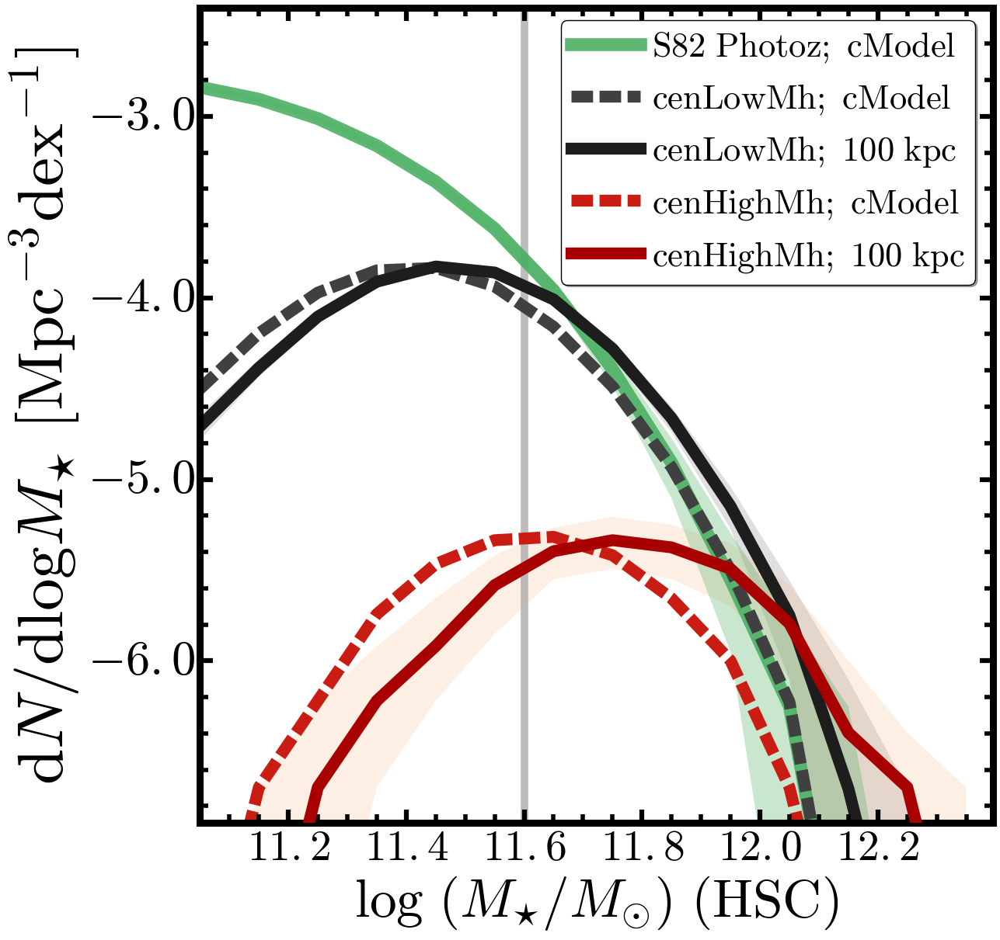

In [58]:
fig = plt.figure(figsize=(13, 12))
fig.subplots_adjust(left=0.21, right=0.995, 
                    bottom=0.12, top=0.995,
                    wspace=0.00, hspace=0.00)

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=40, ylabel=45, border=6.5,
                    xtickFormat='$\mathrm{%4.1f}$', 
                    ytickFormat='$\mathrm{%4.1f}$')

# S82 
ax1.fill_between(mbin, s82MLow2, s82MUpp2, facecolor=GRN(0.6), 
                 edgecolor='none', alpha=0.30, zorder=1, rasterized=True)
ax1.plot(mbin, s82MMed2, c=GRN(0.6), linestyle='-', 
         linewidth=12.0, zorder=1, alpha=0.9,
         label='$\mathrm{S82\ Photoz};\ \mathrm{cModel}$', rasterized=True)

# nonbcg
ax1.fill_between(mbin, nonbcgMLow2, nonbcgMUpp2, facecolor=BLK(0.5), 
                 edgecolor='none', alpha=0.3, zorder=0, rasterized=True)
ax1.plot(mbin, nonbcgMMed1, c=BLK(0.8), linestyle='--', linewidth=11.0,
         label='$\mathrm{cenLowMh};\ \mathrm{cModel}$', zorder=2, 
         dashes=(20, 6), rasterized=True)
ax1.plot(mbin, nonbcgMMed2, c=BLK(0.9), linewidth=11.0,
         label='$\mathrm{cenLowMh};\ \mathrm{100\ kpc}$', zorder=2, 
         rasterized=True)

# redbcg
ax1.fill_between(mbin, redbcgMLow2, redbcgMUpp2, facecolor=ORG(0.4), 
                 edgecolor='none', alpha=0.2, zorder=0, rasterized=True)
ax1.plot(mbin, redbcgMMed1, c=ORG(0.8), linestyle='--', linewidth=11.0,
         label='$\mathrm{cenHighMh};\ \mathrm{cModel}$', zorder=2, 
         dashes=(20, 6), rasterized=True)
ax1.plot(mbin, redbcgMMed2, c=ORG(0.9), linewidth=11.0,
         label='$\mathrm{cenHighMh};\ \mathrm{100\ kpc}$', zorder=3, 
         rasterized=True)

ax1.legend(loc=(0.455, 0.66), shadow=True, fancybox=True, 
           numpoints=1, fontsize=32, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.34)

ax1.set_xlim(11.05, 12.395)
ax1.set_ylim(-6.89, -2.4)

# Label
ax1.set_xlabel('$\log\ (M_{\star}/M_{\odot})\ \mathrm{(HSC)}$', 
               size=50)
ax1.set_ylabel('$\mathrm{d}N/\mathrm{d}\logM_{\star}\ [{\mathrm{Mpc}^{-3}}{\mathrm{dex}^{-1}}]$', 
               size=60)

ax1.axvline(11.6, linestyle='-', linewidth=7.0, c=BLK(0.4), alpha=0.9, zorder=0, 
            rasterized=True)

fig.savefig(os.path.join(figDir, redbcgStr + '_logm_distribution_pub_new.pdf'), dpi=150)

plt.show()

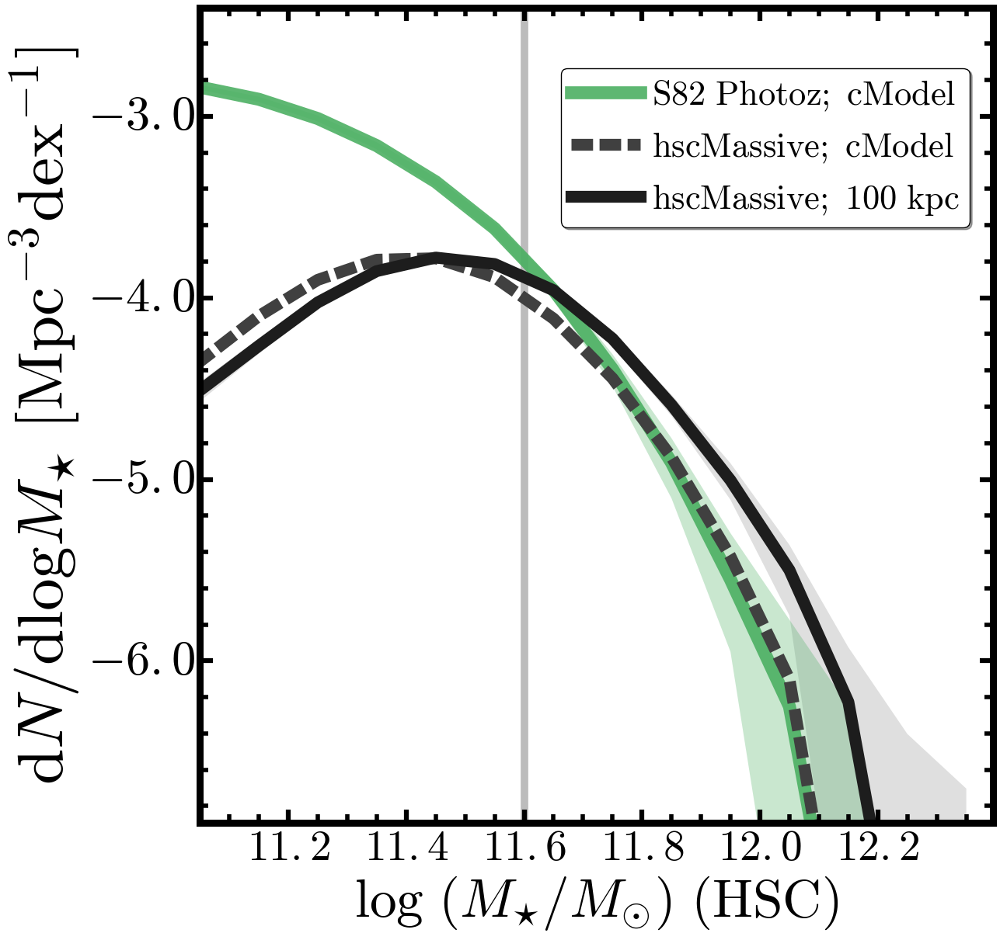

In [206]:
fig = plt.figure(figsize=(13, 12))
fig.subplots_adjust(left=0.21, right=0.995, 
                    bottom=0.12, top=0.995,
                    wspace=0.00, hspace=0.00)

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=40, ylabel=45, border=6.5,
                    xtickFormat='$\mathrm{%4.1f}$', 
                    ytickFormat='$\mathrm{%4.1f}$')

# S82 
ax1.fill_between(mbin, s82MLow2, s82MUpp2, facecolor=GRN(0.6), 
                 edgecolor='none', alpha=0.30, zorder=1, rasterized=True)
ax1.plot(mbin, s82MMed2, c=GRN(0.6), linestyle='-', 
         linewidth=12.0, zorder=1, alpha=0.9,
         label='$\mathrm{S82\ Photoz};\ \mathrm{cModel}$', rasterized=True)

# nonbcg
ax1.fill_between(mbin, massAllMLow2, massAllMUpp2, facecolor=BLK(0.5), 
                 edgecolor='none', alpha=0.3, zorder=0, rasterized=True)
ax1.plot(mbin, massAllMMed1, c=BLK(0.8), linestyle='--', linewidth=11.0,
         label='$\mathrm{hscMassive};\ \mathrm{cModel}$', zorder=2, 
         dashes=(20, 6), rasterized=True)
ax1.plot(mbin, massAllMMed2, c=BLK(0.9), linewidth=11.0,
         label='$\mathrm{hscMassive};\ \mathrm{100\ kpc}$', zorder=2, 
         rasterized=True)

ax1.legend(loc=(0.455, 0.73), shadow=True, fancybox=True, 
           numpoints=1, fontsize=32, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.34)

ax1.set_xlim(11.05, 12.395)
ax1.set_ylim(-6.89, -2.4)

# Label
ax1.set_xlabel('$\log\ (M_{\star}/M_{\odot})\ \mathrm{(HSC)}$', 
               size=50)
ax1.set_ylabel('$\mathrm{d}N/\mathrm{d}\logM_{\star}\ [{\mathrm{Mpc}^{-3}}{\mathrm{dex}^{-1}}]$', 
               size=60)

ax1.axvline(11.6, linestyle='-', linewidth=7.0, c=BLK(0.4), alpha=0.9, zorder=0, 
            rasterized=True)

fig.savefig(os.path.join(figDir, redbcgStr + '_logm_distribution_all.pdf'), dpi=150)

plt.show()

## Comparisons with stellar mass functions from other people's work

In [41]:
# Stellar mass function using integrated luminosity out to 100 kpc 
mbin, nonbcgMAll3 = getMassFunction(nonbcgUse, massCol='logm_150', 
                                    area=nonbcgArea, errValue=0.11, 
                                    returnAll=True, minVal=1.0E-8, 
                                    zLow=zLow, zUpp=zUpp, verbose=True)
nonbcgMLow3 = np.nanpercentile(nonbcgMAll3, 3.0, axis=0)
nonbcgMUpp3 = np.nanpercentile(nonbcgMAll3, 97.0, axis=0)
nonbcgMMed3 = np.nanmedian(nonbcgMAll3, axis=0)

mbin, redbcgMAll3 = getMassFunction(redbcgUse, massCol='logm_150', 
                                    area=redbcgArea, errValue=0.11, 
                                    returnAll=True, minVal=1.0E-8, 
                                    zLow=zLow, zUpp=zUpp, verbose=True)
redbcgMLow3 = np.nanpercentile(redbcgMAll3, 3.0, axis=0)
redbcgMUpp3 = np.nanpercentile(redbcgMAll3, 97.0, axis=0)
redbcgMMed3 = np.nanmedian(redbcgMAll3, axis=0)
redbcgMMed3 = np.nanmedian(redbcgMAll3, axis=0)

# Use fixed error value:  0.11


/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:1562: RuntimeWarning: invalid value encountered in greater_equal
/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:1562: RuntimeWarning: invalid value encountered in less_equal


# Sample include 3754 / 5889 galaxies
# The deltaVolume is   50558376.412 Mpc^3
# Use fixed error value:  0.11
# Sample include 114 / 146 galaxies
# The deltaVolume is   49780406.484 Mpc^3


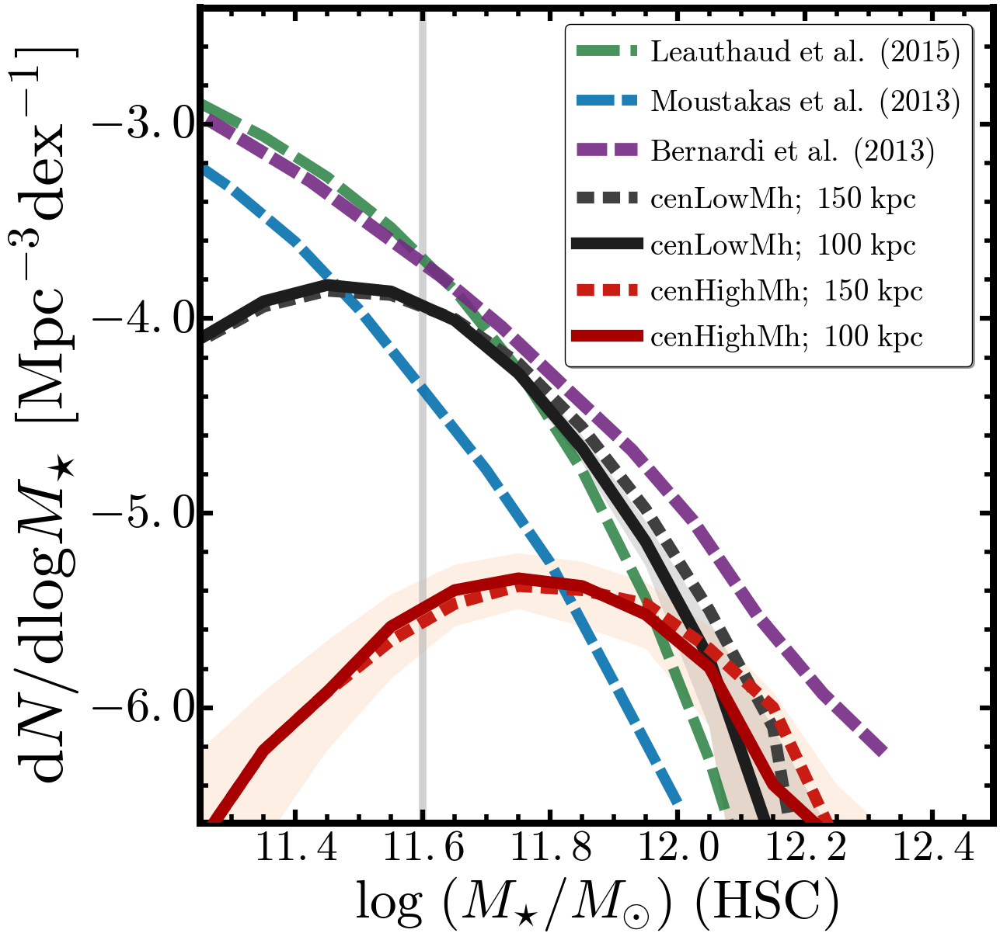

In [46]:
fig = plt.figure(figsize=(13, 12))
fig.subplots_adjust(left=0.21, right=0.995, 
                    bottom=0.12, top=0.995,
                    wspace=0.00, hspace=0.00)

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=40, ylabel=45, border=6.5,
                    xtickFormat='$\mathrm{%4.1f}$', 
                    ytickFormat='$\mathrm{%4.1f}$')

# S82 
#ax1.fill_between(mbin, s82MLow2, s82MUpp2, facecolor=GRN(0.6), 
#                 edgecolor='none', alpha=0.30, zorder=1, rasterized=True)
#ax1.plot(mbin, s82MMed2, c=GRN(0.6), linestyle='-', 
#         linewidth=12.0, zorder=1, alpha=0.9,
#         label='$\mathrm{S82\ Photoz};\ \mathrm{cModel}$', rasterized=True)

# Leauthaud+2015
ax1.plot(massCommon + 0.15, np.log10(doubleSchechter(massCommon)), c=GREEN1,
         linestyle='--', dashes=(40,10), linewidth=10.0, alpha=0.8, 
         label='$\mathrm{Leauthaud\ et\ al.\ (2015)}$')

# Moustakas+2013 
ax1.plot(mf_M13['logM'], mf_M13['logPhi'], linestyle='-', 
         linewidth=10.0, alpha=0.9, dashes=(35,7),
         c=BLUE1, label='$\mathrm{Moustakas\ et\ al.\ (2013)}$')

# Bernardi+2013; SerExp
hTerm1 = (2.0 * np.log10(0.72))
hTerm2 = (3.0 * np.log10(0.72))
ax1.plot(mf_B13['col1'] - hTerm1, mf_B13['col2'] + hTerm2, linestyle='--', 
         linewidth=12.0, alpha=0.9, dashes=(28,7),
         c=PURPLE1, label='$\mathrm{Bernardi\ et\ al.\ (2013)}$')

# nonbcg
ax1.fill_between(mbin, nonbcgMLow2, nonbcgMUpp2, facecolor=BLK(0.5), 
                 edgecolor='none', alpha=0.3, zorder=0, rasterized=True)
ax1.plot(mbin, nonbcgMMed3, c=BLK(0.8), linestyle='--', linewidth=11.0,
         label='$\mathrm{cenLowMh};\ \mathrm{150\ kpc}$', zorder=2, 
         dashes=(16,8), rasterized=True)
ax1.plot(mbin, nonbcgMMed2, c=BLK(0.9), linewidth=11.0,
         label='$\mathrm{cenLowMh};\ \mathrm{100\ kpc}$', zorder=2, 
         rasterized=True)

# redbcg
ax1.fill_between(mbin, redbcgMLow2, redbcgMUpp2, facecolor=ORG(0.4), 
                 edgecolor='none', alpha=0.2, zorder=0, rasterized=True)
ax1.plot(mbin, redbcgMMed3, c=ORG(0.8), linestyle='--', linewidth=11.0,
         label='$\mathrm{cenHighMh};\ \mathrm{150\ kpc}$', zorder=3, 
         dashes=(16,8), rasterized=True)
ax1.plot(mbin, redbcgMMed2, c=ORG(0.9), linewidth=11.0,
         label='$\mathrm{cenHighMh};\ \mathrm{100\ kpc}$', zorder=3, 
         rasterized=True)

ax1.legend(loc=(0.46, 0.56), shadow=True, fancybox=True, 
           numpoints=1, fontsize=28, scatterpoints=1, 
           markerscale=1.2, borderpad=0.4, handletextpad=0.4)

ax1.set_xlim(11.25, 12.495)
ax1.set_ylim(-6.59, -2.4)

# Label
ax1.set_xlabel('$\log\ (M_{\star}/M_{\odot})\ \mathrm{(HSC)}$', 
               size=50)
ax1.set_ylabel('$\mathrm{d}N/\mathrm{d}\logM_{\star}\ [{\mathrm{Mpc}^{-3}}{\mathrm{dex}^{-1}}]$', 
               size=60)

ax1.axvline(11.6, linestyle='-', linewidth=7.0, c=BLK(0.4), alpha=0.6, zorder=0, 
            rasterized=True)

fig.savefig(os.path.join(figDir, redbcgStr + '_logm_distribution_pub_comp.pdf'), dpi=150)

plt.show()

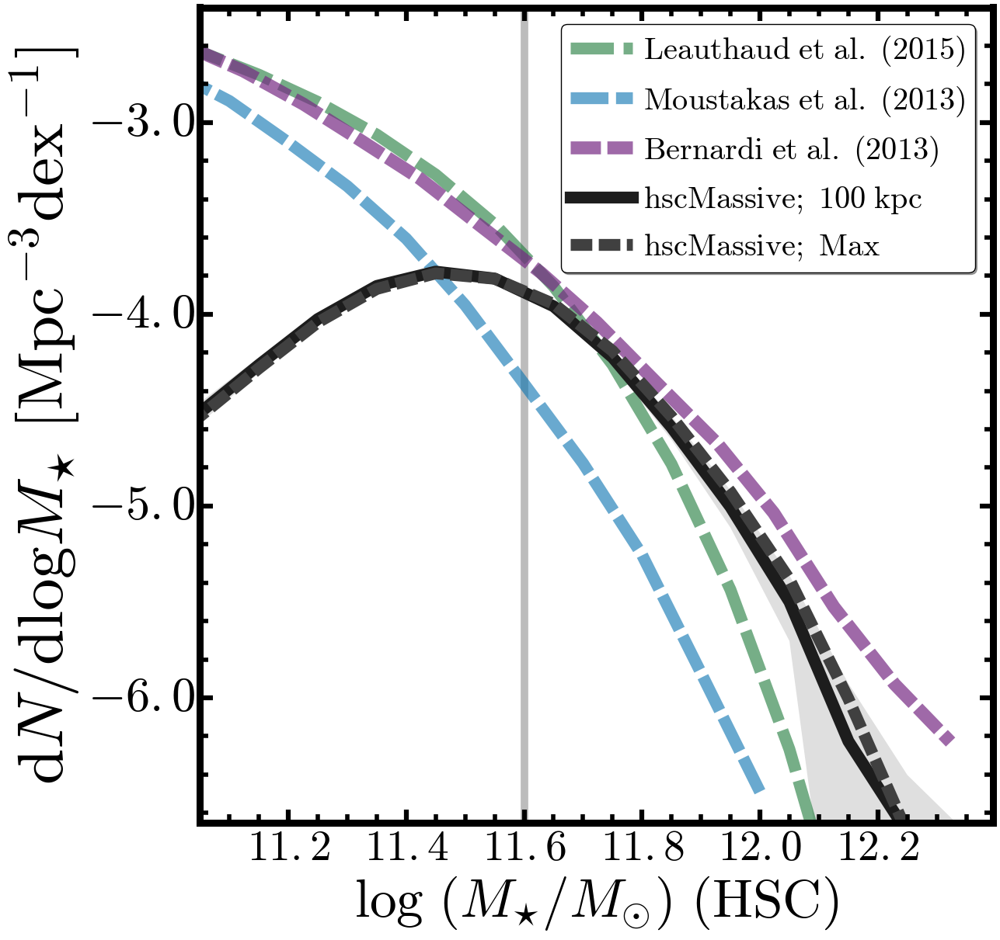

In [55]:
fig = plt.figure(figsize=(13, 12))
fig.subplots_adjust(left=0.21, right=0.995, 
                    bottom=0.12, top=0.995,
                    wspace=0.00, hspace=0.00)

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=40, ylabel=45, border=6.5,
                    xtickFormat='$\mathrm{%4.1f}$', 
                    ytickFormat='$\mathrm{%4.1f}$')

# Leauthaud+2015
ax1.plot(massCommon + 0.15, np.log10(doubleSchechter(massCommon)), c=GREEN1,
         linestyle='--', dashes=(40,9), linewidth=11.0, alpha=0.6, 
         label='$\mathrm{Leauthaud\ et\ al.\ (2015)}$')

# Moustakas+2013 
ax1.plot(mf_M13['logM'], mf_M13['logPhi'], linestyle='-', 
         linewidth=11.0, alpha=0.6, dashes=(35,7),
         c=BLUE1, label='$\mathrm{Moustakas\ et\ al.\ (2013)}$')

# Bernardi+2013; SerExp
hTerm1 = (2.0 * np.log10(0.72))
hTerm2 = (3.0 * np.log10(0.72))
ax1.plot(mf_B13['col1'] - hTerm1, mf_B13['col2'] + hTerm2, linestyle='--', 
         linewidth=12.0, alpha=0.7, dashes=(28,6),
         c=PURPLE1, label='$\mathrm{Bernardi\ et\ al.\ (2013)}$')

# nonbcg
ax1.fill_between(mbin, massAllMLow2, massAllMUpp2, facecolor=BLK(0.5), 
                 edgecolor='none', alpha=0.3, zorder=0, rasterized=True)
ax1.plot(mbin, massAllMMed2, c=BLK(0.9), linewidth=11.0,
         label='$\mathrm{hscMassive};\ \mathrm{100\ kpc}$', zorder=2, 
         rasterized=True)
ax1.plot(mbin, massAllMMed3, c=BLK(0.8), linestyle='--', linewidth=11.0,
         label='$\mathrm{hscMassive};\ \mathrm{Max}$', zorder=2, 
         dashes=(20, 6), rasterized=True)

ax1.legend(loc=(0.455, 0.675), shadow=True, fancybox=True, 
           numpoints=1, fontsize=29, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.34)

ax1.set_xlim(11.05, 12.395)
ax1.set_ylim(-6.65, -2.4)

# Label
ax1.set_xlabel('$\log\ (M_{\star}/M_{\odot})\ \mathrm{(HSC)}$', 
               size=50)
ax1.set_ylabel('$\mathrm{d}N/\mathrm{d}\logM_{\star}\ [{\mathrm{Mpc}^{-3}}{\mathrm{dex}^{-1}}]$', 
               size=60)

ax1.axvline(11.6, linestyle='-', linewidth=7.0, c=BLK(0.4), alpha=0.9, zorder=0, 
            rasterized=True)

fig.savefig(os.path.join(figDir, redbcgStr + '_logm_distribution_pub_comp_2.pdf'), dpi=150)

plt.show()

## Differences of stellar masses from cModel and 1-D profiles

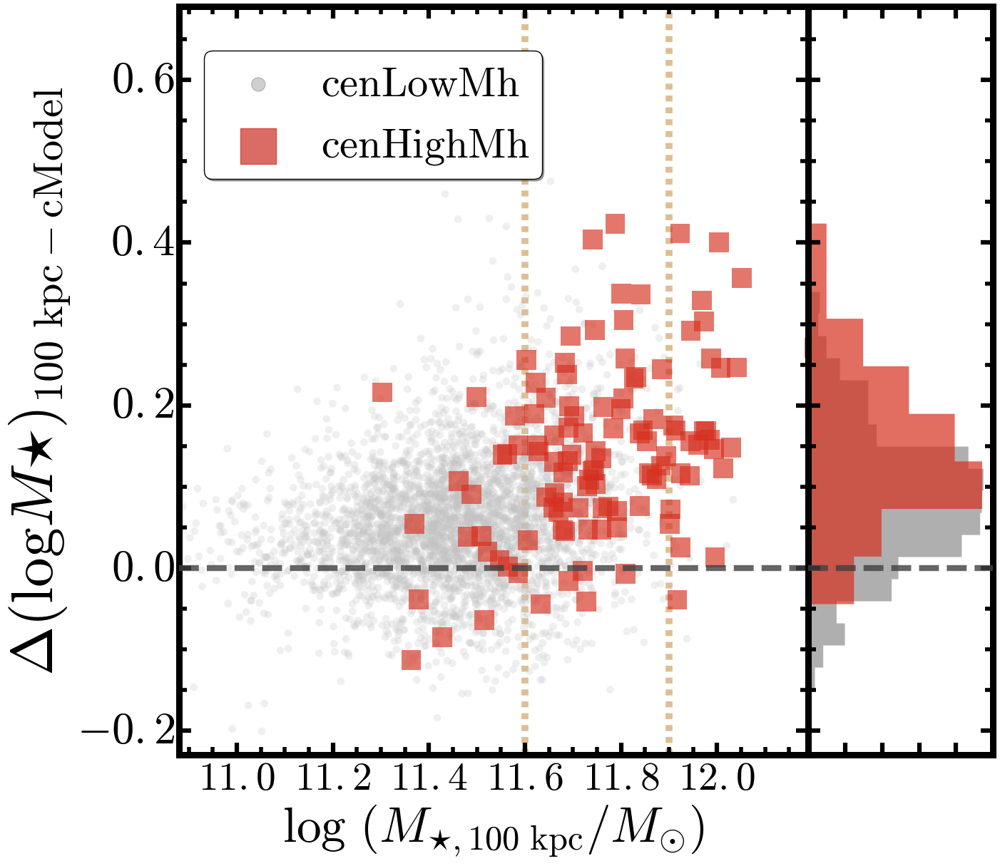

In [210]:
# definitions for the axes
left, width    = 0.18, 0.63
right          = left + width 
bottom, height = 0.12, 0.875
bottom_h = left_h = left + width + 0.02
recScat = [left,   bottom, width, height]
recHist = [right,  bottom,  0.185, height]

#-----------------------------------------------------------------#
fig = plt.figure(figsize=(14, 12))
fig.subplots_adjust(left=0.39, right=0.995, 
                    bottom=0.12, top=0.995,
                    wspace=0.00, hspace=0.00)
ax1 = plt.axes(recScat)
ax2 = plt.axes(recHist)
ax1 = songPlotSetup(ax1, xlabel=40, ylabel=45, border=6.5,
                    xtickFormat='$\mathrm{%4.1f}$', ytickFormat='$\mathrm{%4.1f}$')
ax2 = songPlotSetup(ax2, border=6.5)

nonbcgBin = nonbcgUse[(nonbcgUse['z_use'] >= 0.30) & 
                      (nonbcgUse['z_use'] <= 0.50)]
redbcgBin = redbcgUse[(redbcgUse['z_use'] >= 0.30) & 
                      (redbcgUse['z_use'] <= 0.50)]

# logM30 - logM10 v.s. r50 - r20
ax1.scatter((nonbcgBin['logm_100']), 
            (nonbcgBin['logm_100'] - nonbcgBin['MSTAR']), 
            marker='o', edgecolor='none', cmap=BLK, s=60,
            c=BLK(0.35), 
            label=nonbcgLab, alpha=0.25, rasterized=True)
ax1.scatter((redbcgBin['logm_100']), 
            (redbcgBin['logm_100'] - redbcgBin['MSTAR']), 
            marker='s', edgecolor='none', cmap=ORG, s=400,
            c=ORG(0.75), alpha=0.65,
            vmin=-0.6, label=redbcgLab2, rasterized=True)
#ax1.tick_params(axis='x', which='both', labelbottom='off')

# X, Y Label
ax1.set_xlabel('$\log\ ({M_{\star,100\ \mathrm{kpc}}}/M_{\odot})$', 
               size=50)
ax1.set_ylabel('$\Delta(\log M{\star})_{100\ \mathrm{kpc}-\mathrm{cModel}}$', 
               size=60)

# X, Y limits
ax1.set_xlim(10.88, 12.19)
ax1.set_ylim(-0.23, 0.69)

# Mass limits 
ax1.axvline(11.6, linestyle='--', linewidth=7.0, zorder=0, c=BROWN0,
            alpha=0.5)
ax1.axvline(11.9, linestyle='--', linewidth=7.0, zorder=0, c=BROWN0,
            alpha=0.5)

# Legend
l_handles, l_labels = ax1.get_legend_handles_labels()
ax1.legend(l_handles, l_labels, loc=(0.04, 0.77),
           shadow=True, fancybox=True, 
           numpoints=1, fontsize=42, scatterpoints=1, 
           markerscale=1.8, borderpad=0.3, handletextpad=0.5)
legend = ax1.get_legend()
legend.legendHandles[0].set_color(BLK(0.8))
legend.legendHandles[1].set_color(ORG(0.8))

ax1.axhline(0.0, linestyle='--', linewidth=6.0, zorder=100, c=BLK(0.8),
            alpha=0.8, dashes=(20,8))

#-----------------------------------------------------------------#

# Histogram
ax2.set_ylim(ax1.get_ylim())

nonbcgBin = nonbcgBin[(nonbcgBin['logm_100'] >= 11.6) & 
                      (nonbcgBin['logm_100'] <= 11.9)]
redbcgBin = redbcgBin[(redbcgBin['logm_100'] >= 11.6) & 
                      (redbcgBin['logm_100'] <= 11.9)]

temp = hist(redbcgBin['logm_100'] - redbcgBin['MSTAR'], 
            bins='knuth', histtype='stepfilled', 
            alpha=0.7, color=ORG(0.75), edgecolor='none',
            normed=True, ax=ax2, rasterized=True,
            orientation='horizontal', zorder=2)
temp = hist(nonbcgBin['logm_100'] - nonbcgBin['MSTAR'], 
            bins='knuth', histtype='stepfilled', 
            alpha=0.6, color=BLK(0.6), edgecolor='none',
            normed=True, ax=ax2, rasterized=True,
            orientation='horizontal', zorder=1)

# Setup axis
ax2.tick_params(axis='x', which='minor', bottom='off', top='off')
ax2.yaxis.set_major_formatter(NullFormatter())
ax2.xaxis.set_major_formatter(NullFormatter())

ax2.axhline(0.0, linestyle='--', linewidth=6.0, zorder=100, c=BLK(0.8),
            alpha=0.8, dashes=(20,8))

#-----------------------------------------------------------------#

fig.savefig(os.path.join(figDir, redbcgStr + '_logm100_increase.pdf'), dpi=150)

plt.show()

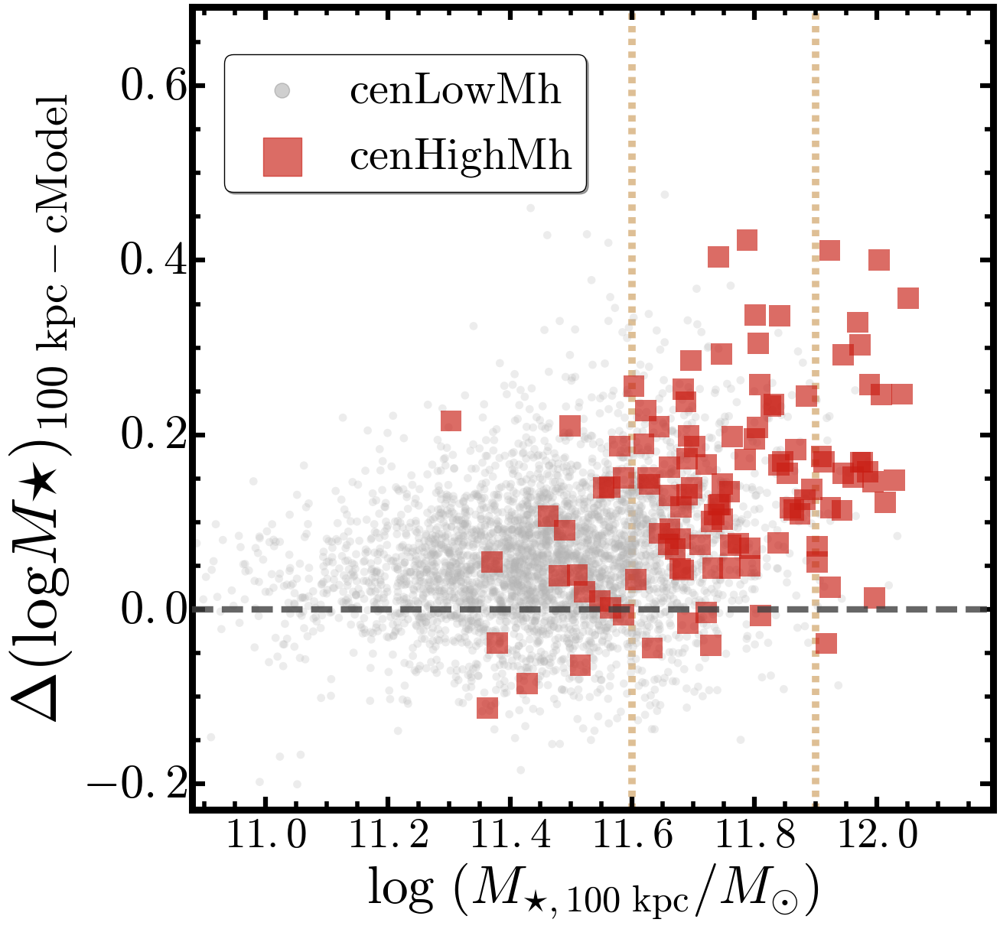

In [208]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(13, 12))
fig.subplots_adjust(left=0.19, right=0.995, 
                    bottom=0.12, top=0.995,
                    wspace=0.00, hspace=0.00)
ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=40, ylabel=45, border=6.5,
                    xtickFormat='$\mathrm{%4.1f}$', ytickFormat='$\mathrm{%4.1f}$')

nonbcgBin = nonbcgUse[(nonbcgUse['z_use'] >= 0.30) & 
                      (nonbcgUse['z_use'] <= 0.50)]
redbcgBin = redbcgUse[(redbcgUse['z_use'] >= 0.30) & 
                      (redbcgUse['z_use'] <= 0.50)]

# logM30 - logM10 v.s. r50 - r20
ax1.scatter((nonbcgBin['logm_100']), 
            (nonbcgBin['logm_100'] - nonbcgBin['MSTAR']), 
            marker='o', edgecolor='none', cmap=BLK, s=60,
            c=BLK(0.4), 
            label=nonbcgLab, alpha=0.25, rasterized=True)
ax1.scatter((redbcgBin['logm_100']), 
            (redbcgBin['logm_100'] - redbcgBin['MSTAR']), 
            marker='s', edgecolor='none', cmap=ORG, s=400,
            c=ORG(0.8), alpha=0.65,
            vmin=-0.6, label=redbcgLab2, rasterized=True)
#ax1.tick_params(axis='x', which='both', labelbottom='off')

# X, Y Label
ax1.set_xlabel('$\log\ ({M_{\star,100\ \mathrm{kpc}}}/M_{\odot})$', 
               size=50)
ax1.set_ylabel('$\Delta(\log M{\star})_{100\ \mathrm{kpc}-\mathrm{cModel}}$', 
               size=60)

# X, Y limits
ax1.set_xlim(10.88, 12.19)
ax1.set_ylim(-0.23, 0.69)

# Mass limits 
ax1.axvline(11.6, linestyle='--', linewidth=7.0, zorder=0, c=BROWN0,
            alpha=0.5)
ax1.axvline(11.9, linestyle='--', linewidth=7.0, zorder=0, c=BROWN0,
            alpha=0.5)

# Legend
l_handles, l_labels = ax1.get_legend_handles_labels()
ax1.legend(l_handles, l_labels, loc=(0.04, 0.77),
           shadow=True, fancybox=True, 
           numpoints=1, fontsize=42, scatterpoints=1, 
           markerscale=1.8, borderpad=0.3, handletextpad=0.5)
legend = ax1.get_legend()
legend.legendHandles[0].set_color(BLK(0.8))
legend.legendHandles[1].set_color(ORG(0.8))

ax1.axhline(0.0, linestyle='--', linewidth=6.0, zorder=100, c=BLK(0.8),
            alpha=0.8, dashes=(20,8))

#-----------------------------------------------------------------#

fig.savefig(os.path.join(figDir, redbcgStr + '_logm100_increase_nohist.pdf'), dpi=150)

plt.show()

## The mass difference between the maximum stellar mass and the mass withink 100 kpc

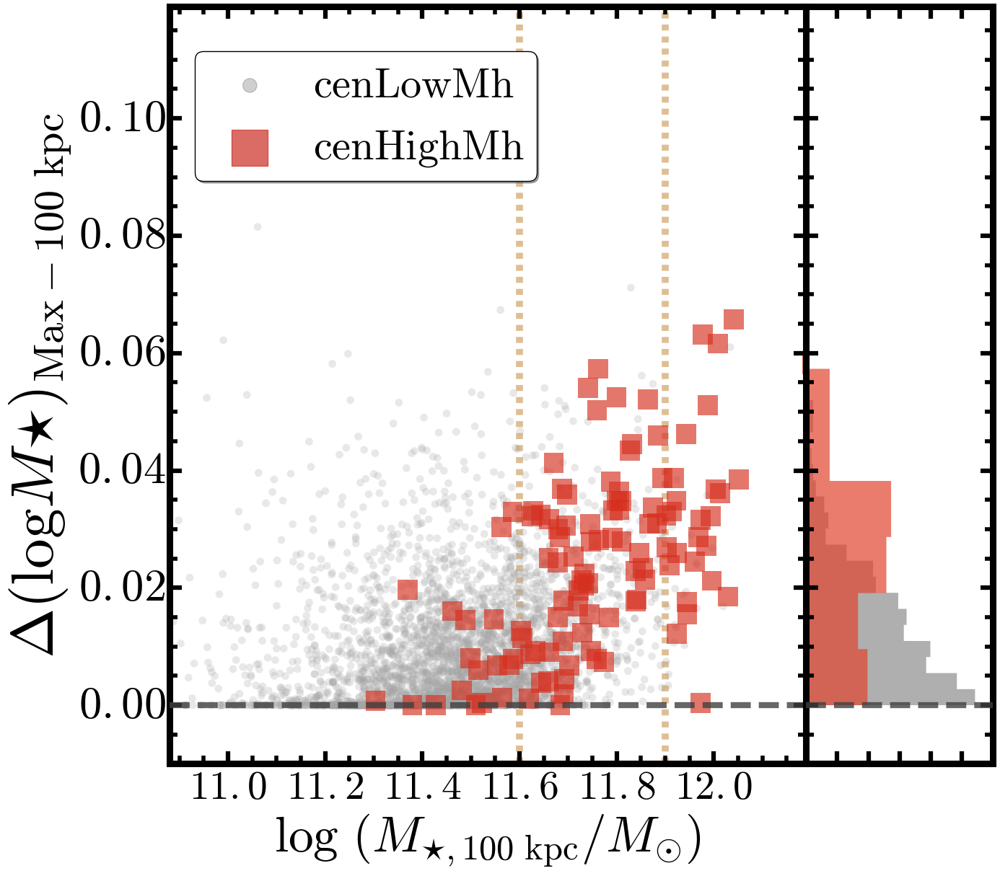

In [28]:
# definitions for the axes
left, width    = 0.18, 0.63
right          = left + width 
bottom, height = 0.12, 0.875
bottom_h = left_h = left + width + 0.02
recScat = [left,   bottom, width, height]
recHist = [right,  bottom,  0.185, height]

#-----------------------------------------------------------------#
fig = plt.figure(figsize=(14, 12))
fig.subplots_adjust(left=0.39, right=0.995, 
                    bottom=0.12, top=0.995,
                    wspace=0.00, hspace=0.00)
ax1 = plt.axes(recScat)
ax2 = plt.axes(recHist)
ax1 = songPlotSetup(ax1, xlabel=40, ylabel=45, border=6.5,
                    xtickFormat='$\mathrm{%4.1f}$', 
                    ytickFormat='$\mathrm{%5.2f}$')
ax2 = songPlotSetup(ax2, border=6.5)

nonbcgBin = nonbcgUse[(nonbcgUse['z_use'] >= 0.30) & 
                      (nonbcgUse['z_use'] <= 0.50)]
redbcgBin = redbcgUse[(redbcgUse['z_use'] >= 0.30) & 
                      (redbcgUse['z_use'] <= 0.50)]

# logM30 - logM10 v.s. r50 - r20
ax1.scatter((nonbcgBin['logm_100']), 
            (nonbcgBin['logm_150'] - nonbcgBin['logm_100']), 
            marker='o', edgecolor='none', cmap=BLK, s=60,
            c=BLK(0.45), 
            label=nonbcgLab, alpha=0.25, rasterized=True)
ax1.scatter((redbcgBin['logm_100']), 
            (redbcgBin['logm_150'] - redbcgBin['logm_100']), 
            marker='s', edgecolor='none', cmap=ORG, s=400,
            c=ORG(0.75), alpha=0.65,
            vmin=-0.6, label=redbcgLab2, rasterized=True)
#ax1.tick_params(axis='x', which='both', labelbottom='off')

# X, Y Label
ax1.set_xlabel('$\log\ ({M_{\star,100\ \mathrm{kpc}}}/M_{\odot})$', 
               size=50)
ax1.set_ylabel('$\Delta(\log M{\star})_{\mathrm{Max}-100\ \mathrm{kpc}}$', 
               size=60)

# X, Y limits
ax1.set_xlim(10.88, 12.19)
ax1.set_ylim(-0.01, 0.119)

# Mass limits 
ax1.axvline(11.6, linestyle='--', linewidth=7.0, zorder=0, c=BROWN0,
            alpha=0.5)
ax1.axvline(11.9, linestyle='--', linewidth=7.0, zorder=0, c=BROWN0,
            alpha=0.5)

# Legend
l_handles, l_labels = ax1.get_legend_handles_labels()
ax1.legend(l_handles, l_labels, loc=(0.04, 0.77),
           shadow=True, fancybox=True, 
           numpoints=1, fontsize=42, scatterpoints=1, 
           markerscale=1.8, borderpad=0.3, handletextpad=0.5)
legend = ax1.get_legend()
legend.legendHandles[0].set_color(BLK(0.8))
legend.legendHandles[1].set_color(ORG(0.8))

ax1.axhline(0.0, linestyle='--', linewidth=6.0, zorder=100, c=BLK(0.8),
            alpha=0.8, dashes=(20,8))

#-----------------------------------------------------------------#

# Histogram
ax2.set_ylim(ax1.get_ylim())

nonbcgBin = nonbcgBin[(nonbcgBin['logm_100'] >= 11.6) & 
                      (nonbcgBin['logm_100'] <= 11.9)]
redbcgBin = redbcgBin[(redbcgBin['logm_100'] >= 11.6) & 
                      (redbcgBin['logm_100'] <= 11.9)]

temp = hist(redbcgBin['logm_150'] - redbcgBin['logm_100'], 
            bins='knuth', histtype='stepfilled', 
            alpha=0.7, color=ORG(0.7), edgecolor='none',
            normed=True, ax=ax2, rasterized=True,
            orientation='horizontal', zorder=2)
temp = hist(nonbcgBin['logm_150'] - nonbcgBin['logm_100'], 
            bins='knuth', histtype='stepfilled', 
            alpha=0.6, color=BLK(0.6), edgecolor='none',
            normed=True, ax=ax2, rasterized=True,
            orientation='horizontal', zorder=1)

# Setup axis
ax2.tick_params(axis='x', which='minor', bottom='off', top='off')
ax2.yaxis.set_major_formatter(NullFormatter())
ax2.xaxis.set_major_formatter(NullFormatter())

ax2.axhline(0.0, linestyle='--', linewidth=6.0, zorder=100, c=BLK(0.8),
            alpha=0.8, dashes=(20,8))

#-----------------------------------------------------------------#

fig.savefig(os.path.join(figDir, redbcgStr + '_logmMax_increase.pdf'), dpi=150)

plt.show()

# Basic Sample Statistics

## Histogram of Redshift

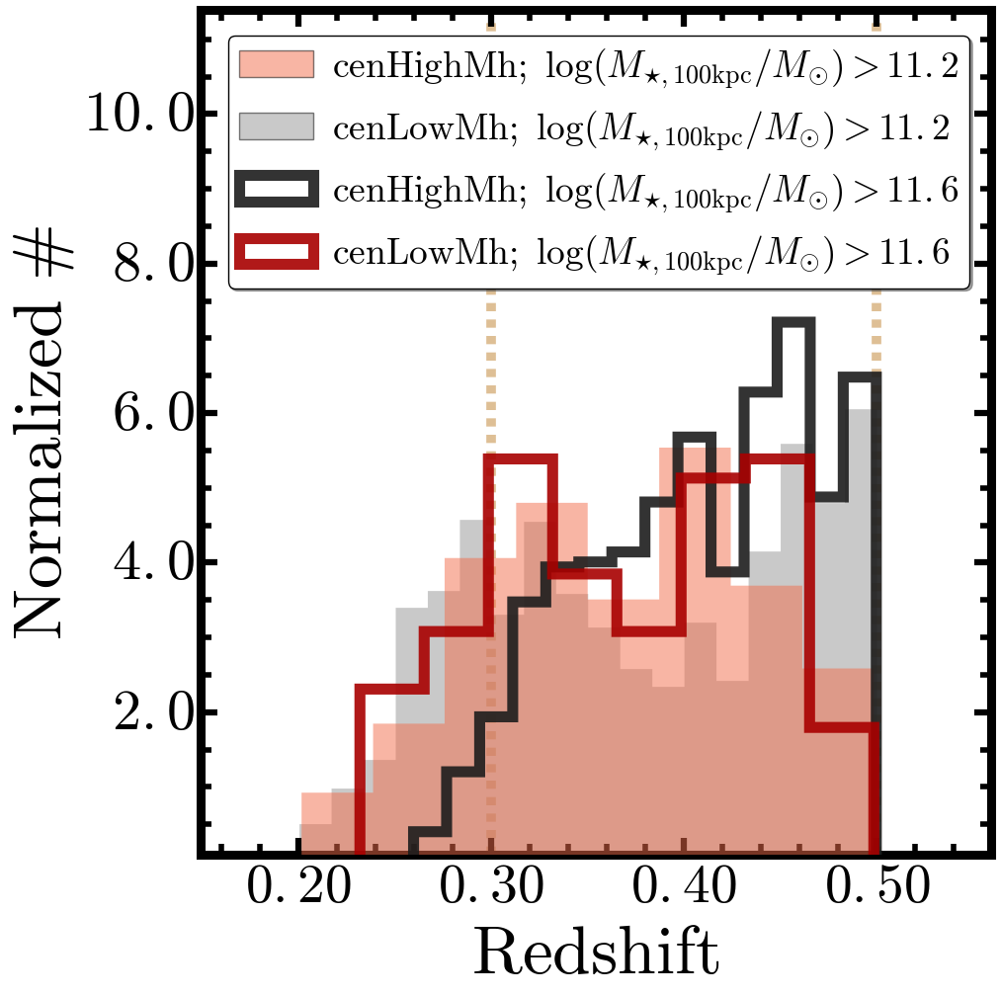

In [12]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(10, 10))
fig.subplots_adjust(left=0.195, right=0.995, 
                    bottom=0.140, top=0.995,
                    wspace=0.02, hspace=0.00)
ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=40, ylabel=42, border=6.5,
                    xtickFormat='$\mathbf{%4.2f}$',
                    ytickFormat='$\mathbf{%4.1f}$')

nonbcgBin = nonbcgUse[(nonbcgUse['logm_100'] >= 11.6)]
redbcgBin = redbcgUse[(redbcgUse['logm_100'] >= 11.6)]

nonbcgBin2 = nonbcgUse[(nonbcgUse['logm_100'] >= 11.2)]
redbcgBin2 = redbcgUse[(redbcgUse['logm_100'] >= 11.2)]

temp = hist(redbcgBin2['z_use'], 
            bins='knuth', histtype='stepfilled', 
            alpha=0.5, color=ORG(0.6), edgecolor='none',
            normed=True, ax=ax1, zorder=3, rasterized=True,
            label='$\mathrm{cenHighMh};\ \log(M_{\star, 100\mathrm{kpc}}/M_{\odot}) > 11.2$')
temp = hist(nonbcgBin2['z_use'], 
            bins='knuth', histtype='stepfilled', 
            alpha=0.5, color=BLK(0.5), edgecolor='none',
            normed=True, ax=ax1, zorder=2, rasterized=True, 
            label='$\mathrm{cenLowMh};\ \log(M_{\star, 100\mathrm{kpc}}/M_{\odot}) > 11.2$')

temp = hist(nonbcgBin['z_use'], 
            bins='knuth', histtype='step', 
            alpha=0.9, color=BLK(0.9), linewidth=8.0,
            normed=True, ax=ax1, zorder=5, rasterized=True,
            label='$\mathrm{cenHighMh};\ \log(M_{\star, 100\mathrm{kpc}}/M_{\odot}) > 11.6$')
temp = hist(redbcgBin['z_use'], 
            bins='knuth', histtype='step', 
            alpha=0.9, color=ORG(0.9), linewidth=8.0,
            normed=True, ax=ax1, zorder=6, rasterized=True,
            label='$\mathrm{cenLowMh};\ \log(M_{\star, 100\mathrm{kpc}}/M_{\odot}) > 11.6$')

ax1.set_xlim(0.149, 0.559)
ax1.set_ylim(0.1, 11.4)

ax1.axvline(0.30, linestyle='--', alpha=0.5, color=BROWN0, linewidth=7.0, zorder=0)
ax1.axvline(0.50, linestyle='--', alpha=0.5, color=BROWN0, linewidth=7.0, zorder=0)

ax1.set_xlabel('$\mathrm{Redshift}$', fontsize=50)
ax1.set_ylabel('$\mathrm{Normalized\ \#}$', fontsize=50)

# Legend
ax1.legend(loc=(0.035, 0.67), shadow=True, fancybox=True, 
           numpoints=1, fontsize=27, scatterpoints=1, 
           markerscale=1.3, borderpad=0.3, handletextpad=0.5)
legend = ax1.get_legend()

fig.savefig(os.path.join(figDir, redbcgStr + '_redshift_hist.pdf'), dpi=150)

plt.show()

## Histogram of Stellar Mass

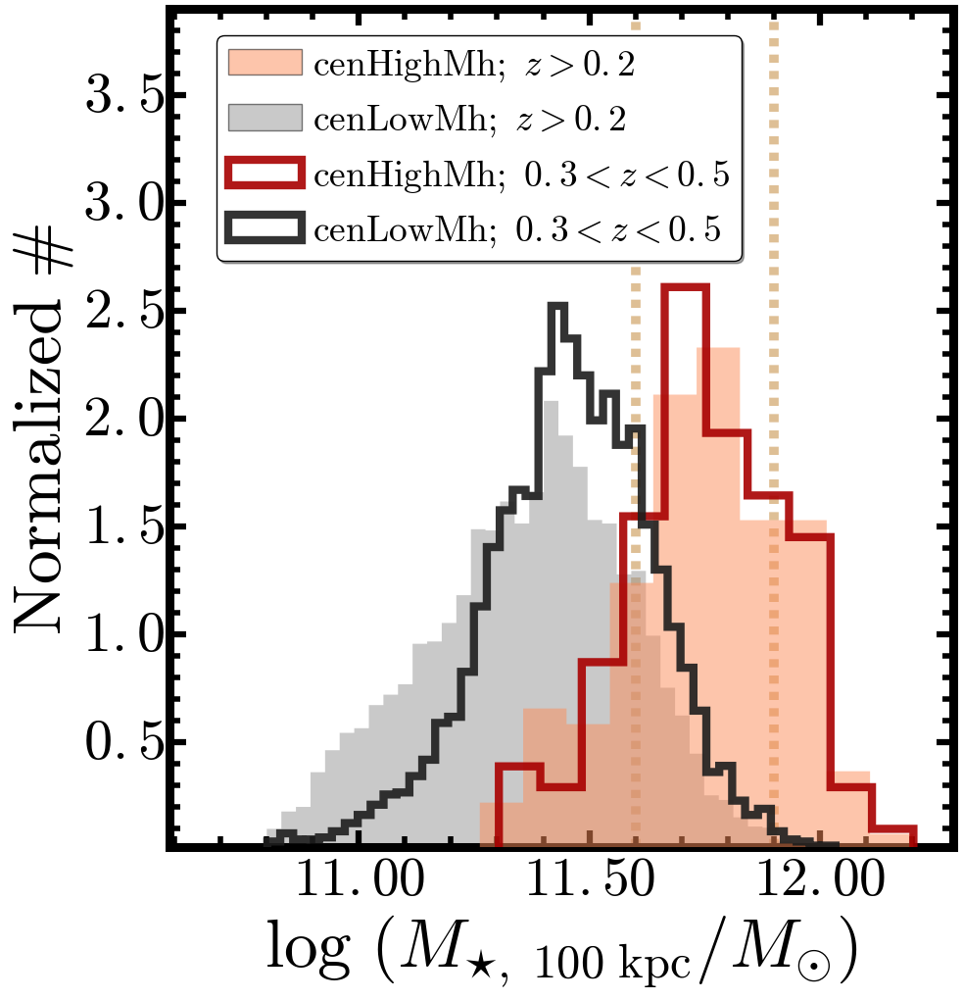

In [13]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(10, 10))
fig.subplots_adjust(left=0.195, right=0.995, 
                    bottom=0.140, top=0.995,
                    wspace=0.02, hspace=0.00)
ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=40, ylabel=42, border=6.5,
                    xtickFormat='$\mathbf{%4.2f}$',
                    ytickFormat='$\mathbf{%4.1f}$')

nonbcgBin2 = nonbcgUse[(nonbcgUse['z_use'] >= 0.20)] 
redbcgBin2 = redbcgUse[(redbcgUse['z_use'] >= 0.20)] 

nonbcgBin = nonbcgUse[(nonbcgUse['z_use'] >= 0.30) & 
                      (nonbcgUse['z_use'] <= 0.50)]
redbcgBin = redbcgUse[(redbcgUse['z_use'] >= 0.30) & 
                      (redbcgUse['z_use'] <= 0.50)]

temp = hist(redbcgBin2['logm_100'], 
            bins='knuth', histtype='stepfilled', 
            alpha=0.5, color=ORG(0.5), edgecolor='none',
            normed=True, ax=ax1, zorder=3, rasterized=True,
            label='$\mathrm{cenHighMh};\ z>0.2$')
temp = hist(nonbcgBin2['logm_100'], 
            bins='knuth', histtype='stepfilled', 
            alpha=0.5, color=BLK(0.5), edgecolor='none',
            normed=True, ax=ax1, zorder=1, rasterized=True,
            label='$\mathrm{cenLowMh};\ z>0.2$')

temp = hist(redbcgBin['logm_100'], 
            bins='knuth', histtype='step', 
            alpha=0.9, color=ORG(0.9), linewidth=6.0,
            normed=True, ax=ax1, zorder=5, rasterized=True,
            label='$\mathrm{cenHighMh};\ 0.3 < z < 0.5$')
temp = hist(nonbcgBin['logm_100'], 
            bins='knuth', histtype='step', 
            alpha=0.9, color=BLK(0.9), linewidth=6.0,
            normed=True, ax=ax1, zorder=6, rasterized=True,
            label='$\mathrm{cenLowMh};\ 0.3 < z < 0.5$')

ax1.axvline(11.60, linestyle='--', linewidth=7.0, alpha=0.5, 
            c=BROWN0, zorder=0)
ax1.axvline(11.90, linestyle='--', linewidth=7.0, alpha=0.5, 
            c=BROWN0, zorder=0)

ax1.set_xlim(10.59, 12.29)
ax1.set_ylim(0.01, 3.9)

ax1.set_xlabel('$\log\ ({M_{\star,\ 100\ \mathrm{kpc}}}/M_{\odot})$', 
               size=50)
ax1.set_ylabel('$\mathrm{Normalized\ \#}$', fontsize=50)

# Legend
ax1.legend(loc=(0.06, 0.70), shadow=True, fancybox=True, 
           numpoints=1, fontsize=27, scatterpoints=1, 
           markerscale=1.3, borderpad=0.3, handletextpad=0.3)
legend = ax1.get_legend()

fig.savefig(os.path.join(figDir, redbcgStr + '_logm_hist_norm.pdf'), dpi=150)

plt.show()

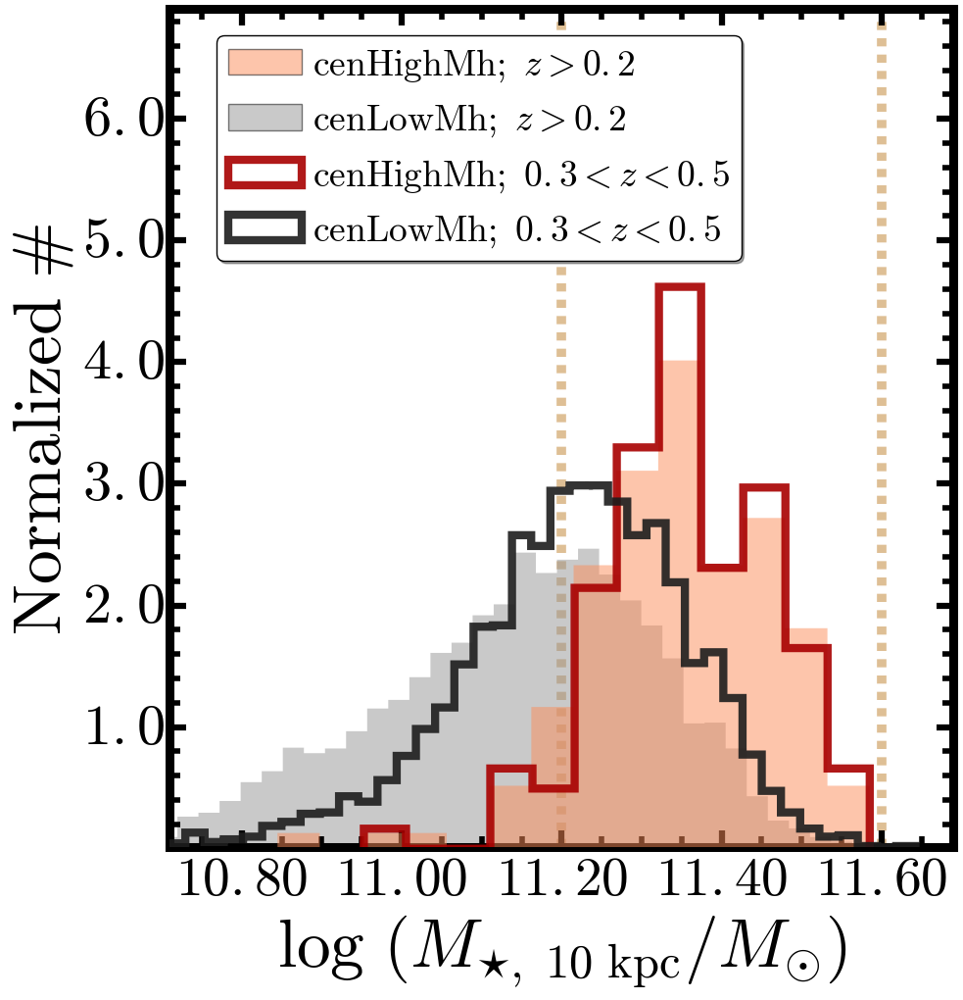

In [16]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(10, 10))
fig.subplots_adjust(left=0.195, right=0.995, 
                    bottom=0.140, top=0.995,
                    wspace=0.02, hspace=0.00)
ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=40, ylabel=42, border=6.5,
                    xtickFormat='$\mathbf{%4.2f}$',
                    ytickFormat='$\mathbf{%4.1f}$')

nonbcgBin2 = nonbcgUse[(nonbcgUse['z_use'] >= 0.20)] 
redbcgBin2 = redbcgUse[(redbcgUse['z_use'] >= 0.20)] 

nonbcgBin = nonbcgUse[(nonbcgUse['z_use'] >= 0.30) & 
                      (nonbcgUse['z_use'] <= 0.50)]
redbcgBin = redbcgUse[(redbcgUse['z_use'] >= 0.30) & 
                      (redbcgUse['z_use'] <= 0.50)]

temp = hist(redbcgBin2['logm_10'], 
            bins='knuth', histtype='stepfilled', 
            alpha=0.5, color=ORG(0.5), edgecolor='none',
            normed=True, ax=ax1, zorder=3, rasterized=True,
            label='$\mathrm{cenHighMh};\ z>0.2$')
temp = hist(nonbcgBin2['logm_10'], 
            bins='knuth', histtype='stepfilled', 
            alpha=0.5, color=BLK(0.5), edgecolor='none',
            normed=True, ax=ax1, zorder=1, rasterized=True,
            label='$\mathrm{cenLowMh};\ z>0.2$')

temp = hist(redbcgBin['logm_10'], 
            bins='knuth', histtype='step', 
            alpha=0.9, color=ORG(0.9), linewidth=6.0,
            normed=True, ax=ax1, zorder=5, rasterized=True,
            label='$\mathrm{cenHighMh};\ 0.3 < z < 0.5$')
temp = hist(nonbcgBin['logm_10'], 
            bins='knuth', histtype='step', 
            alpha=0.9, color=BLK(0.9), linewidth=6.0,
            normed=True, ax=ax1, zorder=6, rasterized=True,
            label='$\mathrm{cenLowMh};\ 0.3 < z < 0.5$')

ax1.axvline(11.20, linestyle='--', linewidth=7.0, alpha=0.5, 
            c=BROWN0, zorder=0)
ax1.axvline(11.60, linestyle='--', linewidth=7.0, alpha=0.5, 
            c=BROWN0, zorder=0)

ax1.set_xlim(10.71, 11.69)
ax1.set_ylim(0.01, 6.9)

ax1.set_xlabel('$\log\ ({M_{\star,\ 10\ \mathrm{kpc}}}/M_{\odot})$', 
               size=50)
ax1.set_ylabel('$\mathrm{Normalized\ \#}$', fontsize=50)

# Legend
ax1.legend(loc=(0.06, 0.70), shadow=True, fancybox=True, 
           numpoints=1, fontsize=27, scatterpoints=1, 
           markerscale=1.3, borderpad=0.3, handletextpad=0.3)
legend = ax1.get_legend()

fig.savefig(os.path.join(figDir, redbcgStr + '_logm10_hist_norm.pdf'), dpi=150)

plt.show()

## Stellar mass - color relation

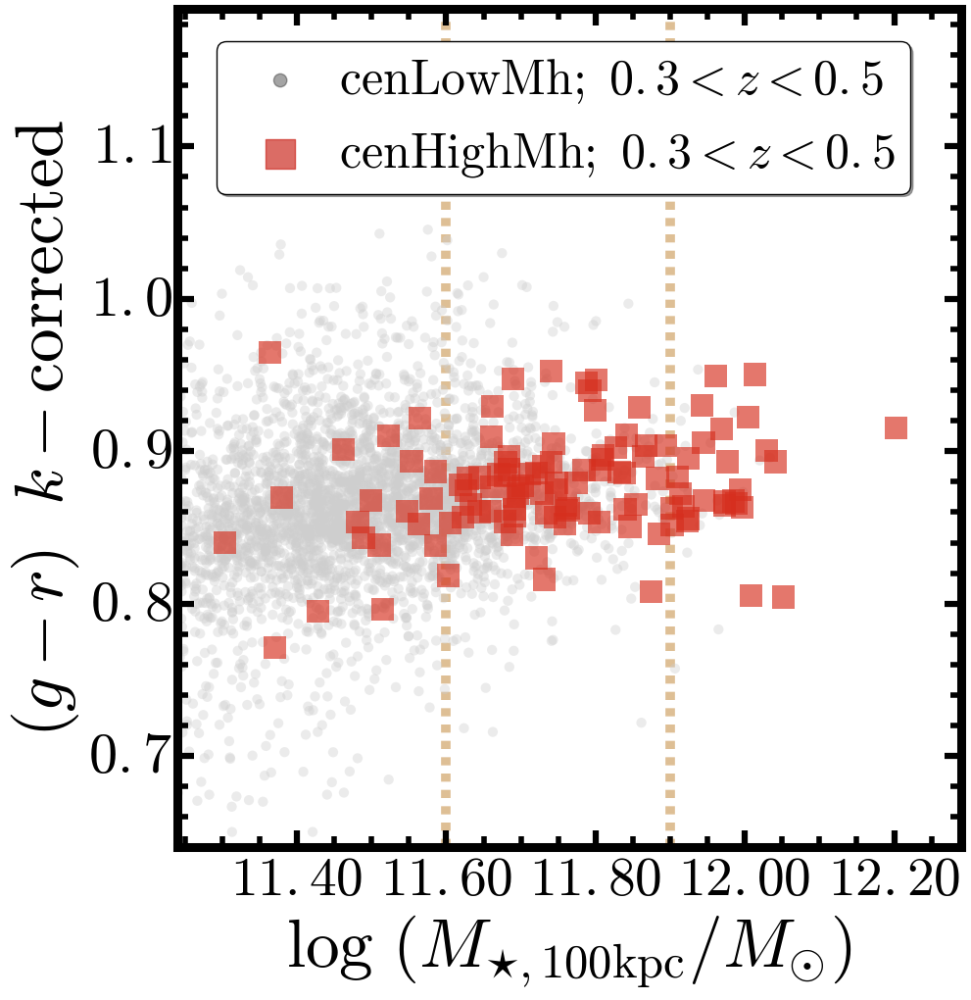

In [214]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(10, 10))
fig.subplots_adjust(left=0.195, right=0.995, 
                    bottom=0.140, top=0.995,
                    wspace=0.02, hspace=0.00)
ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=40, ylabel=42, border=6.5,
                    xtickFormat='$\mathbf{%4.2f}$',
                    ytickFormat='$\mathbf{%4.1f}$')

nonbcgBin = nonbcgUse[(nonbcgUse['z_use'] >= 0.30) & 
                      (nonbcgUse['z_use'] <= 0.50)]
redbcgBin = redbcgUse[(redbcgUse['z_use'] >= 0.30) & 
                      (redbcgUse['z_use'] <= 0.50)]

# logM - (g-r) Color
ax1.scatter(nonbcgBin['logm_100'], (nonbcgBin['ABSMAG_G'] - nonbcgBin['ABSMAG_R']), 
            marker='o', edgecolor='none', cmap=BLK, s=55,
            c=BLK(0.3), alpha=0.40,
            label='$\mathrm{cenLowMh};\ 0.3 < z < 0.5$')
ax1.scatter(redbcgBin['logm_100'], (redbcgBin['ABSMAG_G'] - redbcgBin['ABSMAG_R']), 
            marker='s', edgecolor='none', cmap=ORG, s=280,
            c=ORG(0.75), alpha=0.65,
            vmin=-0.6, 
            label='$\mathrm{cenHighMh};\ 0.3 < z < 0.5$')
    
ax1.set_xlabel('$\log\ (M_{\star, 100\mathrm{kpc}}/M_{\odot})$', size=50)
ax1.set_ylabel('$(g-r)\ \ k-\mathrm{corrected}$', size=50)

ax1.set_xlim(11.24, 12.29)
ax1.set_ylim(0.64, 1.19)

ax1.axvline(11.60, linestyle='--', linewidth=7.0, alpha=0.5, 
            c=BROWN0, zorder=0)
ax1.axvline(11.90, linestyle='--', linewidth=7.0, alpha=0.5, 
            c=BROWN0, zorder=0)
#ax1.axhline(0.98, linestyle='-', linewidth=5.0, alpha=0.3, c=BROWN0)
#ax1.axhline(0.75, linestyle='-', linewidth=5.0, alpha=0.3, c=BROWN0)

# Legend
l_handles, l_labels = ax1.get_legend_handles_labels()
ax1.legend(loc=(0.05, 0.78), shadow=True, fancybox=True, 
           numpoints=1, fontsize=36, scatterpoints=1, 
           markerscale=1.3, borderpad=0.3, handletextpad=0.2)
legend = ax1.get_legend()
legend.legendHandles[0].set_color(BLK(0.9))
legend.legendHandles[1].set_color(ORG(0.8))

fig.savefig(os.path.join(figDir, redbcgStr + '_mass_grKcor.pdf'), dpi=150)

plt.show()

# Average stellar mass density profiles of different mass bins

In [53]:
# Combined the redbcg and nonbcg samples
galProfMbin0 = redbcgProfMbin0 + nonbcgProfMbin0
galProfMbin1 = redbcgProfMbin1 + nonbcgProfMbin1
galProfMbin2 = redbcgProfMbin2 + nonbcgProfMbin2

# Get the average profiles
rm0_sl, rm0_ml, rm0_aml, rm0_stdl = organizeSbp(galProfMbin0, col1='muI1', 
                                                col2='LOGM2LI', kind='mass', 
                                                norm=False, integrate=False)
rm1_sl, rm1_ml, rm1_aml, rm1_stdl = organizeSbp(galProfMbin1, col1='muI1', 
                                                col2='LOGM2LI', kind='mass', 
                                                norm=False, integrate=False)
rm2_sl, rm2_ml, rm2_aml, rm2_stdl = organizeSbp(galProfMbin2, col1='muI1', 
                                                col2='LOGM2LI', kind='mass', 
                                                norm=False, integrate=False)

In [54]:
print(len(galProfMbin0), len(galProfMbin1), len(galProfMbin2))

1661 798 141


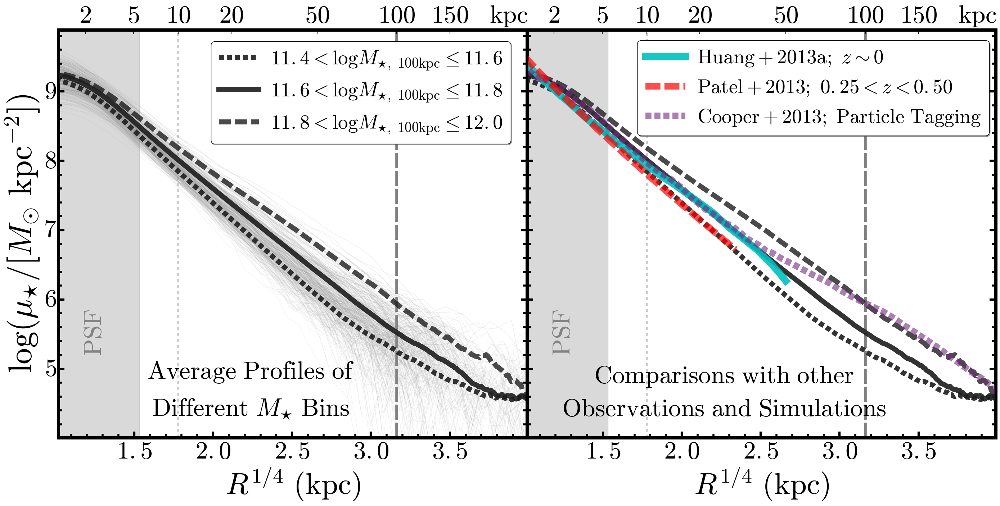

In [62]:
vline1, vline2 = 10.0, 100.0
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 3.99
#-------------------------------------------------------------------------------#
ymin, ymax = 4.01, 9.89
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.199, 0.399
showLegend = True
#-------------------------------------------------------------------------------#

label1="$11.4 < \log{M_{\star,\ 100\mathrm{kpc}}} \leq 11.6$"
label2="$11.6 < \log{M_{\star,\ 100\mathrm{kpc}}} \leq 11.8$"
label3="$11.8 < \log{M_{\star,\ 100\mathrm{kpc}}} \leq 12.0$"

showInfo1=True
showInfo2=True
showLegend=True
rPsfKpc=5.5
kpcArr=[2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 150.0]
color1a=BLK(0.5)
color1b=BLK(0.7)
cmap1=BLK
color2a=ORG(0.5)
color2b=ORG(0.7)
cmap2=ORG
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%g}\ $'
ytickFormat2='$\mathbf{%g}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(28, 14))
fig.subplots_adjust(left=0.065, right=0.995, 
                    bottom=0.13, top=0.94,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #

ax1 = fig.add_subplot(121)
ax1 = songPlotSetup(ax1, ylabel=50, xlabel=50, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)
# --------------------------------------------------------------------------------------- #
## Mark the two interesting radius
if highlight1:
    ax1.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax1.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
if highlight2:
    ax1.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax1.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
# --------------------------------------------------------------------------------------- #
## Individual profiles
for ii, aa in enumerate(rm0_sl):
    if (ii % 7) == 0:
        ax1.plot(RSMA_COMMON, aa, c=color1a, alpha=0.10, linewidth=1.1)
for ii, bb in enumerate(rm1_sl):
    if (ii % 7) == 0:
        ax1.plot(RSMA_COMMON, bb, c=color1a, alpha=0.15, linewidth=1.1)
for ii, cc in enumerate(rm2_sl):
    if (ii % 7) == 0:
        ax1.plot(RSMA_COMMON, cc, c=color1a, alpha=0.15, linewidth=1.1)
    
# --------------------------------------------------------------------------------------- #
## Median profiles
ax1.plot(RSMA_COMMON, rm0_aml[2], linestyle='--', linewidth=10.0, 
         c=cmap1(0.9), alpha=0.9, zorder=8, label=label1, dashes=(10,6))

ax1.plot(RSMA_COMMON, rm1_aml[2], linestyle='-', linewidth=10.0, 
         c=cmap1(0.9), alpha=0.9, zorder=8, label=label2)

ax1.plot(RSMA_COMMON, rm2_aml[2], linestyle='--', linewidth=10.0, 
         c=cmap1(0.9), alpha=0.8, zorder=8, label=label3, dashes=(24,8))

# --------------------------------------------------------------------------------------- #
## Y Lables
if norm:
    ax1.set_ylabel('$\mathrm{Normalized}\ \ \log ({\mu}_{\star}/[M_{\odot}\ \mathrm{kpc}^{-2}])$', 
                   size=41)
else:
    ax1.set_ylabel('$\log ({\mu}_{\star}/[M_{\odot}\ \mathrm{kpc}^{-2}])$', size=65)
    
ax1.set_xlabel('$R^{1/4}\ (\mathrm{kpc})$', size=60)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax1.set_xlim(xmin, xmax)
ax1.set_ylim(ymin, ymax)
# --------------------------------------------------------------------------------------- #
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
# z = 0.5 : 1"=6.1 Kpc
ySep = (ymax - ymin) / 5.0
ax1.fill_between([0.0, rPsfKpc ** 0.25], 
                 [ymin - ySep, ymin - ySep], 
                 [ymax + ySep, ymax + ySep], 
                 facecolor='k', edgecolor='k', alpha=0.15, zorder=0)
## Label the PSF region 
ax1.text(0.05, 0.20, '$\mathrm{PSF}$', rotation='vertical',
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax1.transAxes, weight='bold', 
         color='k', alpha=0.4)
# --------------------------------------------------------------------------------------- #
## Legend
if showLegend:
    ax1.legend(loc=(0.325, 0.72), shadow=True, fancybox=True, 
               numpoints=1, fontsize=40, scatterpoints=1, 
               markerscale=1.2, borderpad=0.4, handletextpad=0.6)
# --------------------------------------------------------------------------------------- #
## Secondary Axis 
ax2 = ax1.twiny()
kpcs = np.asarray(kpcArr)
kpcTicks= (kpcs ** 0.25)
ax2.set_xlim(xmin, xmax)
ax2.set_xticks(kpcTicks)
ax2.set_xticklabels(['$\mathbf{%g}$' % kpc for kpc in kpcs], fontsize=50)
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
ax2.text(0.92, 1.0040, '$\mathrm{kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax2.transAxes)
# --------------------------------------------------------------------------------------- #
ax1.text(0.41, 0.13, '$\mathrm{Average\ Profiles\ of}$',
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=50.0, transform=ax1.transAxes)
ax1.text(0.41, 0.04, '$\mathrm{Different\ }M_{\star}\ \mathrm{Bins}$',
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=50.0, transform=ax1.transAxes)
# --------------------------------------------------------------------------------------- #


# --------------------------------------------------------------------------------------- #

vline1, vline2 = 10.0, 100.0
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 3.99
#-------------------------------------------------------------------------------#
ymin, ymax = 4.01, 9.89
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.199, 0.399
showLegend = True

showInfo1=True
showInfo2=True
showLegend=True
rPsfKpc=5.5
kpcArr=[2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 150.0]
color1a=BLK(0.5)
color1b=BLK(0.7)
cmap1=BLK
color2a=ORG(0.5)
color2b=ORG(0.7)
cmap2=ORG
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%g}$'
ytickFormat2='$\mathbf{%g}$'

ax3 = fig.add_subplot(122)
ax3 = songPlotSetup(ax3, ylabel=50, xlabel=50, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)
# --------------------------------------------------------------------------------------- #
## Mark the two interesting radius
if highlight1:
    ax3.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax3.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
if highlight2:
    ax3.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax3.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
# --------------------------------------------------------------------------------------- #
## Median profiles
ax3.plot(RSMA_COMMON, rm0_aml[2], linestyle='--', linewidth=10.0, 
         c=cmap1(0.9), alpha=0.9, zorder=8, label=None, dashes=(10,6))

ax3.plot(RSMA_COMMON, rm1_aml[2], linestyle='-', linewidth=10.0, 
         c=cmap1(0.9), alpha=0.9, zorder=8, label=None)

ax3.plot(RSMA_COMMON, rm2_aml[2], linestyle='--', linewidth=10.0, 
         c=cmap1(0.9), alpha=0.8, zorder=8, label=None, dashes=(24,8))

# --------------------------------------------------------------------------------------- #
## Y Lables
ax3.yaxis.set_major_formatter(NullFormatter())
ax3.set_xlabel('$R^{1/4}\ (\mathrm{kpc})$', size=60)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax3.set_xlim(xmin, xmax)
ax3.set_ylim(ymin, ymax)
# --------------------------------------------------------------------------------------- #
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
# z = 0.5 : 1"=6.1 Kpc
ySep = (ymax - ymin) / 5.0
ax3.fill_between([0.0, rPsfKpc ** 0.25], 
                 [ymin - ySep, ymin - ySep], 
                 [ymax + ySep, ymax + ySep], 
                 facecolor='k', edgecolor='k', alpha=0.15, zorder=0)
## Label the PSF region 
ax3.text(0.05, 0.20, '$\mathrm{PSF}$', rotation='vertical',
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax3.transAxes, weight='bold', 
         color='k', alpha=0.4)

# --------------------------------------------------------------------------------------- #
## Secondary Axis 
ax4 = ax3.twiny()
kpcs = np.asarray(kpcArr)
kpcTicks= (kpcs ** 0.25)
ax4.set_xlim(xmin, xmax)
ax4.set_xticks(kpcTicks)
ax4.set_xticklabels(['$\mathbf{%g}$' % kpc for kpc in kpcs], fontsize=50)
for tick in ax4.xaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
for tick in ax4.yaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
ax4.text(0.92, 1.0040, '$\mathrm{kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax4.transAxes)

# --------------------------------------------------------------------------------------- #
ax3.plot(cgs_mprof_full['col1'] ** 0.25, cgs_mprof_full['col2'], 
         linestyle='-', c='c', 
         linewidth=14.0, alpha=0.9, zorder=11, 
         label='$\mathrm{Huang+2013a};\ z\sim 0$')

ax3.plot(patel10_mprof['rkpc'] ** 0.25, patel10_mprof['z0'] + 0.05, 
         linestyle='--', c='r', dashes=(30,8),
         linewidth=13.0, alpha=0.7, zorder=13,
         label='$\mathrm{Patel+2013};\ 0.25< z < 0.50$')

ax3.plot((10.0 ** cooper13_mprof_all['col1']) ** 0.25, cooper13_mprof_all['col2'], 
         linewidth=13.0, alpha=0.6, linestyle='--', c=PURPLE1, zorder=12, 
         dashes=(12,6), label='$\mathrm{Cooper+2013;\ Particle\ Tagging}$')

# --------------------------------------------------------------------------------------- #
## Legend
if showLegend:
    ax3.legend(loc=(0.235, 0.740), shadow=True, fancybox=True, 
               numpoints=1, fontsize=40, scatterpoints=1, 
               markerscale=1.2, borderpad=0.4, handletextpad=0.6)
# --------------------------------------------------------------------------------------- #
ax3.text(0.42, 0.12, '$\mathrm{Comparisons\ with\ other}$',
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=50.0, transform=ax3.transAxes)
ax3.text(0.42, 0.04, '$\mathrm{Observations\ and\ Simulations}$',
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=50.0, transform=ax3.transAxes)
# --------------------------------------------------------------------------------------- #

fig.savefig(os.path.join(figDir, 'average_mass_profiles_fsps1_A.pdf'), dpi=160)

plt.show()

# Average stellar mass density profiles of different redshift bins

In [58]:
rz1_sm, rz1_mm, rz1_amg, rz1_stdm = organizeSbp(redbcgProfZbin1, col1='muI1', 
                                                col2='LOGM2LI', kind='mass', 
                                                norm=False, integrate=False)
rz2_sm, rz2_mm, rz2_amg, rz2_stdm = organizeSbp(redbcgProfZbin2, col1='muI1', 
                                                col2='LOGM2LI', kind='mass', 
                                                norm=False, integrate=False)

nz1_sm, nz1_mm, nz1_amg, nz1_stdm = organizeSbp(nonbcgProfZbin1, col1='muI1', 
                                                col2='LOGM2LI', kind='mass', 
                                                norm=False, integrate=False)
nz2_sm, nz2_mm, nz2_amg, nz2_stdm = organizeSbp(nonbcgProfZbin2, col1='muI1', 
                                                col2='LOGM2LI', kind='mass', 
                                                norm=False, integrate=False)

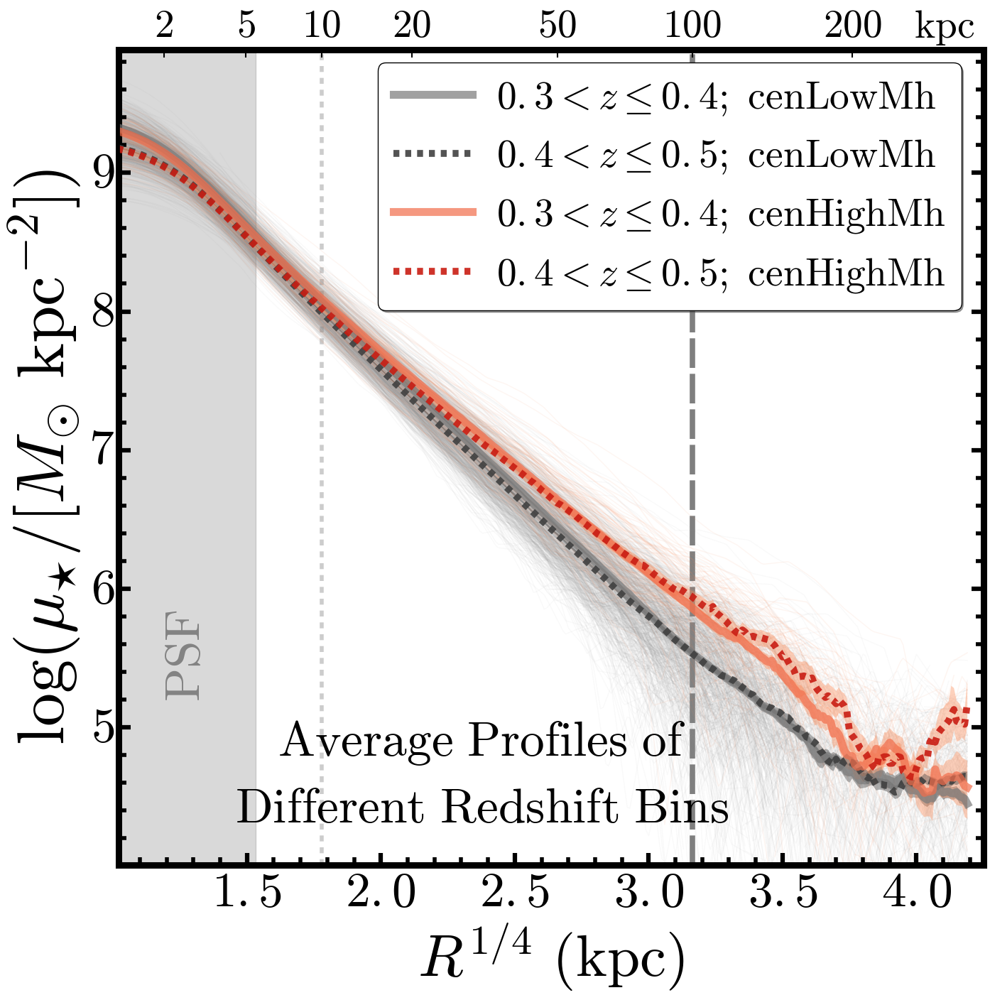

In [67]:
vline1, vline2 = 10.0, 100.0
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 4.25
#-------------------------------------------------------------------------------#
ymin, ymax = 4.01, 9.89
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.199, 0.399
showLegend = True
#-------------------------------------------------------------------------------#
label1="$11.5 < \log{M_{\star}} \leq 11.7;\ \lambda > 30;\ \mathrm{Cen}$"
label2="$11.7 < \log{M_{\star}} \leq 11.9;\ \lambda > 30;\ \mathrm{Cen}$"
label3="$11.9 < \log{M_{\star}} \leq 12.2;\ \lambda > 30;\ \mathrm{Cen}$"

label4="$11.5 < \log{M_{\star}} \leq 11.7;\ \lambda \leq 20;\ \mathrm{Cen}$"
label5="$11.7 < \log{M_{\star}} \leq 11.9;\ \lambda \leq 20;\ \mathrm{Cen}$"
label6="$11.2 < \log{M_{\star}} \leq 11.5;\ \lambda \leq 20;\ \mathrm{Cen}$"

showInfo1=True
showInfo2=True
showLegend=True
rPsfKpc=5.5
kpcArr=[2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 200.0]
color1a=BLK(0.5)
color1b=BLK(0.7)
cmap1=BLK
color2a=ORG(0.5)
color2b=ORG(0.7)
cmap2=ORG
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%g\ }$'
ytickFormat2='$\mathbf{%g}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(14, 14))
fig.subplots_adjust(left=0.125, right=0.995, 
                    bottom=0.13, top=0.95,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #

ax5 = fig.add_subplot(111)
ax5 = songPlotSetup(ax5, ylabel=50, xlabel=50, border=6.5, 
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)
# --------------------------------------------------------------------------------------- #


vline1, vline2 = 10.0, 100.0
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 4.25
ymin, ymax = 4.01, 9.89
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.199, 0.399
showLegend = True
#-------------------------------------------------------------------------------#
label1="$0.3 < z \leq 0.4;\ \mathrm{cenHighMh}$"
label2="$0.4 < z \leq 0.5;\ \mathrm{cenHighMh}$"

label3="$0.3 < z \leq 0.4;\ \mathrm{cenLowMh}$"
label4="$0.4 < z \leq 0.5;\ \mathrm{cenLowMh}$"

showInfo1=True
showInfo2=True
showLegend=True
rPsfKpc=5.5
kpcArr=[2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 200.0]
color1a=BLK(0.5)
color1b=BLK(0.7)
cmap1=BLK
color2a=ORG(0.5)
color2b=ORG(0.7)
cmap2=ORG
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%g}$'
ytickFormat2='$\mathbf{%g}$'

# --------------------------------------------------------------------------------------- #
## Mark the two interesting radius
if highlight1:
    ax5.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax5.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
if highlight2:
    ax5.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax5.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
# --------------------------------------------------------------------------------------- #
## Individual profiles
for dd in nz1_sm:
    ax5.plot(RSMA_COMMON, dd, c=color1a, alpha=0.05, linewidth=1.0)
for ee in nz2_sm:
    ax5.plot(RSMA_COMMON, ee, c=color1a, alpha=0.05, linewidth=1.0)
    
for aa in rz1_sm:
    ax5.plot(RSMA_COMMON, aa, c=color2a, alpha=0.08, linewidth=1.0)
for bb in rz2_sm:
    ax5.plot(RSMA_COMMON, bb, c=color2a, alpha=0.08, linewidth=1.2)
# --------------------------------------------------------------------------------------- #
## Median profiles
ax5.fill_between(RSMA_COMMON, nz1_amg[0], nz1_amg[1], 
                 facecolor=cmap1(0.80), edgecolor='none', alpha=0.4, 
                 zorder=5, label=None)

ax5.fill_between(RSMA_COMMON, nz2_amg[0], nz2_amg[1], 
                 facecolor=cmap1(0.80), edgecolor='none', alpha=0.4, 
                 zorder=6, label=None)

ax5.fill_between(RSMA_COMMON, rz1_amg[0], rz1_amg[1], 
                 facecolor=cmap2(0.50), edgecolor='none', alpha=0.4, 
                 zorder=5, label=None)

ax5.fill_between(RSMA_COMMON, rz2_amg[0], rz2_amg[1], 
                 facecolor=cmap2(0.50), edgecolor='none', alpha=0.4, 
                 zorder=6, label=None)

ax5.plot(RSMA_COMMON, nz1_amg[2], linestyle='-', linewidth=8.0, 
         c=cmap1(0.6), alpha=0.7, zorder=7, label=label3)

ax5.plot(RSMA_COMMON, nz2_amg[2], linestyle='--', linewidth=7.0, 
         c=cmap1(0.8), alpha=0.9, zorder=7, label=label4)

ax5.plot(RSMA_COMMON, rz1_amg[2], linestyle='-', linewidth=8.0, 
         c=cmap2(0.6), alpha=0.7, zorder=8, label=label1)

ax5.plot(RSMA_COMMON, rz2_amg[2], linestyle='--', linewidth=7.0, 
         c=cmap2(0.8), alpha=0.9, zorder=8, label=label2)
# --------------------------------------------------------------------------------------- #
## Y Lables
if norm:
    ax5.set_ylabel('$\mathrm{Normalized}\ \ \log ({\mu}_{\star}/[M_{\odot}\ \mathrm{kpc}^{-2}])$', 
                   size=41)
else:
    ax5.set_ylabel('$\log ({\mu}_{\star}/[M_{\odot}\ \mathrm{kpc}^{-2}])$', size=68)
    
ax5.set_xlabel('$R^{1/4}\ (\mathrm{kpc})$', size=60)
#ax5.yaxis.set_major_formatter(NullFormatter())
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax5.set_xlim(xmin, xmax)
ax5.set_ylim(ymin, ymax)
# --------------------------------------------------------------------------------------- #
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
# z = 0.5 : 1"=6.1 Kpc
ySep = (ymax - ymin) / 5.0
ax5.fill_between([0.0, rPsfKpc ** 0.25], 
                 [ymin - ySep, ymin - ySep], 
                 [ymax + ySep, ymax + ySep], 
                 facecolor='k', edgecolor='k', alpha=0.15, zorder=0)
## Label the PSF region 
ax5.text(0.05, 0.20, '$\mathrm{PSF}$', rotation='vertical',
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax5.transAxes, weight='bold', 
         color='k', alpha=0.4)
# --------------------------------------------------------------------------------------- #
## Legend
if showLegend:
    ax5.legend(loc=(0.30, 0.68), shadow=True, fancybox=True, 
               numpoints=1, fontsize=40, scatterpoints=1, 
               markerscale=1.2, borderpad=0.4, handletextpad=0.6)
# --------------------------------------------------------------------------------------- #
## Secondary Axis 
ax6 = ax5.twiny()
kpcs = np.asarray(kpcArr)
kpcTicks= (kpcs ** 0.25)
ax6.set_xlim(xmin, xmax)
ax6.set_xticks(kpcTicks)
ax6.set_xticklabels(['$\mathbf{%g}$' % kpc for kpc in kpcs], fontsize=40)
for tick in ax6.xaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
for tick in ax6.yaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
ax6.text(0.92, 1.0035, '$\mathrm{kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=40.0, transform=ax6.transAxes)
# --------------------------------------------------------------------------------------- #
ax5.text(0.42, 0.12, '$\mathrm{Average\ Profiles\ of}$',
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=50.0, transform=ax5.transAxes)
ax5.text(0.42, 0.04, '$\mathrm{Different\ Redshift\ Bins}$',
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=50.0, transform=ax5.transAxes)
# --------------------------------------------------------------------------------------- #

fig.savefig(os.path.join(figDir, 'average_mass_profiles_fsps1_B.pdf'), dpi=140)

plt.show()

# Comparison of median mass profiles with literature in the inner region 

In [63]:
rm4_sm, rm4_mm, rm4_amg, rm4_stdm = organizeSbp(redbcgProfM100a, col1='muI1', 
                                                col2='LOGM2LI', kind='mass', 
                                                norm=False, integrate=False)

nm4_sm, nm4_mm, nm4_amg, nm4_stdm = organizeSbp(nonbcgProfM100a, col1='muI1', 
                                                col2='LOGM2LI', kind='mass', 
                                                norm=False, integrate=False)

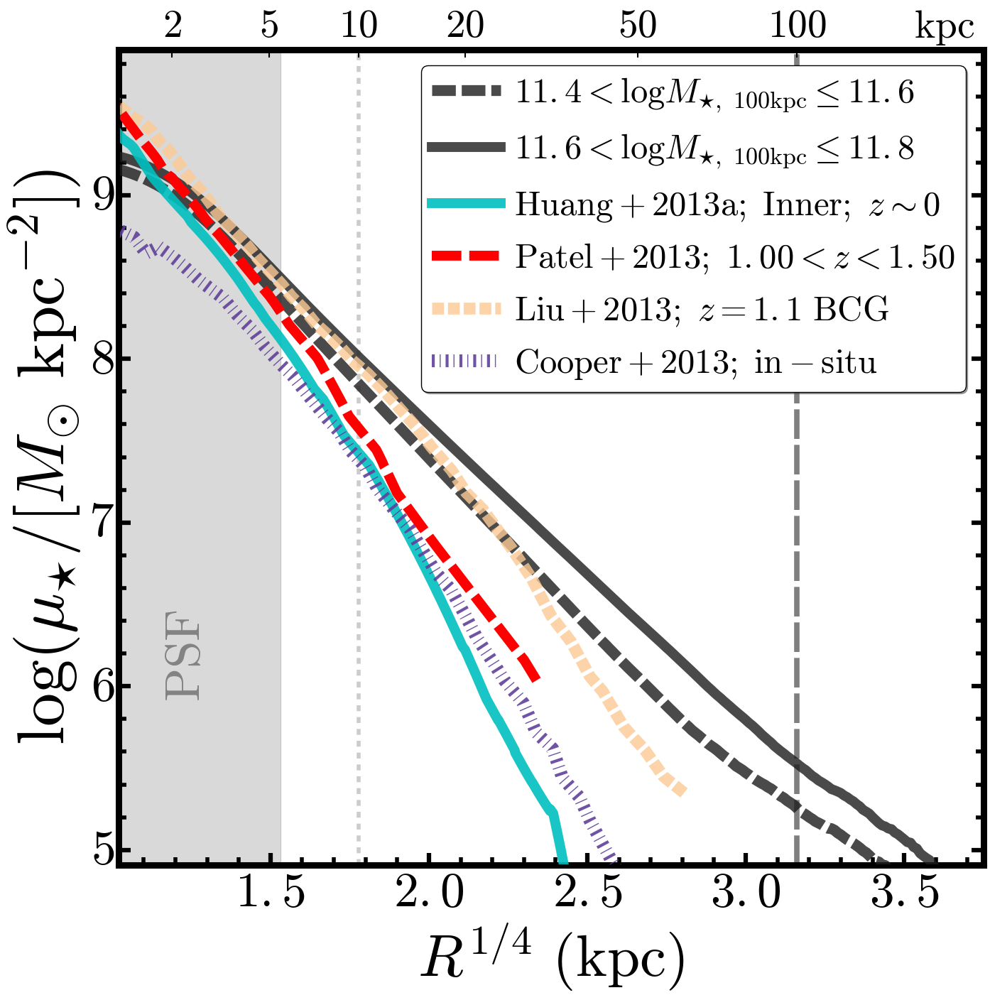

In [74]:
vline1, vline2 = 10.0, 100.0
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 3.75
#-------------------------------------------------------------------------------#
ymin, ymax = 4.91, 9.89
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.199, 0.399
showLegend = True
#-------------------------------------------------------------------------------#
#label1="$\mathrm{Low}\ {M_{\star},100\ \mathrm{kpc}}\ \mathrm{Bin;\ cenLowMh}$"
#label2="$\mathrm{Low}\ {M_{\star},100\ \mathrm{kpc}}\ \mathrm{Bin;\ cenHighMh}$"
label1="$11.4 < \log{M_{\star,\ 100\mathrm{kpc}}} \leq 11.6$"
label2="$11.6 < \log{M_{\star,\ 100\mathrm{kpc}}} \leq 11.8$"

showInfo1=True
showInfo2=True
showLegend=True
rPsfKpc=5.5
kpcArr=[2.0, 5.0, 10.0, 20.0, 50.0, 100.0]
color1a=BLK(0.5)
color1b=BLK(0.7)
cmap1=BLK
color2a=ORG(0.5)
color2b=ORG(0.7)
cmap2=ORG
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%g}\ $'
ytickFormat2='$\mathbf{%g}$'

# --------------------------------------------------------------------------------------- #
fig = plt.figure(figsize=(14, 14))
fig.subplots_adjust(left=0.125, right=0.995, 
                    bottom=0.13, top=0.95,
                    wspace=0.00, hspace=0.00)
# --------------------------------------------------------------------------------------- #

ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, ylabel=50, xlabel=50, border=6.5, 
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)
# --------------------------------------------------------------------------------------- #
## Mark the two interesting radius
if highlight1:
    ax1.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax1.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
if highlight2:
    ax1.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax1.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)

#ax1.plot(RSMA_COMMON, nm4_mm[2], linestyle='-', linewidth=9.0, 
#         c=cmap1(0.85), alpha=0.8, zorder=7, label=label1)

#ax1.plot(RSMA_COMMON, rm4_mm[2], linestyle='-', linewidth=9.0, 
#         c=cmap2(0.85), alpha=0.8, zorder=8, label=label2)

## Median profiles
ax1.plot(RSMA_COMMON, rm0_aml[2], linestyle='--', linewidth=11.0, 
         c=cmap1(0.9), alpha=0.8, zorder=8, label=label1, dashes=(24,6))

ax1.plot(RSMA_COMMON, rm1_aml[2], linestyle='-', linewidth=10.0, 
         c=cmap1(0.9), alpha=0.8, zorder=8, label=label2)

# --------------------------------------------------------------------------------------- #
## Y Lables
if norm:
    ax1.set_ylabel('$\mathrm{Normalized}\ \ \log ({\mu}_{\star}/[M_{\odot}\ \mathrm{kpc}^{-2}])$', 
                   size=41)
else:
    ax1.set_ylabel('$\log ({\mu}_{\star}/[M_{\odot}\ \mathrm{kpc}^{-2}])$', size=68)
    
ax1.set_xlabel('$R^{1/4}\ (\mathrm{kpc})$', size=60)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax1.set_xlim(xmin, xmax)
ax1.set_ylim(ymin, ymax)
# --------------------------------------------------------------------------------------- #
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
# z = 0.5 : 1"=6.1 Kpc
ySep = (ymax - ymin) / 5.0
ax1.fill_between([0.0, rPsfKpc ** 0.25], 
                 [ymin - ySep, ymin - ySep], 
                 [ymax + ySep, ymax + ySep], 
                 facecolor='k', edgecolor='k', alpha=0.15, zorder=0)
## Label the PSF region 
ax1.text(0.05, 0.20, '$\mathrm{PSF}$', rotation='vertical',
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax1.transAxes, weight='bold', 
         color='k', alpha=0.4)
# --------------------------------------------------------------------------------------- #
ax1.plot(cgs_mprof_inner['col1'] ** 0.25, cgs_mprof_inner['col2'] + 0.10, 
         linestyle='-', c='c', 
         linewidth=10.0, alpha=0.9, zorder=11,
         label='$\mathrm{Huang+2013a;\ Inner};\ z\sim 0$')

ax1.plot(patel10_mprof['rkpc'] ** 0.25, patel10_mprof['z3'] + 0.03, 
         linestyle='--', c='r',
         linewidth=10.0, alpha=1.0, zorder=13,
         label='$\mathrm{Patel+2013};\ 1.00 < z < 1.50$', dashes=(30,8))
# Liu+13
ax1.plot(liu13_prof['rrkpc'], (liu13_lum + 0.9), linestyle='--', c=ORG(0.3), 
         linewidth=12.0, alpha=0.8, zorder=11,
         label='$\mathrm{Liu+2013};\ z=1.1\ \mathrm{BCG}$', dashes=(12,4))

# In-situ from Cooper
ax1.plot((10.0 ** cooper13_mprof_ins['col1']) ** 0.25, cooper13_mprof_ins['col2'], 
         linewidth=13.0, alpha=0.9, linestyle='-.', c=PUR(0.8), zorder=12, 
         label='$\mathrm{Cooper+2013;\ in-situ}$')

# --------------------------------------------------------------------------------------- #
## Legend
if showLegend:
    ax1.legend(loc=(0.35, 0.58), shadow=True, fancybox=True, 
               numpoints=1, fontsize=35, scatterpoints=1, 
               markerscale=1.2, borderpad=0.3, handletextpad=0.4)
# --------------------------------------------------------------------------------------- #
## Secondary Axis 
ax2 = ax1.twiny()
kpcs = np.asarray(kpcArr)
kpcTicks= (kpcs ** 0.25)
ax2.set_xlim(xmin, xmax)
ax2.set_xticks(kpcTicks)
ax2.set_xticklabels(['$\mathbf{%g}$' % kpc for kpc in kpcs], fontsize=40)
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(40) 
ax2.text(0.92, 1.0035, '$\mathrm{kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=40.0, transform=ax2.transAxes)
# --------------------------------------------------------------------------------------- #
#ax1.text(0.38, 0.13, '$\mathrm{Average\ Profiles\ of}$',
#         verticalalignment='bottom', horizontalalignment='center',
#         fontsize=45.0, transform=ax1.transAxes)
#ax1.text(0.38, 0.05, '$\mathrm{Different\ }M_{\star}\ \mathrm{Bins}$',
#         verticalalignment='bottom', horizontalalignment='center',
#         fontsize=45.0, transform=ax1.transAxes)
#--------------------------------------------------------------------------------------- #

fig.savefig(os.path.join(figDir, 'average_mass_density_profiles_inner.pdf'), dpi=160)

plt.show()

# Mass-Size Relation

## Fit the relation using logm_100

In [216]:
nonbcgFit = nonbcgUse[(nonbcgUse['logm_100'] >= 11.6) & 
                      (nonbcgUse['logm_100'] <= 12.3) & 
                      (nonbcgUse['r50_100'] >= 2.00) & 
                      (nonbcgUse['r50_100'] <= 60.00) & 
                      (nonbcgUse['z_use'] >= 0.30) & 
                      (nonbcgUse['z_use'] <= 0.50)]

nonbcgFit2 = nonbcgUse[(nonbcgUse['logm_100'] >= 11.2) & 
                       (nonbcgUse['logm_100'] <= 12.3) & 
                       (nonbcgUse['r50_100'] >= 2.00) & 
                       (nonbcgUse['r50_100'] <= 60.00) & 
                       (nonbcgUse['z_use'] >= 0.30) & 
                       (nonbcgUse['z_use'] <= 0.50)]

redbcgFit = redbcgUse[(redbcgUse['logm_100'] >= 11.2) & 
                      (redbcgUse['logm_100'] <= 12.3) & 
                      (redbcgUse['logm_10'] >= 10.5) &
                      (redbcgUse['lambda_redm'] >= 30.0) &
                      (redbcgUse['p_cen_1_redm'] >= 0.7) &
                      (redbcgUse['r50_100'] >= 2.00) & 
                      (redbcgUse['r50_100'] <= 60.00) & 
                      (redbcgUse['z_use'] >= 0.30) & 
                      (redbcgUse['z_use'] <= 0.50)]

a_ls, b_ls = llsLine(nonbcgFit['logm_100'].data, np.log10(nonbcgFit['r50_100'].data), nonbcgFit['MSTAR_ERR'].data * 0.0 + 0.02)
print(a_ls, b_ls)
a_ls, b_ls = llsLine(nonbcgFit2['logm_100'].data, np.log10(nonbcgFit2['r50_100'].data), nonbcgFit2['MSTAR_ERR'].data * 0.0 + 0.02)
print(a_ls, b_ls)
a_ls, b_ls = llsLine(redbcgFit['logm_100'].data, np.log10(redbcgFit['r50_100'].data), redbcgFit['MSTAR_ERR'].data * 0.0 + 0.05)
print(a_ls, b_ls)

print("++++++++++++++++")

a_ls, b_ls = llsLine(nonbcgFit['logm_150'].data, np.log10(nonbcgFit['r50_max'].data), nonbcgFit['MSTAR_ERR'].data * 0.0 + 0.02)
print(a_ls, b_ls)
a_ls, b_ls = llsLine(nonbcgFit2['logm_150'].data, np.log10(nonbcgFit2['r50_max'].data), nonbcgFit2['MSTAR_ERR'].data * 0.0 + 0.02)
print(a_ls, b_ls)
a_ls, b_ls = llsLine(redbcgFit['logm_150'].data, np.log10(redbcgFit['r50_max'].data), redbcgFit['MSTAR_ERR'].data * 0.0 + 0.05)
print(a_ls, b_ls)

LLS: a = 0.67665 ; b =-6.88687
0.676648704901 -6.88687041639
LLS: a = 0.54726 ; b =-5.37814
0.54725524459 -5.37813785782
LLS: a = 0.74431 ; b =-7.60700
0.744308169509 -7.60700211158
++++++++++++++++
LLS: a = 0.82087 ; b =-8.54651
0.820871051862 -8.54650733761
LLS: a =     nan ; b =     nan
nan nan
LLS: a =     nan ; b =     nan
nan nan


Start the MCMC runs
CPU times: user 2min 9s, sys: 502 ms, total: 2min 9s
Wall time: 2min 10s
Done
MCMC result:
             a = 0.677129976625 +0.0381104086279 -0.0378452618901
             b = -6.89267754264 +0.442794795011 -0.44488558042 
             f = 0.000636268348855 +0.00881160629137 -0.000609163352232
            


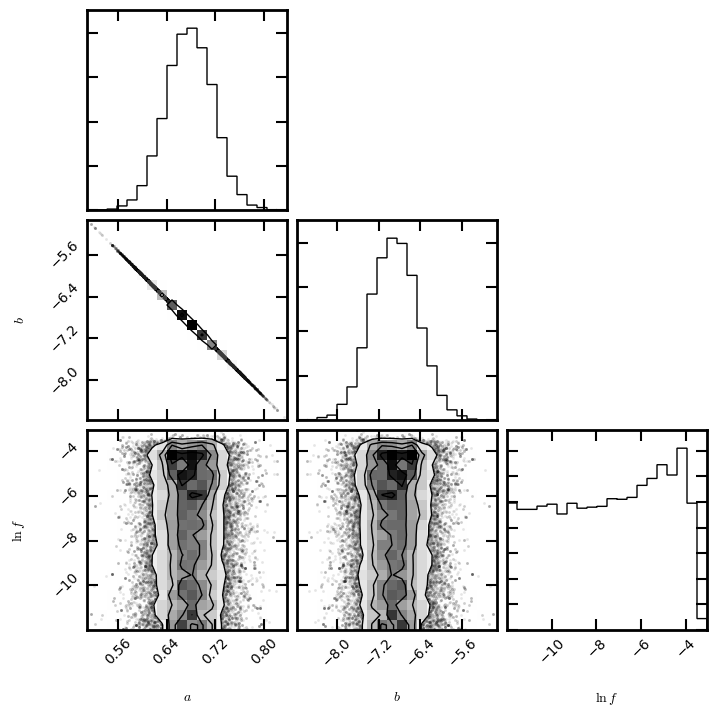

Start the MCMC runs
CPU times: user 2min 36s, sys: 801 ms, total: 2min 36s
Wall time: 2min 38s
Done
MCMC result:
             a = 0.547115411658 +0.0101341030024 -0.0104786643146
             b = -5.37664970616 +0.120344311863 -0.116685150565 
             f = 0.0218727245846 +0.00622961278041 -0.0173695037139
            


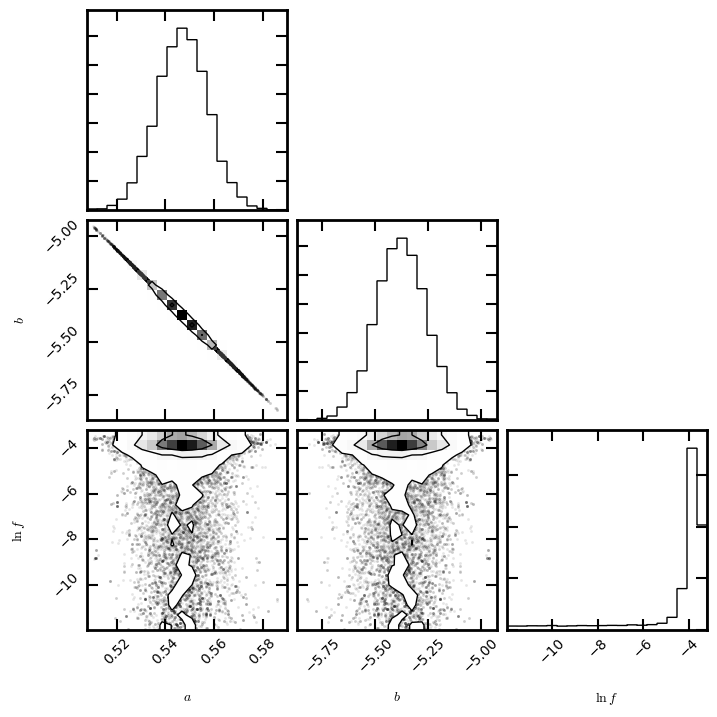

Start the MCMC runs
CPU times: user 2min 13s, sys: 1.18 s, total: 2min 14s
Wall time: 2min 16s
Done
MCMC result:
             a = 0.745457487375 +0.0560504439759 -0.0548090391912
             b = -7.62014563211 +0.645459790946 -0.660982807283 
             f = 0.000633528787291 +0.0137168742059 -0.000605467211947
            


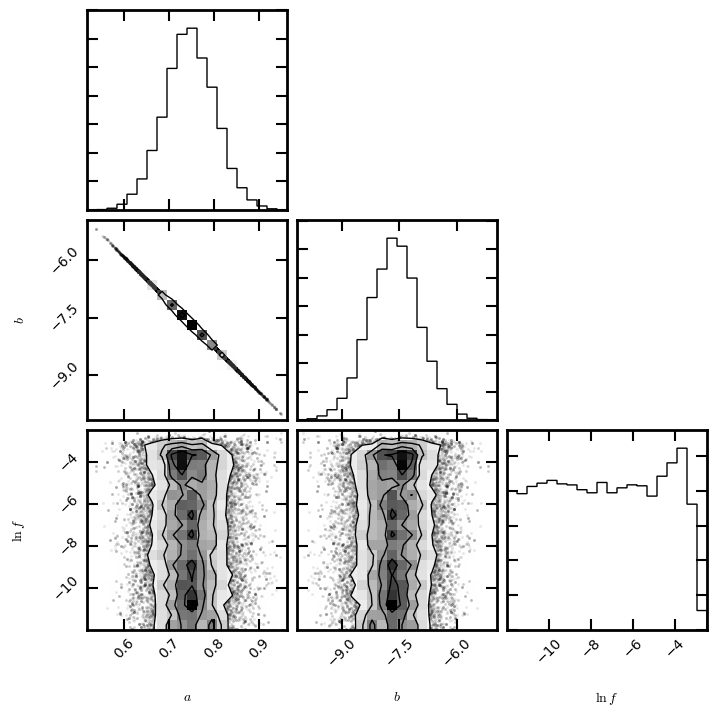

In [217]:
# contral the scaling relation using EMcee

# Priors
def lnprior(theta):
    a, b, lnf = theta
    if 0.20 < a < 1.50 and -12.0 < b < -2.0 and -12.0 < lnf < 0.0:
        return 0.0
    return -np.inf

# Use Emcee to fit a straight line 
def emceeLine(x, y, yerr, nwalkers=100, ndim=3, nburn=200, 
              nstep=800, show=True, iniA=None, iniB=None, 
              returnSamples=True): 
    """ Initial guesses from simple LLS fitting """
    if iniA is None or iniB is None:
        a_ls, b_ls = llsLine(x, y, yerr)
    else:
        a_ls, b_ls = iniA, iniB
    initial = [a_ls, b_ls, 0.00]
    
    """ Start the sampler """
    sampler = emcee.EnsembleSampler(nwalkers, ndim, 
                                    lnprob, args=(x, y, yerr))
    """ Initializing the walkers. """
    np.random.seed(0)
    guesses = [initial + (1e-2*np.random.randn(ndim)) 
               for i in range(nwalkers)]
    """ Run MCMC """
    print("Start the MCMC runs")
    %time sampler.run_mcmc(guesses, nstep)
    print("Done")
    """ Flatten the chain so that we have a flat list of samples """
    samples = sampler.chain[:, nburn:, :].reshape(-1, ndim)
    if show:   
        fig = corner.corner(samples, 
                            labels=["$a$", "$b$", "$\ln\,f$"])
    """ Compute the quantiles. """
    samples[:, 2] = np.exp(samples[:, 2])
    a_mcmc, b_mcmc, f_mcmc = map(lambda v: (v[1], v[2]-v[1], v[1]-v[0]),
                                 zip(*np.percentile(samples, [16, 50, 84],
                                                    axis=0)))
    print("""MCMC result:
             a = {0[0]} +{0[1]} -{0[2]}
             b = {1[0]} +{1[1]} -{1[2]} 
             f = {2[0]} +{2[1]} -{2[2]}
            """.format(a_mcmc, b_mcmc, f_mcmc))
    if returnSamples:
        return a_mcmc, b_mcmc, f_mcmc, samples
    else:
        return a_mcmc, b_mcmc, f_mcmc

# For nonBCG; Massive sample 
nonXX, nonYY, nonYerr = nonbcgFit['logm_100'].data, np.log10(nonbcgFit['r50_100'].data), nonbcgFit['MSTAR_ERR'].data * 0.0 + 0.09

nonA, nonB, nonF, nonS = emceeLine(nonXX, nonYY, nonYerr, 
                                   nwalkers=100, ndim=3, nburn=200, 
                                   nstep=800, show=True,
                                   iniA=0.64, iniB=-7.0)

# Best paramters
aNonB, aNonU, aNonL = nonA
bNonB, bNonU, bNonL = nonB

plt.show()

# For nonBCG; The whole sample
nonXX2, nonYY2, nonYerr2 = nonbcgFit2['logm_100'].data, np.log10(nonbcgFit2['r50_100'].data), nonbcgFit2['MSTAR_ERR'].data * 0.0 + 0.09

nonA2, nonB2, nonF2, nonS2 = emceeLine(nonXX2, nonYY2, nonYerr2, 
                                       nwalkers=100, ndim=3, nburn=200, 
                                       nstep=800, show=True,
                                       iniA=0.64, iniB=-7.0)

# Best paramters
aNonB2, aNonU2, aNonL2 = nonA2
bNonB2, bNonU2, bNonL2 = nonB2

plt.show()

# For redBCG; The whole sample
redXX, redYY, redYerr = redbcgFit['logm_100'].data, np.log10(redbcgFit['r50_100'].data), redbcgFit['MSTAR_ERR'].data * 0.0 + 0.09

redA, redB, redF, redS = emceeLine(redXX, redYY, redYerr, 
                                   nwalkers=100, ndim=3, nburn=200, 
                                   nstep=800, show=True, 
                                   iniA=0.64, iniB=-7.0)

# Best paramters
aRedB, aRedU, aRedL = redA
bRedB, bRedU, bRedL = redB

plt.show()

## Show the relation using logm_100

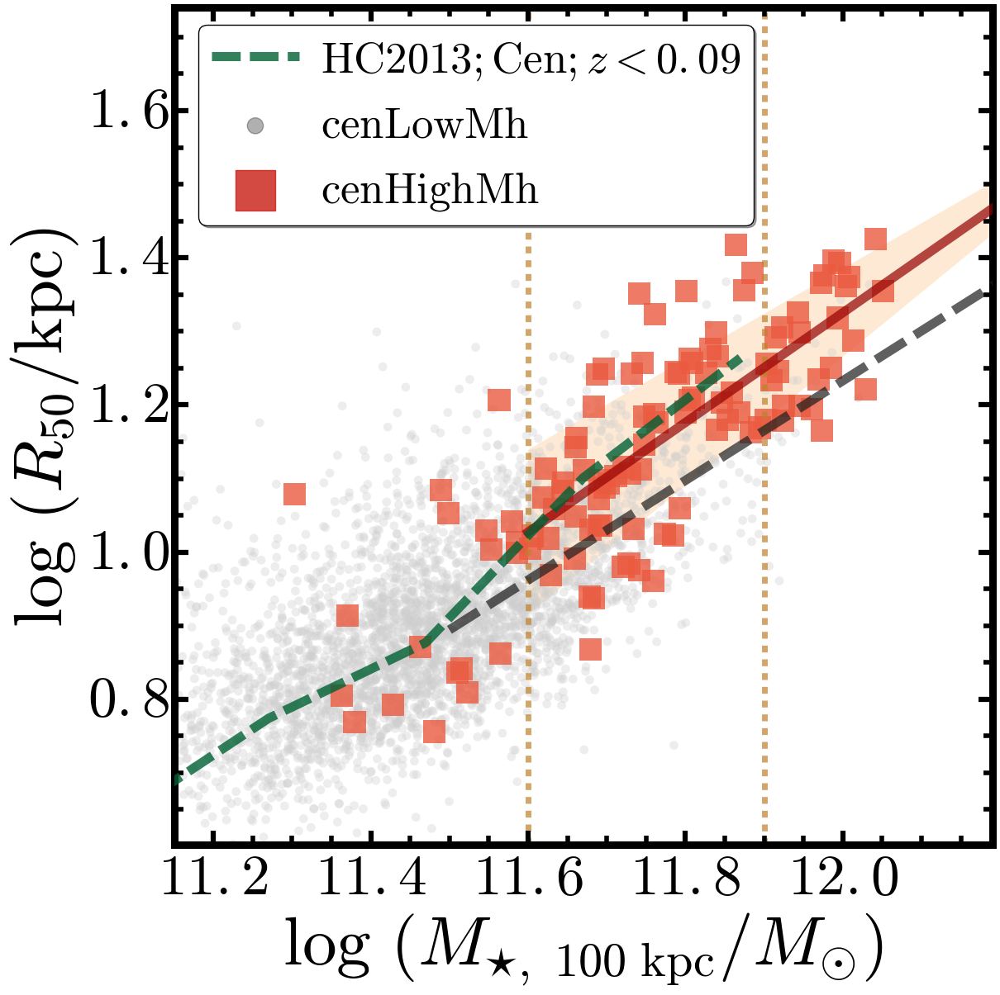

In [219]:
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(12, 12))
fig.subplots_adjust(left=0.17, right=0.995, 
                    bottom=0.15, top=0.995,
                    wspace=0.00, hspace=0.00)

#-----------------------------------------------------------------#
#-----------------------------------------------------------------#
nonbcgBin = nonbcgUse[(nonbcgUse['z_use'] >= 0.30) & 
                      (nonbcgUse['z_use'] <= 0.50)]
redbcgBin = redbcgUse[(redbcgUse['z_use'] >= 0.30) & 
                      (redbcgUse['z_use'] <= 0.50)]

# logM100 - C82
ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=50, ylabel=50, border=6.5,
                    xtickFormat='$\mathrm{%4.1f}$', ytickFormat='$\mathrm{%3.1f}$')

ax1.scatter((nonbcgBin['logm_100']), 
            np.log10(nonbcgBin['r50_100']), 
            marker='o', edgecolor='none', cmap=BLK, s=60,
            c=BLK(0.3), 
            alpha=0.35, label='$\mathrm{cenLowMh}$',
            rasterized=True)
ax1.scatter((redbcgBin['logm_100']), 
            np.log10(redbcgBin['r50_100']), 
            marker='s', edgecolor='none', cmap=ORG,
            s=380, c=ORG(0.65), vmin=-0.5,
            alpha=0.8, label='$\mathrm{cenHighMh}$',
            rasterized=True)

# Scaling Relations
ax1.set_rasterization_zorder(0) 
xx = np.linspace(11.6, 12.2, 100)
yy1 = xx * (aRedB + 0.13) + (bRedB - 1.62)
yy2 = xx * (aRedB - 0.13) + (bRedB + 1.62)
ax1.fill_between(xx, yy1, yy2, color=ORG(0.30), alpha=0.40, zorder=0, 
                 edgecolor='none')
ax1.plot(xx, (aRedB * xx + bRedB),
         linestyle='-', color=ORG(0.95), alpha=0.7, 
         linewidth=8.0, zorder=5)
#for ii, sample in enumerate(redS[201:]):
#    if (ii % 11) == 0:
#        ax1.plot(xx, (sample[0] * xx + sample[1]), zorder=0,
#                 linestyle='-', color=ORG(0.3), alpha=0.15, linewidth=0.5)

xx = np.linspace(11.5, 12.2, 100)
yy1 = xx * (aNonB + 0.016) + (bNonB - 0.20)
yy2 = xx * (aNonB - 0.016) + (bNonB + 0.19)
#ax1.fill_between(xx, yy1, yy2, color=BLK(0.40), alpha=0.4, zorder=0, 
#                 edgecolor=BLK(0.8))
ax1.plot(xx, (aNonB * xx + bNonB),
         linestyle='--', color=BLK(0.9), alpha=0.7, 
         linewidth=8.0, zorder=4, dashes=(30,10))
#for ii, sample in enumerate(nonS[201:]):
#    if (ii % 11) == 0:
#        ax1.plot(xx, (sample[0] * xx + sample[1]), zorder=0,
#                 linestyle='-', color=BLK(0.3), alpha=0.2, linewidth=0.5)

# X, Y Label
ax1.set_xlabel('$\log\ ({M_{\star,\ 100\ \mathrm{kpc}}}/M_{\odot})$', 
               size=60)
ax1.set_ylabel('$\log\ (R_{50} / \mathrm{kpc})$', size=60)

# X, Y limits
ax1.set_xlim(11.15, 12.19)
ax1.set_ylim(0.602, 1.74)

# Overplot Mass-Size relation from Huertas-Company+13: 
ax1.plot(logmC_hc13 - 0.03 + 0.10, logrC_hc13, linestyle='--', linewidth=8.0, alpha=0.8,
         c=GRN(0.9), label='$\mathrm{HC2013; Cen}; z<0.09$', dashes=(25,8), zorder=100)
#ax1.plot(logM_etg_arr + 0.10, logR_etg_z1_vdW14, linestyle='--', linewidth=8.0, alpha=0.6,
#         c=PURPLE0, label='$\mathrm{vdW14; ETG}; z=0.25$')

# Legend
l_handles, l_labels = ax1.get_legend_handles_labels()
ax1.legend(l_handles, l_labels, loc=(0.03, 0.74),
           shadow=True, fancybox=True, 
           numpoints=1, fontsize=38, scatterpoints=1, 
           markerscale=1.8, borderpad=0.3, handletextpad=0.5)
legend = ax1.get_legend()
legend.legendHandles[1].set_color(BLK(0.9))
legend.legendHandles[2].set_color(ORG(0.8))

ax1.axvline(11.60, linestyle='--', linewidth=5.0, alpha=0.7, c=BROWN0)
ax1.axvline(11.90, linestyle='--', linewidth=5.0, alpha=0.7, c=BROWN0)

#-----------------------------------------------------------------#
fig.savefig(os.path.join(figDir, 'redbcg_mass_r50.pdf'), dpi=150)

plt.show()

## Fit the relation using logm_150

/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:5: RuntimeWarning: invalid value encountered in greater_equal
/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:5: RuntimeWarning: invalid value encountered in less_equal


Start the MCMC runs
CPU times: user 2min 37s, sys: 1.14 s, total: 2min 38s
Wall time: 2min 41s
Done
MCMC result:
             a = 0.778907825757 +0.0400206044275 -0.0411051910921
             b = -8.0548075326 +0.481226747805 -0.468492878488 
             f = 0.0503549905478 +0.00450689230303 -0.00474835184307
            


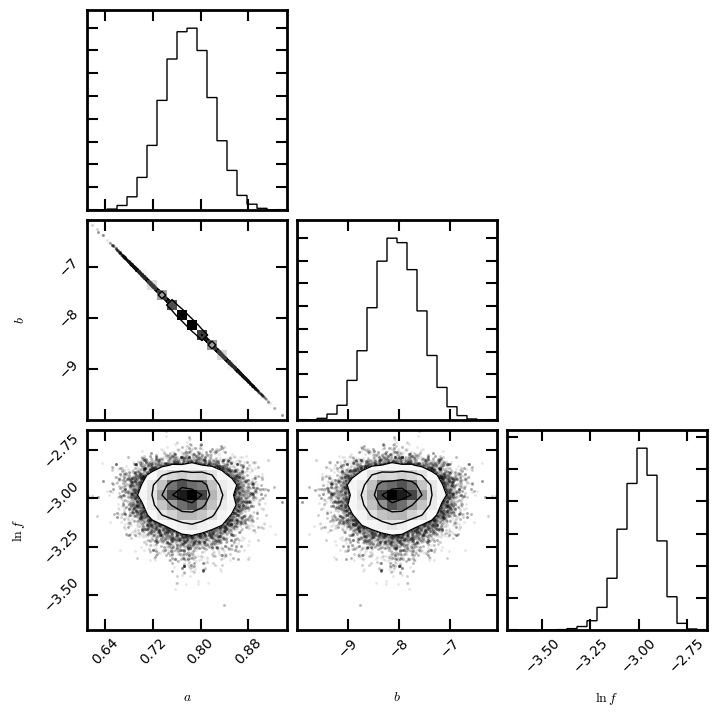

Start the MCMC runs
CPU times: user 2min 17s, sys: 1.07 s, total: 2min 18s
Wall time: 2min 20s
Done
MCMC result:
             a = 0.840679462361 +0.0607068875156 -0.0623865310828
             b = -8.70147854194 +0.734975940608 -0.718125805102 
             f = 0.0472235132573 +0.0140413756195 -0.0170266793476
            


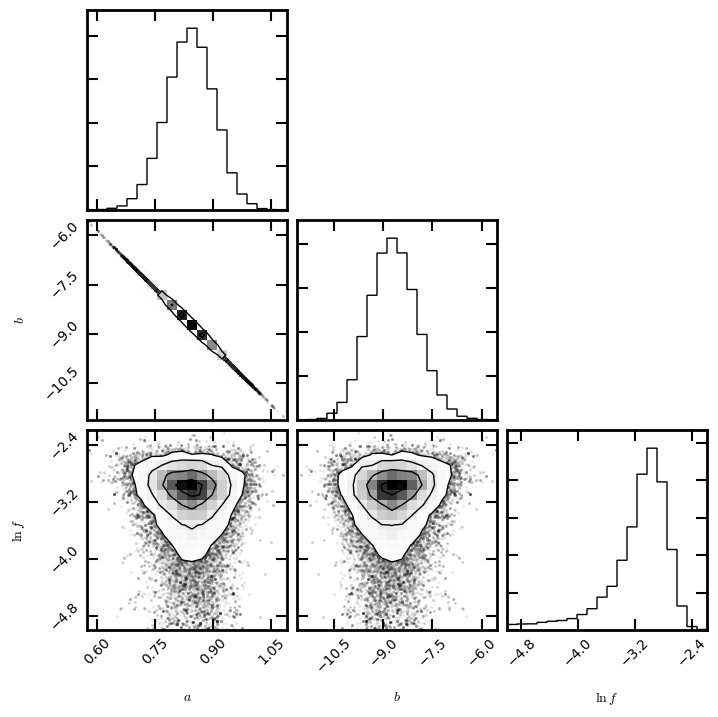

In [117]:
nonbcgFit = nonbcgUse[(nonbcgUse['logm_150'] >= 11.6) & 
                      (nonbcgUse['logm_150'] <= 12.3) & 
                      (nonbcgUse['r50_100'] >= 2.00) & 
                      (nonbcgUse['r50_100'] <= 100.00) & 
                      (nonbcgUse['z_use'] >= 0.30) & 
                      (nonbcgUse['z_use'] <= 0.50)]

# Priors
def lnprior(theta):
    a, b, lnf = theta
    if 0.20 < a < 1.50 and -12.0 < b < -2.0 and -5.0 < lnf < 0.0:
        return 0.0
    return -np.inf

# Use Emcee to fit a straight line 
def emceeLine(x, y, yerr, nwalkers=100, ndim=3, nburn=100, 
              nstep=600, show=True, iniA=None, iniB=None, 
              returnSamples=True): 
    """ Initial guesses from simple LLS fitting """
    if iniA is None or iniB is None:
        a_ls, b_ls = llsLine(x, y, yerr)
    else:
        a_ls, b_ls = iniA, iniB
    initial = [a_ls, b_ls, 0.00]
    
    """ Start the sampler """
    sampler = emcee.EnsembleSampler(nwalkers, ndim, 
                                    lnprob, args=(x, y, yerr))
    """ Initializing the walkers. """
    np.random.seed(0)
    guesses = [initial + (1e-2*np.random.randn(ndim)) 
               for i in range(nwalkers)]
    """ Run MCMC """
    print("Start the MCMC runs")
    %time sampler.run_mcmc(guesses, nstep)
    print("Done")
    """ Flatten the chain so that we have a flat list of samples """
    samples = sampler.chain[:, nburn:, :].reshape(-1, ndim)
    if show:   
        fig = corner.corner(samples, 
                            labels=["$a$", "$b$", "$\ln\,f$"])
    """ Compute the quantiles. """
    samples[:, 2] = np.exp(samples[:, 2])
    a_mcmc, b_mcmc, f_mcmc = map(lambda v: (v[1], v[2]-v[1], v[1]-v[0]),
                                 zip(*np.percentile(samples, [16, 50, 84],
                                                    axis=0)))
    print("""MCMC result:
             a = {0[0]} +{0[1]} -{0[2]}
             b = {1[0]} +{1[1]} -{1[2]} 
             f = {2[0]} +{2[1]} -{2[2]}
            """.format(a_mcmc, b_mcmc, f_mcmc))
    if returnSamples:
        return a_mcmc, b_mcmc, f_mcmc, samples
    else:
        return a_mcmc, b_mcmc, f_mcmc

# For the nonBCG
nonXX, nonYY, nonYerr = nonbcgFit['logm_max'].data, np.log10(nonbcgFit['r50_max'].data), nonbcgFit['MSTAR_ERR'].data * 0.0 + 0.09

nonA, nonB, nonF, nonS = emceeLine(nonXX, nonYY, nonYerr, 
                                   nwalkers=100, ndim=3, nburn=100, 
                                   nstep=600, show=True,
                                   iniA=0.68, iniB=-7.0)

# Best paramters
aNonB, aNonU, aNonL = nonA
bNonB, bNonU, bNonL = nonB

plt.show()

# For the redBCG
redXX, redYY, redYerr = redbcgFit['logm_max'].data, np.log10(redbcgFit['r50_max'].data), redbcgFit['MSTAR_ERR'].data * 0.0 + 0.09

redA, redB, redF, redS = emceeLine(redXX, redYY, redYerr, 
                                   nwalkers=100, ndim=3, nburn=100, 
                                   nstep=600, show=True, 
                                   iniA=0.68, iniB=-7.0)

# Best paramters
aRedB, aRedU, aRedL = redA
bRedB, bRedU, bRedL = redB

plt.show()

## Show the relation using logm_150

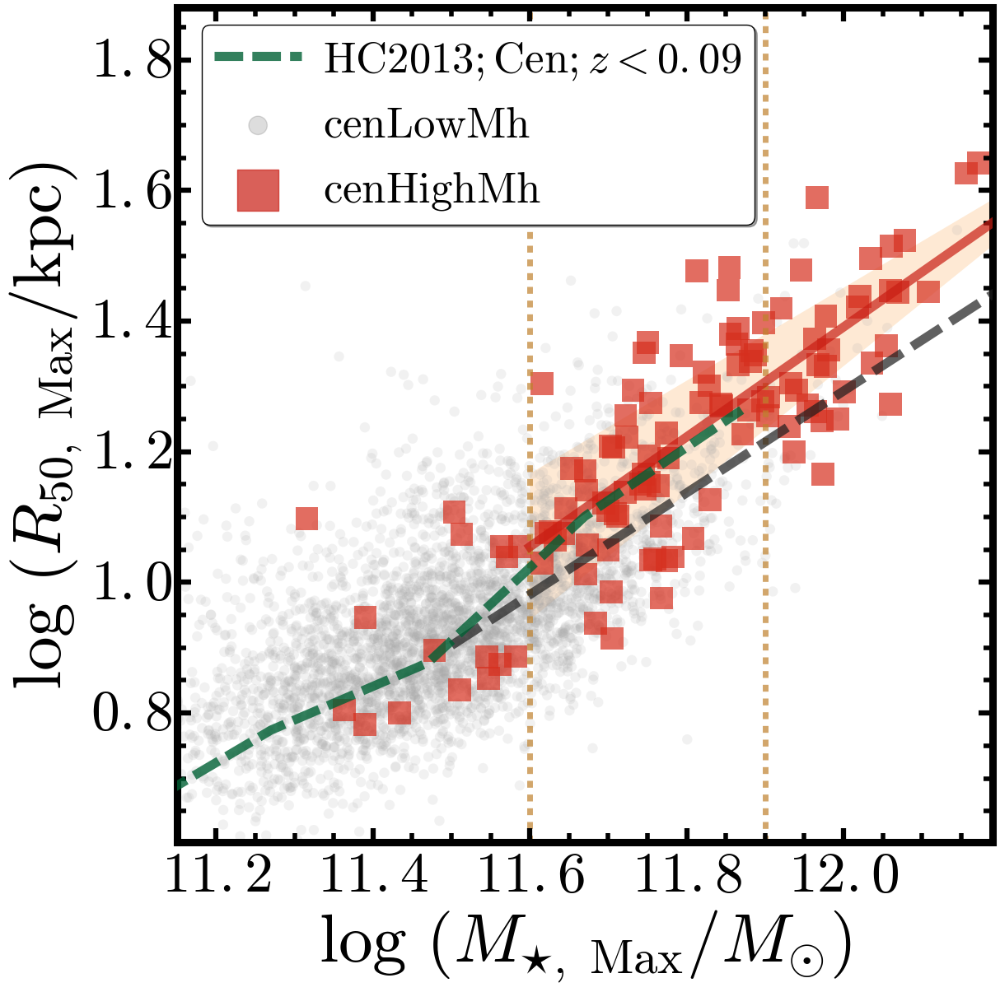

In [56]:
aRedB, bRedB = 0.841, -8.701
aNonB, bNonB = 0.779, -8.055
#-----------------------------------------------------------------#
fig = plt.figure(figsize=(12, 12))
fig.subplots_adjust(left=0.17, right=0.995, 
                    bottom=0.15, top=0.995,
                    wspace=0.00, hspace=0.00)

#-----------------------------------------------------------------#
#-----------------------------------------------------------------#
nonbcgBin = nonbcgUse[(nonbcgUse['z_use'] >= 0.30) & 
                      (nonbcgUse['z_use'] <= 0.50)]
redbcgBin = redbcgUse[(redbcgUse['z_use'] >= 0.30) & 
                      (redbcgUse['z_use'] <= 0.50)]

# logM100 - C82
ax1 = fig.add_subplot(111)
ax1 = songPlotSetup(ax1, xlabel=50, ylabel=50, border=6.5,
                    xtickFormat='$\mathrm{%4.1f}$', ytickFormat='$\mathrm{%3.1f}$')

ax1.scatter((nonbcgBin['logm_max']), 
            np.log10(nonbcgBin['r50_max']), 
            marker='o', edgecolor='none', cmap=BLK, s=80,
            c=BLK(0.45), 
            alpha=0.15, label='$\mathrm{cenLowMh}$',
            rasterized=True)
ax1.scatter((redbcgBin['logm_max']), 
            np.log10(redbcgBin['r50_max']), 
            marker='s', edgecolor='none', cmap=ORG,
            s=400, c=ORG(0.75), vmin=-0.5,
            alpha=0.7, label='$\mathrm{cenHighMh}$',
            rasterized=True)

# Scaling Relations
ax1.set_rasterization_zorder(0) 
xx = np.linspace(11.6, 12.2, 100)
yy1 = xx * (aRedB + 0.13) + (bRedB - 1.62)
yy2 = xx * (aRedB - 0.13) + (bRedB + 1.62)
ax1.fill_between(xx, yy1, yy2, color=ORG(0.30), alpha=0.40, zorder=0, 
                 edgecolor='none')
ax1.plot(xx, (aRedB * xx + bRedB),
         linestyle='-', color=ORG(0.8), alpha=0.7, 
         linewidth=8.0, zorder=5)
#for ii, sample in enumerate(redS[201:]):
#    if (ii % 11) == 0:
#        ax1.plot(xx, (sample[0] * xx + sample[1]), zorder=0,
#                 linestyle='-', color=ORG(0.3), alpha=0.15, linewidth=0.5)

xx = np.linspace(11.5, 12.2, 100)
yy1 = xx * (aNonB + 0.016) + (bNonB - 0.20)
yy2 = xx * (aNonB - 0.016) + (bNonB + 0.19)
#ax1.fill_between(xx, yy1, yy2, color=BLK(0.40), alpha=0.4, zorder=0, 
#                 edgecolor=BLK(0.8))
ax1.plot(xx, (aNonB * xx + bNonB),
         linestyle='--', color=BLK(0.9), alpha=0.7, 
         linewidth=8.0, zorder=4, dashes=(30,10))
#for ii, sample in enumerate(nonS[201:]):
#    if (ii % 11) == 0:
#        ax1.plot(xx, (sample[0] * xx + sample[1]), zorder=0,
#                 linestyle='-', color=BLK(0.3), alpha=0.2, linewidth=0.5)

# X, Y Label
ax1.set_xlabel('$\log\ ({M_{\star,\ \mathrm{Max}}}/M_{\odot})$', 
               size=60)
ax1.set_ylabel('$\log\ (R_{50,\ \mathrm{Max}} / \mathrm{kpc})$', size=60)

# X, Y limits
ax1.set_xlim(11.15, 12.19)
ax1.set_ylim(0.602, 1.88)

# Overplot Mass-Size relation from Huertas-Company+13: 
ax1.plot(logmC_hc13 - 0.03 + 0.10, logrC_hc13, linestyle='--', linewidth=8.0, alpha=0.8,
         c=GRN(0.9), label='$\mathrm{HC2013; Cen}; z<0.09$', dashes=(25,8), zorder=100)
#ax1.plot(logM_etg_arr + 0.10, logR_etg_z1_vdW14, linestyle='--', linewidth=8.0, alpha=0.6,
#         c=PURPLE0, label='$\mathrm{vdW14; ETG}; z=0.25$')

# Legend
l_handles, l_labels = ax1.get_legend_handles_labels()
ax1.legend(l_handles, l_labels, loc=(0.03, 0.74),
           shadow=True, fancybox=True, 
           numpoints=1, fontsize=38, scatterpoints=1, 
           markerscale=1.8, borderpad=0.3, handletextpad=0.5)
legend = ax1.get_legend()
legend.legendHandles[1].set_color(BLK(0.9))
legend.legendHandles[2].set_color(ORG(0.8))

ax1.axvline(11.60, linestyle='--', linewidth=5.0, alpha=0.7, c=BROWN0)
ax1.axvline(11.90, linestyle='--', linewidth=5.0, alpha=0.7, c=BROWN0)

#-----------------------------------------------------------------#
fig.savefig(os.path.join(figDir, 'mass_size_r50_150.pdf'), dpi=150)

plt.show()

# Comparisons of stellar mass within different apertures

## logM_100 v.s. (logM_100 - logM_10) for the logM_100 matched samples

In [161]:
# definitions for the axes
left, width    = 0.144, 0.653
right          = left + width 
bottom, height = 0.135, 0.856
bottom_h = left_h = left + width + 0.02
recScat = [left,   bottom, width, height]
recHist = [right,  bottom,  0.20, height]

In [132]:
nonbcgFit = nonbcgUse[(nonbcgUse['logm_100'] >= 11.4) & 
                      (nonbcgUse['logm_100'] <= 12.2) & 
                      (nonbcgUse['logm_10'] >= 10.5) &
                      (nonbcgUse['z_use'] >= 0.3) & 
                      (nonbcgUse['z_use'] <= 0.5)]

redbcgFit = redbcgUse[(redbcgUse['logm_100'] >= 11.4) & 
                      (redbcgUse['logm_100'] <= 12.2) & 
                      (redbcgUse['logm_10'] >= 10.5) &
                      (redbcgUse['lambda_redm'] >= 30.0) & 
                      (redbcgUse['p_cen_1_redm'] >= 0.7) & 
                      (redbcgUse['z_use'] >= 0.3) & 
                      (redbcgUse['z_use'] <= 0.5)]

a_ls, b_ls = llsLine(nonbcgFit['logm_100'].data, (nonbcgFit['logm_100'].data - nonbcgFit['logm_10'].data), nonbcgFit['MSTAR_ERR'].data * 0.0 + 0.02)
print(a_ls, b_ls)
a_ls, b_ls = llsLine(redbcgFit['logm_100'].data, (redbcgFit['logm_100'].data - redbcgFit['logm_10'].data), redbcgFit['MSTAR_ERR'].data * 0.0 + 0.03)
print(a_ls, b_ls)

a_ls, b_ls = llsLine(nonbcgFit['logm_max'].data, (nonbcgFit['logm_max'].data - nonbcgFit['logm_10'].data), nonbcgFit['MSTAR_ERR'].data * 0.0 + 0.02)
print(a_ls, b_ls)
a_ls, b_ls = llsLine(redbcgFit['logm_max'].data, (redbcgFit['logm_max'].data - redbcgFit['logm_10'].data), redbcgFit['MSTAR_ERR'].data * 0.0 + 0.03)
print(a_ls, b_ls)

LLS: a = 0.35795 ; b =-3.86560
0.357952687322 -3.86559959416
LLS: a = 0.55975 ; b =-6.18359
0.559753265944 -6.18358726401
LLS: a = 0.40326 ; b =-4.37745
0.403258023527 -4.37745167708
LLS: a = 0.62283 ; b =-6.91019
0.622834137721 -6.91019232097


LLS: a = 0.35795 ; b =-3.86560
Start the MCMC runs
CPU times: user 2min 38s, sys: 932 ms, total: 2min 39s
Wall time: 2min 42s
Done
MCMC result:
             a = 0.354681433827 +0.00999066982787 -0.00961280231705
             b = -3.8279224921 +0.111334430487 -0.11521681719 
             f = 0.0924712106202 +0.0062886312467 -0.00628827204171
            


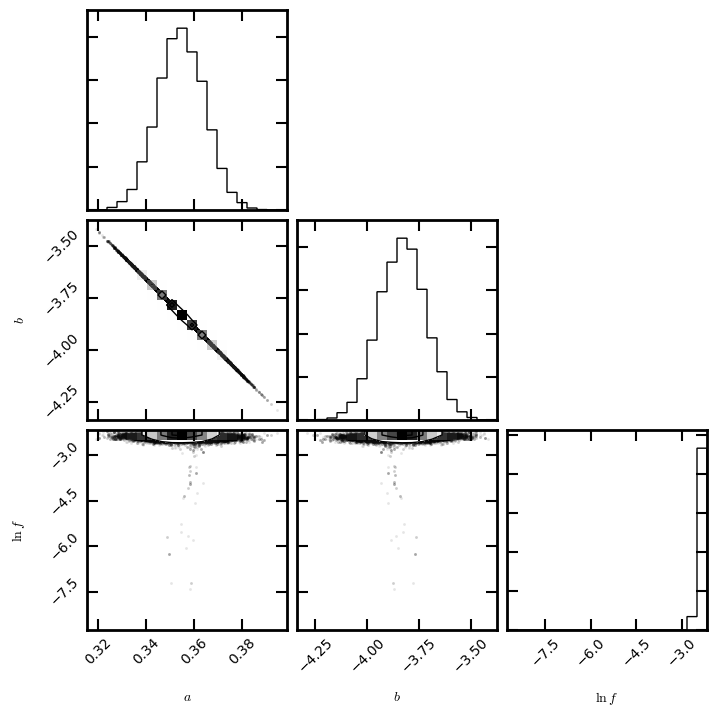

LLS: a = 0.55975 ; b =-6.18359
Start the MCMC runs
CPU times: user 2min 11s, sys: 879 ms, total: 2min 12s
Wall time: 2min 13s
Done
MCMC result:
             a = 0.559289160444 +0.0468906331159 -0.0463287023415
             b = -6.17742164137 +0.544411770076 -0.551508413907 
             f = 0.0976723409568 +0.0219947015838 -0.0228369025281
            


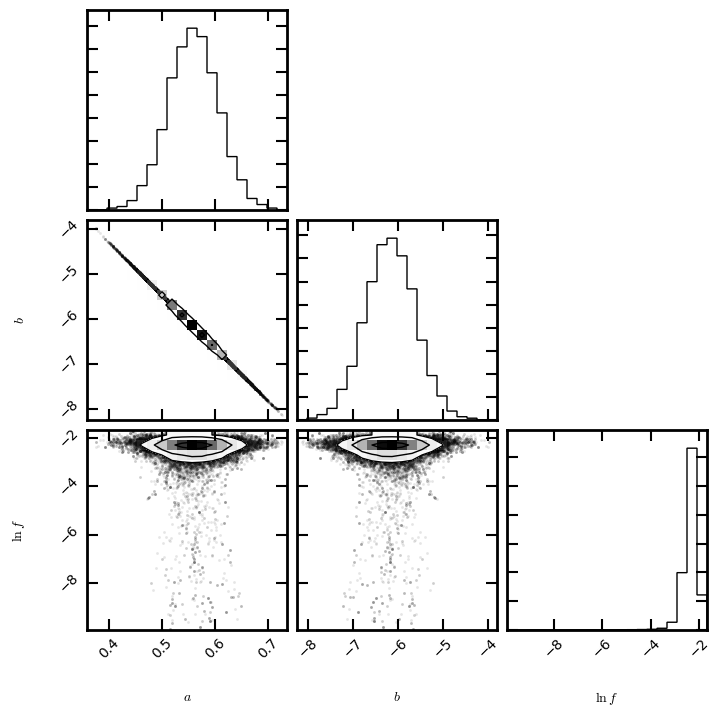

In [142]:
# Priors
def lnprior(theta):
    a, b, lnf = theta
    if 0.02 < a < 1.5 and -10.0 < b < 1.0 and -10.0 < lnf < 1.0:
        return 0.0
    return -np.inf

# For nonBCGs
nonXX, nonYY, nonYerr = nonbcgFit['logm_100'].data, nonbcgFit['logm_100'].data - nonbcgFit['logm_10'].data, nonbcgFit['MSTAR_ERR'].data * 0.0 + 0.05

nonA, nonB, nonF, nonS = emceeLine(nonXX, nonYY, nonYerr, 
                                   nwalkers=100, ndim=3, nburn=100, 
                                   nstep=600, show=True,
                                   iniA=None, iniB=None)

# Best paramters
aNonB, aNonU, aNonL = nonA
bNonB, bNonU, bNonL = nonB

plt.show()

# For redBCGs
redXX, redYY, redYerr = redbcgFit['logm_100'].data, redbcgFit['logm_100'].data - redbcgFit['logm_10'].data, redbcgFit['MSTAR_ERR'].data * 0.0 + 0.05

redA, redB, redF, redS = emceeLine(redXX, redYY, redYerr, 
                                   nwalkers=100, ndim=3, nburn=100, 
                                   nstep=600, show=True,
                                   iniA=None, iniB=None)

# Best paramters
aredB, aredU, aredL = redA
bredB, bredU, bredL = redB

plt.show()

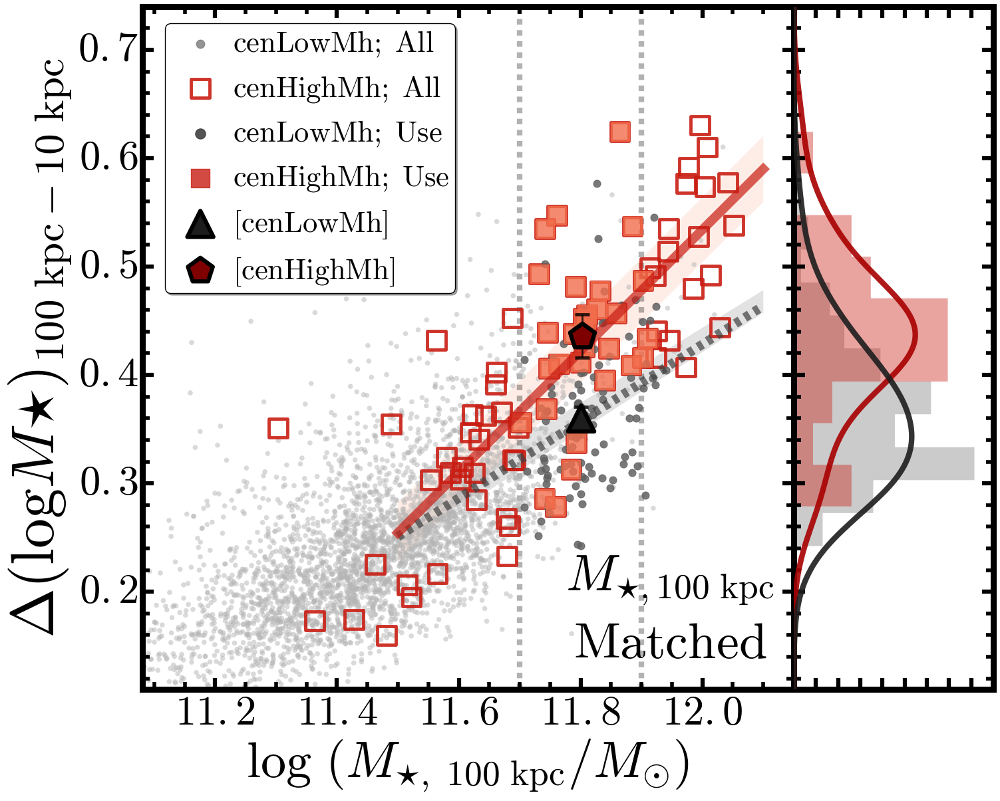

In [168]:
massStr1, massStr2, massStr3 = '100', '100', '10'

redbcgTmp = redbcgUse[(redbcgUse['logm_100'] >= 11.2) & 
                      (redbcgUse['logm_100'] <= 12.3) & 
                      (redbcgUse['lambda_redm'] >= 30.0) &
                      (redbcgUse['p_cen_1_redm'] >= 0.7) &
                      (redbcgUse['z_use'] >= 0.30) & 
                      (redbcgUse['z_use'] <= 0.50)]

nonbcgTmp = nonbcgUse[(nonbcgUse['logm_100'] >= 11.0) & 
                      (nonbcgUse['logm_100'] <= 12.3) & 
                      (nonbcgUse['z_use'] >= 0.30) & 
                      (nonbcgUse['z_use'] <= 0.50)]
#-------------------------------------------------------------------------------#
parent1, parent2 = redbcgTmp, nonbcgTmp
sample1a, sample1b, sample1c = redbcgM100b, redbcgM100b, redbcgM100b
sample2a, sample2b, sample2c = nonbcgM100b, nonbcgM100b, nonbcgM100b
col1, col2, col3 = 'logm_' + massStr1, 'logm_' + massStr2, 'logm_' + massStr3

xSep1, xSep2, xSep3 = None, 11.7, 11.9
xMin, xMax, yMin, yMax = 11.08, 12.15, 0.11, 0.74
xLabel = '$\log\ (M_{\star}/M_{\odot})\ (%s\ \mathrm{kpc})$' % massStr1 
yLabel = '$\Delta(\log M{\star})_{\mathrm{%s\ kpc}-\mathrm{%s\ kpc}}$' % (massStr2, massStr3) 
outPng = 'hscMassive_m%s_dm%s-%s_' % (massStr1, massStr2, massStr3) + sedMod + '_m100sample'

nResample=500
xSep1=11.60
xSep2=11.70
xSep3=11.90
lamLimit=30
pcenLimit=0.7
sizeCol1=None
sizeNorm=0.1
colorCol1=None
colorLow=0.1
colorUpp=0.55
showBin1=True
showBin2=False
showHist1=False
showHist2=True
yKernel=0.04
xLabel='$\log\ (M_{\star,\ 100\ \mathrm{kpc}}/M_{\odot})$'
yLabel='$\Delta(\log M{\star})_{\mathrm{100\ kpc}-\mathrm{10\ kpc}}$'
outPng=outPng
save=True
outlineBin1=True
color1a=BLK(0.4)
color1b=BLK(0.7)
color2a=ORG(0.8)
color2b=ORG(0.6)
cmap1=BLK
cmap2=ORG
figDir=figDir
colorMin=None
colorMax=None
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}$'
xLegend=0.035
yLegend=0.600


"""
For publication
"""
# Statistics of the two subsamples
med_1ax = confidence_interval(sample1a[col1], axis=0, alpha=[SIGMA1, 1.0], 
                              metric=np.nanmedian, numResamples=nResample, 
                              interpolate=True)
if col3 is not None:
    med_1ay = confidence_interval((sample1a[col2] - sample1a[col3]), 
                                  axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)
else:
    med_1ay = confidence_interval(sample1a[col2], 
                                  axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)

med_2ax = confidence_interval(sample2a[col1], axis=0, alpha=[SIGMA1, 1.0], 
                              metric=np.nanmedian, numResamples=nResample, 
                              interpolate=True)
if col3 is not None:
    med_2ay = confidence_interval((sample2a[col2] - sample2a[col3]), 
                                  axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)
else:
    med_2ay = confidence_interval(sample2a[col2], 
                                  axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)

med_1bx = confidence_interval(sample1b[col1], axis=0, alpha=[SIGMA1, 1.0], 
                              metric=np.nanmedian, numResamples=nResample, 
                              interpolate=True)
if col3 is not None:
    med_1by = confidence_interval((sample1b[col2] - sample1b[col3]), 
                                  axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)
else:
    med_1by = confidence_interval(sample1b[col2], 
                                  axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)

med_2bx = confidence_interval(sample2b[col1], axis=0, alpha=[SIGMA1, 1.0], 
                              metric=np.nanmedian, numResamples=nResample, 
                              interpolate=True)
if col3 is not None:
    med_2by = confidence_interval((sample2b[col2] - sample2b[col3]), 
                                  axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)
else:
    med_2by = confidence_interval(sample2b[col2], 
                                  axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)

# ------------------------------------------------------------------------------------ #
fig = plt.figure(figsize=(15, 12))
ax1 = plt.axes(recScat)
ax2 = plt.axes(recHist)
ax1 = songPlotSetup(ax1, xlabel=45, ylabel=45, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)
ax2 = songPlotSetup(ax2, border=6.5, 
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

# ---------------------------------------------------------------------------
# Scatter plot
## Mass separation of two bins
ax1.axvline(xSep2, linewidth=6.0, linestyle='--', c='k', alpha=0.3, zorder=0)
ax1.axvline(xSep3, linewidth=6.0, linestyle='--', c='k', alpha=0.3, zorder=0)
## Horizontal line for 0.0
ax1.axhline(0.0, linewidth=5.0, linestyle='-', c='k', alpha=0.2)

# Parent samples 
if col3 is not None:
    p1 = ax1.scatter(parent2[col1], 
                     parent2[col2] - parent2[col3], s=30.0, 
                     alpha=0.50, facecolor=color1a, edgecolor='none', 
                     label='$\mathrm{cenLowMh;\ All}$')
else:
    p1 = ax1.scatter(parent2[col1], 
                     parent2[col2], s=30.0, 
                     alpha=0.50, facecolor=color1a, edgecolor='none', 
                     label='$\mathrm{cenLowMh;\ All}$')

if sizeCol1 is None: 
    size1 = 400.0
else:
    size1 = ((parent1[sizeCol1] - sizeNorm) * 750.0)
if col3 is not None:
    p3 = ax1.scatter(parent1[col1], 
                     parent1[col2] - parent1[col3], edgecolor=color2a,
                     s=size1, alpha=0.9, facecolor='none', 
                     label='$\mathrm{cenHighMh;\ All}$', 
                     marker='s', linewidth=3.5)
else:
    p3 = ax1.scatter(parent1[col1], 
                     parent1[col2], edgecolor=color2a,
                     s=size1, alpha=0.9, facecolor='none', 
                     label='$\mathrm{cenHighMh;\ All}$', 
                     marker='s', linewidth=3.5)

# Matched ones
if col3 is not None:
    p2 = ax1.scatter(sample2c[col1], 
                     sample2c[col2] - sample2c[col3], s=60.0, 
                     alpha=0.80, facecolor=color1b, edgecolor=color1b, 
                     label='$\mathrm{cenLowMh;\ Use}$')
else:
    p2 = ax1.scatter(sample2c[col1], 
                     sample2c[col2], s=60.0, 
                     alpha=0.80, facecolor=color1b, edgecolor=color1b, 
                     label='$\mathrm{cenLowMh;\ Use}$')

if sizeCol1 is None: 
    size2 = 400.0
else:
    size2 = ((parent1[sizeCol1] - sizeNorm) * 750.0)
if colorCol1 is None: 
    scatterColor = color2b
else:
    scatterColor = sample1c[colorCol1] 

if col3 is not None:
    p4 = ax1.scatter(sample1c[col1], 
                     sample1c[col2] - sample1c[col3], edgecolor=color2b,
                     s=size2, cmap=cmap2, alpha=0.8, 
                     c=scatterColor, vmin=colorLow, vmax=colorUpp,
                     label='$\mathrm{cenHighMh;\ Use}$', 
                     marker='s')
else: 
    p4 = ax1.scatter(sample1c[col1], 
                     sample1c[col2], edgecolor=color2b,
                     s=size2, cmap=cmap2, alpha=0.8, 
                     c=scatterColor, vmin=colorLow, vmax=colorUpp,
                     label='$\mathrm{cenHighMh;\ Use}$', 
                     marker='s')

# ---------------------------------------------------------------------------
# Median values
if showBin1:
    ax1.errorbar(med_2ax[2], med_2ay[2], marker='+', ms=1, mec='k',
                 yerr=0.01, mfc=cmap1(0.95), ecolor='k', 
                 capthick=3.5, capsize=8, 
                 alpha=0.8, linewidth=4.0, fmt='h', elinewidth=2.0, label=None, 
                 zorder=100)
    ax1.errorbar(med_1ax[2], med_1ay[2], marker='+', ms=1, mec='k', linewidth=4.0,
                 yerr=0.02, mfc=cmap2(0.95), ecolor='k', 
                 capthick=3.5, capsize=8, 
                 alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)
    if outlineBin1:
        ax1.scatter(med_2ax[2], med_2ay[2], marker='^', s=800, facecolor=cmap1(0.9),
                    edgecolor='k', linewidth=4.5, zorder=102, alpha=1.0,
                    label='$[\mathrm{cenLowMh}]$')
        ax1.scatter(med_1ax[2], med_1ay[2], marker='p', s=800, facecolor=cmap2(1.0),
                    edgecolor='k', linewidth=4.5, zorder=102, alpha=1.0,
                    label='$[\mathrm{cenHighMh}]$')
    else:
        ax1.scatter(med_2ax[2], med_2ay[2], marker='^', s=800, facecolor=cmap1(0.8),
                    edgecolor='none', linewidth=3.0, zorder=102, alpha=1.0,
                    label=None)
        ax1.scatter(med_1ax[2], med_1ay[2], marker='p', s=800, facecolor=cmap2(0.8),
                    edgecolor='none', linewidth=3.0, zorder=102,
                    label=None)
if showBin2:
    ax1.errorbar(med_2bx[2], med_2by[2], marker='+', ms=1, mec='k',
                 yerr=0.01, mfc=cmap1(0.95), ecolor=cmap1(0.95), 
                 capthick=3.5, capsize=8, 
                 alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)
    ax1.errorbar(med_1bx[2], med_1by[2], marker='+', ms=1, mec='k',
                 yerr=0.03, mfc=cmap2(0.95), ecolor=cmap2(0.95), 
                 capthick=3.5, capsize=8, 
                 alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)
    ax1.scatter(med_2bx[2], med_2by[2], marker='^', s=800, 
                facecolor=cmap1(0.95), edgecolor='k', linewidth=3.0, 
                zorder=102, alpha=0.9, label='$[\lambda \leq 20]$')
    ax1.scatter(med_1bx[2], med_1by[2], marker='p', s=800, 
                facecolor=cmap2(0.95), edgecolor='k', linewidth=3.0, 
                zorder=102, alpha=0.9, label='$[\lambda > %d]$' % lamLimit)
    
# ---------------------------------------------------------------------------
# Scaling Relations
ax1.set_rasterization_zorder(0) 
xx = np.linspace(11.5, 12.1, 100)
yy1 = xx * (aredB + 0.005) + (bredB - 0.03)
yy2 = xx * (aredB - 0.005) + (bredB + 0.03)
ax1.fill_between(xx, yy1, yy2, color=ORG(0.50), alpha=0.15, zorder=0, 
                 edgecolor='none')
ax1.plot(xx, (aredB * xx + bredB),
         linestyle='-', color=ORG(0.8), alpha=0.7, 
         linewidth=10.0, zorder=5)

xx = np.linspace(11.5, 12.1, 100)
yy1 = xx * (aNonB + 0.009) + (bNonB - bNonL)
yy2 = xx * (aNonB - 0.008) + (bNonB + bNonU)
ax1.fill_between(xx, yy1, yy2, color=BLK(0.80), alpha=0.15, zorder=0, 
                 edgecolor='none')
ax1.plot(xx, (aNonB * xx + bNonB),
         linestyle='--', color=BLK(0.8), alpha=0.7, 
         linewidth=10.0, zorder=4)

# ---------------------------------------------------------------------------
# Legend
ax1.legend(loc=(xLegend, 0.58), shadow=True, fancybox=True, 
           numpoints=1, fontsize=32, scatterpoints=1, 
           markerscale=1.0, borderpad=0.20, handletextpad=0.1)
legend = ax1.get_legend()
legend.legendHandles[0].set_color(BLK(0.6))
legend.legendHandles[0].set_alpha(0.8)
legend.legendHandles[2].set_color(BLK(0.8))
legend.legendHandles[2].set_alpha(0.9)
legend.legendHandles[3].set_color(ORG(0.8))
legend.legendHandles[0].set_sizes([80])
legend.legendHandles[2].set_sizes([120])

# ---------------------------------------------------------------------------
# Label
ax1.set_xlabel(xLabel, size=55)
ax1.set_ylabel(yLabel, size=65)

# Axis limits
ax1.set_xlim(xMin, xMax)
ax1.set_ylim(yMin, yMax)

# ---------------------------------------------------------------------------
# Text 
ax1.text(0.81, 0.12, '$M_{\star,100\ \mathrm{kpc}}}$',
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=55.0, transform=ax1.transAxes)
ax1.text(0.81, 0.03, '$\mathrm{Matched}$',
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=55.0, transform=ax1.transAxes)
# ---------------------------------------------------------------------------

# Histogram 
ax2.set_ylim(ax1.get_ylim())
## Horizonatal line for 0
ax2.axhline(0.0, linewidth=5.0, linestyle='-', c='k', alpha=0.2)

# Parameters used for histograms
if col3 is not None:
    Y1a = sample1a[col2] - sample1a[col3]
    Y2a = sample2a[col2] - sample2a[col3]
    Y1b = sample1b[col2] - sample1b[col3]
    Y2b = sample2b[col2] - sample2b[col3]
    Y1c = sample2c[col2] - sample2c[col3]
    Y2c = sample1c[col2] - sample1c[col3]
else:
    Y1a = sample1a[col2]
    Y2a = sample2a[col2]
    Y1b = sample1b[col2]
    Y2b = sample2b[col2]
    Y1c = sample2c[col2]
    Y2c = sample1c[col2]

yy = np.linspace(yMin, yMax, 200)
MKde = KernelDensity(yKernel, kernel='gaussian')

# Show underlying historgrams of combined sample
n, bins, patches = hist(Y1c, bins='knuth', ax=ax2, edgecolor='none',
                        orientation='horizontal', histtype='stepfilled', 
                        facecolor=color1a, alpha=0.70, normed=1)
n, bins, patches = hist(Y2c, bins='knuth', ax=ax2, edgecolor='none',
                        orientation='horizontal', histtype='stepfilled', 
                        facecolor=color2a, alpha=0.40, normed=1, linewidth=4.0)

# KDE densities for bin1 
if showHist1:
    MKde.fit(Y1a[:, None])
    MDens1 = np.exp(MKde.score_samples(yy[:, None]))
    MKde.fit(Y2a[:, None])
    MDens2 = np.exp(MKde.score_samples(yy[:, None]))
    ax2.plot(MDens1, yy, '--', color=cmap2(0.9), zorder=3, linewidth=6.0, alpha=0.9)
    ax2.plot(MDens2, yy, '--', color=cmap1(0.9), zorder=3, linewidth=6.0, alpha=0.9)

# KDE densities for bin2 
if showHist2:
    MKde.fit(Y1b[:, None])
    MDens3 = np.exp(MKde.score_samples(yy[:, None]))
    MKde.fit(Y2b[:, None])
    MDens4 = np.exp(MKde.score_samples(yy[:, None]))
    ax2.plot(MDens3, yy, '-', color=cmap2(0.9), zorder=3, linewidth=6.0, alpha=0.9)
    ax2.plot(MDens4, yy, '-', color=cmap1(0.9), zorder=3, linewidth=6.0, alpha=0.9)

# Setup axis
ax2.tick_params(axis='x', which='minor', bottom='off', top='off')
ax2.yaxis.set_major_formatter(NullFormatter())
ax2.xaxis.set_major_formatter(NullFormatter())

plt.show()

if figDir is not None:
    outPng = os.path.join(figDir, outPng)
if save:
    fig.savefig(outPng + '.pdf', dpi=140)

## logM_100 v.s. (logM_100 - logM_10) for the logM_10 matched samples

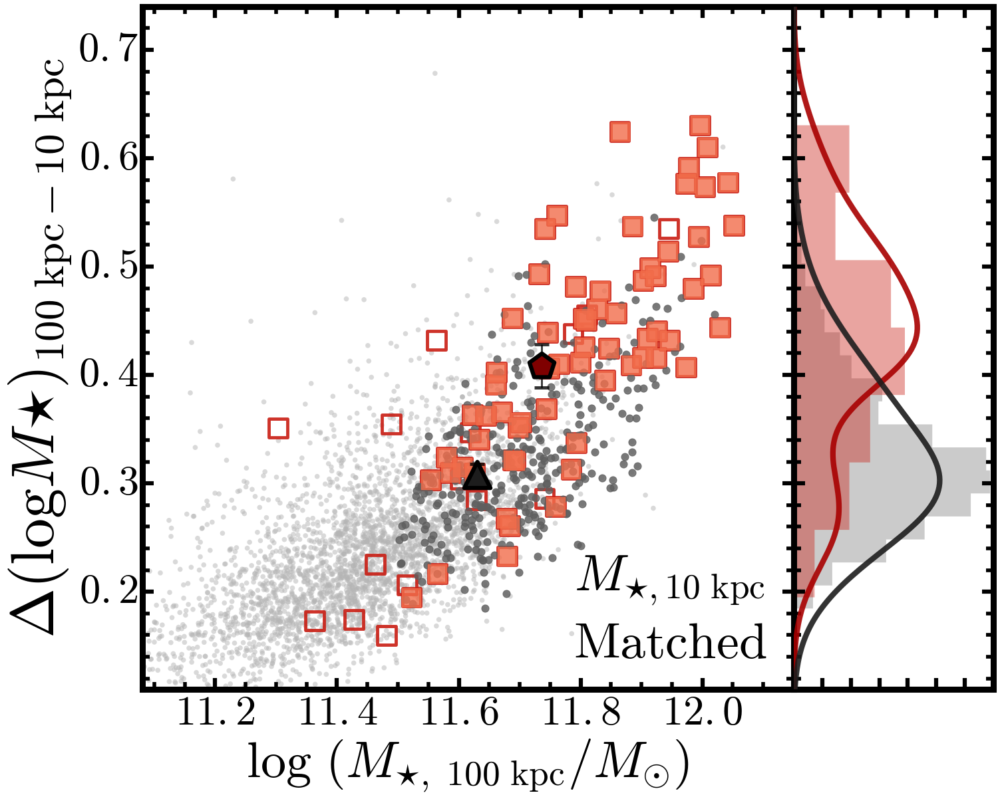

In [169]:
massStr1, massStr2, massStr3 = '100', '100', '10'

redbcgTmp = redbcgUse[(redbcgUse['logm_100'] >= 11.2) & 
                      (redbcgUse['logm_100'] <= 12.3) & 
                      (redbcgUse['lambda_redm'] >= 30.0) &
                      (redbcgUse['p_cen_1_redm'] >= 0.7) &
                      (redbcgUse['z_use'] >= 0.30) & 
                      (redbcgUse['z_use'] <= 0.50)]

nonbcgTmp = nonbcgUse[(nonbcgUse['logm_100'] >= 11.0) & 
                      (nonbcgUse['logm_100'] <= 12.3) & 
                      (nonbcgUse['z_use'] >= 0.30) & 
                      (nonbcgUse['z_use'] <= 0.50)]
#-------------------------------------------------------------------------------#
parent1, parent2 = redbcgTmp, nonbcgTmp
sample1a, sample1b, sample1c = redbcgM10n, redbcgM10l, redbcgM10m
sample2a, sample2b, sample2c = nonbcgM10n, nonbcgM10l, nonbcgM10m
col1, col2, col3 = 'logm_' + massStr1, 'logm_' + massStr2, 'logm_' + massStr3
xSep1, xSep2, xSep3 = None, None, None 
yLabel = '$\log\ (M_{\star}/M_{\odot})\ (%s\ \mathrm{kpc})$' % massStr1 
xLabel = '$\Delta(\log M{\star})_{\mathrm{%s\ kpc}-\mathrm{%s\ kpc}}$' % (massStr2, massStr3) 
outPng = 'hscMassive_m%s_dm%s-%s_' % (massStr1, massStr2, massStr3) + sedMod + '_m10sample_massive'

nResample=500
lamLimit=30
pcenLimit=0.7
sizeCol1=None
sizeNorm=0.1
colorCol1=None
colorLow=0.1
colorUpp=0.55
showBin1=True
showBin2=False
showHist1=False
showHist2=True
yKernel=0.04
xLabel='$\log\ (M_{\star,\ 100\ \mathrm{kpc}}/M_{\odot})$'
yLabel='$\Delta(\log M{\star})_{\mathrm{100\ kpc}-\mathrm{10\ kpc}}$'
outPng=outPng
save=True
outlineBin1=True
color1a=BLK(0.4)
color1b=BLK(0.7)
color2a=ORG(0.8)
color2b=ORG(0.6)
cmap1=BLK
cmap2=ORG
figDir=figDir
colorMin=None
colorMax=None
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}$'
xLegend=0.035
yLegend=0.600


"""
For publication
"""
# Statistics of the two subsamples
med_1ax = confidence_interval(sample1a[col1], axis=0, alpha=[SIGMA1, 1.0], 
                              metric=np.nanmedian, numResamples=nResample, 
                              interpolate=True)
if col3 is not None:
    med_1ay = confidence_interval((sample1a[col2] - sample1a[col3]), 
                                  axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)
else:
    med_1ay = confidence_interval(sample1a[col2], 
                                  axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)

med_2ax = confidence_interval(sample2a[col1], axis=0, alpha=[SIGMA1, 1.0], 
                              metric=np.nanmedian, numResamples=nResample, 
                              interpolate=True)
if col3 is not None:
    med_2ay = confidence_interval((sample2a[col2] - sample2a[col3]), 
                                  axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)
else:
    med_2ay = confidence_interval(sample2a[col2], 
                                  axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)

med_1bx = confidence_interval(sample1b[col1], axis=0, alpha=[SIGMA1, 1.0], 
                              metric=np.nanmedian, numResamples=nResample, 
                              interpolate=True)
if col3 is not None:
    med_1by = confidence_interval((sample1b[col2] - sample1b[col3]), 
                                  axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)
else:
    med_1by = confidence_interval(sample1b[col2], 
                                  axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)

med_2bx = confidence_interval(sample2b[col1], axis=0, alpha=[SIGMA1, 1.0], 
                              metric=np.nanmedian, numResamples=nResample, 
                              interpolate=True)
if col3 is not None:
    med_2by = confidence_interval((sample2b[col2] - sample2b[col3]), 
                                  axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)
else:
    med_2by = confidence_interval(sample2b[col2], 
                                  axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)

# ------------------------------------------------------------------------------------ #
fig = plt.figure(figsize=(15, 12))
ax1 = plt.axes(recScat)
ax2 = plt.axes(recHist)
ax1 = songPlotSetup(ax1, xlabel=45, ylabel=45, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)
ax2 = songPlotSetup(ax2, border=6.5, 
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

# ---------------------------------------------------------------------------
# Scatter plot
## Mass separation of two bins
ax1.axvline(xSep2, linewidth=6.0, linestyle='--', c='k', alpha=0.3, zorder=0)
ax1.axvline(xSep3, linewidth=6.0, linestyle='--', c='k', alpha=0.3, zorder=0)
## Horizontal line for 0.0
ax1.axhline(0.0, linewidth=5.0, linestyle='-', c='k', alpha=0.2)

# Parent samples 
if col3 is not None:
    p1 = ax1.scatter(parent2[col1], 
                     parent2[col2] - parent2[col3], s=30.0, 
                     alpha=0.50, facecolor=color1a, edgecolor='none', 
                     label='$\mathrm{cenLowMh;\ All}$')
else:
    p1 = ax1.scatter(parent2[col1], 
                     parent2[col2], s=30.0, 
                     alpha=0.50, facecolor=color1a, edgecolor='none', 
                     label='$\mathrm{cenLowMh;\ All}$')

if sizeCol1 is None: 
    size1 = 400.0
else:
    size1 = ((parent1[sizeCol1] - sizeNorm) * 750.0)
if col3 is not None:
    p3 = ax1.scatter(parent1[col1], 
                     parent1[col2] - parent1[col3], edgecolor=color2a,
                     s=size1, alpha=0.9, facecolor='none', 
                     label='$\mathrm{cenHighMh;\ All}$', 
                     marker='s', linewidth=3.5)
else:
    p3 = ax1.scatter(parent1[col1], 
                     parent1[col2], edgecolor=color2a,
                     s=size1, alpha=0.9, facecolor='none', 
                     label='$\mathrm{cenHighMh;\ All}$', 
                     marker='s', linewidth=3.5)

# Matched ones
if col3 is not None:
    p2 = ax1.scatter(sample2c[col1], 
                     sample2c[col2] - sample2c[col3], s=60.0, 
                     alpha=0.80, facecolor=color1b, edgecolor=color1b, 
                     label='$\mathrm{cenLowMh;\ Use}$')
else:
    p2 = ax1.scatter(sample2c[col1], 
                     sample2c[col2], s=60.0, 
                     alpha=0.80, facecolor=color1b, edgecolor=color1b, 
                     label='$\mathrm{cenLowMh;\ Use}$')

if sizeCol1 is None: 
    size2 = 400.0
else:
    size2 = ((parent1[sizeCol1] - sizeNorm) * 750.0)
if colorCol1 is None: 
    scatterColor = color2b
else:
    scatterColor = sample1c[colorCol1] 

if col3 is not None:
    p4 = ax1.scatter(sample1c[col1], 
                     sample1c[col2] - sample1c[col3], edgecolor=color2b,
                     s=size2, cmap=cmap2, alpha=0.8, 
                     c=scatterColor, vmin=colorLow, vmax=colorUpp,
                     label='$\mathrm{cenHighMh;\ Use}$', 
                     marker='s')
else: 
    p4 = ax1.scatter(sample1c[col1], 
                     sample1c[col2], edgecolor=color2b,
                     s=size2, cmap=cmap2, alpha=0.8, 
                     c=scatterColor, vmin=colorLow, vmax=colorUpp,
                     label='$\mathrm{cenHighMh;\ Use}$', 
                     marker='s')

# ---------------------------------------------------------------------------
# Median values
if showBin1:
    ax1.errorbar(med_2ax[2], med_2ay[2], marker='+', ms=1, mec='k',
                 yerr=0.01, mfc=cmap1(0.95), ecolor='k', 
                 capthick=3.5, capsize=8, 
                 alpha=0.8, linewidth=4.0, fmt='h', elinewidth=2.0, label=None, 
                 zorder=100)
    ax1.errorbar(med_1ax[2], med_1ay[2], marker='+', ms=1, mec='k', linewidth=4.0,
                 yerr=0.02, mfc=cmap2(0.95), ecolor='k', 
                 capthick=3.5, capsize=8, 
                 alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)
    if outlineBin1:
        ax1.scatter(med_2ax[2], med_2ay[2], marker='^', s=800, facecolor=cmap1(0.9),
                    edgecolor='k', linewidth=4.5, zorder=102, alpha=1.0,
                    label='$[\mathrm{cenLowMh}]$')
        ax1.scatter(med_1ax[2], med_1ay[2], marker='p', s=800, facecolor=cmap2(1.0),
                    edgecolor='k', linewidth=4.5, zorder=102, alpha=1.0,
                    label='$[\mathrm{cenHighMh}]$')
    else:
        ax1.scatter(med_2ax[2], med_2ay[2], marker='^', s=800, facecolor=cmap1(0.8),
                    edgecolor='none', linewidth=3.0, zorder=102, alpha=1.0,
                    label=None)
        ax1.scatter(med_1ax[2], med_1ay[2], marker='p', s=800, facecolor=cmap2(0.8),
                    edgecolor='none', linewidth=3.0, zorder=102,
                    label=None)
if showBin2:
    ax1.errorbar(med_2bx[2], med_2by[2], marker='+', ms=1, mec='k',
                 yerr=0.01, mfc=cmap1(0.95), ecolor=cmap1(0.95), 
                 capthick=3.5, capsize=8, 
                 alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)
    ax1.errorbar(med_1bx[2], med_1by[2], marker='+', ms=1, mec='k',
                 yerr=0.03, mfc=cmap2(0.95), ecolor=cmap2(0.95), 
                 capthick=3.5, capsize=8, 
                 alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)
    ax1.scatter(med_2bx[2], med_2by[2], marker='^', s=800, 
                facecolor=cmap1(0.95), edgecolor='k', linewidth=3.0, 
                zorder=102, alpha=0.9, label='$[\lambda \leq 20]$')
    ax1.scatter(med_1bx[2], med_1by[2], marker='p', s=800, 
                facecolor=cmap2(0.95), edgecolor='k', linewidth=3.0, 
                zorder=102, alpha=0.9, label='$[\lambda > %d]$' % lamLimit)
    
# ---------------------------------------------------------------------------
# Text 
ax1.text(0.81, 0.12, '$M_{\star,10\ \mathrm{kpc}}}$',
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=55.0, transform=ax1.transAxes)
ax1.text(0.81, 0.03, '$\mathrm{Matched}$',
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=55.0, transform=ax1.transAxes)
# ---------------------------------------------------------------------------
    
# Label
ax1.set_xlabel(xLabel, size=55)
ax1.set_ylabel(yLabel, size=65)

# Axis limits
ax1.set_xlim(xMin, xMax)
ax1.set_ylim(yMin, yMax)

# ---------------------------------------------------------------------------
# Histogram 
ax2.set_ylim(ax1.get_ylim())
## Horizonatal line for 0
ax2.axhline(0.0, linewidth=5.0, linestyle='-', c='k', alpha=0.2)

# Parameters used for histograms
if col3 is not None:
    Y1a = sample1a[col2] - sample1a[col3]
    Y2a = sample2a[col2] - sample2a[col3]
    Y1b = sample1b[col2] - sample1b[col3]
    Y2b = sample2b[col2] - sample2b[col3]
    Y1c = sample2c[col2] - sample2c[col3]
    Y2c = sample1c[col2] - sample1c[col3]
else:
    Y1a = sample1a[col2]
    Y2a = sample2a[col2]
    Y1b = sample1b[col2]
    Y2b = sample2b[col2]
    Y1c = sample2c[col2]
    Y2c = sample1c[col2]

yy = np.linspace(yMin, yMax, 200)
MKde = KernelDensity(yKernel, kernel='gaussian')

# Show underlying historgrams of combined sample
n, bins, patches = hist(Y1c, bins='knuth', ax=ax2, edgecolor='none',
                        orientation='horizontal', histtype='stepfilled', 
                        facecolor=color1a, alpha=0.70, normed=1)
n, bins, patches = hist(Y2c, bins='knuth', ax=ax2, edgecolor='none',
                        orientation='horizontal', histtype='stepfilled', 
                        facecolor=color2a, alpha=0.40, normed=1, linewidth=4.0)

# KDE densities for bin1 
if showHist1:
    MKde.fit(Y1a[:, None])
    MDens1 = np.exp(MKde.score_samples(yy[:, None]))
    MKde.fit(Y2a[:, None])
    MDens2 = np.exp(MKde.score_samples(yy[:, None]))
    ax2.plot(MDens1, yy, '--', color=cmap2(0.9), zorder=3, linewidth=6.0, alpha=0.9)
    ax2.plot(MDens2, yy, '--', color=cmap1(0.9), zorder=3, linewidth=6.0, alpha=0.9)

# KDE densities for bin2 
if showHist2:
    MKde.fit(Y1b[:, None])
    MDens3 = np.exp(MKde.score_samples(yy[:, None]))
    MKde.fit(Y2b[:, None])
    MDens4 = np.exp(MKde.score_samples(yy[:, None]))
    ax2.plot(MDens3, yy, '-', color=cmap2(0.9), zorder=3, linewidth=6.0, alpha=0.9)
    ax2.plot(MDens4, yy, '-', color=cmap1(0.9), zorder=3, linewidth=6.0, alpha=0.9)

# Setup axis
ax2.tick_params(axis='x', which='minor', bottom='off', top='off')
ax2.yaxis.set_major_formatter(NullFormatter())
ax2.xaxis.set_major_formatter(NullFormatter())

plt.show()

if figDir is not None:
    outPng = os.path.join(figDir, outPng)
if save:
    fig.savefig(outPng + '.pdf', dpi=140)

## logM_10 v.s. (logM_100 - logM_10) for the logM_100 matched samples

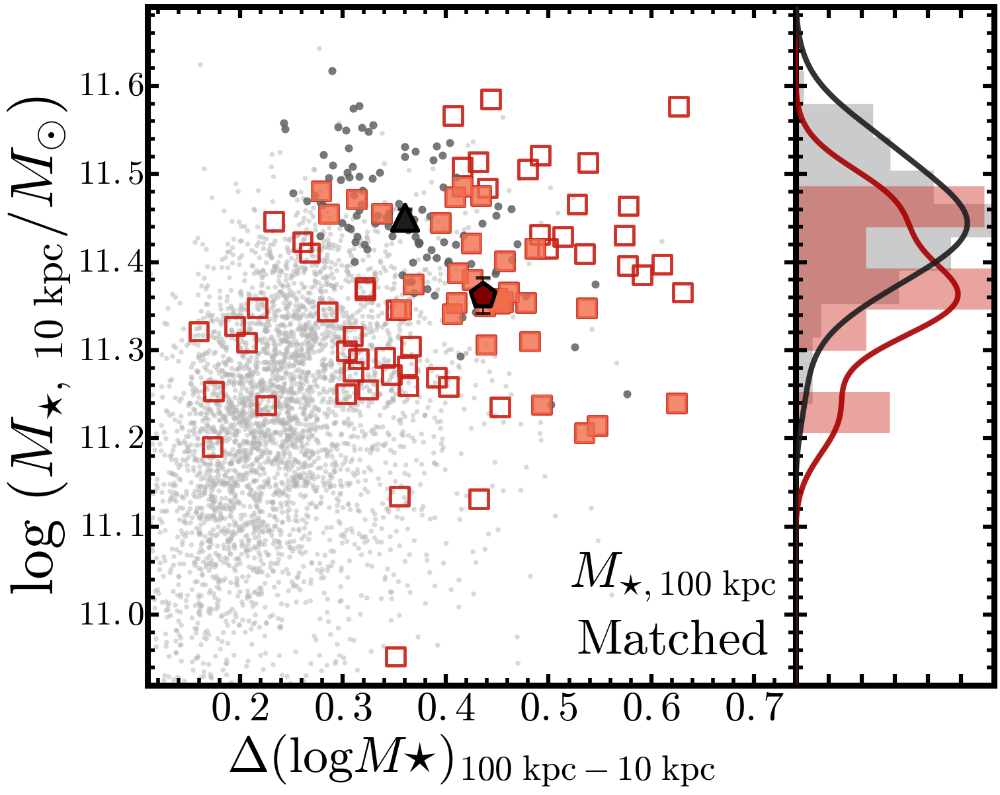

In [187]:
massStr1, massStr2, massStr3 = '10', '100', '10'

redbcgTmp = redbcgUse[(redbcgUse['logm_100'] >= 11.2) & 
                      (redbcgUse['logm_100'] <= 12.3) & 
                      (redbcgUse['lambda_redm'] >= 30.0) &
                      (redbcgUse['p_cen_1_redm'] >= 0.7) &
                      (redbcgUse['z_use'] >= 0.30) & 
                      (redbcgUse['z_use'] <= 0.50)]

nonbcgTmp = nonbcgUse[(nonbcgUse['logm_100'] >= 11.0) & 
                      (nonbcgUse['logm_100'] <= 12.3) & 
                      (nonbcgUse['z_use'] >= 0.30) & 
                      (nonbcgUse['z_use'] <= 0.50)]
#-------------------------------------------------------------------------------#
parent1, parent2 = redbcgTmp, nonbcgTmp
sample1a, sample1b, sample1c = redbcgM100b, redbcgM100b, redbcgM100b
sample2a, sample2b, sample2c = nonbcgM100b, nonbcgM100b, nonbcgM100b
col1, col2, col3 = 'logm_' + massStr1, 'logm_' + massStr2, 'logm_' + massStr3

xSep1, xSep2, xSep3 = None, 11.7, 11.9
yMin, yMax, xMin, xMax = 10.92, 11.69, 0.11, 0.74
outPng = 'hscMassive_m%s_dm%s-%s_' % (massStr1, massStr2, massStr3) + sedMod + '_m100sample'

nResample=500
xSep1=11.60
xSep2=11.70
xSep3=11.90
lamLimit=30
pcenLimit=0.7
sizeCol1=None
sizeNorm=0.1
colorCol1=None
colorLow=0.1
colorUpp=0.55
showBin1=True
showBin2=False
showHist1=False
showHist2=True
yKernel=0.04
yLabel='$\log\ (M_{\star,\ 10\ \mathrm{kpc}}/M_{\odot})$'
xLabel='$\Delta(\log M{\star})_{\mathrm{100\ kpc}-\mathrm{10\ kpc}}$'
outPng=outPng
save=True
outlineBin1=True
color1a=BLK(0.4)
color1b=BLK(0.7)
color2a=ORG(0.8)
color2b=ORG(0.6)
cmap1=BLK
cmap2=ORG
figDir=figDir
colorMin=None
colorMax=None
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}$'
xLegend=0.035
yLegend=0.600


"""
For publication
"""
# Statistics of the two subsamples
med_1ax = confidence_interval(sample1a[col1], axis=0, alpha=[SIGMA1, 1.0], 
                              metric=np.nanmedian, numResamples=nResample, 
                              interpolate=True)
if col3 is not None:
    med_1ay = confidence_interval((sample1a[col2] - sample1a[col3]), 
                                  axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)
else:
    med_1ay = confidence_interval(sample1a[col2], 
                                  axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)

med_2ax = confidence_interval(sample2a[col1], axis=0, alpha=[SIGMA1, 1.0], 
                              metric=np.nanmedian, numResamples=nResample, 
                              interpolate=True)
if col3 is not None:
    med_2ay = confidence_interval((sample2a[col2] - sample2a[col3]), 
                                  axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)
else:
    med_2ay = confidence_interval(sample2a[col2], 
                                  axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)

med_1bx = confidence_interval(sample1b[col1], axis=0, alpha=[SIGMA1, 1.0], 
                              metric=np.nanmedian, numResamples=nResample, 
                              interpolate=True)
if col3 is not None:
    med_1by = confidence_interval((sample1b[col2] - sample1b[col3]), 
                                  axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)
else:
    med_1by = confidence_interval(sample1b[col2], 
                                  axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)

med_2bx = confidence_interval(sample2b[col1], axis=0, alpha=[SIGMA1, 1.0], 
                              metric=np.nanmedian, numResamples=nResample, 
                              interpolate=True)
if col3 is not None:
    med_2by = confidence_interval((sample2b[col2] - sample2b[col3]), 
                                  axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)
else:
    med_2by = confidence_interval(sample2b[col2], 
                                  axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)

# ------------------------------------------------------------------------------------ #
fig = plt.figure(figsize=(15, 12))
ax1 = plt.axes(recScat)
ax2 = plt.axes(recHist)
ax1 = songPlotSetup(ax1, xlabel=45, ylabel=37, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)
ax2 = songPlotSetup(ax2, border=6.5, 
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

# ---------------------------------------------------------------------------
# Scatter plot
## Vertical line for 0.0
ax1.axvline(0.0, linewidth=5.0, linestyle='-', c='k', alpha=0.2)

# Parent samples 
if col3 is not None:
    p1 = ax1.scatter(parent2[col2] - parent2[col3], parent2[col1], s=30.0, 
                     alpha=0.50, facecolor=color1a, edgecolor='none', 
                     label='$\mathrm{cenLowMh;\ All}$')
else:
    p1 = ax1.scatter(parent2[col1], 
                     parent2[col2], s=30.0, 
                     alpha=0.50, facecolor=color1a, edgecolor='none', 
                     label='$\mathrm{cenLowMh;\ All}$')

if sizeCol1 is None: 
    size1 = 400.0
else:
    size1 = ((parent1[sizeCol1] - sizeNorm) * 750.0)
if col3 is not None:
    p3 = ax1.scatter(parent1[col2] - parent1[col3], parent1[col1], edgecolor=color2a,
                     s=size1, alpha=0.9, facecolor='none', 
                     label='$\mathrm{cenHighMh;\ All}$', 
                     marker='s', linewidth=3.5)
else:
    p3 = ax1.scatter(parent1[col1], 
                     parent1[col2], edgecolor=color2a,
                     s=size1, alpha=0.9, facecolor='none', 
                     label='$\mathrm{cenHighMh;\ All}$', 
                     marker='s', linewidth=3.5)

# Matched ones
if col3 is not None:
    p2 = ax1.scatter(sample2c[col2] - sample2c[col3], sample2c[col1], s=60.0, 
                     alpha=0.80, facecolor=color1b, edgecolor=color1b, 
                     label='$\mathrm{cenLowMh;\ Use}$')
else:
    p2 = ax1.scatter(sample2c[col1], 
                     sample2c[col2], s=60.0, 
                     alpha=0.80, facecolor=color1b, edgecolor=color1b, 
                     label='$\mathrm{cenLowMh;\ Use}$')

if sizeCol1 is None: 
    size2 = 400.0
else:
    size2 = ((parent1[sizeCol1] - sizeNorm) * 750.0)
if colorCol1 is None: 
    scatterColor = color2b
else:
    scatterColor = sample1c[colorCol1] 

if col3 is not None:
    p4 = ax1.scatter(sample1c[col2] - sample1c[col3], sample1c[col1], edgecolor=color2b,
                     s=size2, cmap=cmap2, alpha=0.8, 
                     c=scatterColor, vmin=colorLow, vmax=colorUpp,
                     label='$\mathrm{cenHighMh;\ Use}$', 
                     marker='s')
else: 
    p4 = ax1.scatter(sample1c[col1], 
                     sample1c[col2], edgecolor=color2b,
                     s=size2, cmap=cmap2, alpha=0.8, 
                     c=scatterColor, vmin=colorLow, vmax=colorUpp,
                     label='$\mathrm{cenHighMh;\ Use}$', 
                     marker='s')

# ---------------------------------------------------------------------------
# Median values
if showBin1:
    ax1.errorbar(med_2ay[2], med_2ax[2], marker='+', ms=1, mec='k',
                 yerr=0.01, mfc=cmap1(0.95), ecolor='k', 
                 capthick=3.5, capsize=8, 
                 alpha=0.8, linewidth=4.0, fmt='h', elinewidth=2.0, label=None, 
                 zorder=100)
    ax1.errorbar(med_1ay[2], med_1ax[2], marker='+', ms=1, mec='k', linewidth=4.0,
                 yerr=0.02, mfc=cmap2(0.95), ecolor='k', 
                 capthick=3.5, capsize=8, 
                 alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)
    if outlineBin1:
        ax1.scatter(med_2ay[2], med_2ax[2], marker='^', s=800, facecolor=cmap1(0.9),
                    edgecolor='k', linewidth=4.5, zorder=102, alpha=1.0,
                    label='$[\mathrm{cenLowMh}]$')
        ax1.scatter(med_1ay[2], med_1ax[2], marker='p', s=800, facecolor=cmap2(1.0),
                    edgecolor='k', linewidth=4.5, zorder=102, alpha=1.0,
                    label='$[\mathrm{cenHighMh}]$')
    else:
        ax1.scatter(med_2ay[2], med_2ax[2], marker='^', s=800, facecolor=cmap1(0.8),
                    edgecolor='none', linewidth=3.0, zorder=102, alpha=1.0,
                    label=None)
        ax1.scatter(med_1ay[2], med_1ax[2], marker='p', s=800, facecolor=cmap2(0.8),
                    edgecolor='none', linewidth=3.0, zorder=102,
                    label=None)
if showBin2:
    ax1.errorbar(med_2by[2], med_2bx[2], marker='+', ms=1, mec='k',
                 yerr=0.01, mfc=cmap1(0.95), ecolor=cmap1(0.95), 
                 capthick=3.5, capsize=8, 
                 alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)
    ax1.errorbar(med_1by[2], med_1bx[2], marker='+', ms=1, mec='k',
                 yerr=0.03, mfc=cmap2(0.95), ecolor=cmap2(0.95), 
                 capthick=3.5, capsize=8, 
                 alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)
    ax1.scatter(med_2by[2], med_2bx[2], marker='^', s=800, 
                facecolor=cmap1(0.95), edgecolor='k', linewidth=3.0, 
                zorder=102, alpha=0.9, label='$[\lambda \leq 20]$')
    ax1.scatter(med_1by[2], med_1bx[2], marker='p', s=800, 
                facecolor=cmap2(0.95), edgecolor='k', linewidth=3.0, 
                zorder=102, alpha=0.9, label='$[\lambda > %d]$' % lamLimit)
    
# ---------------------------------------------------------------------------
# Label
ax1.set_xlabel(xLabel, size=55)
ax1.set_ylabel(yLabel, size=65)

# Axis limits
ax1.set_xlim(xMin, xMax)
ax1.set_ylim(yMin, yMax)

# ---------------------------------------------------------------------------
# Text 
ax1.text(0.81, 0.12, '$M_{\star,100\ \mathrm{kpc}}}$',
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=55.0, transform=ax1.transAxes)
ax1.text(0.81, 0.03, '$\mathrm{Matched}$',
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=55.0, transform=ax1.transAxes)
# ---------------------------------------------------------------------------

# Histogram 
ax2.set_ylim(ax1.get_ylim())
## Horizonatal line for 0
ax2.axhline(0.0, linewidth=5.0, linestyle='-', c='k', alpha=0.2)

# Parameters used for histograms
Y1a = sample1a[col1]
Y2a = sample2a[col1]
Y1b = sample1b[col1]
Y2b = sample2b[col1]
Y1c = sample2c[col1]
Y2c = sample1c[col1]

yy = np.linspace(yMin, yMax, 200)
MKde = KernelDensity(yKernel, kernel='gaussian')

# Show underlying historgrams of combined sample
n, bins, patches = hist(Y1c, bins='knuth', ax=ax2, edgecolor='none',
                        orientation='horizontal', histtype='stepfilled', 
                        facecolor=color1a, alpha=0.70, normed=1)
n, bins, patches = hist(Y2c, bins='knuth', ax=ax2, edgecolor='none',
                        orientation='horizontal', histtype='stepfilled', 
                        facecolor=color2a, alpha=0.40, normed=1, linewidth=4.0)

# KDE densities for bin1 
if showHist1:
    MKde.fit(Y1a[:, None])
    MDens1 = np.exp(MKde.score_samples(yy[:, None]))
    MKde.fit(Y2a[:, None])
    MDens2 = np.exp(MKde.score_samples(yy[:, None]))
    ax2.plot(MDens1, yy, '--', color=cmap2(0.9), zorder=3, linewidth=6.0, alpha=0.9)
    ax2.plot(MDens2, yy, '--', color=cmap1(0.9), zorder=3, linewidth=6.0, alpha=0.9)

# KDE densities for bin2 
if showHist2:
    MKde.fit(Y1b[:, None])
    MDens3 = np.exp(MKde.score_samples(yy[:, None]))
    MKde.fit(Y2b[:, None])
    MDens4 = np.exp(MKde.score_samples(yy[:, None]))
    ax2.plot(MDens3, yy, '-', color=cmap2(0.9), zorder=3, linewidth=6.0, alpha=0.9)
    ax2.plot(MDens4, yy, '-', color=cmap1(0.9), zorder=3, linewidth=6.0, alpha=0.9)

# Setup axis
ax2.tick_params(axis='x', which='minor', bottom='off', top='off')
ax2.yaxis.set_major_formatter(NullFormatter())
ax2.xaxis.set_major_formatter(NullFormatter())

plt.show()

if figDir is not None:
    outPng = os.path.join(figDir, outPng)
if save:
    fig.savefig(outPng + '.pdf', dpi=140)

## logM_100 v.s. logM_10 for logM_100 matched samples

In [175]:
nonbcgFit = nonbcgUse[(nonbcgUse['logm_100'] >= 11.6) & 
                      (nonbcgUse['logm_100'] <= 12.3) & 
                      (nonbcgUse['logm_10'] >= 10.5) &
                      (nonbcgUse['z_use'] >= 0.3) & 
                      (nonbcgUse['z_use'] <= 0.5)]

redbcgFit = redbcgUse[(redbcgUse['logm_100'] >= 11.6) & 
                      (redbcgUse['logm_100'] <= 12.3) & 
                      (redbcgUse['logm_10'] >= 10.5) &
                      (redbcgUse['lambda_redm'] >= 30.0) & 
                      (redbcgUse['p_cen_1_redm'] >= 0.7) & 
                      (redbcgUse['z_use'] >= 0.3) & 
                      (redbcgUse['z_use'] <= 0.5)]

a_ls, b_ls = llsLine(nonbcgFit['logm_100'].data, (nonbcgFit['logm_10'].data), nonbcgFit['MSTAR_ERR'].data * 0.0 + 0.02)
print(a_ls, b_ls)
a_ls, b_ls = llsLine(redbcgFit['logm_100'].data, (redbcgFit['logm_10'].data), redbcgFit['MSTAR_ERR'].data * 0.0 + 0.03)
print(a_ls, b_ls)

a_ls, b_ls = llsLine(nonbcgFit['logm_max'].data, (nonbcgFit['logm_10'].data), nonbcgFit['MSTAR_ERR'].data * 0.0 + 0.02)
print(a_ls, b_ls)
a_ls, b_ls = llsLine(redbcgFit['logm_max'].data, (redbcgFit['logm_10'].data), redbcgFit['MSTAR_ERR'].data * 0.0 + 0.03)
print(a_ls, b_ls)

a_ls, b_ls = llsLine(nonbcgFit['logm_100'].data, (nonbcgFit['logm_5'].data), nonbcgFit['MSTAR_ERR'].data * 0.0 + 0.02)
print(a_ls, b_ls)
a_ls, b_ls = llsLine(redbcgFit['logm_100'].data, (redbcgFit['logm_5'].data), redbcgFit['MSTAR_ERR'].data * 0.0 + 0.03)
print(a_ls, b_ls)

LLS: a = 0.55967 ; b = 4.82943
0.559667710906 4.82942763108
LLS: a = 0.46036 ; b = 5.94575
0.46036273657 5.94575148278
LLS: a = 0.46336 ; b = 5.94565
0.463357067241 5.945648466
LLS: a = 0.37124 ; b = 6.98209
0.371239763001 6.98208711845
LLS: a = 0.42793 ; b = 6.14045
0.427925997461 6.14044877142
LLS: a = 0.29374 ; b = 7.66649
0.29374063584 7.66649414896


LLS: a = 0.55967 ; b = 4.82943
Start the MCMC runs
CPU times: user 2min 24s, sys: 1.08 s, total: 2min 25s
Wall time: 2min 29s
Done


MCMC result:
             a = 0.560145484245 +0.0248976399482 -0.0255693996766
             b = 4.82401306649 +0.298497640918 -0.291163834328 
             f = 0.00484139749753 +0.000153044847621 -0.000133649625987
            


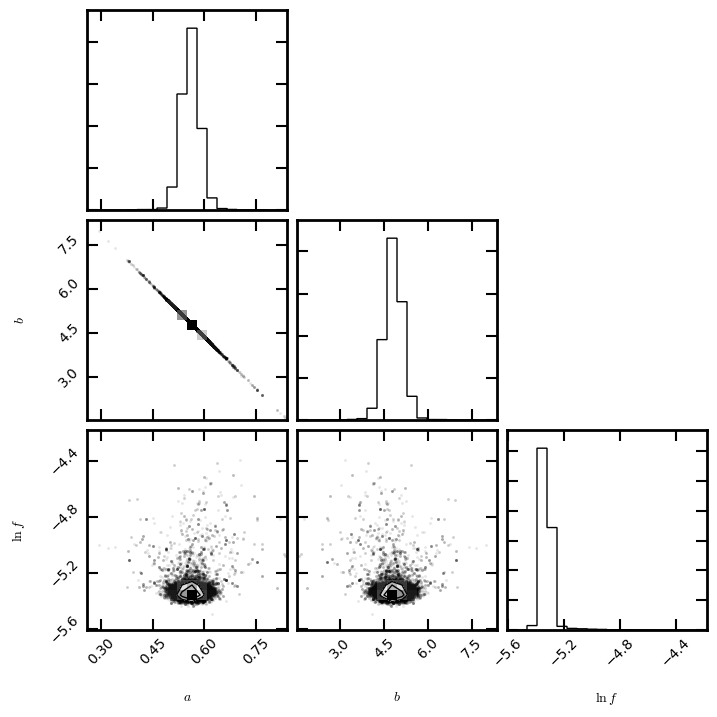

LLS: a = 0.46036 ; b = 5.94575
Start the MCMC runs
CPU times: user 2min 15s, sys: 1.33 s, total: 2min 16s
Wall time: 2min 18s
Done


MCMC result:
             a = 0.464678883362 +0.0633098474246 -0.0622357180383
             b = 5.89404466721 +0.73713512254 -0.7474921701 
             f = 0.00546273592631 +0.000642729791338 -0.000502976927677
            


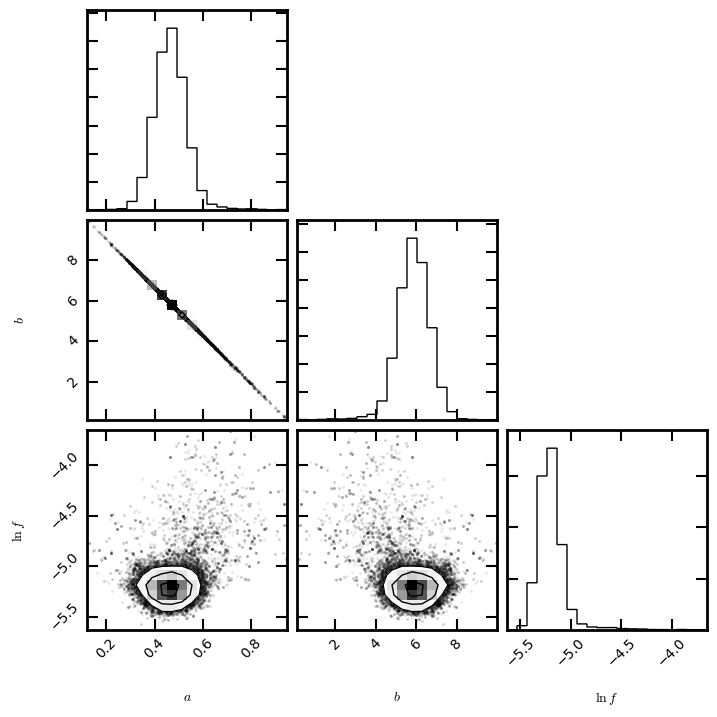

In [176]:
# Priors
def lnprior(theta):
    a, b, lnf = theta
    if 0.05 < a < 1.5 and 0.0 < b < 10.0 and -10.0 < lnf < 1.0:
        return 0.0
    return -np.inf

# For nonBCG
nonXX, nonYY, nonYerr = nonbcgFit['logm_100'].data, nonbcgFit['logm_10'].data, nonbcgFit['MSTAR_ERR'].data * 0.0 + 0.02

nonA, nonB, nonF, nonS = emceeLine(nonXX, nonYY, nonYerr, 
                                   nwalkers=100, ndim=3, nburn=100, 
                                   nstep=600, show=True,
                                   iniA=None, iniB=None)

# Best paramters
aNonB, aNonU, aNonL = nonA
bNonB, bNonU, bNonL = nonB

plt.show()

# For redBCG
redXX, redYY, redYerr = redbcgFit['logm_100'].data, redbcgFit['logm_10'].data, redbcgFit['MSTAR_ERR'].data * 0.0 + 0.02

redA, redB, redF, redS = emceeLine(redXX, redYY, redYerr, 
                                  nwalkers=100, ndim=3, nburn=100, 
                                  nstep=600, show=True, 
                                  iniA=None, iniB=None)

# Best paramters
aRedB, aRedU, aRedL = redA
bRedB, bRedU, bRedL = redB

plt.show()

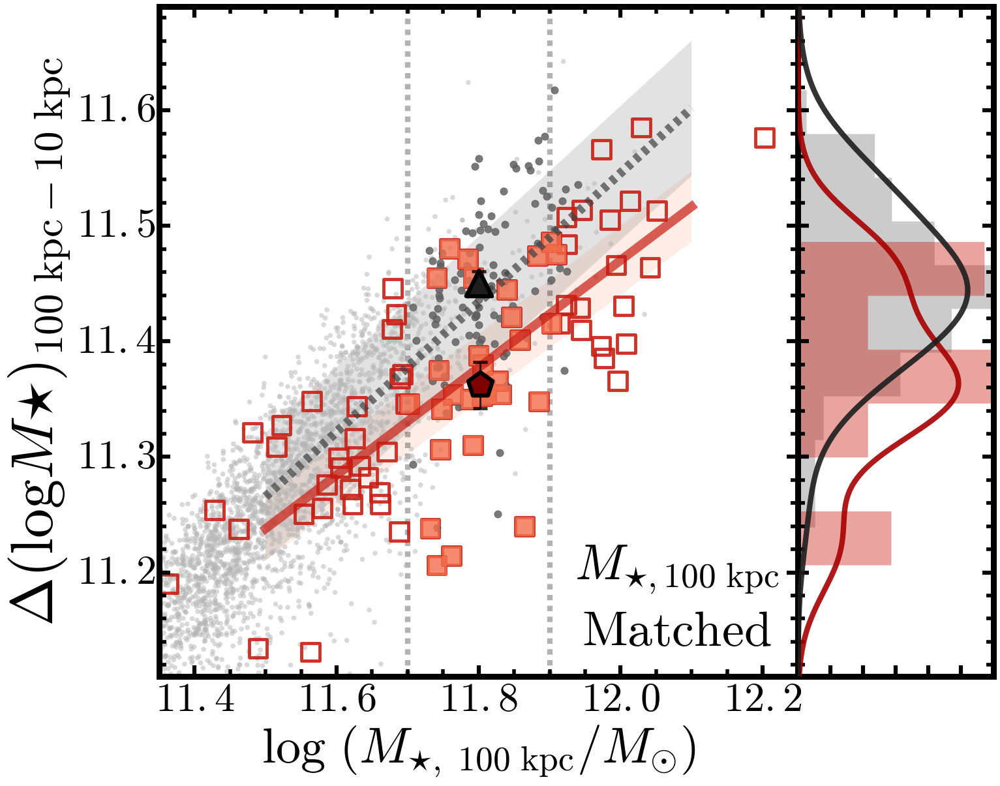

In [183]:
redbcgTmp = redbcgUse[(redbcgUse['logm_100'] >= 11.2) & 
                      (redbcgUse['logm_100'] <= 12.3) & 
                      (redbcgUse['lambda_redm'] >= 30.0) &
                      (redbcgUse['p_cen_1_redm'] >= 0.7) &
                      (redbcgUse['z_use'] >= 0.30) & 
                      (redbcgUse['z_use'] <= 0.50)]

nonbcgTmp = nonbcgUse[(nonbcgUse['logm_100'] >= 11.0) & 
                      (nonbcgUse['logm_100'] <= 12.3) & 
                      (nonbcgUse['z_use'] >= 0.30) & 
                      (nonbcgUse['z_use'] <= 0.50)]
#-------------------------------------------------------------------------------#
parent1, parent2 = redbcgTmp, nonbcgTmp
sample1a, sample1b, sample1c = redbcgM100b, redbcgM100b, redbcgM100b
sample2a, sample2b, sample2c = nonbcgM100b, nonbcgM100b, nonbcgM100b
col1, col2, col3 = 'logm_100', 'logm_10', None

xSep1, xSep2, xSep3 = None, 11.7, 11.9
xMin, xMax, yMin, yMax = 11.35, 12.25, 11.11, 11.69 
xLabel = '$\log\ (M_{\star}/M_{\odot})\ (%s\ \mathrm{kpc})$' % massStr1 
yLabel = '$\Delta(\log M{\star})_{\mathrm{%s\ kpc}-\mathrm{%s\ kpc}}$' % (massStr2, massStr3) 
outPng = 'hscMassive_m100_m10_' + sedMod + '_m100sample'

nResample=500
xSep1=11.60
xSep2=11.70
xSep3=11.90
lamLimit=30
pcenLimit=0.7
sizeCol1=None
sizeNorm=0.1
colorCol1=None
colorLow=0.1
colorUpp=0.55
showBin1=True
showBin2=False
showHist1=False
showHist2=True
yKernel=0.04
xLabel='$\log\ (M_{\star,\ 100\ \mathrm{kpc}}/M_{\odot})$'
yLabel='$\Delta(\log M{\star})_{\mathrm{100\ kpc}-\mathrm{10\ kpc}}$'
outPng=outPng
save=True
outlineBin1=True
color1a=BLK(0.4)
color1b=BLK(0.7)
color2a=ORG(0.8)
color2b=ORG(0.6)
cmap1=BLK
cmap2=ORG
figDir=figDir
colorMin=None
colorMax=None
xtickFormat='$\mathbf{%4.1f}$'
ytickFormat='$\mathbf{%4.1f}$'
xLegend=0.035
yLegend=0.600


"""
For publication
"""
# Statistics of the two subsamples
med_1ax = confidence_interval(sample1a[col1], axis=0, alpha=[SIGMA1, 1.0], 
                              metric=np.nanmedian, numResamples=nResample, 
                              interpolate=True)
if col3 is not None:
    med_1ay = confidence_interval((sample1a[col2] - sample1a[col3]), 
                                  axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)
else:
    med_1ay = confidence_interval(sample1a[col2], 
                                  axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)

med_2ax = confidence_interval(sample2a[col1], axis=0, alpha=[SIGMA1, 1.0], 
                              metric=np.nanmedian, numResamples=nResample, 
                              interpolate=True)
if col3 is not None:
    med_2ay = confidence_interval((sample2a[col2] - sample2a[col3]), 
                                  axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)
else:
    med_2ay = confidence_interval(sample2a[col2], 
                                  axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)

med_1bx = confidence_interval(sample1b[col1], axis=0, alpha=[SIGMA1, 1.0], 
                              metric=np.nanmedian, numResamples=nResample, 
                              interpolate=True)
if col3 is not None:
    med_1by = confidence_interval((sample1b[col2] - sample1b[col3]), 
                                  axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)
else:
    med_1by = confidence_interval(sample1b[col2], 
                                  axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)

med_2bx = confidence_interval(sample2b[col1], axis=0, alpha=[SIGMA1, 1.0], 
                              metric=np.nanmedian, numResamples=nResample, 
                              interpolate=True)
if col3 is not None:
    med_2by = confidence_interval((sample2b[col2] - sample2b[col3]), 
                                  axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)
else:
    med_2by = confidence_interval(sample2b[col2], 
                                  axis=0, alpha=[SIGMA1, 1.0], 
                                  metric=np.nanmedian, numResamples=nResample, 
                                  interpolate=True)

# ------------------------------------------------------------------------------------ #
fig = plt.figure(figsize=(15, 12))
ax1 = plt.axes(recScat)
ax2 = plt.axes(recHist)
ax1 = songPlotSetup(ax1, xlabel=45, ylabel=45, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)
ax2 = songPlotSetup(ax2, border=6.5, 
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)

# ---------------------------------------------------------------------------
# Scatter plot
## Mass separation of two bins
ax1.axvline(xSep2, linewidth=6.0, linestyle='--', c='k', alpha=0.3, zorder=0)
ax1.axvline(xSep3, linewidth=6.0, linestyle='--', c='k', alpha=0.3, zorder=0)
## Horizontal line for 0.0
ax1.axhline(0.0, linewidth=5.0, linestyle='-', c='k', alpha=0.2)

# Parent samples 
if col3 is not None:
    p1 = ax1.scatter(parent2[col1], 
                     parent2[col2] - parent2[col3], s=30.0, 
                     alpha=0.50, facecolor=color1a, edgecolor='none', 
                     label='$\mathrm{cenLowMh;\ All}$')
else:
    p1 = ax1.scatter(parent2[col1], 
                     parent2[col2], s=30.0, 
                     alpha=0.50, facecolor=color1a, edgecolor='none', 
                     label='$\mathrm{cenLowMh;\ All}$')

if sizeCol1 is None: 
    size1 = 400.0
else:
    size1 = ((parent1[sizeCol1] - sizeNorm) * 750.0)
if col3 is not None:
    p3 = ax1.scatter(parent1[col1], 
                     parent1[col2] - parent1[col3], edgecolor=color2a,
                     s=size1, alpha=0.9, facecolor='none', 
                     label='$\mathrm{cenHighMh;\ All}$', 
                     marker='s', linewidth=3.5)
else:
    p3 = ax1.scatter(parent1[col1], 
                     parent1[col2], edgecolor=color2a,
                     s=size1, alpha=0.9, facecolor='none', 
                     label='$\mathrm{cenHighMh;\ All}$', 
                     marker='s', linewidth=3.5)

# Matched ones
if col3 is not None:
    p2 = ax1.scatter(sample2c[col1], 
                     sample2c[col2] - sample2c[col3], s=60.0, 
                     alpha=0.80, facecolor=color1b, edgecolor=color1b, 
                     label='$\mathrm{cenLowMh;\ Use}$')
else:
    p2 = ax1.scatter(sample2c[col1], 
                     sample2c[col2], s=60.0, 
                     alpha=0.80, facecolor=color1b, edgecolor=color1b, 
                     label='$\mathrm{cenLowMh;\ Use}$')

if sizeCol1 is None: 
    size2 = 400.0
else:
    size2 = ((parent1[sizeCol1] - sizeNorm) * 750.0)
if colorCol1 is None: 
    scatterColor = color2b
else:
    scatterColor = sample1c[colorCol1] 

if col3 is not None:
    p4 = ax1.scatter(sample1c[col1], 
                     sample1c[col2] - sample1c[col3], edgecolor=color2b,
                     s=size2, cmap=cmap2, alpha=0.8, 
                     c=scatterColor, vmin=colorLow, vmax=colorUpp,
                     label='$\mathrm{cenHighMh;\ Use}$', 
                     marker='s')
else: 
    p4 = ax1.scatter(sample1c[col1], 
                     sample1c[col2], edgecolor=color2b,
                     s=size2, cmap=cmap2, alpha=0.8, 
                     c=scatterColor, vmin=colorLow, vmax=colorUpp,
                     label='$\mathrm{cenHighMh;\ Use}$', 
                     marker='s')

# ---------------------------------------------------------------------------
# Median values
if showBin1:
    ax1.errorbar(med_2ax[2], med_2ay[2], marker='+', ms=1, mec='k',
                 yerr=0.01, mfc=cmap1(0.95), ecolor='k', 
                 capthick=3.5, capsize=8, 
                 alpha=0.8, linewidth=4.0, fmt='h', elinewidth=2.0, label=None, 
                 zorder=100)
    ax1.errorbar(med_1ax[2], med_1ay[2], marker='+', ms=1, mec='k', linewidth=4.0,
                 yerr=0.02, mfc=cmap2(0.95), ecolor='k', 
                 capthick=3.5, capsize=8, 
                 alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)
    if outlineBin1:
        ax1.scatter(med_2ax[2], med_2ay[2], marker='^', s=800, facecolor=cmap1(0.9),
                    edgecolor='k', linewidth=4.5, zorder=102, alpha=1.0,
                    label='$[\mathrm{cenLowMh}]$')
        ax1.scatter(med_1ax[2], med_1ay[2], marker='p', s=800, facecolor=cmap2(1.0),
                    edgecolor='k', linewidth=4.5, zorder=102, alpha=1.0,
                    label='$[\mathrm{cenHighMh}]$')
    else:
        ax1.scatter(med_2ax[2], med_2ay[2], marker='^', s=800, facecolor=cmap1(0.8),
                    edgecolor='none', linewidth=3.0, zorder=102, alpha=1.0,
                    label=None)
        ax1.scatter(med_1ax[2], med_1ay[2], marker='p', s=800, facecolor=cmap2(0.8),
                    edgecolor='none', linewidth=3.0, zorder=102,
                    label=None)
if showBin2:
    ax1.errorbar(med_2bx[2], med_2by[2], marker='+', ms=1, mec='k',
                 yerr=0.01, mfc=cmap1(0.95), ecolor=cmap1(0.95), 
                 capthick=3.5, capsize=8, 
                 alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)
    ax1.errorbar(med_1bx[2], med_1by[2], marker='+', ms=1, mec='k',
                 yerr=0.03, mfc=cmap2(0.95), ecolor=cmap2(0.95), 
                 capthick=3.5, capsize=8, 
                 alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)
    ax1.scatter(med_2bx[2], med_2by[2], marker='^', s=800, 
                facecolor=cmap1(0.95), edgecolor='k', linewidth=3.0, 
                zorder=102, alpha=0.9, label='$[\lambda \leq 20]$')
    ax1.scatter(med_1bx[2], med_1by[2], marker='p', s=800, 
                facecolor=cmap2(0.95), edgecolor='k', linewidth=3.0, 
                zorder=102, alpha=0.9, label='$[\lambda > %d]$' % lamLimit)
    
# ---------------------------------------------------------------------------
# Scaling Relations
ax1.set_rasterization_zorder(0) 
xx = np.linspace(11.5, 12.1, 100)
yy1 = xx * (aRedB + 0.005) + (bRedB - 0.03)
yy2 = xx * (aRedB - 0.005) + (bRedB + 0.03)
ax1.fill_between(xx, yy1, yy2, color=ORG(0.50), alpha=0.15, zorder=0, 
                 edgecolor='none')
ax1.plot(xx, (aRedB * xx + bRedB),
         linestyle='-', color=ORG(0.8), alpha=0.7, 
         linewidth=10.0, zorder=5)

xx = np.linspace(11.5, 12.1, 100)
yy1 = xx * (aNonB + 0.005) + (bNonB - 0.002)
yy2 = xx * (aNonB - 0.005) + (bNonB + 0.002)
ax1.fill_between(xx, yy1, yy2, color=BLK(0.80), alpha=0.15, zorder=0, 
                 edgecolor='none')
ax1.plot(xx, (aNonB * xx + bNonB),
         linestyle='--', color=BLK(0.8), alpha=0.7, 
         linewidth=10.0, zorder=4)

# ---------------------------------------------------------------------------
# Label
ax1.set_xlabel(xLabel, size=55)
ax1.set_ylabel(yLabel, size=65)

# Axis limits
ax1.set_xlim(xMin, xMax)
ax1.set_ylim(yMin, yMax)

# ---------------------------------------------------------------------------
# Text 
ax1.text(0.81, 0.12, '$M_{\star,100\ \mathrm{kpc}}}$',
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=55.0, transform=ax1.transAxes)
ax1.text(0.81, 0.03, '$\mathrm{Matched}$',
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=55.0, transform=ax1.transAxes)
# ---------------------------------------------------------------------------

# Histogram 
ax2.set_ylim(ax1.get_ylim())
## Horizonatal line for 0
ax2.axhline(0.0, linewidth=5.0, linestyle='-', c='k', alpha=0.2)

# Parameters used for histograms
if col3 is not None:
    Y1a = sample1a[col2] - sample1a[col3]
    Y2a = sample2a[col2] - sample2a[col3]
    Y1b = sample1b[col2] - sample1b[col3]
    Y2b = sample2b[col2] - sample2b[col3]
    Y1c = sample2c[col2] - sample2c[col3]
    Y2c = sample1c[col2] - sample1c[col3]
else:
    Y1a = sample1a[col2]
    Y2a = sample2a[col2]
    Y1b = sample1b[col2]
    Y2b = sample2b[col2]
    Y1c = sample2c[col2]
    Y2c = sample1c[col2]

yy = np.linspace(yMin, yMax, 200)
MKde = KernelDensity(yKernel, kernel='gaussian')

# Show underlying historgrams of combined sample
n, bins, patches = hist(Y1c, bins='knuth', ax=ax2, edgecolor='none',
                        orientation='horizontal', histtype='stepfilled', 
                        facecolor=color1a, alpha=0.70, normed=1)
n, bins, patches = hist(Y2c, bins='knuth', ax=ax2, edgecolor='none',
                        orientation='horizontal', histtype='stepfilled', 
                        facecolor=color2a, alpha=0.40, normed=1, linewidth=4.0)

# KDE densities for bin1 
if showHist1:
    MKde.fit(Y1a[:, None])
    MDens1 = np.exp(MKde.score_samples(yy[:, None]))
    MKde.fit(Y2a[:, None])
    MDens2 = np.exp(MKde.score_samples(yy[:, None]))
    ax2.plot(MDens1, yy, '--', color=cmap2(0.9), zorder=3, linewidth=6.0, alpha=0.9)
    ax2.plot(MDens2, yy, '--', color=cmap1(0.9), zorder=3, linewidth=6.0, alpha=0.9)

# KDE densities for bin2 
if showHist2:
    MKde.fit(Y1b[:, None])
    MDens3 = np.exp(MKde.score_samples(yy[:, None]))
    MKde.fit(Y2b[:, None])
    MDens4 = np.exp(MKde.score_samples(yy[:, None]))
    ax2.plot(MDens3, yy, '-', color=cmap2(0.9), zorder=3, linewidth=6.0, alpha=0.9)
    ax2.plot(MDens4, yy, '-', color=cmap1(0.9), zorder=3, linewidth=6.0, alpha=0.9)

# Setup axis
ax2.tick_params(axis='x', which='minor', bottom='off', top='off')
ax2.yaxis.set_major_formatter(NullFormatter())
ax2.xaxis.set_major_formatter(NullFormatter())

plt.show()

if figDir is not None:
    outPng = os.path.join(figDir, outPng)
if save:
    fig.savefig(outPng + '.pdf', dpi=140)

# Comparisons of the median mass density profiles (key figure)

## Tweak the plotMassProfile() function a little bit

In [15]:
SBP1 = [0.135, 0.090, 0.860, 0.30]
SBP2 = [0.135, 0.390, 0.860, 0.57]

def plotMassProfile(profSample1, profSample2, 
                    col1='muI1', col2='LOGM2LI', matchR=100.0,
                    norm=False, integrate=False, divide=True, 
                    normR1=10.0, normR2=12.0, kind='mass',
                    diffColor1=RED0, diffColor2=RED1, showLMask=False, 
                    xmin=1.02, xmax=4.25, ymin=4.01, ymax=9.79,
                    dmin=-0.199, dmax=0.399,
                    vline1=10.0, vline2=100.0, alpha1=0.20, alpha2=0.50,
                    lw1=2.5, lw2=2.5, smooth=True, boxSize=3,
                    highlight1=False, highlight2=True, lamLimit=30, 
                    mass1=11.55, mass2=11.95, z1=0.2, z2=0.5,
                    label1="$\lambda \leq 20;\ \mathrm{Cen}$", 
                    label2="$\lambda > 30;\ \mathrm{Cen}$",
                    showInfo1=True, showInfo2=True, showLegend=True, 
                    rPsfKpc=5.5, kpcArr=[2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 200.0], 
                    save=True, outPng='mass_prof', figDir=None,
                    color1a=BLK(0.5), color1b=BLK(0.7), cmap1=BLK, 
                    color2a=ORG(0.5), color2b=ORG(0.7), cmap2=ORG,
                    xtickFormat='$\mathbf{%g}$', ytickFormat='$\mathbf{%g}$',
                    ytickFormat2='$\mathbf{%g}$', showMean=True,
                    xLegend=0.675, yLegend=0.675, matchStr=None, 
                    text1=None, text2=None, xText=0.43, yText1=0.05, yText2=0.12):
    """Plot the median mass profiles."""
    # Median profiles
    bm_sm, bm_mm, bm_amg, bm_stdm = organizeSbp(profSample1, col1=col1, 
                                                col2=col2, kind=kind, 
                                                norm=norm, r1=normR1, r2=normR2, 
                                                divide=divide, integrate=integrate)
    gu_sm, gu_mm, gu_amg, gu_stdm = organizeSbp(profSample2, col1=col1, 
                                                col2=col2, kind=kind, 
                                                norm=norm, r1=normR1, r2=normR2, 
                                                divide=divide, integrate=integrate)
    if showLMask:
        # Larger mask
        bm_sm_b, bm_mm_b, bm_amg_b, bm_stdm_b = organizeSbp(profSample1, col1=col1, 
                                                            col2=col2, kind=kind, 
                                                            norm=norm, r1=normR1, r2=normR2, 
                                                            divide=divide, integrate=integrate)
        gu_sm_b, gu_mm_b, gu_amg_b, gu_stdm_b = organizeSbp(profSample2, col1=col1, 
                                                            col2=col2, kind=kind, 
                                                            norm=norm, r1=normR1, r2=normR2, 
                                                            divide=divide, integrate=integrate)
        
    # Random mix sample 
    mixM_sm = np.vstack([gu_sm, bm_sm])
    randM_sm = []
    ii = 0
    while ii < 2000:
        mprof = np.nanmedian(mixM_sm[np.random.choice(len(mixM_sm), len(bm_sm), 
                                                      replace=True)], axis=0)
        randM_sm.append(mprof)
        ii += 1 
    
    # Integration check
    try: 
        rUse = int(matchR)
    except Exception:
        if matchR is "max":
            rUse = 200 
        else: 
            rUse = 100
    indInt = np.where((RSMA_COMMON ** 4.0) <= rUse)
    isoAreaB = (np.pi * ((RSMA_COMMON[indInt] ** 4.0) ** 2.0))
    isoRingB = np.append(isoAreaB[1], [isoAreaB[1:] - isoAreaB[:-1]])
    isoAreaG = (np.pi * ((RSMA_COMMON[indInt] ** 4.0) ** 2.0))
    isoRingG = np.append(isoAreaG[1], [isoAreaG[1:] - isoAreaG[:-1]])
    print("# Sample1: ", np.log10(np.nansum((10.0 ** bm_amg[2][indInt]) * isoRingB)))
    print("# Sample2: ", np.log10(np.nansum((10.0 ** gu_amg[2][indInt]) * isoRingG)))

    # --------------------------------------------------------------------------------------- #
    ## Setup up figure
    fig = plt.figure(figsize=(16, 18))
    ax1 = plt.axes(SBP2)
    ax1 = songPlotSetup(ax1, ylabel=45, xlabel=45, border=6.5, 
                        xtickFormat=xtickFormat, ytickFormat=ytickFormat)
    ax3 = plt.axes(SBP1)
    ax3 = songPlotSetup(ax3, ylabel=45, xlabel=45, border=6.5, 
                        xtickFormat=xtickFormat, ytickFormat=ytickFormat2)
    # --------------------------------------------------------------------------------------- #
    ## Mark the two interesting radius
    if highlight1:
        ax1.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                    zorder=0, alpha=0.5, dashes=(30, 6))
    else:
        ax1.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                    zorder=0, alpha=0.2)
    if highlight2:
        ax1.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                    zorder=0, alpha=0.5, dashes=(30, 6))
    else:
        ax1.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                    zorder=0, alpha=0.2)
    # --------------------------------------------------------------------------------------- #
    ## Individual profiles
    for gg in gu_sm:
        ax1.plot(RSMA_COMMON, gg, c=color1a, alpha=alpha1, linewidth=lw1)
    for bb in bm_sm:
        ax1.plot(RSMA_COMMON, bb, c=color2a, alpha=alpha2, linewidth=lw2)
    # --------------------------------------------------------------------------------------- #
    ## Median profiles
    if showMean:
        ax1.fill_between(RSMA_COMMON, gu_amg[0], gu_amg[1], 
                         facecolor=cmap1(0.80), edgecolor='none', alpha=0.6, 
                         zorder=5, label=label1)
        ax1.fill_between(RSMA_COMMON, bm_amg[0], bm_amg[1], 
                         facecolor=cmap2(0.80), edgecolor='none', alpha=0.6, 
                         zorder=6, label=label2)
        ax1.plot(RSMA_COMMON, gu_amg[2], linestyle='-', linewidth=8.0, 
                 c=cmap1(0.9), alpha=0.9, zorder=7)
        ax1.plot(RSMA_COMMON, bm_amg[2], linestyle='-', linewidth=8.0, 
                 c=cmap2(0.9), alpha=0.9, zorder=8)
    else:
        if smooth:
            ## Smoothed median profiles 
            gm_low = convolve(gu_mm[0], Box1DKernel(boxSize))    
            gm_upp = convolve(gu_mm[1], Box1DKernel(boxSize)) 
            gm_med = convolve(gu_mm[2], Box1DKernel(boxSize))

            bm_low = convolve(bm_mm[0], Box1DKernel(boxSize))    
            bm_upp = convolve(bm_mm[1], Box1DKernel(boxSize)) 
            bm_med = convolve(bm_mm[2], Box1DKernel(boxSize))
        else:
            gm_low, gm_upp, gm_med = gu_mm[0], gu_mm[1], gu_mm[2]
            bm_low, bm_upp, bm_med = bu_mm[0], bu_mm[1], bu_mm[2]
        
        ax1.fill_between(RSMA_COMMON, gm_low, gm_upp, 
                         facecolor=cmap1(0.80), edgecolor='none', alpha=0.7, 
                         zorder=5, label=label1)
        ax1.fill_between(RSMA_COMMON, bm_low, bm_upp, 
                         facecolor=cmap2(0.80), edgecolor='none', alpha=0.7, 
                         zorder=6, label=label2)
        ax1.plot(RSMA_COMMON, gm_med, linestyle='-', linewidth=8.0, 
                 c=cmap1(0.9), alpha=0.9, zorder=7)
        ax1.plot(RSMA_COMMON, bm_med, linestyle='-', linewidth=7.0, 
                 c=cmap2(0.9), alpha=0.9, zorder=8)
        
    if showLMask:
        if showMean:
            ax1.plot(RSMA_COMMON, gu_amg_b[2], linestyle='--', linewidth=7.0, 
                     c=cmap1(0.9), alpha=0.9, zorder=9)
            ax1.plot(RSMA_COMMON, bm_amg_b[2], linestyle='--', linewidth=6.0, 
                     c=cmap2(0.9), alpha=0.9, zorder=10)
        else:
            ax1.plot(RSMA_COMMON, gu_mm_b[2], linestyle='--', linewidth=7.0, 
                     c=cmap1(0.9), alpha=0.9, zorder=9)
            ax1.plot(RSMA_COMMON, bm_mm_b[2], linestyle='--', linewidth=6.0, 
                     c=cmap2(0.9), alpha=0.9, zorder=10)
    # --------------------------------------------------------------------------------------- #
    ## Y Lables
    if norm:
        ax1.set_ylabel('$\mathrm{Normalized}\ \ \log ({\mu}_{\star}/[M_{\odot}\ \mathrm{kpc}^{-2}])$', 
                       size=48)
    else:
        ax1.set_ylabel('$\log ({\mu}_{\star}/[M_{\odot}\ \mathrm{kpc}^{-2}])$', size=55)
    ## Remove the X-axis label
    ax1.xaxis.set_major_formatter(NullFormatter())
    # --------------------------------------------------------------------------------------- #
    ## X, Y limits
    ax1.set_xlim(xmin, xmax)
    ax1.set_ylim(ymin, ymax)
    # --------------------------------------------------------------------------------------- #
    ## Region affected by PSF
    # z = 0.4 : 1"=5.4 Kpc
    # z = 0.5 : 1"=6.1 Kpc
    ySep = (ymax - ymin) / 5.0
    ax1.fill_between([0.0, rPsfKpc ** 0.25], 
                     [ymin - ySep, ymin - ySep], 
                     [ymax + ySep, ymax + ySep], 
                     facecolor='k', edgecolor='k', alpha=0.15, zorder=0)
    ## Label the PSF region 
    ax1.text(0.05, 0.20, '$\mathrm{PSF}$', rotation='vertical',
             verticalalignment='bottom', horizontalalignment='left',
             fontsize=52.0, transform=ax1.transAxes, weight='bold', 
             color='k', alpha=0.4)
    # --------------------------------------------------------------------------------------- #
    ## Legend
    if showLegend:
        ax1.legend(loc=(xLegend, yLegend), shadow=True, fancybox=True, 
                   numpoints=1, fontsize=45, scatterpoints=1, 
                   markerscale=1.2, borderpad=0.3, handletextpad=0.2)
    # --------------------------------------------------------------------------------------- #
    ## Information of the sample 
    if showInfo1:
        ax1.text(0.97, 0.79, '$%5.2f < z < %5.2f$' % (z1, z2), 
                 verticalalignment='bottom', horizontalalignment='right',
                 fontsize=48.0, transform=ax1.transAxes, weight='bold', 
                 color='k', backgroundcolor='w')
    if showInfo2:
        if matchStr is None:
            try: 
                matchR = int(matchR)
                matchStr = str(matchR).strip()
                ax1.text(0.97, 0.88, 
                         '$%5.2f < \log\ (M_{\star, %s}/M_{\odot}) < %5.2f$' % (mass1, matchStr, mass2), 
                         verticalalignment='bottom', horizontalalignment='right',
                         fontsize=48.0, transform=ax1.transAxes, weight='bold', 
                         color='k', backgroundcolor='w')
            except Exception: 
                matchStr = str(matchR).strip()
                ax1.text(0.97, 0.88, 
                         '$%5.2f < \log\ (M_{\star, \mathrm{%s}}/M_{\odot}) < %5.2f$' % (mass1, matchStr, mass2), 
                         verticalalignment='bottom', horizontalalignment='right',
                         fontsize=48.0, transform=ax1.transAxes, weight='bold', 
                         color='k', backgroundcolor='w')
                
    if text1 is not None:
        ax1.text(xText, yText1, text1, 
                 verticalalignment='bottom', horizontalalignment='center',
                 fontsize=50.0, transform=ax1.transAxes, weight='bold', 
                 color='k')
    if text2 is not None:
        ax1.text(xText, yText2, text2, 
                 verticalalignment='bottom', horizontalalignment='center',
                 fontsize=50.0, transform=ax1.transAxes, weight='bold', 
                 color='k')
    # --------------------------------------------------------------------------------------- #
    ## Secondary Axis 
    ax2 = ax1.twiny()
    kpcs = np.asarray(kpcArr)
    kpcTicks= (kpcs ** 0.25)
    ax2.set_xlim(xmin, xmax)
    ax2.set_xticks(kpcTicks)
    ax2.set_xticklabels(['$\mathbf{%g}$' % kpc for kpc in kpcs], fontsize=45)
    ax2.tick_params('both', length=15, width=6.5, which='major')
    for tick in ax2.xaxis.get_major_ticks():
        tick.label.set_fontsize(30) 
    for tick in ax2.yaxis.get_major_ticks():
        tick.label.set_fontsize(30) 
        
    ax2.text(0.922, 1.004, '$\mathrm{kpc}$', 
             verticalalignment='bottom', horizontalalignment='left',
             fontsize=46.0, transform=ax2.transAxes)
    # --------------------------------------------------------------------------------------- #
    ## Highlight zero 
    ax3.axhline(0.0, linewidth=4.0, c='k', linestyle='-', zorder=0, alpha=0.3)
    ## Mark the two interesting radius
    if highlight1:
        ax3.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                    zorder=0, alpha=0.5, dashes=(30, 6))
    else:
        ax3.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                    zorder=0, alpha=0.2)
    if highlight2:
        ax3.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                    zorder=0, alpha=0.5, dashes=(30, 6))
    else:
        ax3.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                    zorder=0, alpha=0.2)
    # --------------------------------------------------------------------------------------- #
    ## Random Mixed Sample
    ax3.fill_between(RSMA_COMMON, 
                     np.percentile(randM_sm - gu_mm[2], 3, axis=0), 
                     np.percentile(randM_sm - gu_mm[2], 97, axis=0), 
                     facecolor='k', edgecolor='k', alpha=0.15, zorder=0)
    ax3.fill_between(RSMA_COMMON, 
                     np.percentile(randM_sm - gu_mm[2], 31, axis=0), 
                     np.percentile(randM_sm - gu_mm[2], 69, axis=0), 
                     facecolor='k', edgecolor='k', alpha=0.25, zorder=0)
    ax3.plot(RSMA_COMMON, np.percentile(randM_sm - gu_mm[2], 50, axis=0), 
             c='k', linewidth=3.0, linestyle='-', alpha=0.9)
    # --------------------------------------------------------------------------------------- #
    ## Difference between sample1 and sample2
    diffLabel = '$[$' + label2 + '$]-[$' + label1 + '$]$'
    
    if showMean:
        ax3.fill_between(RSMA_COMMON, 
                         (bm_amg[0] - gu_amg[1]), (bm_amg[1] - gu_amg[0]),
                         facecolor=diffColor1, edgecolor='k', alpha=0.50, zorder=1)
        ax3.plot(RSMA_COMMON, bm_amg[2] - gu_amg[2], c=diffColor2, linewidth=5.5, 
                 linestyle='-', label=diffLabel)
    else:
        if smooth:
            ## Smoothed median profiles 
            diff_low = convolve((bm_mm[0] - gu_mm[1]), Box1DKernel(boxSize))    
            diff_upp = convolve((bm_mm[1] - gu_mm[0]), Box1DKernel(boxSize)) 
            diff_med = convolve((bm_mm[2] - gu_mm[2]), Box1DKernel(boxSize))
        else:
            diff_low = (bm_mm[0] - gu_mm[1])
            diff_upp = (bm_mm[1] - gu_mm[0])
            diff_med = (bm_mm[2] - gu_mm[2])
            
        ax3.fill_between(RSMA_COMMON, diff_low, diff_upp,
                         facecolor=diffColor1, edgecolor='k', alpha=0.50, zorder=1)
        ax3.plot(RSMA_COMMON, diff_med, c=diffColor2, linewidth=5.5, 
                 linestyle='-', label=diffLabel)
    if showLMask:
        if showMean:
            ax3.plot(RSMA_COMMON, bm_amg_b[2] - gu_amg_b[2], c=diffColor2, linewidth=4.5, 
                     linestyle='--')
        else:
            ax3.plot(RSMA_COMMON, bm_mm_b[2] - gu_mm_b[2], c=diffColor2, linewidth=4.5, 
                     linestyle='--')
    # --------------------------------------------------------------------------------------- #
    ## X, Y- Label
    ax3.set_xlabel('$R^{1/4}\ (\mathrm{kpc})$', size=55)
    ax3.set_ylabel('$\Delta$', size=45)
    # --------------------------------------------------------------------------------------- #
    ## X, Y Limits
    ax3.set_xlim(xmin, xmax)
    ax3.set_ylim(dmin, dmax)
    # --------------------------------------------------------------------------------------- #
    ## Region affected by PSF
    # z = 0.4 : 1"=5.4 Kpc
    # z = 0.5 : 1"=6.1 Kpc
    dSep = (dmax - dmin) / 8.0
    ax3.fill_between([0.0, rPsfKpc ** 0.25], 
                     [dmin - dSep, dmin - dSep], [dmax + dSep, dmax + dSep], 
                     facecolor='k', edgecolor='k', alpha=0.15, zorder=0)
    # --------------------------------------------------------------------------------------- #
    ## Legend
    if showLegend:
        ax3.legend(loc=(0.07, 0.78), shadow=True, fancybox=True, 
                   numpoints=1, fontsize=35, scatterpoints=1, 
                   markerscale=1.2, borderpad=0.3, handletextpad=0.2)
    # --------------------------------------------------------------------------------------- #
    ## Axes setup
    ax3.minorticks_on()
    ax3.tick_params(axis='y', which='minor', left='off', right='off')
    # --------------------------------------------------------------------------------------- #
    plt.show()

    if figDir is not None:
        outPng = os.path.join(figDir, outPng)
    if save:
        fig.savefig(outPng + '_b.pdf', dpi=140)
        
    return fig

## LogM_100 Matched; Full Sample

45
37
229
201
# Sample1:  11.4137358902
# Sample2:  11.4230479304


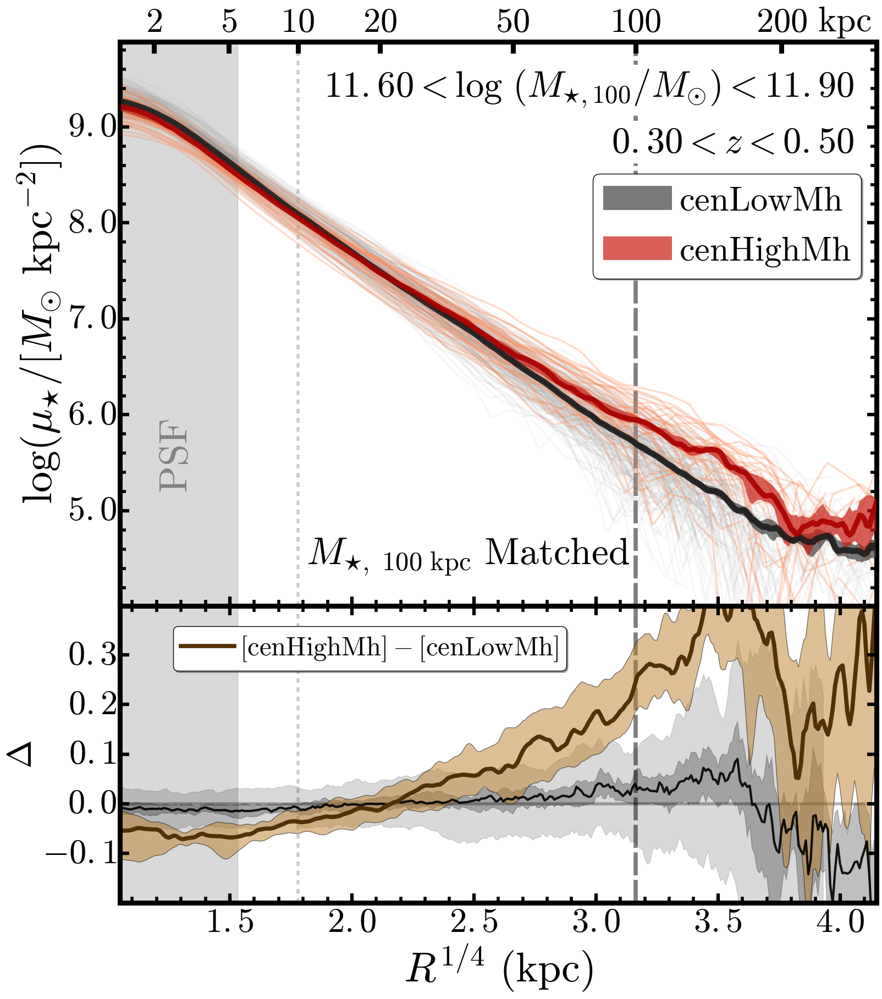

In [259]:
#-------------------------------------------------------------------------------#
profSample1, profSample2 = copy.deepcopy(redbcgProfM100c), copy.deepcopy(nonbcgProfM100c)
mass1, mass2, z1, z2, lamLimit = 11.60, 11.90, 0.3, 0.5, 30.0
outPng = sampleM100c
#-------------------------------------------------------------------------------#
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.05, 4.15
#-------------------------------------------------------------------------------#
ymin, ymax = 4.01, 9.89
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.199, 0.399
diffColor1, diffColor2 = BROWN0, BROWN1 
showLegend = True
#-------------------------------------------------------------------------------#

print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.nanmin(pp['muI1'][(pp['rKpc'] > 0.0) & (pp['rKpc'] < 2.0)])) > 8.75:
        del profSample1[jj]
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 95.0) & (pp['rKpc'] < 105.0)])) > 5.8:
        del profSample1[jj]
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 80.0) & (pp['rKpc'] < 90.0)])) < 5.25:
        del profSample1[jj]
print(len(profSample1))

print(len(profSample2))
for jj, pp in enumerate(profSample2):
    if (np.median(pp['muI1'][(pp['rKpc'] > 95.0) & (pp['rKpc'] < 105.0)])) > 5.8:
        del profSample2[jj]
for jj, pp in enumerate(profSample2):
    if not np.isfinite(np.median(pp['muI1'][(pp['rKpc'] > 80.0) & (pp['rKpc'] < 100.0)])):
        del profSample2[jj]
for jj, pp in enumerate(profSample2):
    if not np.isfinite(np.median(pp['muI1'][pp['rKpc'] < 2.5])):
        del profSample2[jj]
for jj, pp in enumerate(profSample2):
    if (np.nanmin(pp['muI1'][(pp['rKpc'] > 0.0) & (pp['rKpc'] < 2.0)])) <= 8.5:
        del profSample2[jj]
print(len(profSample2))

pFig1c = plotMassProfile(profSample1, profSample2, 
                         col1='muI1', col2='LOGM2LI', matchR=matchR,
                         norm=norm, integrate=integrate, divide=True, normR1=normR1, 
                         diffColor1=diffColor1, diffColor2=diffColor2, showLegend=showLegend, 
                         xmin=xmin, xmax=xmax, ymin=ymin, ymax=ymax,
                         dmin=dmin, dmax=dmax, alpha1=0.07, alpha2=0.30,
                         label1="$\mathrm{cenLowMh}$", 
                         label2="$\mathrm{cenHighMh}$",
                         lw1=2.5, lw2=2.5,
                         highlight1=highlight1, highlight2=highlight2, 
                         lamLimit=lamLimit, mass1=mass1, mass2=mass2, z1=z1, z2=z2,
                         outPng=outPng, showLMask=False, showMean=False, figDir=figDir,
                         xtickFormat='$\mathrm{%3.1f}$', ytickFormat='$\mathrm{%3.1f}$',
                         ytickFormat2='$\mathrm{%3.1f}$',
                         xLegend=0.625, yLegend=0.58,
                         text1='$M_{\star,\ 100\ \mathrm{kpc}}\ \mathrm{Matched}$', 
                         xText=0.46)

## LogM_10 Matched; Full Sample

69
63
455
454
# Sample1:  11.0420550418
# Sample2:  11.0199516723


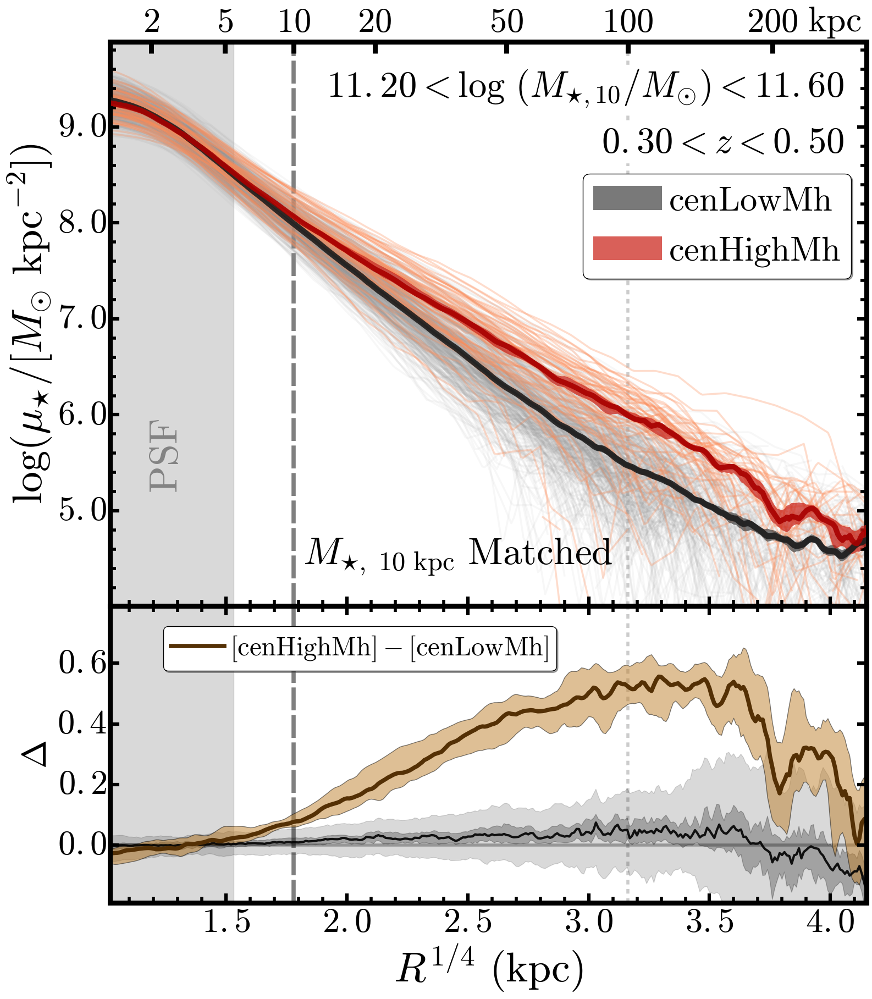

In [261]:
#-------------------------------------------------------------------------------#
profSample1, profSample2 = copy.deepcopy(redbcgProfM10c), copy.deepcopy(nonbcgProfM10c)
mass1, mass2, z1, z2, lamLimit = 11.20, 11.60, 0.3, 0.5, 30.0
outPng = sampleM10c
#-------------------------------------------------------------------------------#
matchR, highlight1, highlight2 = 10.0, True, False
xmin, xmax =  1.02, 4.15
#-------------------------------------------------------------------------------#
ymin, ymax = 4.01, 9.89
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.19, 0.79
diffColor1, diffColor2 = BROWN0, BROWN1 
showLegend = True
#-------------------------------------------------------------------------------#

print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 99.0) & (pp['rKpc'] < 103.0)])) > 5.9:
        del profSample1[jj]
print(len(profSample1))

print(len(profSample2))
for jj, pp in enumerate(profSample2):
    if not np.isfinite(np.median(pp['muI1'][pp['rKpc'] < 2.5])):
        del profSample2[jj]
print(len(profSample2))

pFig1a = plotMassProfile(profSample1, profSample2, 
                         col1='muI1', col2='LOGM2LI', matchR=matchR,
                         norm=norm, integrate=integrate, divide=True, normR1=normR1, 
                         diffColor1=diffColor1, diffColor2=diffColor2, showLegend=showLegend, 
                         xmin=xmin, xmax=xmax, ymin=ymin, ymax=ymax,
                         dmin=dmin, dmax=dmax, alpha1=0.07, alpha2=0.30,
                         lw1=2.5, lw2=2.5, 
                         label1="$\mathrm{cenLowMh}$", 
                         label2="$\mathrm{cenHighMh}$",
                         highlight1=highlight1, highlight2=highlight2, 
                         lamLimit=lamLimit, mass1=mass1, mass2=mass2, z1=z1, z2=z2,
                         outPng=outPng, showLMask=False, showMean=False, figDir=figDir,
                         xtickFormat='$\mathrm{%3.1f}$', ytickFormat='$\mathrm{%3.1f}$',
                         ytickFormat2='$\mathrm{%3.1f}$',
                         xLegend=0.625, yLegend=0.58,
                         text1='$M_{\star,\ 10\ \mathrm{kpc}}\ \mathrm{Matched}$', 
                         xText=0.46)

# Median Profiles of LogM_100 Matched samples; Appendix 

## LogM_100 Matched; Less Massive Samples 

25
21
142
119
# Sample1:  11.2990697856
# Sample2:  11.3076034271


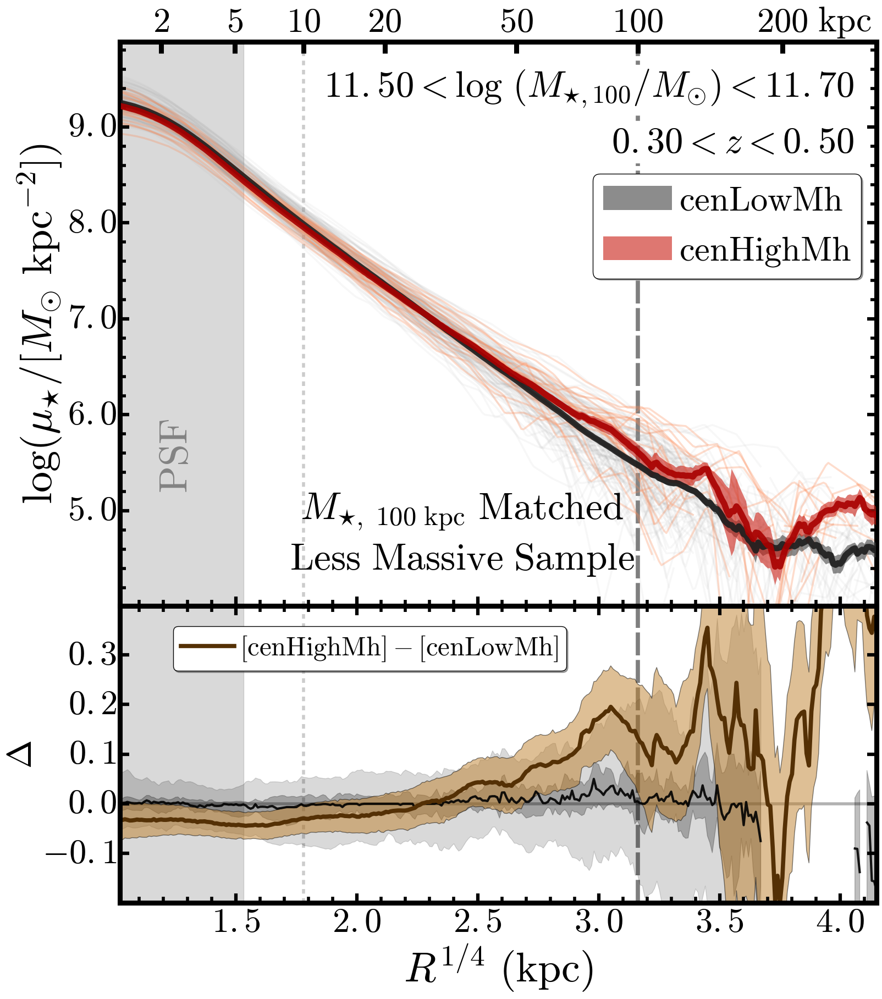

In [273]:
#-------------------------------------------------------------------------------#
profSample1, profSample2 = copy.deepcopy(redbcgProfM100a), copy.deepcopy(nonbcgProfM100a)
mass1, mass2, z1, z2, lamLimit = 11.50, 11.70, 0.3, 0.5, 30.0
outPng = sampleM100a
#-------------------------------------------------------------------------------#
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 4.15
#-------------------------------------------------------------------------------#
ymin, ymax = 4.01, 9.89
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.199, 0.399
diffColor1, diffColor2 = BROWN0, BROWN1 
showLegend = True
#-------------------------------------------------------------------------------#

print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 80.0) & (pp['rKpc'] < 88.0)])) <= 4.7:
        del profSample1[jj]
for jj, pp in enumerate(profSample1):
    if (np.nanmin(pp['muI1'][(pp['rKpc'] > 0.0) & (pp['rKpc'] < 2.5)])) >= 8.65:
        del profSample1[jj]
print(len(profSample1))

print(len(profSample2))
for jj, pp in enumerate(profSample2):
    if (np.median(pp['muI1'][(pp['rKpc'] > 95.0) & (pp['rKpc'] < 105.0)])) > 5.8:
        del profSample2[jj]
for jj, pp in enumerate(profSample2):
    if not np.isfinite(np.median(pp['muI1'][(pp['rKpc'] > 80.0) & (pp['rKpc'] < 100.0)])):
        del profSample2[jj]
for jj, pp in enumerate(profSample2):
    if not np.isfinite(np.median(pp['muI1'][pp['rKpc'] < 2.5])):
        del profSample2[jj]
for jj, pp in enumerate(profSample2):
    if (np.median(pp['muI1'][(pp['rKpc'] > 0.5) & (pp['rKpc'] < 2.0)])) <= 8.5:
        del profSample2[jj]
for jj, pp in enumerate(profSample2):
    if (np.median(pp['muI1'][(pp['rKpc'] > 18.0) & (pp['rKpc'] < 21.0)])) >= 7.25:
        del profSample2[jj]
print(len(profSample2))

pFig1c = plotMassProfile(profSample1, profSample2, 
                         col1='muI1', col2='LOGM2LI', matchR=matchR,
                         norm=norm, integrate=integrate, divide=True, normR1=normR1, 
                         diffColor1=diffColor1, diffColor2=diffColor2, showLegend=showLegend, 
                         xmin=xmin, xmax=xmax, ymin=ymin, ymax=ymax,
                         dmin=dmin, dmax=dmax, alpha1=0.07, alpha2=0.30,
                         lw1=2.5, lw2=2.5,
                         highlight1=highlight1, highlight2=highlight2, 
                         lamLimit=lamLimit, mass1=mass1, mass2=mass2, z1=z1, z2=z2,
                         outPng=outPng, showLMask=False, showMean=True, figDir=figDir,
                         label1="$\mathrm{cenLowMh}$", 
                         label2="$\mathrm{cenHighMh}$",
                         xtickFormat='$\mathrm{%3.1f}$', ytickFormat='$\mathrm{%3.1f}$',
                         ytickFormat2='$\mathrm{%3.1f}$',
                         xLegend=0.625, yLegend=0.58,
                         text1='$M_{\star,\ 100\ \mathrm{kpc}}\ \mathrm{Matched}$', 
                         text2='$\mathrm{Less\ Massive\ Sample}$', 
                         xText=0.452, yText1=0.13, yText2=0.05)

## LogM_100 Matched; More Massive Samples

30
28
101
95
# Sample1:  11.4866097901
# Sample2:  11.4711401409


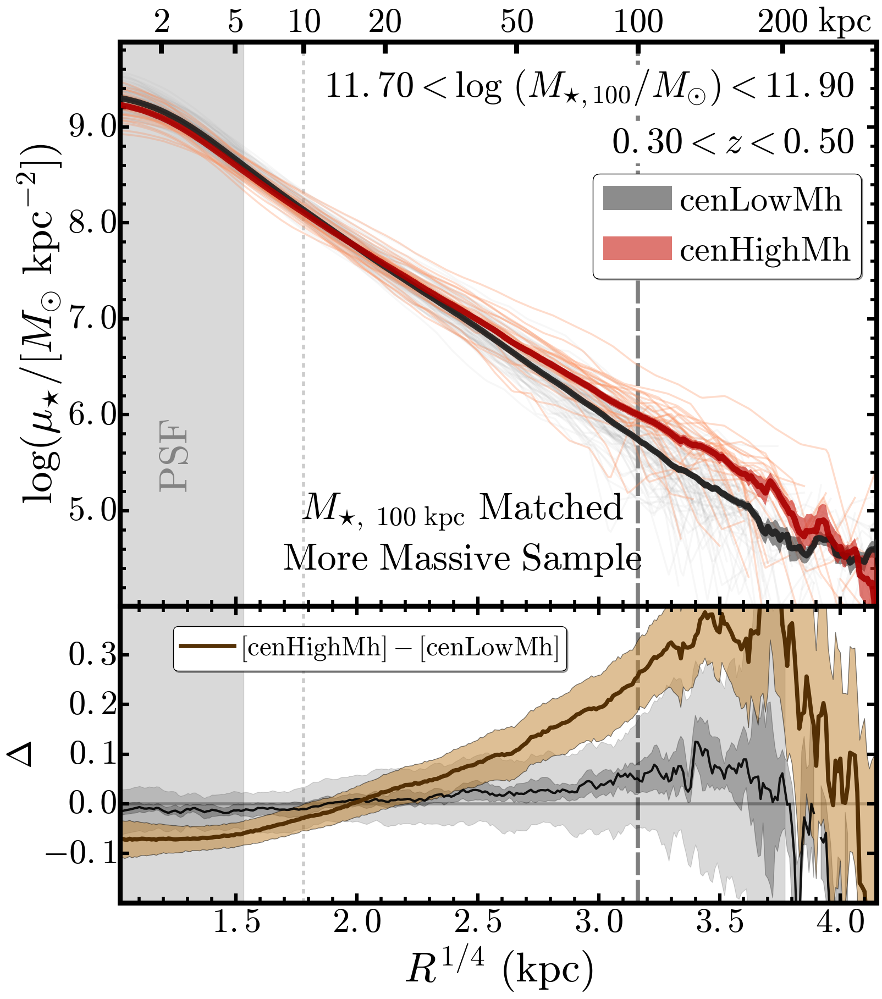

In [274]:
#-------------------------------------------------------------------------------#
profSample1, profSample2 = copy.deepcopy(redbcgProfM100b), copy.deepcopy(nonbcgProfM100b)
mass1, mass2, z1, z2, lamLimit = 11.70, 11.90, 0.3, 0.5, 30.0
outPng = sampleM100b
#-------------------------------------------------------------------------------#
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 4.15
#-------------------------------------------------------------------------------#
ymin, ymax = 4.01, 9.89
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.199, 0.399
diffColor1, diffColor2 = BROWN0, BROWN1 
showLegend = True
#-------------------------------------------------------------------------------#

print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 80.0) & (pp['rKpc'] < 88.0)])) <= 4.7:
        del profSample1[jj]
for jj, pp in enumerate(profSample1):
    if (np.nanmin(pp['muI1'][(pp['rKpc'] > 0.0) & (pp['rKpc'] < 2.5)])) >= 8.65:
        del profSample1[jj]
print(len(profSample1))

print(len(profSample2))
for jj, pp in enumerate(profSample2):
    if (np.median(pp['muI1'][(pp['rKpc'] > 95.0) & (pp['rKpc'] < 105.0)])) > 5.8:
        del profSample2[jj]
for jj, pp in enumerate(profSample2):
    if not np.isfinite(np.median(pp['muI1'][(pp['rKpc'] > 80.0) & (pp['rKpc'] < 100.0)])):
        del profSample2[jj]
for jj, pp in enumerate(profSample2):
    if not np.isfinite(np.median(pp['muI1'][pp['rKpc'] < 2.5])):
        del profSample2[jj]
for jj, pp in enumerate(profSample2):
    if (np.median(pp['muI1'][(pp['rKpc'] > 0.5) & (pp['rKpc'] < 2.0)])) <= 8.5:
        del profSample2[jj]
print(len(profSample2))

pFig1c = plotMassProfile(profSample1, profSample2, 
                         col1='muI1', col2='LOGM2LI', matchR=matchR,
                         norm=norm, integrate=integrate, divide=True, normR1=normR1, 
                         diffColor1=diffColor1, diffColor2=diffColor2, showLegend=showLegend, 
                         xmin=xmin, xmax=xmax, ymin=ymin, ymax=ymax,
                         dmin=dmin, dmax=dmax, alpha1=0.07, alpha2=0.30,
                         lw1=2.5, lw2=2.5,
                         highlight1=highlight1, highlight2=highlight2, 
                         lamLimit=lamLimit, mass1=mass1, mass2=mass2, z1=z1, z2=z2,
                         outPng=outPng, showLMask=False, showMean=True, figDir=figDir,
                         label1="$\mathrm{cenLowMh}$", 
                         label2="$\mathrm{cenHighMh}$",
                         xtickFormat='$\mathrm{%3.1f}$', ytickFormat='$\mathrm{%3.1f}$',
                         ytickFormat2='$\mathrm{%3.1f}$',
                         xLegend=0.625, yLegend=0.58,
                         text1='$M_{\star,\ 100\ \mathrm{kpc}}\ \mathrm{Matched}$', 
                         text2='$\mathrm{More\ Massive\ Sample}$', 
                         xText=0.452, yText1=0.13, yText2=0.05)

## LogM_100 Matched Samples; Low-z Samples

30
26
25
23
144
143
137
136
131
# Sample1:  11.4203503742
# Sample2:  11.4311790631


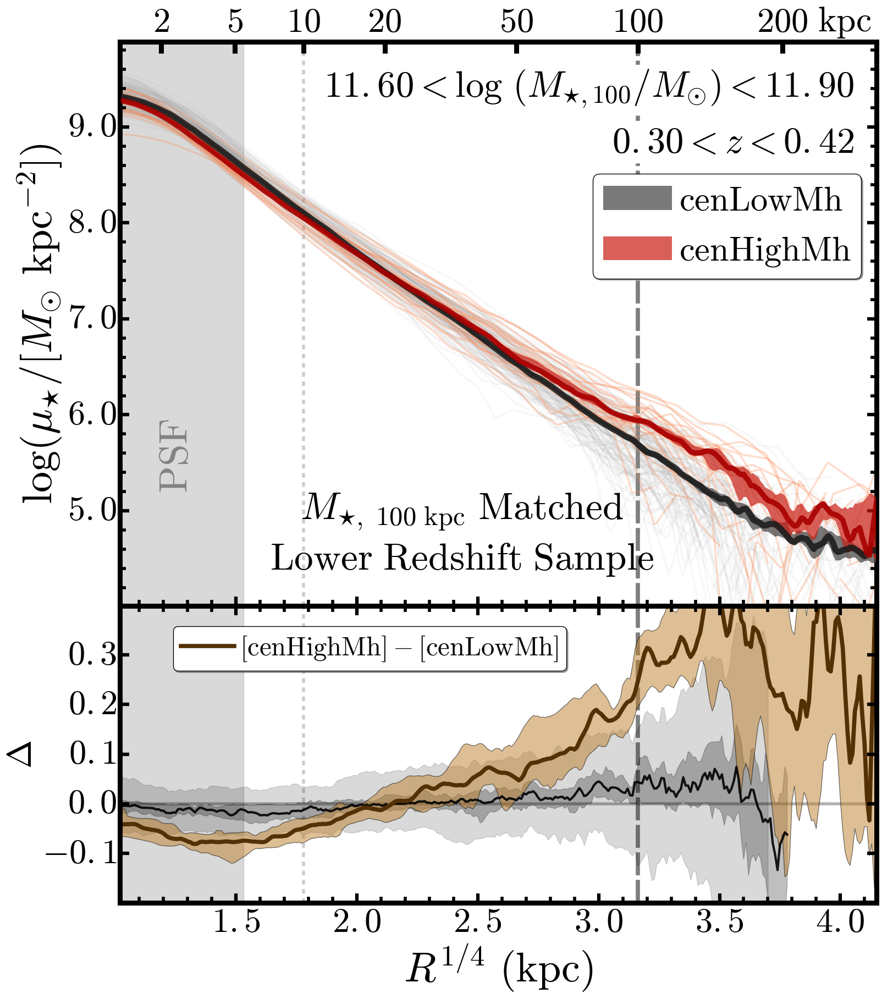

In [19]:
#-------------------------------------------------------------------------------#
profSample1, profSample2 = copy.deepcopy(redbcgProfM100e), copy.deepcopy(nonbcgProfM100e)
mass1, mass2, z1, z2, lamLimit = 11.60, 11.90, 0.30, 0.42, 30.0
outPng = sampleM100e
#-------------------------------------------------------------------------------#
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 4.15
#-------------------------------------------------------------------------------#
ymin, ymax = 4.01, 9.89
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.199, 0.399
diffColor1, diffColor2 = BROWN0, BROWN1 
showLegend = True
#-------------------------------------------------------------------------------#

print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.nanmin(pp['muI1'][(pp['rKpc'] > 0.0) & (pp['rKpc'] < 2.0)])) > 8.75:
        del profSample1[jj]
print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 95.0) & (pp['rKpc'] < 105.0)])) > 5.8:
        del profSample1[jj]
print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 80.0) & (pp['rKpc'] < 90.0)])) < 5.25:
        del profSample1[jj]
print(len(profSample1))

print(len(profSample2))
for jj, pp in enumerate(profSample2):
    if (np.median(pp['muI1'][(pp['rKpc'] > 95.0) & (pp['rKpc'] < 105.0)])) > 5.8:
        del profSample2[jj]
print(len(profSample2))
for jj, pp in enumerate(profSample2):
    if not np.isfinite(np.median(pp['muI1'][(pp['rKpc'] > 80.0) & (pp['rKpc'] < 100.0)])):
        del profSample2[jj]
print(len(profSample2))
for jj, pp in enumerate(profSample2):
    if not np.isfinite(np.median(pp['muI1'][pp['rKpc'] < 2.5])):
        del profSample2[jj]
print(len(profSample2))
for jj, pp in enumerate(profSample2):
    if (np.nanmin(pp['muI1'][(pp['rKpc'] > 0.0) & (pp['rKpc'] < 2.0)])) <= 8.5:
        del profSample2[jj]
print(len(profSample2))

pFig1c = plotMassProfile(profSample1, profSample2, 
                         col1='muI1', col2='LOGM2LI', matchR=matchR,
                         norm=norm, integrate=integrate, divide=True, normR1=normR1, 
                         diffColor1=diffColor1, diffColor2=diffColor2, showLegend=showLegend, 
                         xmin=xmin, xmax=xmax, ymin=ymin, ymax=ymax,
                         dmin=dmin, dmax=dmax, alpha1=0.07, alpha2=0.30,
                         lw1=2.5, lw2=2.5,
                         highlight1=highlight1, highlight2=highlight2, 
                         lamLimit=lamLimit, mass1=mass1, mass2=mass2, z1=z1, z2=z2,
                         outPng=outPng, showLMask=False, showMean=False, figDir=figDir,
                         label1="$\mathrm{cenLowMh}$", 
                         label2="$\mathrm{cenHighMh}$",
                         xtickFormat='$\mathrm{%3.1f}$', ytickFormat='$\mathrm{%3.1f}$',
                         ytickFormat2='$\mathrm{%3.1f}$',
                         xLegend=0.625, yLegend=0.58,
                         text1='$M_{\star,\ 100\ \mathrm{kpc}}\ \mathrm{Matched}$', 
                         text2='$\mathrm{Lower\ Redshift\ Sample}$', 
                         xText=0.452, yText1=0.13, yText2=0.05)

## LogM_100 Matched Samples: Lower-lambda Samples

53
52
47
183
181
175
174
172
# Sample1:  11.4350515956
# Sample2:  11.4454492984


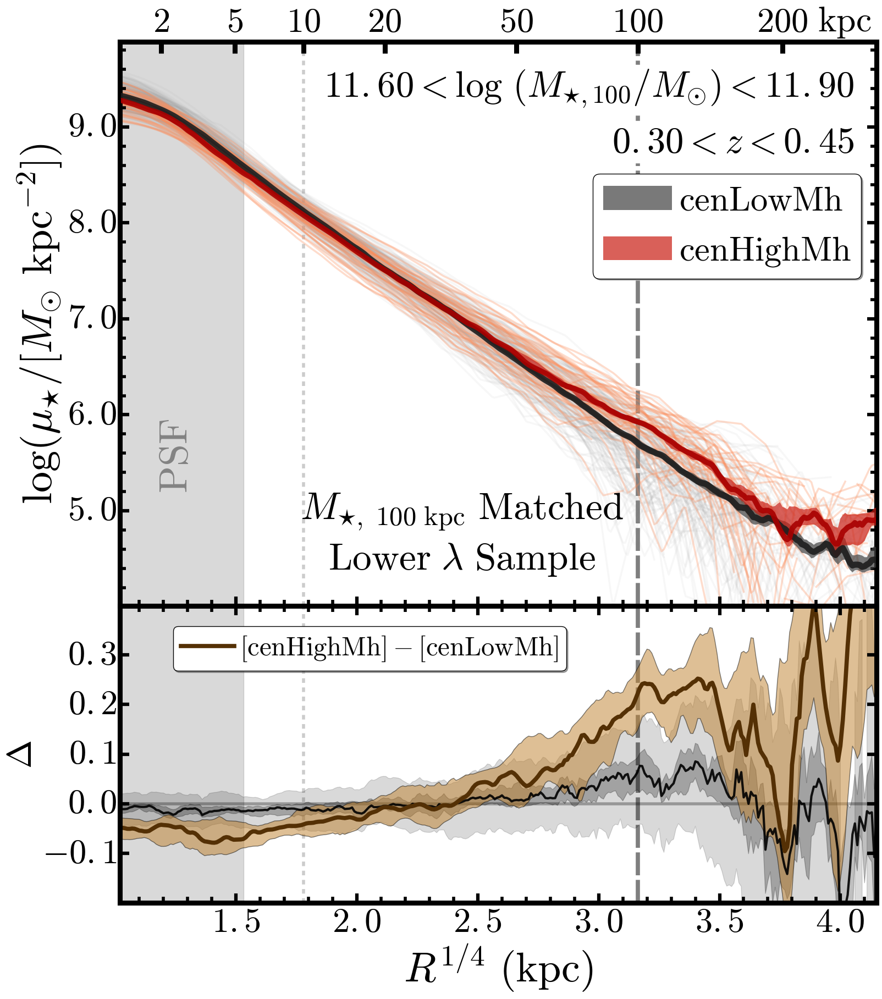

In [23]:
#-------------------------------------------------------------------------------#
profSample1, profSample2 = copy.deepcopy(redbcgProfM100y), copy.deepcopy(nonbcgProfM100y)
mass1, mass2, z1, z2, lamLimit = 11.60, 11.90, 0.30, 0.45, 20.0
outPng = sampleM100y
#-------------------------------------------------------------------------------#
matchR, highlight1, highlight2 = 100.0, False, True
xmin, xmax =  1.02, 4.15
#-------------------------------------------------------------------------------#
ymin, ymax = 4.01, 9.89
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.199, 0.399
diffColor1, diffColor2 = BROWN0, BROWN1 
showLegend = True
#-------------------------------------------------------------------------------#

print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 100.0) & (pp['rKpc'] < 105.0)])) > 5.8:
        del profSample1[jj]
print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 80.0) & (pp['rKpc'] < 100.0)])) < 5.28:
        del profSample1[jj]
print(len(profSample1))

print(len(profSample2))
for jj, pp in enumerate(profSample2):
    if (np.median(pp['muI1'][(pp['rKpc'] > 95.0) & (pp['rKpc'] < 105.0)])) > 5.8:
        del profSample2[jj]
print(len(profSample2))
for jj, pp in enumerate(profSample2):
    if not np.isfinite(np.median(pp['muI1'][(pp['rKpc'] > 80.0) & (pp['rKpc'] < 100.0)])):
        del profSample2[jj]
print(len(profSample2))
for jj, pp in enumerate(profSample2):
    if not np.isfinite(np.median(pp['muI1'][pp['rKpc'] < 2.5])):
        del profSample2[jj]
print(len(profSample2))
for jj, pp in enumerate(profSample2):
    if (np.median(pp['muI1'][(pp['rKpc'] > 0.5) & (pp['rKpc'] < 2.0)])) <= 8.5:
        del profSample2[jj]
print(len(profSample2))

pFig1c = plotMassProfile(profSample1, profSample2, 
                         col1='muI1', col2='LOGM2LI', matchR=matchR,
                         norm=norm, integrate=integrate, divide=True, normR1=normR1, 
                         diffColor1=diffColor1, diffColor2=diffColor2, showLegend=showLegend, 
                         xmin=xmin, xmax=xmax, ymin=ymin, ymax=ymax,
                         dmin=dmin, dmax=dmax, alpha1=0.07, alpha2=0.30,
                         lw1=2.5, lw2=2.5,
                         highlight1=highlight1, highlight2=highlight2, 
                         lamLimit=lamLimit, mass1=mass1, mass2=mass2, z1=z1, z2=z2,
                         outPng=outPng, showLMask=False, showMean=False, figDir=figDir,
                         label1="$\mathrm{cenLowMh}$", 
                         label2="$\mathrm{cenHighMh}$",
                         xtickFormat='$\mathrm{%3.1f}$', ytickFormat='$\mathrm{%3.1f}$',
                         ytickFormat2='$\mathrm{%3.1f}$',
                         xLegend=0.625, yLegend=0.58,
                         text1='$M_{\star,\ 100\ \mathrm{kpc}}\ \mathrm{Matched}$', 
                         text2='$\mathrm{Lower\ }\lambda\ \mathrm{Sample}$', 
                         xText=0.452, yText1=0.13, yText2=0.05)

## LogM_150 Matched Samples

44
42
41
211
209
205
204
200
# Sample1:  11.4411374566
# Sample2:  11.4312123244


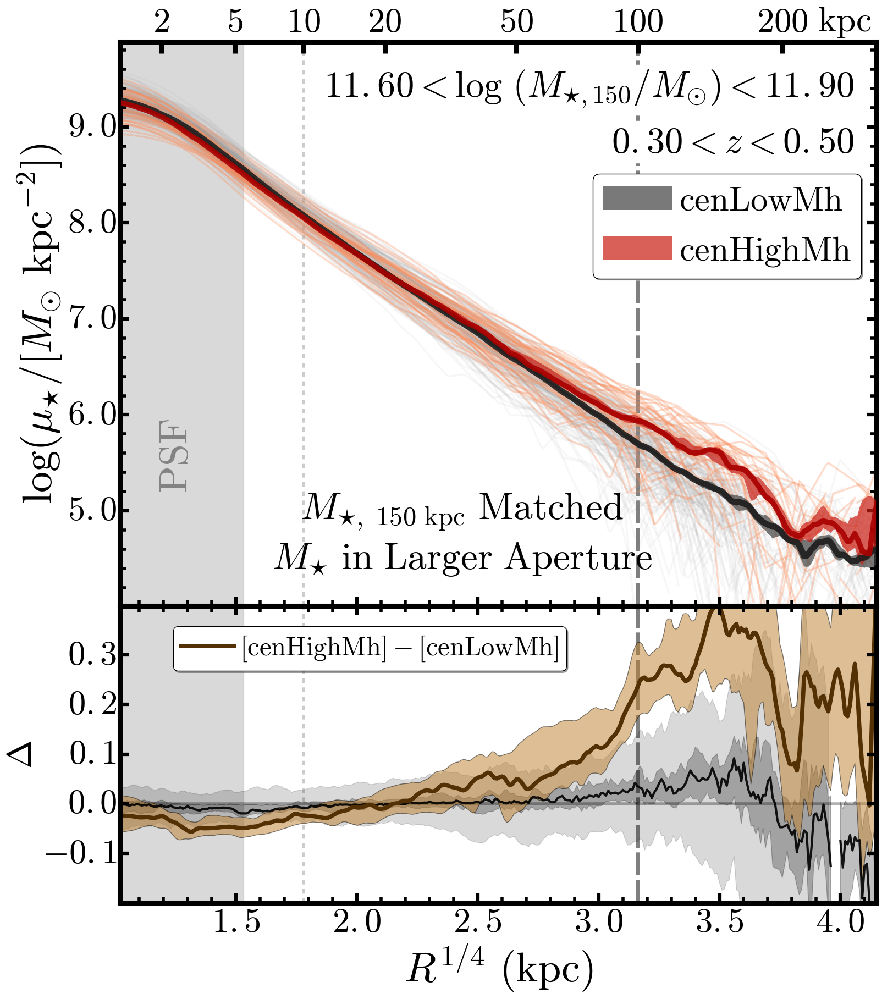

In [26]:
#-------------------------------------------------------------------------------#
profSample1, profSample2 = copy.deepcopy(redbcgProfM150o), copy.deepcopy(nonbcgProfM150o)
mass1, mass2, z1, z2, lamLimit = 11.6, 11.9, 0.30, 0.50, 30.0
outPng = sampleM150o 
#-------------------------------------------------------------------------------#
matchR, highlight1, highlight2 = 150, False, True
xmin, xmax =  1.02, 4.15
#-------------------------------------------------------------------------------#
ymin, ymax = 4.01, 9.89
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.199, 0.399
diffColor1, diffColor2 = BROWN0, BROWN1 
showLegend = True
#-------------------------------------------------------------------------------#

print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 80.0) & (pp['rKpc'] < 88.0)])) <= 4.7:
        del profSample1[jj]
print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 97.0) & (pp['rKpc'] < 102.0)])) >= 5.9:
        del profSample1[jj]
print(len(profSample1))

print(len(profSample2))
for jj, pp in enumerate(profSample2):
    if (np.median(pp['muI1'][(pp['rKpc'] > 95.0) & (pp['rKpc'] < 105.0)])) > 5.8:
        del profSample2[jj]
print(len(profSample2))
for jj, pp in enumerate(profSample2):
    if not np.isfinite(np.median(pp['muI1'][(pp['rKpc'] > 80.0) & (pp['rKpc'] < 100.0)])):
        del profSample2[jj]
print(len(profSample2))
for jj, pp in enumerate(profSample2):
    if not np.isfinite(np.median(pp['muI1'][pp['rKpc'] < 2.5])):
        del profSample2[jj]
print(len(profSample2))
for jj, pp in enumerate(profSample2):
    if (np.median(pp['muI1'][(pp['rKpc'] > 0.5) & (pp['rKpc'] < 2.0)])) <= 8.5:
        del profSample2[jj]
print(len(profSample2))

pFig1b = plotMassProfile(profSample1, profSample2, 
                         col1='muI1', col2='LOGM2LI', matchR=matchR,
                         norm=norm, integrate=integrate, divide=False, normR1=normR1, 
                         diffColor1=diffColor1, diffColor2=diffColor2, showLegend=True, 
                         xmin=xmin, xmax=xmax, ymin=ymin, ymax=ymax,
                         dmin=dmin, dmax=dmax, alpha1=0.07, alpha2=0.30,
                         lw1=2.5, lw2=2.5, boxSize=3,
                         highlight1=highlight1, highlight2=highlight2, 
                         lamLimit=lamLimit, mass1=mass1, mass2=mass2, z1=z1, z2=z2,
                         outPng=outPng, showLMask=False, showMean=False, figDir=figDir,
                         label1="$\mathrm{cenLowMh}$", 
                         label2="$\mathrm{cenHighMh}$",
                         xtickFormat='$\mathrm{%3.1f}$', ytickFormat='$\mathrm{%3.1f}$',
                         ytickFormat2='$\mathrm{%3.1f}$',
                         xLegend=0.625, yLegend=0.58,
                         text1='$M_{\star,\ 150\ \mathrm{kpc}}\ \mathrm{Matched}$', 
                         text2='$M_{\star}\ \mathrm{in\ Larger\ Aperture}$', 
                         xText=0.452, yText1=0.13, yText2=0.05)

# Median Profiles of LogM_10 Matched samples; Appendix 

## LogM_10 and LogM_15 Matched Samples

69
63
367
367
# Sample1:  11.0420866376
# Sample2:  11.0301806291


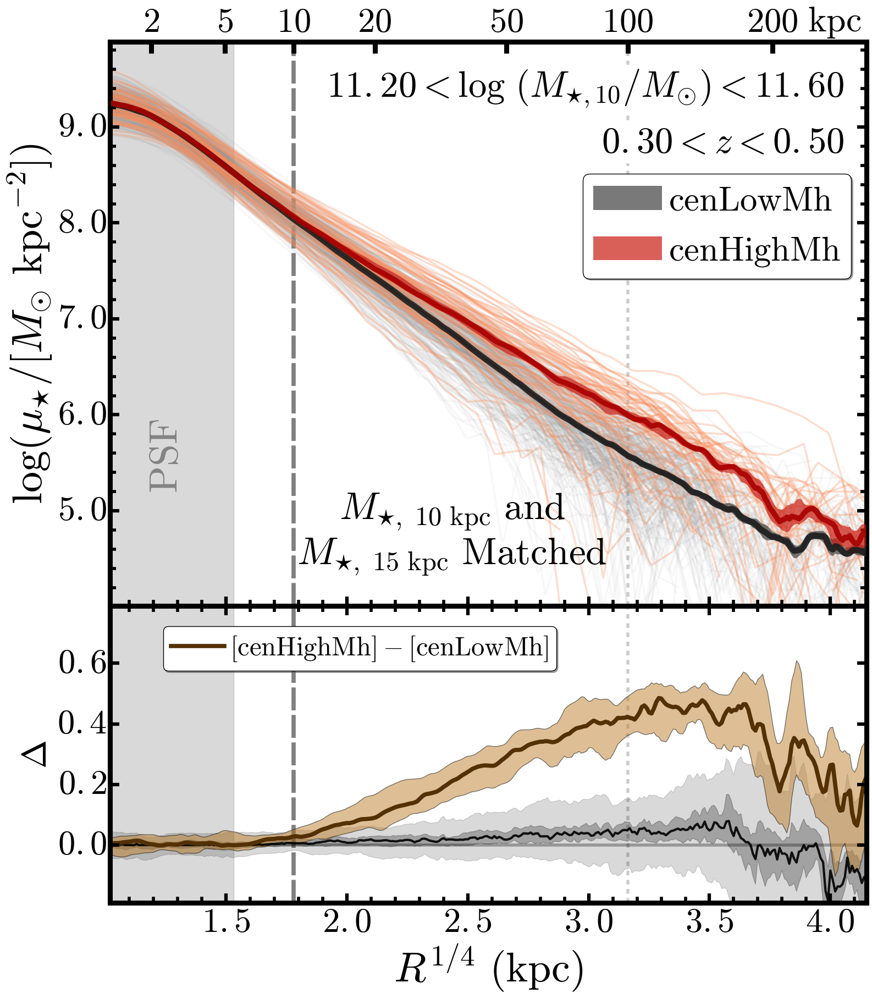

In [27]:
#-------------------------------------------------------------------------------#
profSample1, profSample2 = copy.deepcopy(redbcgProfM10d), copy.deepcopy(nonbcgProfM10d)
mass1, mass2, z1, z2, lamLimit = 11.20, 11.60, 0.3, 0.5, 30.0
outPng = sampleM10d
#-------------------------------------------------------------------------------#
matchR, highlight1, highlight2 = 10.0, True, False
xmin, xmax =  1.02, 4.15
#-------------------------------------------------------------------------------#
ymin, ymax = 4.01, 9.89
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.19, 0.79
diffColor1, diffColor2 = BROWN0, BROWN1 
showLegend = True
#-------------------------------------------------------------------------------#

print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 99.0) & (pp['rKpc'] < 103.0)])) > 5.9:
        del profSample1[jj]
print(len(profSample1))

print(len(profSample2))
for jj, pp in enumerate(profSample2):
    if not np.isfinite(np.median(pp['muI1'][pp['rKpc'] < 2.5])):
        del profSample2[jj]
print(len(profSample2))

pFig1a = plotMassProfile(profSample1, profSample2, 
                         col1='muI1', col2='LOGM2LI', matchR=matchR,
                         norm=norm, integrate=integrate, divide=True, normR1=normR1, 
                         diffColor1=diffColor1, diffColor2=diffColor2, showLegend=showLegend, 
                         xmin=xmin, xmax=xmax, ymin=ymin, ymax=ymax,
                         dmin=dmin, dmax=dmax, alpha1=0.07, alpha2=0.30,
                         lw1=2.5, lw2=2.5, 
                         highlight1=highlight1, highlight2=highlight2, 
                         lamLimit=lamLimit, mass1=mass1, mass2=mass2, z1=z1, z2=z2,
                         outPng=outPng, showLMask=False, showMean=False, figDir=figDir,
                         label1="$\mathrm{cenLowMh}$", 
                         label2="$\mathrm{cenHighMh}$",
                         xtickFormat='$\mathrm{%3.1f}$', ytickFormat='$\mathrm{%3.1f}$',
                         ytickFormat2='$\mathrm{%3.1f}$',
                         xLegend=0.625, yLegend=0.58,
                         text1='$M_{\star,\ 10\ \mathrm{kpc}}\ \mathrm{and}$', 
                         text2='$M_{\star,\ 15\ \mathrm{kpc}}\ \mathrm{Matched}$', 
                         xText=0.452, yText1=0.13, yText2=0.05)

## LogM_10 Matched Samples: Using Massive Galaxies Only

66
60
379
378
# Sample1:  11.0511852314
# Sample2:  11.0296784983


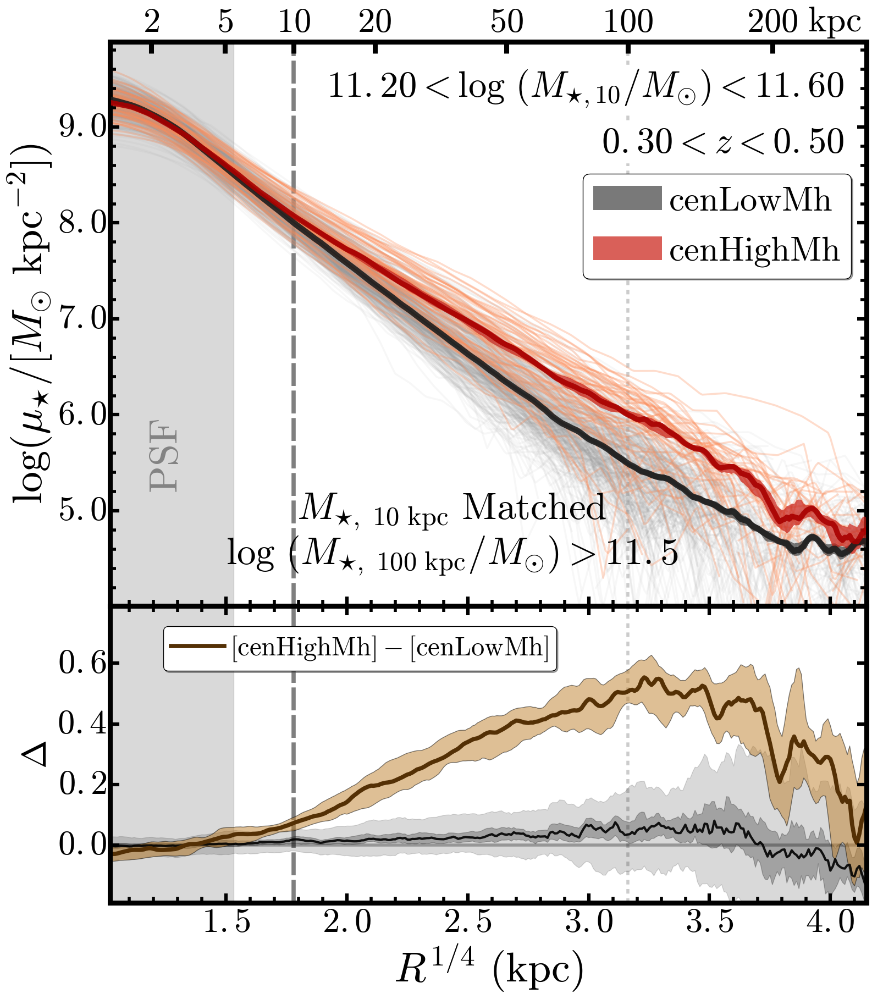

In [28]:
#-------------------------------------------------------------------------------#
profSample1, profSample2 = copy.deepcopy(redbcgProfM10o), copy.deepcopy(nonbcgProfM10o)
mass1, mass2, z1, z2, lamLimit = 11.20, 11.60, 0.3, 0.5, 30.0
outPng = sampleM10o
#-------------------------------------------------------------------------------#
matchR, highlight1, highlight2 = 10.0, True, False
xmin, xmax =  1.02, 4.15
#-------------------------------------------------------------------------------#
ymin, ymax = 4.01, 9.89
norm, integrate, normR1 = False, False, 10.0
dmin, dmax = -0.19, 0.79
diffColor1, diffColor2 = BROWN0, BROWN1 
showLegend = True
#-------------------------------------------------------------------------------#

print(len(profSample1))
for jj, pp in enumerate(profSample1):
    if (np.median(pp['muI1'][(pp['rKpc'] > 99.0) & (pp['rKpc'] < 103.0)])) > 5.9:
        del profSample1[jj]
print(len(profSample1))

print(len(profSample2))
for jj, pp in enumerate(profSample2):
    if not np.isfinite(np.median(pp['muI1'][pp['rKpc'] < 2.5])):
        del profSample2[jj]
print(len(profSample2))

pFig1a = plotMassProfile(profSample1, profSample2, 
                         col1='muI1', col2='LOGM2LI', matchR=matchR,
                         norm=norm, integrate=integrate, divide=True, normR1=normR1, 
                         diffColor1=diffColor1, diffColor2=diffColor2, showLegend=showLegend, 
                         xmin=xmin, xmax=xmax, ymin=ymin, ymax=ymax,
                         dmin=dmin, dmax=dmax, alpha1=0.07, alpha2=0.30,
                         lw1=2.5, lw2=2.5, 
                         highlight1=highlight1, highlight2=highlight2, 
                         lamLimit=lamLimit, mass1=mass1, mass2=mass2, z1=z1, z2=z2,
                         outPng=outPng, showLMask=False, showMean=False, figDir=figDir,
                         label1="$\mathrm{cenLowMh}$", 
                         label2="$\mathrm{cenHighMh}$",
                         xtickFormat='$\mathrm{%3.1f}$', ytickFormat='$\mathrm{%3.1f}$',
                         ytickFormat2='$\mathrm{%3.1f}$',
                         xLegend=0.625, yLegend=0.58,
                         text1='$M_{\star,\ 10\ \mathrm{kpc}}\ \mathrm{Matched}$', 
                         text2='$\log\ (M_{\star,\ 100\ \mathrm{kpc}}/M_{\odot}) > 11.5$', 
                         xText=0.452, yText1=0.13, yText2=0.05)

# Comparison of Ellipticity and Color Profiles

In [136]:
#-------------------------------------------------------------------------------#
profSample1, profSample2 = nonbcgProfM100c, redbcgProfM100c
outPng = sampleM100c
figDir = figDir
save = True
#-------------------------------------------------------------------------------#
indEll1, indEll2 = 0.9, 3.8
indColor1, indColor2 = 0.9, 3.9
colG, colR, colI, colZ = 'muG1', 'muR1', 'muI1', 'muZ1'
colEll = 'ell'
norm, integrate, normR1 = False, False, 10.0

#### ELLIPTICITY PROFILES ####
indEllip = np.intersect1d(np.where(RSMA_COMMON >= indEll1)[0], 
                          np.where(RSMA_COMMON <= indEll2)[0])

# GAMA M1a 
gm_se, gm_me, gm_ae, gm_de = organizeSbp(profSample1, col1=colEll, col2=None, 
                                         kind='sbp', index=indEllip)
# BCG M1a 
bm_se, bm_me, bm_ae, bm_de = organizeSbp(profSample2, col1=colEll, col2=None, 
                                         kind='sbp', index=indEllip)

#### COLOR PROFILES ####
indColor= np.intersect1d(np.where(RSMA_COMMON >= indColor1)[0], 
                         np.where(RSMA_COMMON <= indColor2)[0])

#### g-i color ####
gm_sgi, gm_mgi, gm_agi, gm_dgi = organizeSbp(profSample1, 
                                             col1=colG, col2=colI, kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_I', 
                                             sun1=SUN_G, sun2=SUN_I,
                                             index=indColor)
bm_sgi, bm_mgi, bm_agi, bm_dgi = organizeSbp(profSample2, 
                                             col1=colG, col2=colI, kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_I', 
                                             sun1=SUN_G, sun2=SUN_I, 
                                             index=indColor)

#### g-r color ####
gm_sgr, gm_mgr, gm_agr, gm_dgr = organizeSbp(profSample1, 
                                             col1=colG, col2=colR, kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_R', 
                                             sun1=SUN_G, sun2=SUN_R,
                                             index=indColor)
bm_sgr, bm_mgr, bm_agr, bm_dgr = organizeSbp(profSample2, 
                                             col1=colG, col2=colR, kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_R', 
                                             sun1=SUN_G, sun2=SUN_R, 
                                             index=indColor)

#### g-z color ####
gm_sgz, gm_mgz, gm_agz, gm_dgz = organizeSbp(profSample1, 
                                             col1=colG, col2=colZ, kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_Z', 
                                             sun1=SUN_G, sun2=SUN_Z,
                                             index=indColor)
bm_sgz, bm_mgz, bm_agz, bm_dgz = organizeSbp(profSample2, 
                                             col1=colG, col2=colZ, kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_Z', 
                                             sun1=SUN_G, sun2=SUN_Z, 
                                             index=indColor)

## NO KCORRECTION APPLIED !!
## NO KCORRECTION APPLIED !!


/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:232: RuntimeWarning: invalid value encountered in subtract


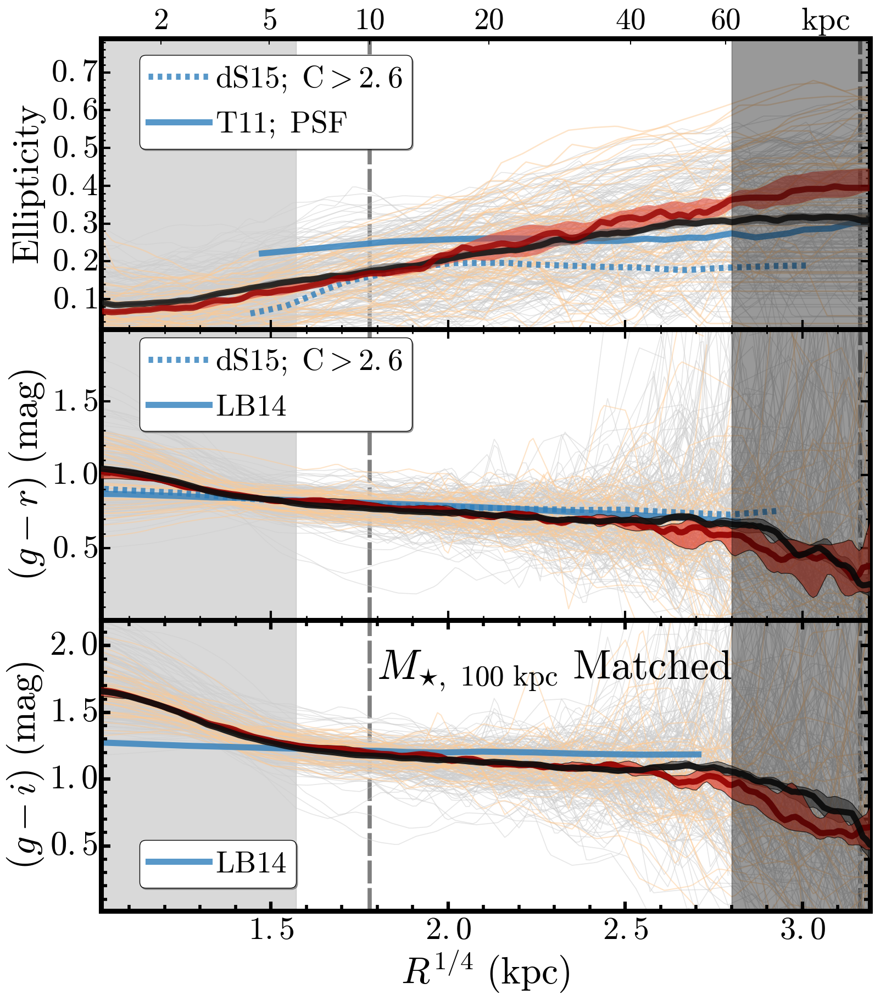

In [137]:
EC1 = [0.119, 0.082, 0.875, 0.294]
EC2 = [0.119, 0.376, 0.875, 0.294]
EC3 = [0.119, 0.670, 0.875, 0.294]

#-------------------------------------------------------------------------------#
matchR, highlight1, highlight2 = 100.0, False, True
ymin1, ymax1 = 0.02, 0.79
ymin2, ymax2 = 0.01, 1.99
ymin3, ymax3 = 0.09, 2.19
rsma0 = 1.02
rsma1 = 3.19
xmin, xmax =  1.02, 3.19
xtickFormat, ytickFormat, ytickFormat2 = '$\mathbf{%3.1f}$', '$\mathbf{%3.1f}$', '$\mathbf{%3.1f}$'
highlight1, highlight2 = True, True
vline1, vline2 = 10.0, 100.0
rPsfKpc = 6.1
cmap1, cmap2, cmap3 = BLK, ORG, BLU
alpha1, alpha2 = 0.5, 0.5
compareOthers = True
kpcArr = [2.0, 5.0, 10.0, 20.0, 40.0, 60.0]
showLegend = True
xLegend1, yLegend1 = 0.05, 0.62
xLegend2, yLegend2 = 0.05, 0.65
xLegend3, yLegend3 = 0.05, 0.08
#-------------------------------------------------------------------------------#

# --------------------------------------------------------------------------------------- #
## Setup up figure
fig = plt.figure(figsize=(16, 18))
ax3 = plt.axes(EC1)
ax2 = plt.axes(EC2)
ax1 = plt.axes(EC3)
ax1 = songPlotSetup(ax1, ylabel=42, xlabel=42, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)
ax2 = songPlotSetup(ax2, ylabel=42, xlabel=42, border=6.5, 
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat2)
ax3 = songPlotSetup(ax3, ylabel=44, xlabel=42, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat2)
# --------------------------------------------------------------------------------------- #
## Mark the two interesting radius
if highlight1:
    ax1.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax1.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
if highlight2:
    ax1.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax1.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
# --------------------------------------------------------------------------------------- #

# --------------------------------------------------------------------------------------- #
# ELLIPTICITY PLOT
# --------------------------------------------------------------------------------------- #
## Horiozontal 0.0 line
ax1.axhline(0.0, linewidth=4.0, c='k', linestyle='-', zorder=0, alpha=0.3)
# --------------------------------------------------------------------------------------- #
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
# z = 0.5 : 1"=6.1 Kpc
ySep = (ymax1 - ymin1) / 5.0
ax1.fill_between([0.0, rPsfKpc ** 0.25], 
                 [ymin1 - ySep, ymin1 - ySep], 
                 [ymax1 + ySep, ymax1 + ySep], 
                 facecolor='k', edgecolor='k', alpha=0.15, zorder=0)
## Region affected by Sky
ax1.fill_between([2.8, 4.15], 
                 [ymin1 - ySep, ymin1 - ySep], 
                 [ymax1 + ySep, ymax1 + ySep], 
                 facecolor='k', edgecolor='k', alpha=0.40, zorder=1000)
# --------------------------------------------------------------------------------------- #
## Individual profiles
for i, gg in enumerate(gm_se):
    if np.nanmax(gg[RSMA_COMMON[indEllip] <= 2.1]) <= 0.4:
        ax1.plot(RSMA_COMMON[indEllip], gg, c=cmap1(0.3), alpha=alpha1, linewidth=1.2)
    else:
        np.delete(gm_se, i)
        
for j, bb in enumerate(bm_se):
    if np.nanmax(bb[RSMA_COMMON[indEllip] <= 2.1]) <= 0.4:
        ax1.plot(RSMA_COMMON[indEllip], bb, c=cmap2(0.3), alpha=alpha2, linewidth=1.8)
    else:
        np.delete(bm_se, j)
# --------------------------------------------------------------------------------------- #
## Smoothed median profiles 
gm_low = convolve(gm_me[0], Box1DKernel(5))    
gm_upp = convolve(gm_me[1], Box1DKernel(5)) 
gm_med = convolve(gm_me[2], Box1DKernel(3))

bm_low = convolve(bm_me[0], Box1DKernel(5))    
bm_upp = convolve(bm_me[1], Box1DKernel(5)) 
bm_med = convolve(bm_me[2], Box1DKernel(3))
        
ax1.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=cmap2(0.7), edgecolor='none', alpha=0.6, zorder=5)
ax1.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=cmap1(0.7), edgecolor='none', alpha=0.6, zorder=6)

ax1.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=8.0, 
         c=cmap1(0.95), alpha=0.8, zorder=7)
ax1.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=8.0, 
         c=cmap2(0.95), alpha=0.8, zorder=8)
# --------------------------------------------------------------------------------------- #
## Overplot other people's results 
if compareOthers:
    ax1.plot(dsouza15_ell['col1'] ** 0.25, dsouza15_ell['col2'], linestyle='--',
             c=cmap3(0.7), linewidth=8.0, alpha=0.8, label='$\mathrm{dS15;\ C}>2.6$')
    ax1.plot(tal11_ell_1['col1'] ** 0.25, tal11_ell_1['col2'], linestyle='-',
             c=cmap3(0.7), linewidth=8.0, alpha=0.8, label='$\mathrm{T11;\ PSF}$')
# --------------------------------------------------------------------------------------- #
## Legend
ax1.legend(loc=(xLegend1, yLegend1), shadow=True, fancybox=True, 
           numpoints=1, fontsize=40, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)
# --------------------------------------------------------------------------------------- #
## Label
ax1.set_ylabel('$\mathrm{Ellipticity}$', size=48)
# --------------------------------------------------------------------------------------- #
## X, Y, Limit
ax1.set_xlim(rsma0, rsma1)
ax1.set_ylim(ymin1, ymax1)
# --------------------------------------------------------------------------------------- #
## Remove the X-axis label
ax1.xaxis.set_major_formatter(NullFormatter())
ax1.tick_params('both', length=12, width=3, which='major')
ax1.tick_params('both', length=6, width=2, which='minor')

# --------------------------------------------------------------------------------------- #
## Secondary Axis 
ax1b = ax1.twiny()
kpcs = np.asarray(kpcArr)
kpcTicks= (kpcs ** 0.25)
ax1b.set_xlim(xmin, xmax)
ax1b.set_xticks(kpcTicks)
ax1b.set_xticklabels(['$\mathbf{%g}$' % kpc for kpc in kpcs], fontsize=40)
for tick in ax1b.xaxis.get_major_ticks():
    tick.label.set_fontsize(48) 
for tick in ax1b.yaxis.get_major_ticks():
    tick.label.set_fontsize(48) 
ax1b.text(0.91, 1.0058, '$\mathrm{kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=42.0, transform=ax1b.transAxes)

# --------------------------------------------------------------------------------------- #
# G-R COLOR PLOT
# --------------------------------------------------------------------------------------- #
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
# z = 0.5 : 1"=6.1 Kpc
ySep = (ymax2 - ymin2) / 5.0
ax2.fill_between([0.0, rPsfKpc ** 0.25], 
                 [ymin2 - ySep, ymin2 - ySep], 
                 [ymax2 + ySep, ymax2 + ySep], 
                 facecolor='k', edgecolor='k', alpha=0.15, zorder=0)
## Region affected by Sky
ax2.fill_between([2.8, 4.15], 
                 [ymin2 - ySep, ymin2 - ySep], 
                 [ymax2 + ySep, ymax2 + ySep], 
                 facecolor='k', edgecolor='k', alpha=0.40, zorder=1000)
# --------------------------------------------------------------------------------------- #
## Mark the two interesting radius
if highlight1:
    ax2.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax2.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
if highlight2:
    ax2.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax2.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
# --------------------------------------------------------------------------------------- #
## Individual profiles
for ggr in gm_sgr:
    ax2.plot(RSMA_COMMON[indColor], ggr, c=cmap1(0.3), alpha=alpha1, linewidth=1.2)
for bgr in bm_sgr:
    ax2.plot(RSMA_COMMON[indColor], bgr, c=cmap2(0.3), alpha=alpha2, linewidth=1.5)
# --------------------------------------------------------------------------------------- #
## Smoothed median profiles 
gm_low = convolve(gm_mgr[0], Box1DKernel(3))    
gm_upp = convolve(gm_mgr[1], Box1DKernel(3)) 
gm_med = convolve(gm_mgr[2], Box1DKernel(3))

bm_low = convolve(bm_mgr[0], Box1DKernel(3))    
bm_upp = convolve(bm_mgr[1], Box1DKernel(3)) 
bm_med = convolve(bm_mgr[2], Box1DKernel(3))

ax2.fill_between(RSMA_COMMON[indColor], gm_low, gm_upp, 
                 facecolor=cmap1(0.7), alpha=0.7, zorder=5)
ax2.fill_between(RSMA_COMMON[indColor], bm_low, bm_upp, 
                 facecolor=cmap2(0.7), alpha=0.7, zorder=6)
                 
ax2.plot(RSMA_COMMON[indColor], bm_med, linestyle='-', linewidth=8.0, 
         c=cmap2(0.95), alpha=0.9, zorder=7)
ax2.plot(RSMA_COMMON[indColor], gm_med, linestyle='-', linewidth=8.0, 
         c=cmap1(0.95), alpha=0.9, zorder=8)
# --------------------------------------------------------------------------------------- #
## Overplot other people's results 
if compareOthers:
    ax2.plot(dsouza15_gr['x'] ** 0.25, dsouza15_gr['y'], linestyle='--',
             c=cmap3(0.7), linewidth=8.0, alpha=0.8, label='$\mathrm{dS15;\ C}>2.6$')
    ax2.plot((lababera14_gr['col1'] * 7.0) ** 0.25, lababera14_gr['col2'], linestyle='-',
             c=cmap3(0.7), linewidth=8.0, alpha=0.8, label='$\mathrm{LB14}$')
# --------------------------------------------------------------------------------------- #
## Legend
ax2.legend(loc=(xLegend2, yLegend2), shadow=True, fancybox=True, 
           numpoints=1, fontsize=40, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

# --------------------------------------------------------------------------------------- #
## Label
ax2.set_ylabel('$(g-r)\ \mathrm{(mag)}$', size=49)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax2.set_xlim(rsma0, rsma1)
ax2.set_ylim(ymin2, ymax2)
# --------------------------------------------------------------------------------------- #
## Remove the X-axis label
ax2.xaxis.set_major_formatter(NullFormatter())
ax2.tick_params('both', length=12, width=3, which='major')
ax2.tick_params('both', length=6, width=2, which='minor')

# --------------------------------------------------------------------------------------- #
# G-I COLOR PLOT
# --------------------------------------------------------------------------------------- #
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
# z = 0.5 : 1"=6.1 Kpc
ySep = (ymax3 - ymin2) / 5.0
ax3.fill_between([0.0, rPsfKpc ** 0.25], 
                 [ymin2 - ySep, ymin2 - ySep], 
                 [ymax3 + ySep, ymax3 + ySep], 
                 facecolor='k', edgecolor='k', alpha=0.15, zorder=0)
## Region affected by Sky
ax3.fill_between([2.8, 4.15], 
                 [ymin2 - ySep, ymin2 - ySep], 
                 [ymax3 + ySep, ymax3 + ySep], 
                 facecolor='k', edgecolor='k', alpha=0.40, zorder=1000)
# --------------------------------------------------------------------------------------- #
## Mark the two interesting radius
if highlight1:
    ax3.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax3.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
if highlight2:
    ax3.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax3.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
# --------------------------------------------------------------------------------------- #
## Individual profiles
for ggi in gm_sgi:
    ax3.plot(RSMA_COMMON[indColor], ggi, c=cmap1(0.3), alpha=alpha1, linewidth=1.2)
for bgi in bm_sgi:
    ax3.plot(RSMA_COMMON[indColor], bgi, c=cmap2(0.3), alpha=alpha2, linewidth=1.5)
# --------------------------------------------------------------------------------------- #
## Smoothed median profiles 
gm_low = convolve(gm_mgi[0], Box1DKernel(3))    
gm_upp = convolve(gm_mgi[1], Box1DKernel(3)) 
gm_med = convolve(gm_mgi[2], Box1DKernel(3))

bm_low = convolve(bm_mgi[0], Box1DKernel(3))    
bm_upp = convolve(bm_mgi[1], Box1DKernel(3)) 
bm_med = convolve(bm_mgi[2], Box1DKernel(3))

ax3.fill_between(RSMA_COMMON[indColor], gm_low, gm_upp, 
                 facecolor=cmap1(0.7), alpha=0.7, zorder=5)
ax3.fill_between(RSMA_COMMON[indColor], bm_low, bm_upp, 
                 facecolor=cmap2(0.7), alpha=0.7, zorder=6)
                 
ax3.plot(RSMA_COMMON[indColor], bm_med, linestyle='-', linewidth=8.0, 
         c=cmap2(0.95), alpha=0.9, zorder=7)
ax3.plot(RSMA_COMMON[indColor], gm_med, linestyle='-', linewidth=8.0, 
         c=cmap1(0.95), alpha=0.9, zorder=8)
# --------------------------------------------------------------------------------------- #
## Overplot other people's results 
if compareOthers:
    ax3.plot((lababera14_gi['col1'] * 7.0) ** 0.25, lababera14_gi['col2'], linestyle='-',
             c=cmap3(0.7), linewidth=8.0, alpha=0.8, label='$\mathrm{LB14}$')
# --------------------------------------------------------------------------------------- #
## Legend
ax3.legend(loc=(xLegend3, yLegend3), shadow=True, fancybox=True, 
           numpoints=1, fontsize=40, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)
# --------------------------------------------------------------------------------------- #
## Text
## Text
ax3.text(0.59, 0.75, '$M_{\star,\ 100\ \mathrm{kpc}}\ \mathrm{Matched}$', 
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=55.0, transform=ax3.transAxes, weight='bold', 
         color='k')
# --------------------------------------------------------------------------------------- #
## Label
ax3.set_xlabel('$R^{1/4}\ (\mathrm{kpc})$', size=49)
ax3.set_ylabel('$(g-i)\ \mathrm{(mag)}$', size=49)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax3.set_xlim(rsma0, rsma1)
ax3.set_ylim(ymin2, ymax3)
# --------------------------------------------------------------------------------------- #

# --------------------------------------------------------------------------------------- #
plt.show()

if figDir is not None:
    outPng = os.path.join(figDir, outPng)
    
if save:
    fig.savefig(outPng + '_c.pdf', dpi=160)

In [128]:
#-------------------------------------------------------------------------------#
profSample1, profSample2 = nonbcgProfM10c, redbcgProfM10c
outPng = sampleM10c
figDir = figDir
save = True
#-------------------------------------------------------------------------------#
indEll1, indEll2 = 0.9, 3.8
indColor1, indColor2 = 0.9, 3.9
colG, colR, colI, colZ = 'muG1', 'muR1', 'muI1', 'muZ1'
colEll = 'ell'
norm, integrate, normR1 = False, False, 10.0

#### ELLIPTICITY PROFILES ####
indEllip = np.intersect1d(np.where(RSMA_COMMON >= indEll1)[0], 
                          np.where(RSMA_COMMON <= indEll2)[0])

# GAMA M1a 
gm_se, gm_me, gm_ae, gm_de = organizeSbp(profSample1, col1=colEll, col2=None, 
                                         kind='sbp', index=indEllip)
# BCG M1a 
bm_se, bm_me, bm_ae, bm_de = organizeSbp(profSample2, col1=colEll, col2=None, 
                                         kind='sbp', index=indEllip)

#### COLOR PROFILES ####
indColor= np.intersect1d(np.where(RSMA_COMMON >= indColor1)[0], 
                         np.where(RSMA_COMMON <= indColor2)[0])

#### g-i color ####
gm_sgi, gm_mgi, gm_agi, gm_dgi = organizeSbp(profSample1, 
                                             col1=colG, col2=colI, kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_I', 
                                             sun1=SUN_G, sun2=SUN_I,
                                             index=indColor)
bm_sgi, bm_mgi, bm_agi, bm_dgi = organizeSbp(profSample2, 
                                             col1=colG, col2=colI, kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_I', 
                                             sun1=SUN_G, sun2=SUN_I, 
                                             index=indColor)

#### g-r color ####
gm_sgr, gm_mgr, gm_agr, gm_dgr = organizeSbp(profSample1, 
                                             col1=colG, col2=colR, kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_R', 
                                             sun1=SUN_G, sun2=SUN_R,
                                             index=indColor)
bm_sgr, bm_mgr, bm_agr, bm_dgr = organizeSbp(profSample2, 
                                             col1=colG, col2=colR, kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_R', 
                                             sun1=SUN_G, sun2=SUN_R, 
                                             index=indColor)

#### g-z color ####
gm_sgz, gm_mgz, gm_agz, gm_dgz = organizeSbp(profSample1, 
                                             col1=colG, col2=colZ, kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_Z', 
                                             sun1=SUN_G, sun2=SUN_Z,
                                             index=indColor)
bm_sgz, bm_mgz, bm_agz, bm_dgz = organizeSbp(profSample2, 
                                             col1=colG, col2=colZ, kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_Z', 
                                             sun1=SUN_G, sun2=SUN_Z, 
                                             index=indColor)

## NO KCORRECTION APPLIED !!
## NO KCORRECTION APPLIED !!


/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:232: RuntimeWarning: invalid value encountered in subtract


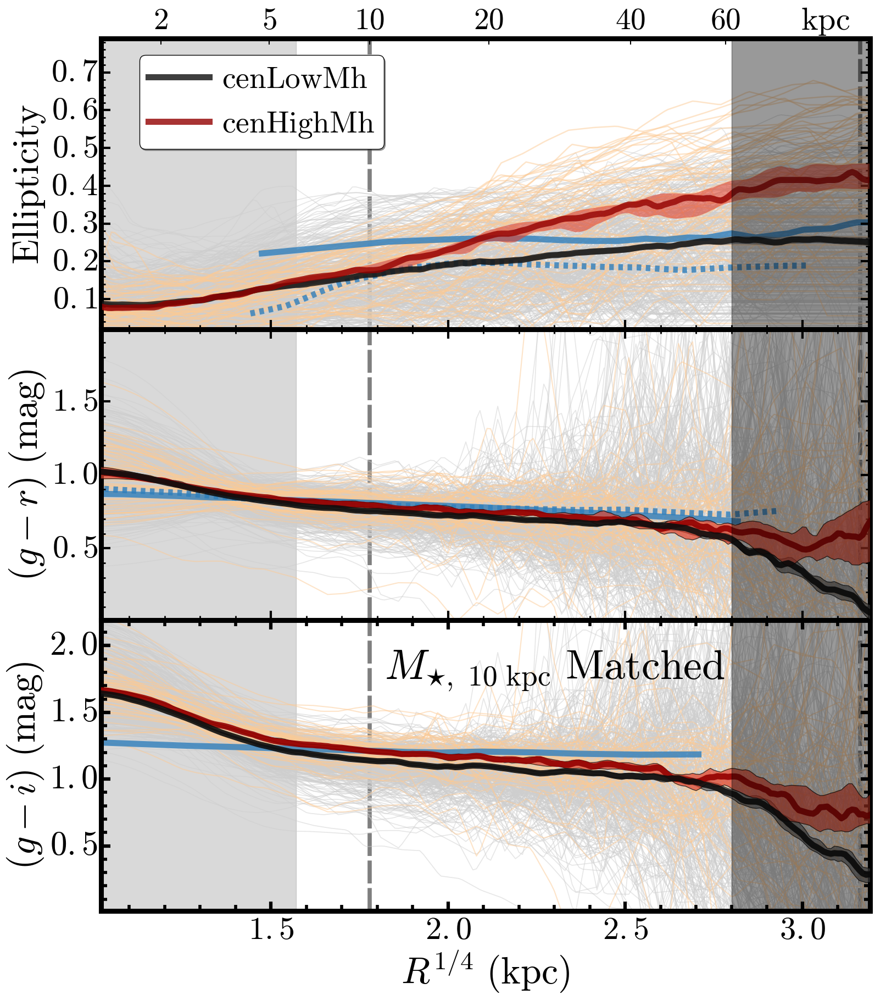

In [135]:
EC1 = [0.119, 0.082, 0.875, 0.294]
EC2 = [0.119, 0.376, 0.875, 0.294]
EC3 = [0.119, 0.670, 0.875, 0.294]

#-------------------------------------------------------------------------------#
matchR, highlight1, highlight2 = 100.0, False, True
ymin1, ymax1 = 0.02, 0.79
ymin2, ymax2 = 0.01, 1.99
ymin3, ymax3 = 0.09, 2.19
rsma0 = 1.02
rsma1 = 3.19
xmin, xmax =  1.02, 3.19
xtickFormat, ytickFormat, ytickFormat2 = '$\mathbf{%3.1f}$', '$\mathbf{%3.1f}$', '$\mathbf{%3.1f}$'
highlight1, highlight2 = True, True
vline1, vline2 = 10.0, 100.0
rPsfKpc = 6.1
cmap1, cmap2, cmap3 = BLK, ORG, BLU
alpha1, alpha2 = 0.5, 0.5
compareOthers = True
kpcArr = [2.0, 5.0, 10.0, 20.0, 40.0, 60.0]
showLegend = True
xLegend1, yLegend1 = 0.05, 0.62
xLegend2, yLegend2 = 0.05, 0.65
xLegend3, yLegend3 = 0.05, 0.08
#-------------------------------------------------------------------------------#

# --------------------------------------------------------------------------------------- #
## Setup up figure
fig = plt.figure(figsize=(16, 18))
ax3 = plt.axes(EC1)
ax2 = plt.axes(EC2)
ax1 = plt.axes(EC3)
ax1 = songPlotSetup(ax1, ylabel=42, xlabel=42, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat)
ax2 = songPlotSetup(ax2, ylabel=42, xlabel=42, border=6.5, 
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat2)
ax3 = songPlotSetup(ax3, ylabel=44, xlabel=42, border=6.5,
                    xtickFormat=xtickFormat, ytickFormat=ytickFormat2)
# --------------------------------------------------------------------------------------- #
## Mark the two interesting radius
if highlight1:
    ax1.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax1.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
if highlight2:
    ax1.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax1.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
# --------------------------------------------------------------------------------------- #

# --------------------------------------------------------------------------------------- #
# ELLIPTICITY PLOT
# --------------------------------------------------------------------------------------- #
## Horiozontal 0.0 line
ax1.axhline(0.0, linewidth=4.0, c='k', linestyle='-', zorder=0, alpha=0.3)
# --------------------------------------------------------------------------------------- #
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
# z = 0.5 : 1"=6.1 Kpc
ySep = (ymax1 - ymin1) / 5.0
ax1.fill_between([0.0, rPsfKpc ** 0.25], 
                 [ymin1 - ySep, ymin1 - ySep], 
                 [ymax1 + ySep, ymax1 + ySep], 
                 facecolor='k', edgecolor='k', alpha=0.15, zorder=0)
## Region affected by Sky
ax1.fill_between([2.8, 4.15], 
                 [ymin1 - ySep, ymin1 - ySep], 
                 [ymax1 + ySep, ymax1 + ySep], 
                 facecolor='k', edgecolor='k', alpha=0.40, zorder=1000)
# --------------------------------------------------------------------------------------- #
## Individual profiles
for i, gg in enumerate(gm_se):
    if np.nanmax(gg[RSMA_COMMON[indEllip] <= 2.1]) <= 0.4:
        ax1.plot(RSMA_COMMON[indEllip], gg, c=cmap1(0.3), alpha=alpha1, linewidth=1.2)
    else:
        np.delete(gm_se, i)
        
for j, bb in enumerate(bm_se):
    if np.nanmax(bb[RSMA_COMMON[indEllip] <= 2.1]) <= 0.4:
        ax1.plot(RSMA_COMMON[indEllip], bb, c=cmap2(0.3), alpha=alpha2, linewidth=1.8)
    else:
        np.delete(bm_se, j)
# --------------------------------------------------------------------------------------- #
## Smoothed median profiles 
gm_low = convolve(gm_me[0], Box1DKernel(5))    
gm_upp = convolve(gm_me[1], Box1DKernel(5)) 
gm_med = convolve(gm_me[2], Box1DKernel(3))

bm_low = convolve(bm_me[0], Box1DKernel(5))    
bm_upp = convolve(bm_me[1], Box1DKernel(5)) 
bm_med = convolve(bm_me[2], Box1DKernel(3))
        
ax1.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=cmap2(0.7), edgecolor='none', alpha=0.6, zorder=5)
ax1.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=cmap1(0.7), edgecolor='none', alpha=0.6, zorder=6)

ax1.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=8.0, 
         c=cmap1(0.95), alpha=0.8, zorder=7, label='$\mathrm{cenLowMh}$')
ax1.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=8.0, 
         c=cmap2(0.95), alpha=0.8, zorder=8, label='$\mathrm{cenHighMh}$')
# --------------------------------------------------------------------------------------- #
## Overplot other people's results 
if compareOthers:
    ax1.plot(dsouza15_ell['col1'] ** 0.25, dsouza15_ell['col2'], linestyle='--',
             c=cmap3(0.7), linewidth=8.0, alpha=0.8, label='_nolegend_')
    ax1.plot(tal11_ell_1['col1'] ** 0.25, tal11_ell_1['col2'], linestyle='-',
             c=cmap3(0.7), linewidth=8.0, alpha=0.8, label='_nolegend_')
# --------------------------------------------------------------------------------------- #
## Legend
ax1.legend(loc=(xLegend1, yLegend1), shadow=True, fancybox=True, 
           numpoints=1, fontsize=40, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.4)
# --------------------------------------------------------------------------------------- #
## Label
ax1.set_ylabel('$\mathrm{Ellipticity}$', size=48)
# --------------------------------------------------------------------------------------- #
## X, Y, Limit
ax1.set_xlim(rsma0, rsma1)
ax1.set_ylim(ymin1, ymax1)
# --------------------------------------------------------------------------------------- #
## Remove the X-axis label
ax1.xaxis.set_major_formatter(NullFormatter())
ax1.tick_params('both', length=12, width=3, which='major')
ax1.tick_params('both', length=6, width=2, which='minor')

# --------------------------------------------------------------------------------------- #
## Secondary Axis 
ax1b = ax1.twiny()
kpcs = np.asarray(kpcArr)
kpcTicks= (kpcs ** 0.25)
ax1b.set_xlim(xmin, xmax)
ax1b.set_xticks(kpcTicks)
ax1b.set_xticklabels(['$\mathbf{%g}$' % kpc for kpc in kpcs], fontsize=40)
for tick in ax1b.xaxis.get_major_ticks():
    tick.label.set_fontsize(48) 
for tick in ax1b.yaxis.get_major_ticks():
    tick.label.set_fontsize(48) 
ax1b.text(0.91, 1.0058, '$\mathrm{kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=42.0, transform=ax1b.transAxes)

# --------------------------------------------------------------------------------------- #
# G-R COLOR PLOT
# --------------------------------------------------------------------------------------- #
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
# z = 0.5 : 1"=6.1 Kpc
ySep = (ymax2 - ymin2) / 5.0
ax2.fill_between([0.0, rPsfKpc ** 0.25], 
                 [ymin2 - ySep, ymin2 - ySep], 
                 [ymax2 + ySep, ymax2 + ySep], 
                 facecolor='k', edgecolor='k', alpha=0.15, zorder=0)
## Region affected by Sky
ax2.fill_between([2.8, 4.15], 
                 [ymin2 - ySep, ymin2 - ySep], 
                 [ymax2 + ySep, ymax2 + ySep], 
                 facecolor='k', edgecolor='k', alpha=0.40, zorder=1000)
# --------------------------------------------------------------------------------------- #
## Mark the two interesting radius
if highlight1:
    ax2.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax2.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
if highlight2:
    ax2.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax2.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
# --------------------------------------------------------------------------------------- #
## Individual profiles
for ggr in gm_sgr:
    ax2.plot(RSMA_COMMON[indColor], ggr, c=cmap1(0.3), alpha=alpha1, linewidth=1.2)
for bgr in bm_sgr:
    ax2.plot(RSMA_COMMON[indColor], bgr, c=cmap2(0.3), alpha=alpha2, linewidth=1.5)
# --------------------------------------------------------------------------------------- #
## Smoothed median profiles 
gm_low = convolve(gm_mgr[0], Box1DKernel(3))    
gm_upp = convolve(gm_mgr[1], Box1DKernel(3)) 
gm_med = convolve(gm_mgr[2], Box1DKernel(3))

bm_low = convolve(bm_mgr[0], Box1DKernel(3))    
bm_upp = convolve(bm_mgr[1], Box1DKernel(3)) 
bm_med = convolve(bm_mgr[2], Box1DKernel(3))

ax2.fill_between(RSMA_COMMON[indColor], gm_low, gm_upp, 
                 facecolor=cmap1(0.7), alpha=0.7, zorder=5)
ax2.fill_between(RSMA_COMMON[indColor], bm_low, bm_upp, 
                 facecolor=cmap2(0.7), alpha=0.7, zorder=6)
                 
ax2.plot(RSMA_COMMON[indColor], bm_med, linestyle='-', linewidth=8.0, 
         c=cmap2(0.95), alpha=0.9, zorder=7)
ax2.plot(RSMA_COMMON[indColor], gm_med, linestyle='-', linewidth=8.0, 
         c=cmap1(0.95), alpha=0.9, zorder=8)
# --------------------------------------------------------------------------------------- #
## Overplot other people's results 
if compareOthers:
    ax2.plot(dsouza15_gr['x'] ** 0.25, dsouza15_gr['y'], linestyle='--',
             c=cmap3(0.7), linewidth=8.0, alpha=0.8, label=None)
    ax2.plot((lababera14_gr['col1'] * 7.0) ** 0.25, lababera14_gr['col2'], linestyle='-',
             c=cmap3(0.7), linewidth=8.0, alpha=0.8, label=None)
# --------------------------------------------------------------------------------------- #
## Legend
#ax2.legend(loc=(xLegend2, yLegend2), shadow=True, fancybox=True, 
#           numpoints=1, fontsize=40, scatterpoints=1, 
#           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

# --------------------------------------------------------------------------------------- #
## Label
ax2.set_ylabel('$(g-r)\ \mathrm{(mag)}$', size=49)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax2.set_xlim(rsma0, rsma1)
ax2.set_ylim(ymin2, ymax2)
# --------------------------------------------------------------------------------------- #
## Remove the X-axis label
ax2.xaxis.set_major_formatter(NullFormatter())
ax2.tick_params('both', length=12, width=3, which='major')
ax2.tick_params('both', length=6, width=2, which='minor')

# --------------------------------------------------------------------------------------- #
# G-I COLOR PLOT
# --------------------------------------------------------------------------------------- #
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
# z = 0.5 : 1"=6.1 Kpc
ySep = (ymax3 - ymin2) / 5.0
ax3.fill_between([0.0, rPsfKpc ** 0.25], 
                 [ymin2 - ySep, ymin2 - ySep], 
                 [ymax3 + ySep, ymax3 + ySep], 
                 facecolor='k', edgecolor='k', alpha=0.15, zorder=0)
## Region affected by Sky
ax3.fill_between([2.8, 4.15], 
                 [ymin2 - ySep, ymin2 - ySep], 
                 [ymax3 + ySep, ymax3 + ySep], 
                 facecolor='k', edgecolor='k', alpha=0.40, zorder=1000)
# --------------------------------------------------------------------------------------- #
## Mark the two interesting radius
if highlight1:
    ax3.axvline(vline1 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax3.axvline(vline1 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
if highlight2:
    ax3.axvline(vline2 ** 0.25, linewidth=5.5, c='k', linestyle='--', 
                zorder=0, alpha=0.5, dashes=(30, 6))
else:
    ax3.axvline(vline2 ** 0.25, linewidth=4.0, c='k', linestyle='--', 
                zorder=0, alpha=0.2)
# --------------------------------------------------------------------------------------- #
## Individual profiles
for ggi in gm_sgi:
    ax3.plot(RSMA_COMMON[indColor], ggi, c=cmap1(0.3), alpha=alpha1, linewidth=1.2)
for bgi in bm_sgi:
    ax3.plot(RSMA_COMMON[indColor], bgi, c=cmap2(0.3), alpha=alpha2, linewidth=1.5)
# --------------------------------------------------------------------------------------- #
## Smoothed median profiles 
gm_low = convolve(gm_mgi[0], Box1DKernel(3))    
gm_upp = convolve(gm_mgi[1], Box1DKernel(3)) 
gm_med = convolve(gm_mgi[2], Box1DKernel(3))

bm_low = convolve(bm_mgi[0], Box1DKernel(3))    
bm_upp = convolve(bm_mgi[1], Box1DKernel(3)) 
bm_med = convolve(bm_mgi[2], Box1DKernel(3))

ax3.fill_between(RSMA_COMMON[indColor], gm_low, gm_upp, 
                 facecolor=cmap1(0.7), alpha=0.7, zorder=5)
ax3.fill_between(RSMA_COMMON[indColor], bm_low, bm_upp, 
                 facecolor=cmap2(0.7), alpha=0.7, zorder=6)
                 
ax3.plot(RSMA_COMMON[indColor], bm_med, linestyle='-', linewidth=8.0, 
         c=cmap2(0.95), alpha=0.9, zorder=7)
ax3.plot(RSMA_COMMON[indColor], gm_med, linestyle='-', linewidth=8.0, 
         c=cmap1(0.95), alpha=0.9, zorder=8)
# --------------------------------------------------------------------------------------- #
## Overplot other people's results 
if compareOthers:
    ax3.plot((lababera14_gi['col1'] * 7.0) ** 0.25, lababera14_gi['col2'], linestyle='-',
             c=cmap3(0.7), linewidth=8.0, alpha=0.8, label=None)
# --------------------------------------------------------------------------------------- #
## Legend
#ax3.legend(loc=(xLegend3, yLegend3), shadow=True, fancybox=True, 
#           numpoints=1, fontsize=40, scatterpoints=1, 
#           markerscale=1.2, borderpad=0.3, handletextpad=0.2)
# --------------------------------------------------------------------------------------- #
## Text
ax3.text(0.59, 0.75, '$M_{\star,\ 10\ \mathrm{kpc}}\ \mathrm{Matched}$', 
         verticalalignment='bottom', horizontalalignment='center',
         fontsize=55.0, transform=ax3.transAxes, weight='bold', 
         color='k')
# --------------------------------------------------------------------------------------- #
## Label
ax3.set_xlabel('$R^{1/4}\ (\mathrm{kpc})$', size=49)
ax3.set_ylabel('$(g-i)\ \mathrm{(mag)}$', size=49)
# --------------------------------------------------------------------------------------- #
## X, Y limits
ax3.set_xlim(rsma0, rsma1)
ax3.set_ylim(ymin2, ymax3)
# --------------------------------------------------------------------------------------- #

# --------------------------------------------------------------------------------------- #
plt.show()

if figDir is not None:
    outPng = os.path.join(figDir, outPng)
    
if save:
    fig.savefig(outPng + '_c.pdf', dpi=160)

# Visualize and evaluate the matching results

## Tweak the matching code a little bit

In [113]:
def sampleMatch(sample1, sample2, name='kdmatched',
                mlim1=11.50, mlim2=12.0, zlim1=0.20, zlim2=0.50, 
                massCol='logm_100', zCol='z_use', 
                k1=5, k2=5, k3=5, k4=5, leaf=7,
                lamLimit=None, lamCol='lambda_redm', 
                pcenLimit=None, pcenCol='p_cen_1_redm', 
                massCut=None, zCut=None, 
                massMargin1=0.005, massMargin2=0.010, 
                zMargin1=-0.01, zMargin2=-0.005, 
                unique=True, ballTree=False, metric='l1', 
                figX=16, figY=18, 
                mmin=11.21, mmax=12.3, zmin=0.19, zmax=0.51, 
                sizeCol='logm_10', minSize=10.4,
                colorCol='lambda_redm', minColor=20, maxColor=65,
                xLabel='$\mathrm{Redshift}$', 
                yLabel='$\log\ (M_{\star,\ 100\ \mathrm{kpc}}/M_{\odot})$', 
                legend1='$\lambda \leq 20\ \mathrm{Cen}$',
                legend2='$\lambda > %d\ \mathrm{Cen}$',
                legend3='$\lambda \leq 20\ \mathrm{Cen;\ Matched}$',
                massKernel=0.06, zKernel=0.025,
                prefix1='redBCG', prefix2='nonBCG',
                mErrCol='MSTAR_ERR', mass2=None, figDir=None,
                color1a=BLK(0.4), color1b=BLK(0.7), cmap1=BLK, 
                color2a=ORG(0.4), color2b=ORG(0.7), cmap2=ORG, 
                xtickFormat='$\mathbf{%g}$', ytickFormat='$\mathbf{%g}$',
                showRegion=True, onlyUnique=True, text1=None):
    """Match two samples using K-Dtree."""
    # Sample1 used for matching (should be the smaller one, e.g. the redBCG)
    sampleUse1 = sample1[(sample1[massCol] >= mlim1) & 
                         (sample1[massCol] <= mlim2) & 
                         (sample1[zCol] >= zlim1) &
                         (sample1[zCol] <= zlim2)]
    # Additional parameter cut: By default is Lambda and P_CEN
    if lamLimit is not None:
        sampleUse1 = sampleUse1[(sampleUse1[lamCol] >= lamLimit)]
    if pcenLimit is not None:
        sampleUse1 = sampleUse1[(sampleUse1[pcenCol] >= pcenLimit)]
    
    print("# Sample 1 Size: ", len(sampleUse1))

    ## Sample2 used for matching (the larger sample)
    sampleUse2 = sample2[(sample2[massCol] >= (mlim1 + massMargin1)) & 
                         (sample2[massCol] <= (mlim2 + massMargin2)) & 
                         (sample2[zCol] >= (zlim1 + zMargin1)) &
                         (sample2[zCol] <= (zlim2 + zMargin2))]
    print("# Sample 2 Size: ", len(sampleUse2))
    

    ## Isolate the parameters used for matching 
    if mass2 is None:
        data2 = np.stack((np.asarray(sampleUse2[massCol]), 
                          np.asarray(sampleUse2[zCol])), axis=-1)
    else:
        data2 = np.stack((np.asarray(sampleUse2[massCol]), 
                          np.asarray(sampleUse2[mass2]),
                          np.asarray(sampleUse2[zCol])), axis=-1)
        
    if not BallTree: 
        dataTree = KDTree(data2, leaf_size=leaf, metric=metric)
    else: 
        dataTree = BallTree(data2, leaf_size=leaf, metric=metric)
        
    if massCut is None and zCut is None:
        if mass2 is None:
            data1 = np.stack((np.asarray(sampleUse1[massCol]), 
                              np.asarray(sampleUse1[zCol])), axis=-1)
        else:
            data1 = np.stack((np.asarray(sampleUse1[massCol]), 
                              np.asarray(sampleUse2[mass2]),
                              np.asarray(sampleUse1[zCol])), axis=-1)
        dist, indAll = dataTree.query(data1, k=k1)
        indAll = indAll.ravel()
    elif massCut is not None and zCut is None:   
        if mass2 is None:
            data1a = np.stack((np.asarray(sampleUse1[sampleUse1[massCol] <= massCut][massCol]), 
                               np.asarray(sampleUse1[sampleUse1[massCol] <= massCut][zCol])), axis=-1)
            data1b = np.stack((np.asarray(sampleUse1[sampleUse1[massCol] > massCut][massCol]), 
                               np.asarray(sampleUse1[sampleUse1[massCol] > massCut][zCol])), axis=-1)
        else:
            data1a = np.stack((np.asarray(sampleUse1[sampleUse1[massCol] <= massCut][massCol]), 
                               np.asarray(sampleUse1[sampleUse1[massCol] <= massCut][mass2]),
                               np.asarray(sampleUse1[sampleUse1[massCol] <= massCut][zCol])), axis=-1)
            data1b = np.stack((np.asarray(sampleUse1[sampleUse1[massCol] > massCut][massCol]), 
                               np.asarray(sampleUse1[sampleUse1[massCol] > massCut][mass2]),
                               np.asarray(sampleUse1[sampleUse1[massCol] > massCut][zCol])), axis=-1)
        dist1, ind1 = dataTree.query(data1a, k=k1)
        dist2, ind2 = dataTree.query(data1b, k=k2)
        indAll = np.hstack([ind1.ravel(), ind2.ravel()])
    elif massCut is None and zCut is not None:   
        if mass2 is None:
            data1a = np.stack((np.asarray(sampleUse1[sampleUse1[zCol] <= zCut][massCol]), 
                               np.asarray(sampleUse1[sampleUse1[zCol] <= zCut][zCol])), axis=-1)
            data1b = np.stack((np.asarray(sampleUse1[sampleUse1[zCol] > zCut][massCol]), 
                               np.asarray(sampleUse1[sampleUse1[zCol] > zCut][zCol])), axis=-1)
        else:
            data1a = np.stack((np.asarray(sampleUse1[sampleUse1[zCol] <= zCut][massCol]), 
                               np.asarray(sampleUse1[sampleUse1[zCol] <= zCut][mass2]),
                               np.asarray(sampleUse1[sampleUse1[zCol] <= zCut][zCol])), axis=-1)
            data1b = np.stack((np.asarray(sampleUse1[sampleUse1[zCol] > zCut][massCol]), 
                               np.asarray(sampleUse1[sampleUse1[zCol] > zCut][mass2]),
                               np.asarray(sampleUse1[sampleUse1[zCol] > zCut][zCol])), axis=-1)
        dist1, ind1 = dataTree.query(data1a, k=k1)
        dist2, ind2 = dataTree.query(data1b, k=k2)
        indAll = np.hstack([ind1.ravel(), ind2.ravel()])
    else:
        if mass2 is None:
            data1a = np.stack((np.asarray(sampleUse1[(sampleUse1[zCol] <= zCut) & 
                                                     (sampleUse1[massCol] <= massCut)][massCol]), 
                               np.asarray(sampleUse1[(sampleUse1[zCol] <= zCut) & 
                                                     (sampleUse1[massCol] <= massCut)][zCol])), axis=-1)
            data1b = np.stack((np.asarray(sampleUse1[(sampleUse1[zCol] <= zCut) & 
                                                     (sampleUse1[massCol] > massCut)][massCol]), 
                               np.asarray(sampleUse1[(sampleUse1[zCol] <= zCut) & 
                                                     (sampleUse1[massCol] > massCut)][zCol])), axis=-1)
            data1c = np.stack((np.asarray(sampleUse1[(sampleUse1[zCol] > zCut) & 
                                                     (sampleUse1[massCol] <= massCut)][massCol]), 
                               np.asarray(sampleUse1[(sampleUse1[zCol] > zCut) & 
                                                     (sampleUse1[massCol] <= massCut)][zCol])), axis=-1)
            data1d = np.stack((np.asarray(sampleUse1[(sampleUse1[zCol] > zCut) & 
                                                     (sampleUse1[massCol] > massCut)][massCol]), 
                               np.asarray(sampleUse1[(sampleUse1[zCol] > zCut) & 
                                                     (sampleUse1[massCol] > massCut)][zCol])), axis=-1)
        else:
            data1a = np.stack((np.asarray(sampleUse1[(sampleUse1[zCol] <= zCut) & 
                                                     (sampleUse1[massCol] <= massCut)][massCol]), 
                               np.asarray(sampleUse1[(sampleUse1[zCol] <= zCut) & 
                                                     (sampleUse1[massCol] <= massCut)][mass2]),
                               np.asarray(sampleUse1[(sampleUse1[zCol] <= zCut) & 
                                                     (sampleUse1[massCol] <= massCut)][zCol])), axis=-1)
            data1b = np.stack((np.asarray(sampleUse1[(sampleUse1[zCol] <= zCut) & 
                                                     (sampleUse1[massCol] > massCut)][massCol]), 
                               np.asarray(sampleUse1[(sampleUse1[zCol] <= zCut) & 
                                                     (sampleUse1[massCol] > massCut)][mass2]),
                               np.asarray(sampleUse1[(sampleUse1[zCol] <= zCut) & 
                                                     (sampleUse1[massCol] > massCut)][zCol])), axis=-1)
            data1c = np.stack((np.asarray(sampleUse1[(sampleUse1[zCol] > zCut) & 
                                                     (sampleUse1[massCol] <= massCut)][massCol]), 
                               np.asarray(sampleUse1[(sampleUse1[zCol] > zCut) & 
                                                     (sampleUse1[massCol] <= massCut)][mass2]),
                               np.asarray(sampleUse1[(sampleUse1[zCol] > zCut) & 
                                                     (sampleUse1[massCol] <= massCut)][zCol])), axis=-1)
            data1d = np.stack((np.asarray(sampleUse1[(sampleUse1[zCol] > zCut) & 
                                                     (sampleUse1[massCol] > massCut)][massCol]), 
                               np.asarray(sampleUse1[(sampleUse1[zCol] > zCut) & 
                                                     (sampleUse1[massCol] > massCut)][mass2]),
                               np.asarray(sampleUse1[(sampleUse1[zCol] > zCut) & 
                                                     (sampleUse1[massCol] > massCut)][zCol])), axis=-1)
        dist1, ind1 = dataTree.query(data1a, k=k1)
        dist2, ind2 = dataTree.query(data1b, k=k2)
        dist3, ind3 = dataTree.query(data1c, k=k3)
        dist4, ind4 = dataTree.query(data1d, k=k4)
        indAll = np.hstack([ind1.ravel(), ind2.ravel(), ind3.ravel(), ind4.ravel()])
    
    ## Unique elements: 
    indUnique = np.unique(indAll)
    print("# All and Unique Matched Sample", len(indAll), len(indUnique))

    ## Matched samples: 
    sampleMatchA = sampleUse2[indAll]
    sampleMatchU = sampleUse2[indUnique]
    
    fig1 = plt.figure(figsize=(figX, figY))
    fig1.subplots_adjust(left=0.115, right=0.985, wspace=0.10,
                         bottom=0.07, top=0.995, hspace=0.305)

    mx = np.linspace(mmin, mmax, 100)
    zx = np.linspace(zmin, zmax, 100)

    # Redshift - Mass plot 
    ax1 = fig1.add_subplot(311)
    ax1 = songPlotSetup(ax1, ylabel=40, xlabel=40, border=6.5,
                        xtickFormat='$\mathbf{%5.2f}$', ytickFormat=ytickFormat)

    ## Mass limits 
    if showRegion:
        ax1.fill_between([zlim1, zlim2], [mlim1, mlim1], [mlim2, mlim2],
                         facecolor=cmap1(0.4), edgecolor=cmap1(0.4), alpha=0.4, 
                         zorder=0)

    ## Sample2
    p1 = ax1.scatter(sample2[zCol], sample2[massCol], 
                     alpha=0.40, facecolor=color1a, edgecolor='none', 
                     label=legend1, zorder=1)
    ## Sample1 
    p2 = ax1.scatter(sample1[zCol], sample1[massCol], 
                     facecolor='none', s=360, 
                     cmap=cmap2, alpha=0.60, marker='s', linewidth=2.0,
                     edgecolor=color2a, label=None)
    if lamLimit is None: 
        lamLimUse = 20
    else:
        lamLimUse = lamLimit
    p3 = ax1.scatter(sampleUse1[zCol], sampleUse1[massCol], 
                     edgecolor=color2b, 
                     s=360, 
                     cmap=cmap2, alpha=1.00, 
                     c=sampleUse1[colorCol], 
                     label=legend2, marker='s', vmin=0.1)
    ## Matched GAMA sample
    p4 = ax1.scatter(sampleMatchU[zCol], sampleMatchU[massCol], 
                     alpha=0.50, facecolor=color1b, edgecolor='none', s=120,
                     label=legend3)

    ## Legend
    ax1.legend(loc=(0.02, 0.04), shadow=True, fancybox=True, 
               numpoints=1, fontsize=30, scatterpoints=1, 
               markerscale=0.9, borderpad=0.25, handletextpad=0.1)
    legend = ax1.get_legend()
    legend.legendHandles[1].set_color(color2b)
    legend.legendHandles[0].set_sizes([60])
    legend.legendHandles[0].set_alpha(0.8)
    legend.legendHandles[1].set_sizes([200])
    legend.legendHandles[2].set_sizes([150])

    ## Label
    ax1.set_xlabel(xLabel, size=45)
    ax1.set_ylabel(yLabel, size=40)

    ## Axis limits
    ax1.set_xlim(zmin, zmax)
    ax1.set_ylim((mmin - 0.40), mmax)

    # ------------------------------------------------------------------------------------------------------#
    # Mass Plot 
    ax2 = fig1.add_subplot(312)
    ax2 = songPlotSetup(ax2, ylabel=40, xlabel=40, border=6.5,
                        xtickFormat=xtickFormat, ytickFormat=ytickFormat)

    ## KDE for sample 1
    sampleMKde = KernelDensity(massKernel, kernel='gaussian')
    sampleMKde.fit(sampleUse1[massCol][:, None])
    mDens1 = np.exp(sampleMKde.score_samples(mx[:, None]))

    ## KDE for sample 2
    sampleMKde = KernelDensity(massKernel, kernel='gaussian')
    sampleMKde.fit(sampleMatchA[massCol][:, None])
    mDens2A = np.exp(sampleMKde.score_samples(mx[:, None]))
    
    sampleMKde = KernelDensity(massKernel, kernel='gaussian')
    sampleMKde.fit(sampleMatchU[massCol][:, None])
    mDens2U = np.exp(sampleMKde.score_samples(mx[:, None]))

    ## Histogram 
    aa, _, _ = hist(sampleUse1[massCol], bins='knuth', ax=ax2, 
                    normed=True, zorder=1,
                    histtype='stepfilled', edgecolor='none', facecolor=color2b, 
                    alpha=0.5, label=legend2)
    bb, _, _ = hist(sampleMatchU[massCol], bins='knuth', ax=ax2, 
                    normed=True, zorder=1,
                    histtype='stepfilled', edgecolor='none', facecolor=color1b, 
                    alpha=0.3, label=legend3)

    ## Density plot 
    ax2.plot(mx, mDens1, '-', color=cmap2(0.8), zorder=3, linewidth=8.0, alpha=0.7)
    ax2.plot(mx, mDens2U, '-', color=cmap1(0.8), zorder=3, linewidth=7.0, alpha=0.7)
    if not onlyUnique:
        ax2.plot(mx, mDens2A, '--', color=cmap1(0.8), zorder=3, linewidth=3.0, alpha=0.5)

    ## X, Y Limits
    ax2.set_xlim(mmin, mmax)
    ylim = np.nanmax(np.hstack([aa, bb])) + 0.72
    ax2.set_ylim(0.02, ylim)

    ## Legend
    ax2.legend(loc=(0.62, 0.67), shadow=True, fancybox=True, 
               numpoints=1, fontsize=30, scatterpoints=1, 
               markerscale=1.2, borderpad=0.3, handletextpad=0.2)

    ## X, Y Lables
    ax2.set_xlabel(yLabel, size=45)
    ax2.set_ylabel('$\mathrm{Normalized\ \#}$', size=45)
    
    if text1 is not None:
        ax2.text(0.16, 0.74, text1, 
                 verticalalignment='bottom', horizontalalignment='center',
                 fontsize=52.0, transform=ax2.transAxes, weight='bold', 
                 color='k')
        ax2.text(0.16, 0.55, '$\mathrm{Matched}$', 
                 verticalalignment='bottom', horizontalalignment='center',
                 fontsize=52.0, transform=ax2.transAxes, weight='bold', 
                 color='k')

    ## Highlight the median 
    ### sample 1
    ax2.plot([np.nanmedian(sampleUse1[massCol]), 
              np.nanmedian(sampleUse1[massCol])],
             [ylim-0.35, ylim-0.02], linewidth=5.0, c=cmap2(0.8))
    ax2.plot([np.percentile(sampleUse1[massCol], 25), 
              np.percentile(sampleUse1[massCol], 25)],
             [ylim-0.35, ylim-0.02], linewidth=5.0, c=cmap2(0.8), linestyle=':')
    ax2.plot([np.percentile(sampleUse1[massCol], 75), 
              np.percentile(sampleUse1[massCol], 75)],
             [ylim-0.35, ylim-0.02], linewidth=5.0, c=cmap2(0.8), linestyle=':')
    ### sample 2
    ax2.plot([np.nanmedian(sampleMatchU[massCol]), 
              np.nanmedian(sampleMatchU[massCol])],
             [ylim-0.70, ylim-0.37], linewidth=5.0, c=cmap1(0.8))
    ax2.plot([np.percentile(sampleMatchU[massCol], 25), 
              np.percentile(sampleMatchU[massCol], 25)],
             [ylim-0.70, ylim-0.37], linewidth=5.0, c=cmap1(0.8), linestyle=':')
    ax2.plot([np.percentile(sampleMatchU[massCol], 75), 
              np.percentile(sampleMatchU[massCol], 75)],
             [ylim-0.70, ylim-0.37], linewidth=5.0, c=cmap1(0.8), linestyle=':')
    ax2.yaxis.set_major_formatter(NullFormatter())

    # ------------------------------------------------------------------------------------------------------#
    # Redshift Plot 
    ax3 = fig1.add_subplot(313)
    ax3 = songPlotSetup(ax3, ylabel=40, xlabel=40, border=6.5,
                        xtickFormat='$\mathbf{%5.2f}$', ytickFormat=ytickFormat)

    ## KDE for Sample1
    sampleMKde = KernelDensity(zKernel, kernel='gaussian')
    sampleMKde.fit(sampleUse1[zCol][:, None])
    zDens1 = np.exp(sampleMKde.score_samples(zx[:, None]))

    ## KDE for Sample2
    sampleMKde = KernelDensity(zKernel, kernel='gaussian')
    sampleMKde.fit(sampleMatchA[zCol][:, None])
    zDens2A = np.exp(sampleMKde.score_samples(zx[:, None]))

    sampleMKde = KernelDensity(zKernel, kernel='gaussian')
    sampleMKde.fit(sampleMatchU[zCol][:, None])
    zDens2U = np.exp(sampleMKde.score_samples(zx[:, None]))

    ## Histogram 
    aa, _, _ = hist(sampleUse1[zCol], bins='knuth', ax=ax3, normed=True, zorder=1,
                    histtype='stepfilled', edgecolor='none', facecolor=color2b, 
                    alpha=0.5)
    bb, _, _ = hist(sampleMatchU[zCol], bins='knuth', ax=ax3, normed=True, zorder=1,
                    histtype='stepfilled', edgecolor='none', facecolor=color1b, 
                    alpha=0.3)

    ## Density plot 
    ax3.plot(zx, zDens1, '-', color=cmap2(0.8), zorder=3, linewidth=8.0, alpha=0.7)
    ax3.plot(zx, zDens2U, '-', color=cmap1(0.8), zorder=3, linewidth=7.0, alpha=0.7)
    if not onlyUnique:
        ax3.plot(zx, zDens2A, '--', color=cmap1(0.8), zorder=3, linewidth=3.0, alpha=0.5)

    ## X, Y Limits
    ax3.set_xlim(zmin, zmax)
    ylim = np.nanmax(np.hstack([aa, bb])) + 0.72
    ax3.set_ylim(0.02, ylim)

    ## X, Y Lables
    ax3.set_xlabel(xLabel, size=45)
    ax3.set_ylabel('$\mathrm{Normalized\ \#}$', size=45)

    ## Highlight the median 
    ### Sample 1
    ax3.plot([np.nanmedian(sampleUse1[zCol]), 
              np.nanmedian(sampleUse1[zCol])],
             [ylim-0.35, ylim-0.02], linewidth=5.0, c=cmap2(0.9))
    ax3.plot([np.percentile(sampleUse1[zCol], 25), 
              np.percentile(sampleUse1[zCol], 25)],
             [ylim-0.35, ylim-0.02], linewidth=5.0, c=cmap2(0.9), linestyle=':')
    ax3.plot([np.percentile(sampleUse1[zCol], 75), 
              np.percentile(sampleUse1[zCol], 75)],
             [ylim-0.35, ylim-0.02], linewidth=5.0, c=cmap2(0.9), linestyle=':')
    ### Sample 2
    ax3.plot([np.nanmedian(sampleMatchU[zCol]), 
              np.nanmedian(sampleMatchU[zCol])],
             [ylim-0.70, ylim-0.37], linewidth=5.0, c=cmap1(0.9))
    ax3.plot([np.percentile(sampleMatchU[zCol], 25), 
              np.percentile(sampleMatchU[zCol], 25)],
             [ylim-0.70, ylim-0.37], linewidth=5.0, c=cmap1(0.9), linestyle=':')
    ax3.plot([np.percentile(sampleMatchU[zCol], 75), 
              np.percentile(sampleMatchU[zCol], 75)],
             [ylim-0.70, ylim-0.37], linewidth=5.0, c=cmap1(0.9), linestyle=':')
    ax3.yaxis.set_major_formatter(NullFormatter())
    # ------------------------------------------------------------------------------------------------------#
    plt.show()
    
    if figDir is not None:
        name = os.path.join(figDir, name)
        
    fig1.savefig(name + '_a.pdf', dpi=160)
    
    ## Return results
    if unique: 
        return sampleUse1, sampleMatchU
    else:
        return sampleUse1, sampleMatchA

## logM_100 matched samples

#-----------------------------------------------------------------------------#
# Sample 1 Size:  45
# Sample 2 Size:  754
# All and Unique Matched Sample 345 229


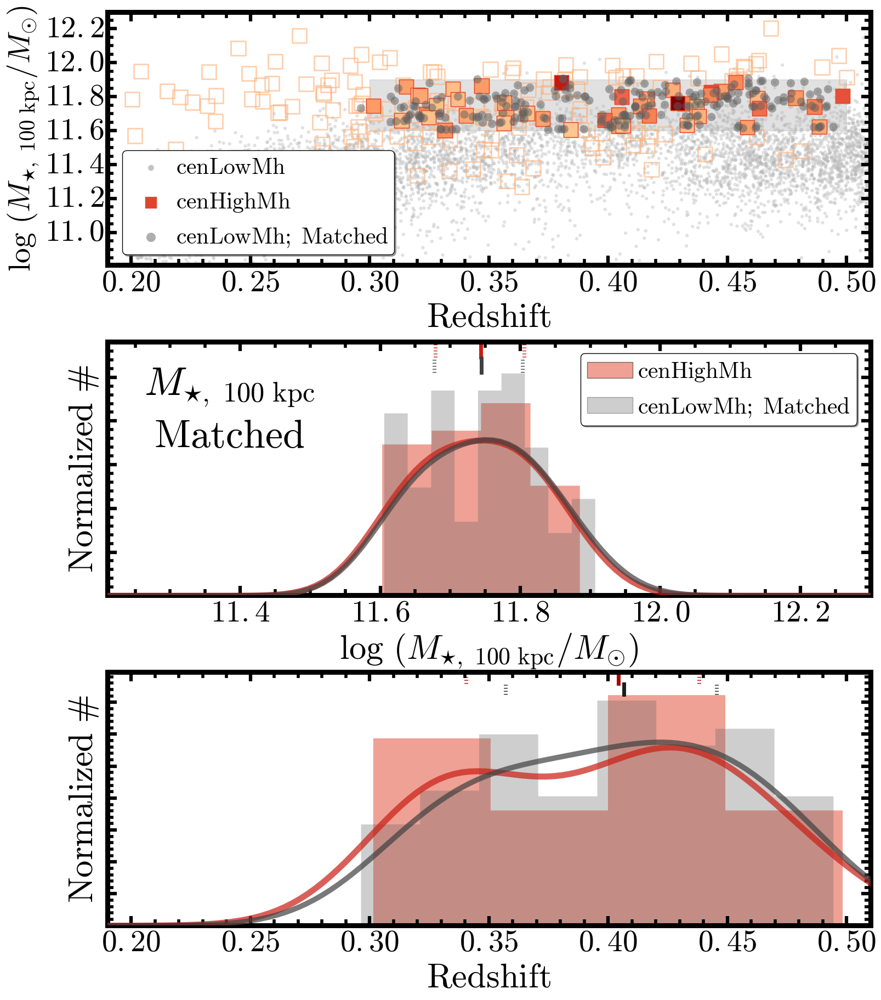

In [114]:
# Sample Matching Using K-Dtree
lamLimit, pcenLimit = 30.0, 0.70
m100_1, m100_2, m100_3 = 11.60, 11.70, 11.90
z_1, z_2 = 0.30, 0.50

sampleM100c = 'matchA_m100_' + sedMod
print("#-----------------------------------------------------------------------------#")
redbcgM100c, nonbcgM100c = sampleMatch(redbcgClean, nonbcgClean, 
                                       name=sampleM100c,
                                       mlim1=m100_1, mlim2=m100_3, zlim1=z_1, zlim2=z_2, 
                                       massCol='logm_100', zCol='z_use', 
                                       k1=5, k2=11, k3=5, k4=11, leaf=7,
                                       lamLimit=lamLimit, lamCol='lambda_redm', 
                                       pcenLimit=pcenLimit, pcenCol='p_cen_1_redm', 
                                       massCut=11.75, zCut=0.36, 
                                       massMargin1=0.005, massMargin2=0.010, 
                                       zMargin1=-0.01, zMargin2=-0.005,
                                       unique=True, ballTree=False, metric='l1',
                                       figDir=figDir,
                                       xtickFormat='$\mathbf{%4.1f}$', 
                                       ytickFormat='$\mathbf{%4.1f}$',
                                       legend1='$\mathrm{cenLowMh}$',
                                       legend2='$\mathrm{cenHighMh}$',
                                       legend3='$\mathrm{cenLowMh;\ Matched}$',
                                       zKernel=0.03, text1='$M_{\star,\ 100\ \mathrm{kpc}}$')

## logM_10 matched samples

#-----------------------------------------------------------------------------#
# Sample 1 Size:  69
# Sample 2 Size:  2216
# All and Unique Matched Sample 532 455


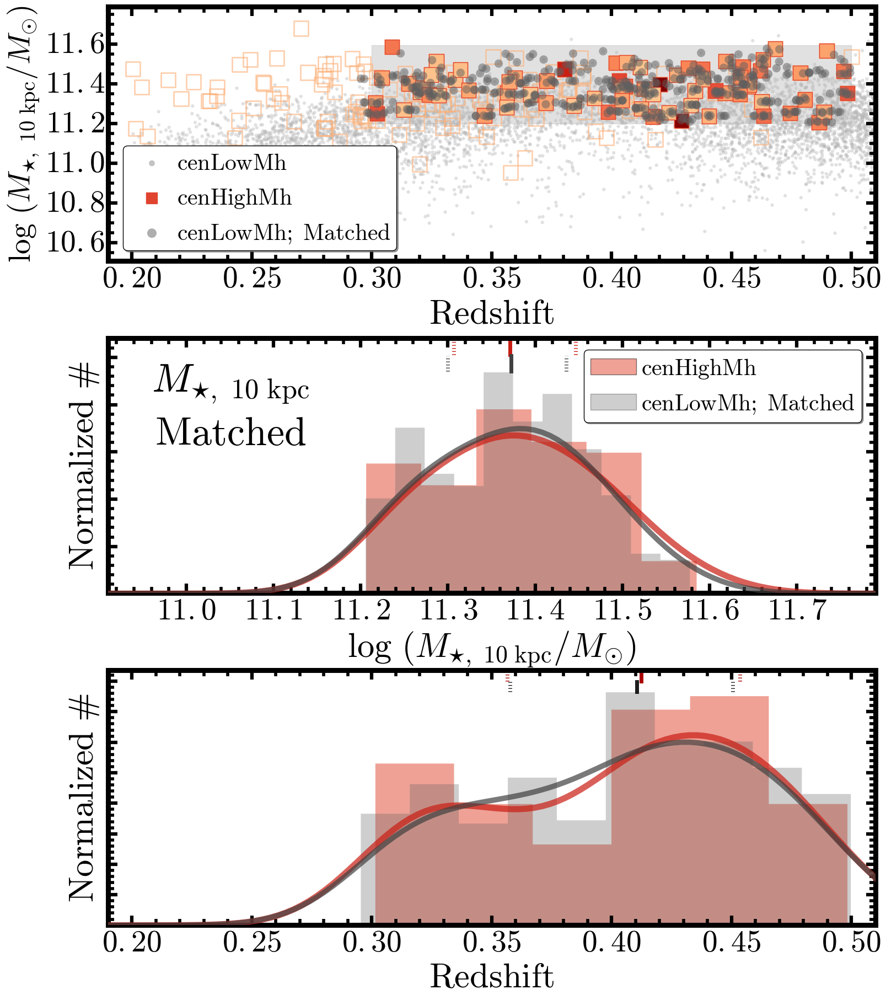

In [116]:
# Sample Matching Using K-Dtree
lamLimit, pcenLimit = 30.0, 0.8
m10_1, m10_2, m10_3 = 11.20, 11.40, 11.595
z_1, z_2 = 0.30, 0.50
mmin, mmax = 10.91, 11.79

sampleM10c = 'matchA_m10_' + sedMod
print("#-----------------------------------------------------------------------------#")
redbcgM10c, nonbcgM10c = sampleMatch(redbcgClean, nonbcgClean, 
                                     name=sampleM10c,
                                     mlim1=m10_1, mlim2=m10_3, zlim1=z_1, zlim2=z_2, 
                                     massCol='logm_10', zCol='z_use', 
                                     k1=7, k2=8, k3=7, k4=9, leaf=7,
                                     lamLimit=lamLimit, lamCol='lambda_redm', 
                                     pcenLimit=pcenLimit, pcenCol='p_cen_1_redm', 
                                     massCut=(m10_1 + m10_3)/2.0, zCut=0.36, 
                                     massMargin1=0.005, massMargin2=0.015, 
                                     zMargin1=-0.01, zMargin2=0.001,
                                     unique=True, ballTree=False, metric='l1', 
                                     mmin=mmin, mmax=mmax,
                                     figDir=figDir,
                                     yLabel='$\log\ (M_{\star,\ 10\ \mathrm{kpc}}/M_{\odot})$', 
                                     legend1='$\mathrm{cenLowMh}$',
                                     legend2='$\mathrm{cenHighMh}$',
                                     legend3='$\mathrm{cenLowMh;\ Matched}$',
                                     text1='$M_{\star,\ 10\ \mathrm{kpc}}$',
                                     xtickFormat='$\mathbf{%4.1f}$', 
                                     ytickFormat='$\mathbf{%4.1f}$')